# Topic: M33's Stream Dynamics
by Alondra Cardona

The purpose of this project is to look at the tidal debris in the form of stellar streams around M33 during the MW-M31 merger. This project will delve into the dynamics and kinematical evolution of M33's disk stars as a result of the gravitational phenomena experinced from its host galaxy merging with another galaxy similar in size. 

In [2]:
# import modules
import numpy as np
import astropy.units as u
from astropy.constants import G

# import plotting modules
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.colors import LogNorm


# my modules
from ReadFile import Read
from ParticleProperties import ParticleInfo
from CenterOfMass2 import CenterOfMass
from OrbitCOM import OrbitCOM
from GalaxyMass import ComponentMass

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np


import matplotlib.animation as animation


# Step 1: Find the positions and velocities of stars in M33 high resolution simulation data

Make file with position and velocity componens of all disk particles at selected times

In [13]:
def mag(vector):
    return np.sqrt(vector[0]**2+vector[1]**2+vector[2]**2)

def Particles(filename,type):
    """

    """
    # Initialize an instance of CenterOfMass class, using disk particles
    COM = CenterOfMass(filename, 2)
    #parts[i,0] = (COM.time).to_value()/1000 #time in GYR

    # call ReadFile function 
    time, total_parts, data = Read(filename) 

    # conditions for identifying data points of selected type
    if type == 1:
        index = np.where(data['type']==1) # dark matter halo particles
    elif type == 2:
        index = np.where(data['type']==2) # disk particles
    elif type == 3:
        index = np.where(data['type']==3) # bulge particles

    
    # calculate distance magnitude of selected particle
    positions = []
    velocities = []
    for i in range(len(data['x'][index])):
        pos = np.array([data['x'][index][i],data['y'][index][i],data['z'][index][i]])
        vel = np.array([data['vx'][index][i],data['vy'][index][i],data['vz'][index][i]])
        positions.append(pos)
        velocities.append(vel)

    vels = []
    for velocity in velocities:
        vels.append(mag(velocity))
     
     # Plot each particle
    x = []
    y = []
    z = []
    for position in positions:
        x.append(position[0])
        y.append(position[1])
        z.append(position[2])

    t = time.value/1000
    
    return x,y,z,vels,t


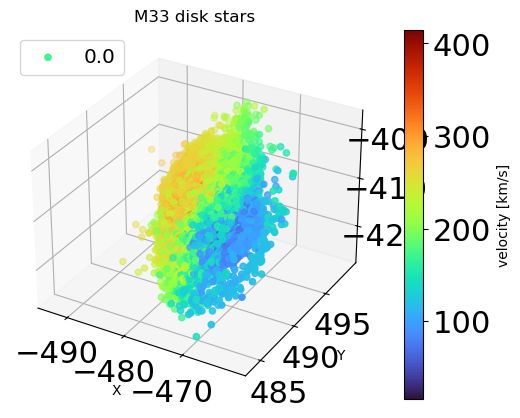

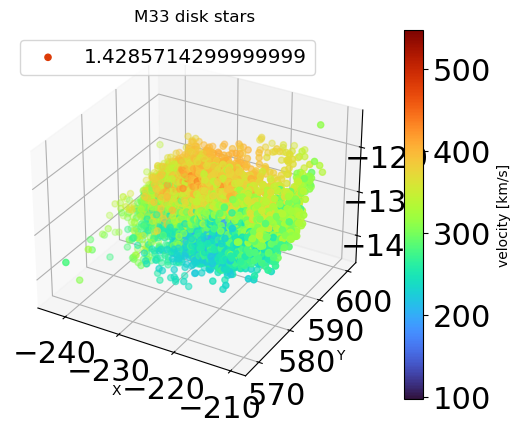

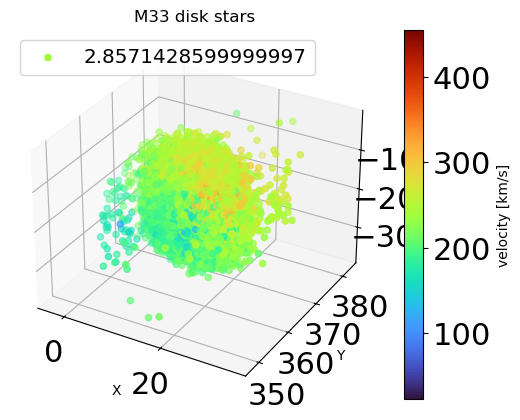

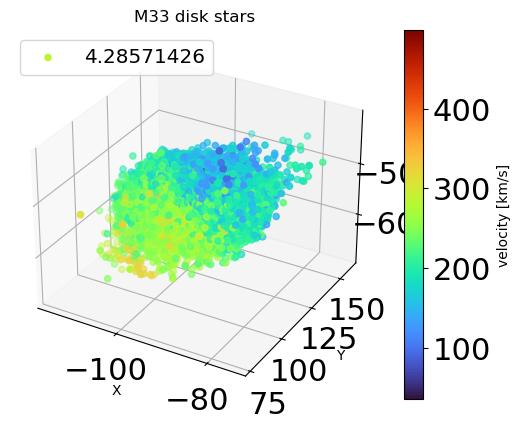

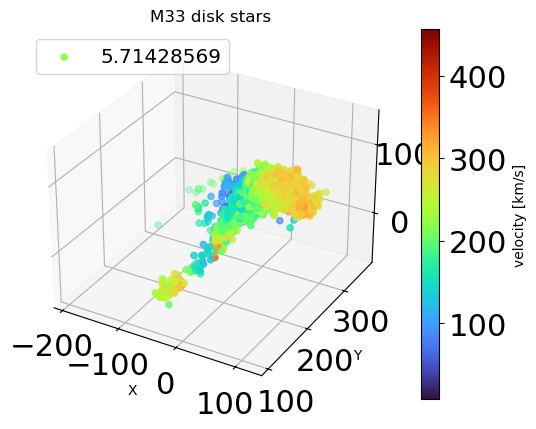

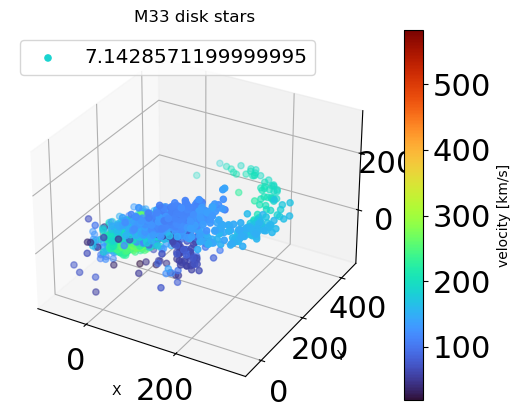

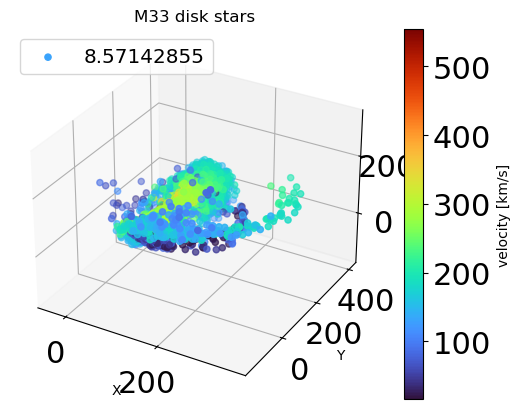

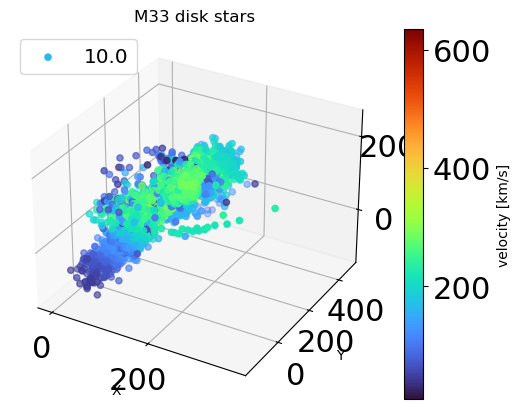

In [450]:
tsteps = np.arange(0,800,100)

for i, step in enumerate(tsteps):# loop over files
    if step < 10:
        ilbl = 'M33'+'_00'+str(step)+'.txt'
    elif step >= 10 and step < 100:
        ilbl = 'M33'+'_0'+str(step)+'.txt'
    else:
        ilbl = 'M33'+'_'+str(step)+'.txt'

    filename = 'M33'+'/'+ilbl

    x,y,z,vels,t = Particles(filename,2)

    # Create the figure and 3D axes
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    
    scatter = ax.scatter(x, y, z, marker='o', c=vels, cmap='turbo', label=t)

     # Set labels and title
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.legend(loc='upper left',fontsize='x-large')
    ax.set_title('M33 disk stars')
    plt.colorbar(scatter, label='velocity [km/s]')
     
     # Show the plot
    plt.show()


# Step 2: 2D plots, color coded by velocity magnitude

In [118]:
def RotateFrame(posI,velI):
    """a function that will rotate the position and velocity vectors
    so that the disk angular momentum is aligned with z axis. 
    
    PARAMETERS
    ----------
        posI : `array of floats`
             3D array of positions (x,y,z)
        velI : `array of floats`
             3D array of velocities (vx,vy,vz)
             
    RETURNS
    -------
        pos: `array of floats`
            rotated 3D array of positions (x,y,z) 
            such that disk is in the XY plane
        vel: `array of floats`
            rotated 3D array of velocities (vx,vy,vz) 
            such that disk angular momentum vector
            is in the +z direction 
    """
    
    # compute the angular momentum
    L = np.sum(np.cross(posI,velI), axis=0)
    
    # normalize the angular momentum vector
    L_norm = L/np.sqrt(np.sum(L**2))


    # Set up rotation matrix to map L_norm to
    # z unit vector (disk in xy-plane)
    
    # z unit vector
    z_norm = np.array([0, 0, 1])
    
    # cross product between L and z
    vv = np.cross(L_norm, z_norm)
    s = np.sqrt(np.sum(vv**2))
    
    # dot product between L and z 
    c = np.dot(L_norm, z_norm)
    
    # rotation matrix
    I = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
    v_x = np.array([[0, -vv[2], vv[1]], [vv[2], 0, -vv[0]], [-vv[1], vv[0], 0]])
    R = I + v_x + np.dot(v_x, v_x)*(1 - c)/s**2

    # Rotate coordinate system
    pos = np.dot(R, posI.T).T
    vel = np.dot(R, velI.T).T

    return pos, vel


In [120]:
# COM instance of M33
def Positions2D(M33file):
    COMM33 = CenterOfMass(M33file,2)
    
    # Compute COM of M33 using disk particles
    COMP_33 = COMM33.COM_P(0.1,4)
    COMV_33 = COMM33.COM_V(COMP_33[0],COMP_33[1],COMP_33[2])

    # time
    t = (COMM33.time).value/1000

    # particle mass
    mp = COMM33.m

    # Determine positions of disk particles relative to M31 COM 
    xD = COMM33.x - COMP_33[0].value 
    yD = COMM33.y - COMP_33[1].value 
    zD = COMM33.z - COMP_33[2].value 
    
    # total magnitude
    rtot = np.sqrt(xD**2 + yD**2 + zD**2)
    
    # Determine velocities of disk particles relatiev to COM motion
    vxD = COMM33.vx - COMV_33[0].value 
    vyD = COMM33.vy - COMV_33[1].value 
    vzD = COMM33.vz - COMV_33[2].value 
    
    # total velocity 
    vtot = np.sqrt(vxD**2 + vyD**2 + vzD**2)
    
    # Arrays for r and v 
    r = np.array([xD,yD,zD]).T # transposed 
    v = np.array([vxD,vyD,vzD]).T

    # compute the rotated position and velocity vectors
    rn, vn = RotateFrame(r,v)

    vel = []
    for i in range(len(v)):
        vel.append(np.sqrt(v[i,0]**2+v[i,1]**2+v[i,2]**2))

    dist = []
    for i in range(len(r)):
        dist.append(r[i,0]**2+r[i,1]**2+r[i,2]**2)

    return rn, vn, dist, vel, t, mp



M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


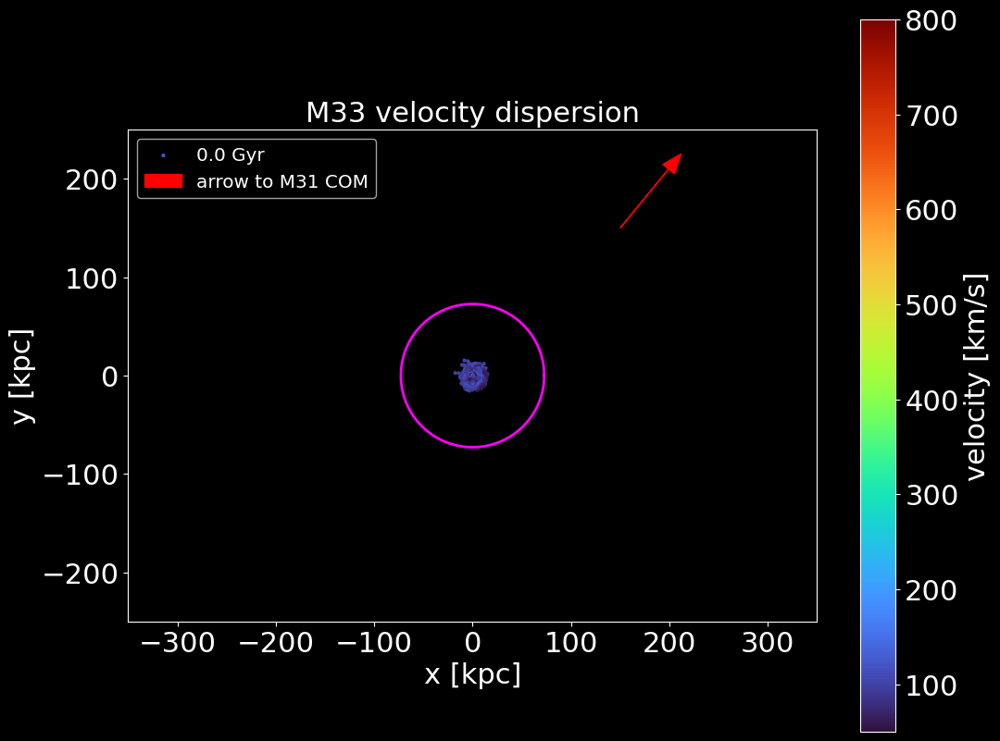

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


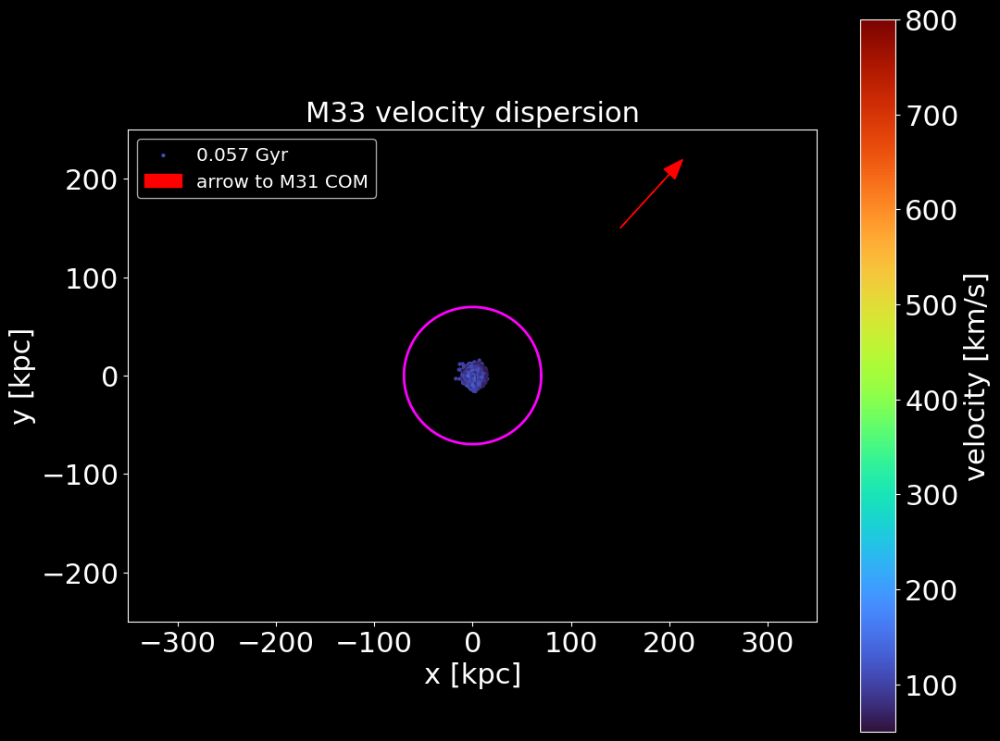

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


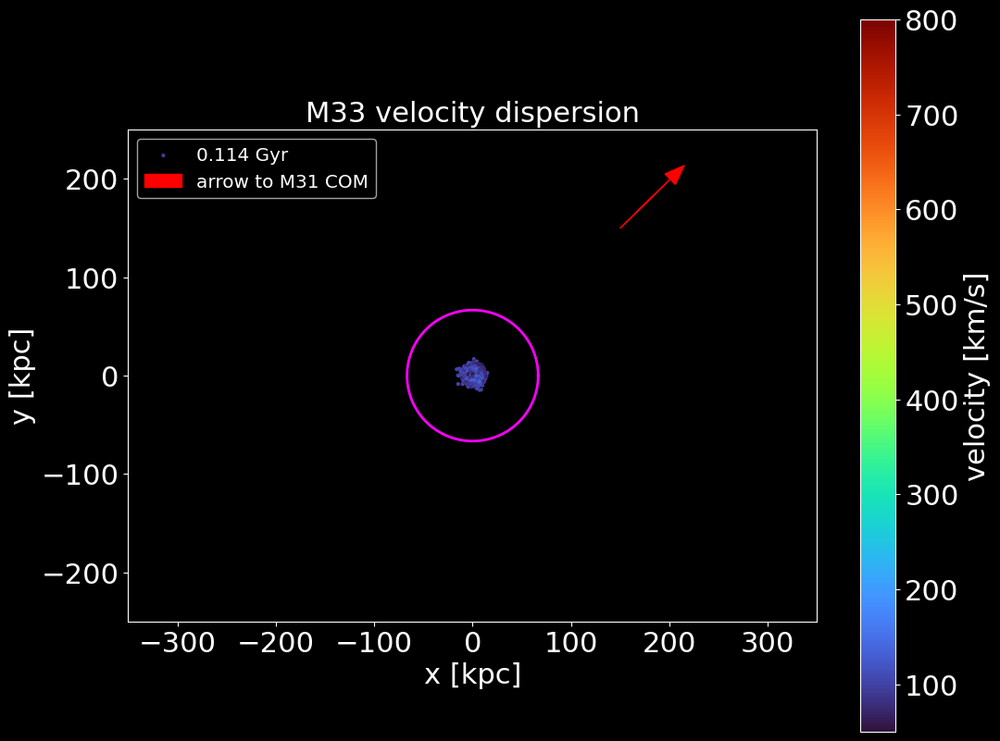

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


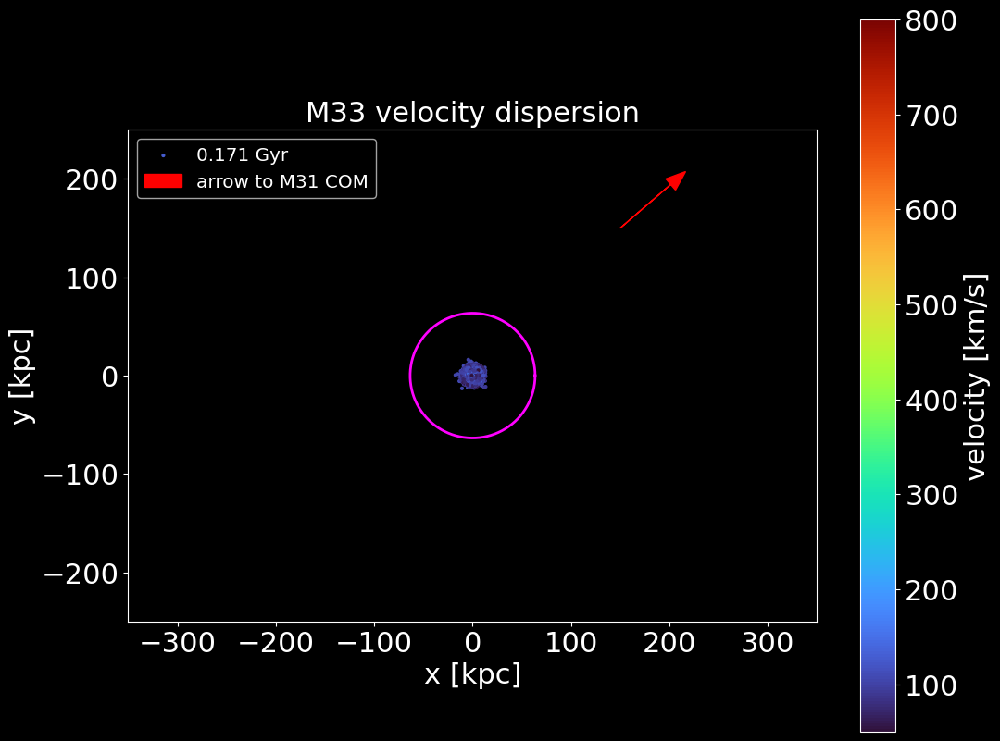

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


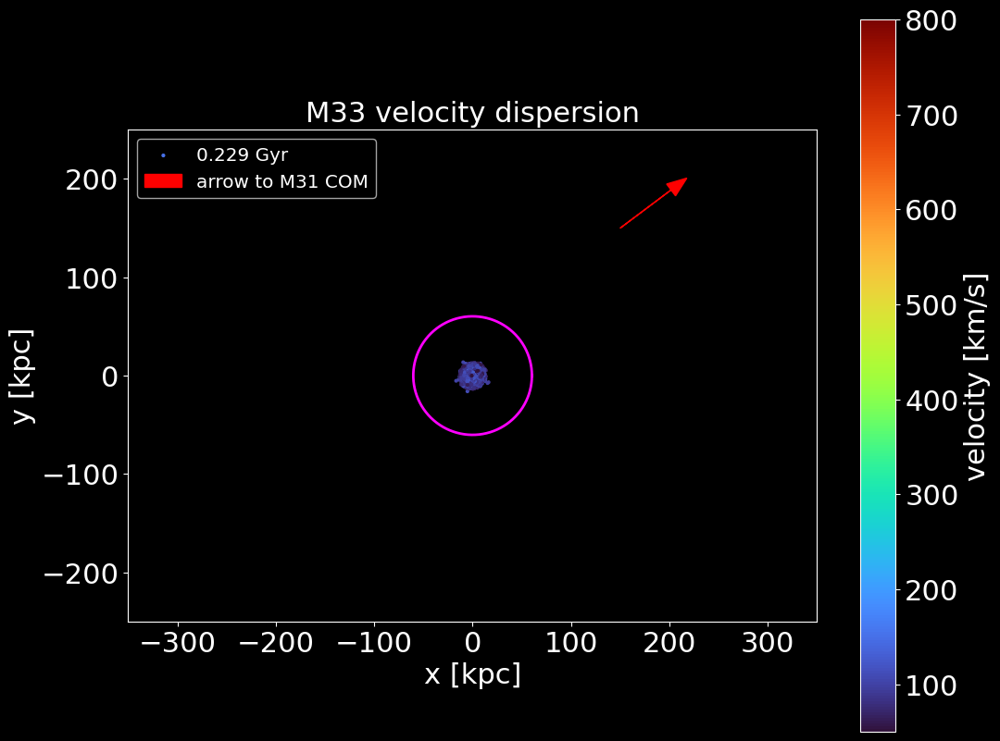

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


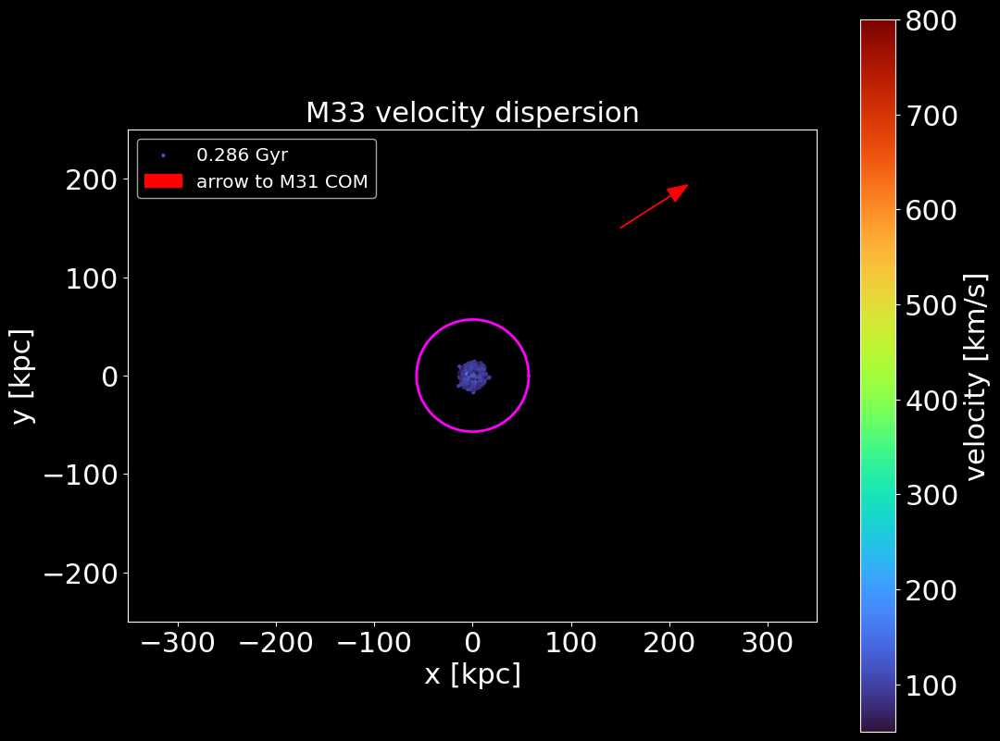

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


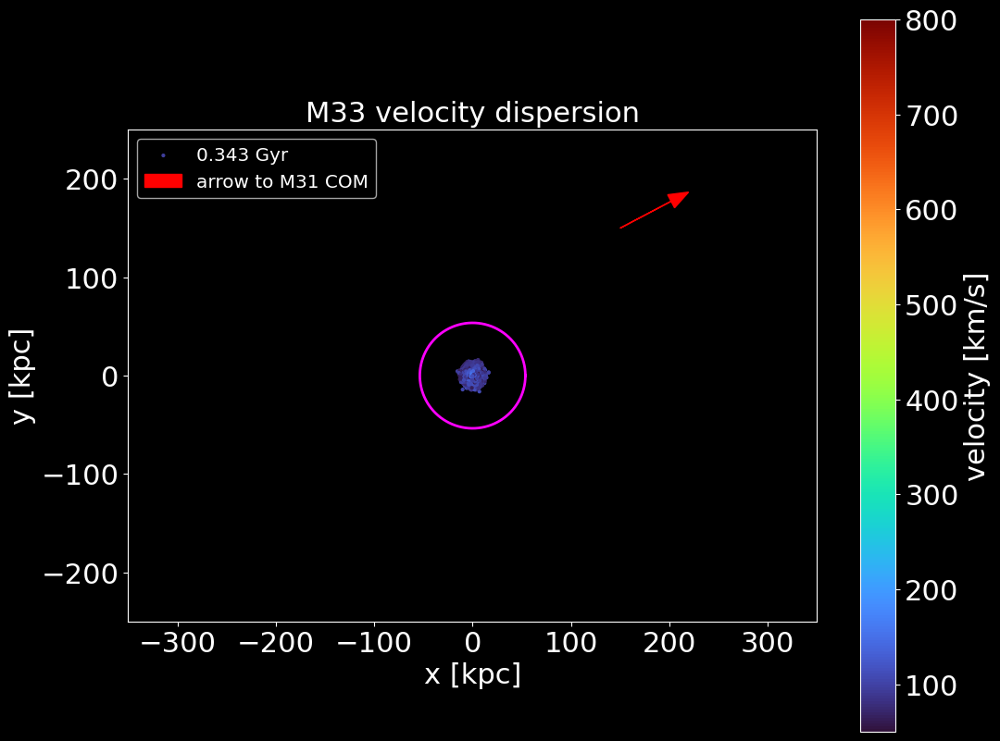

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


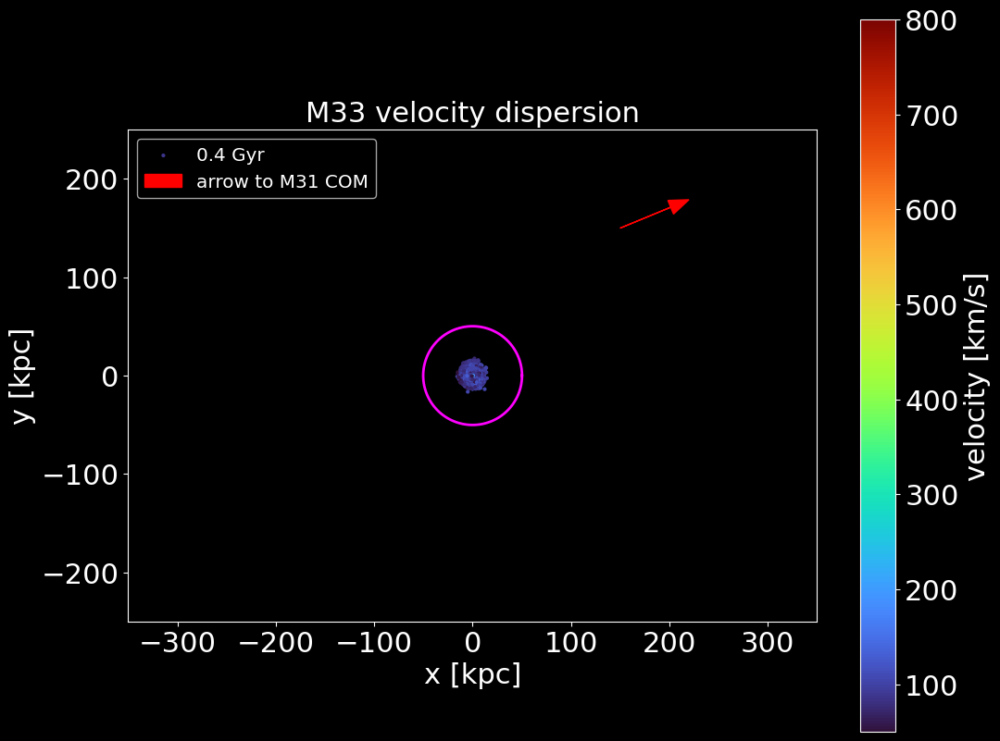

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


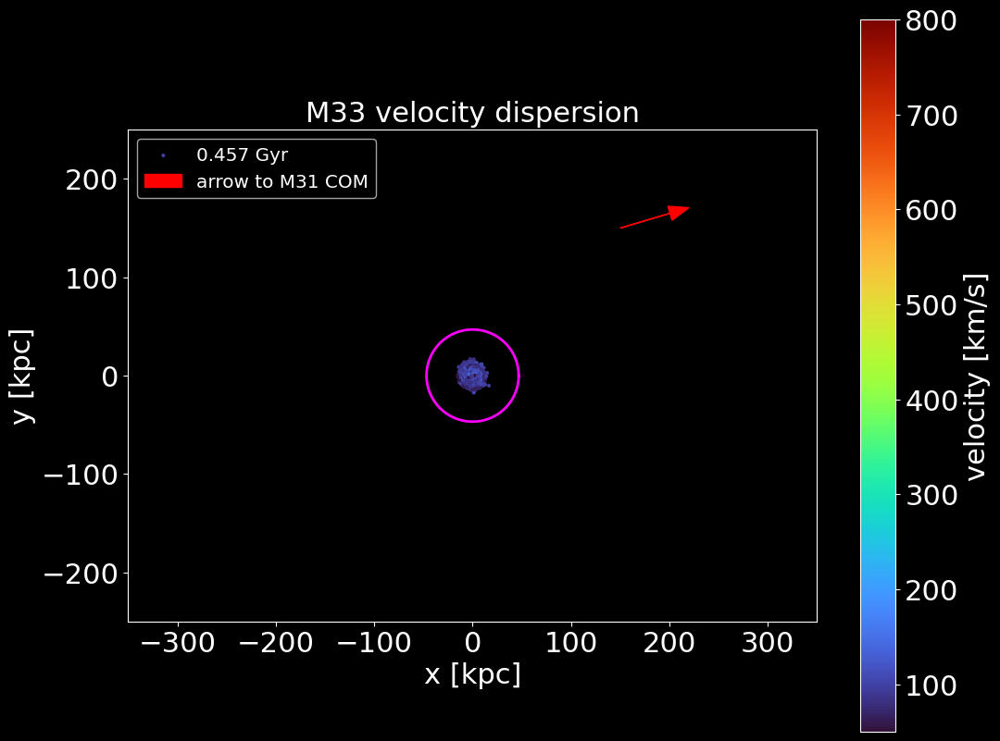

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


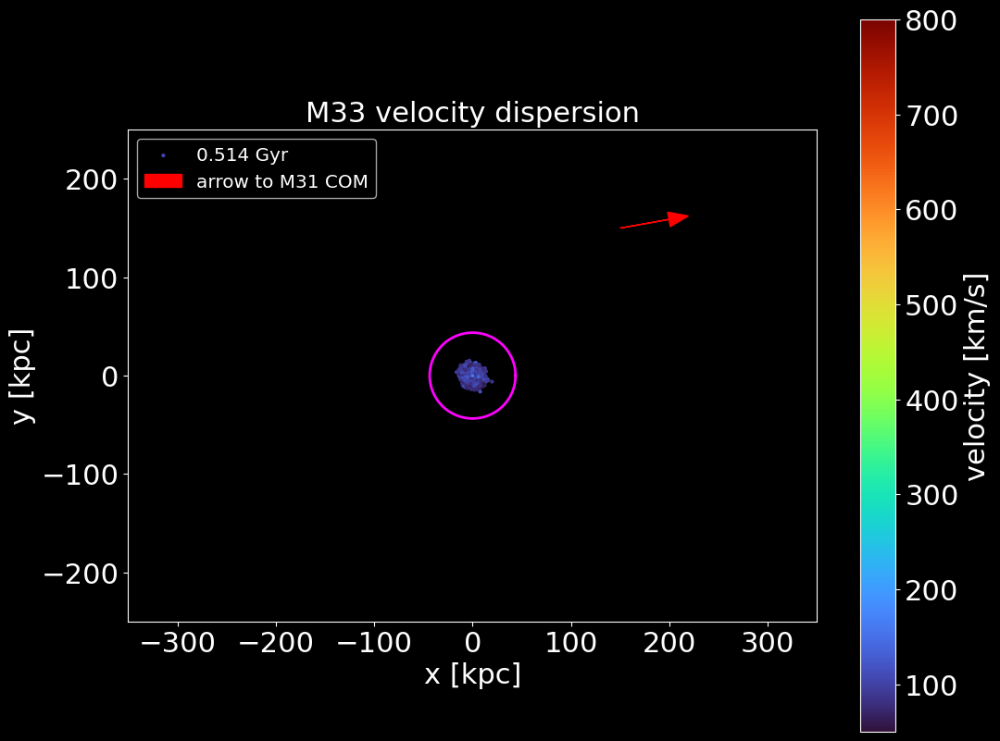

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


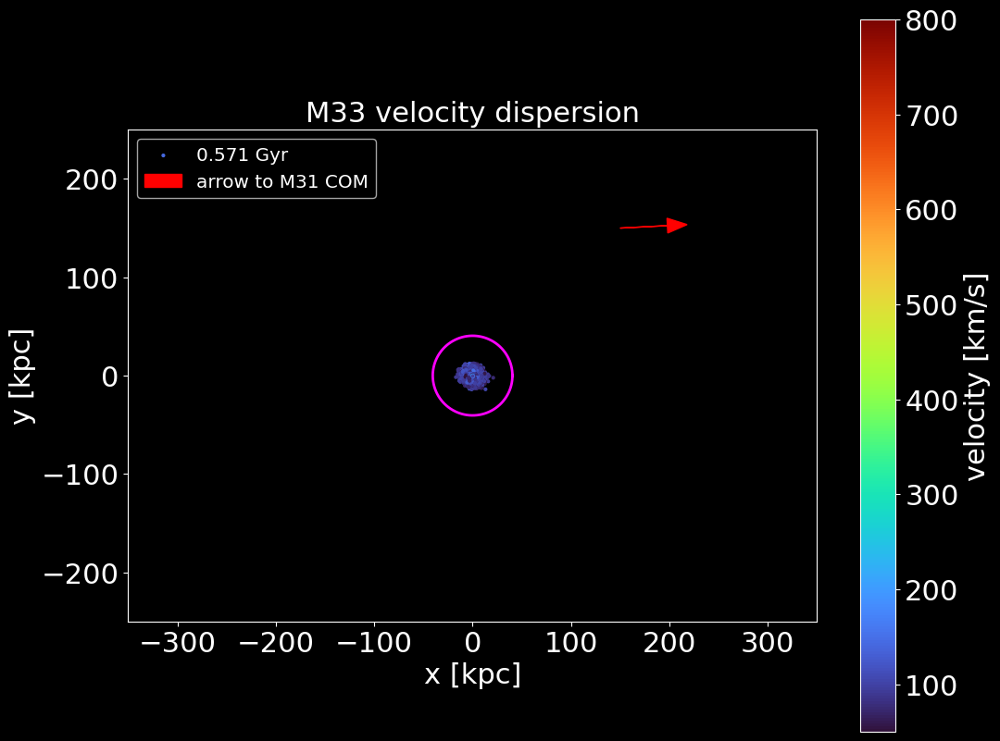

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


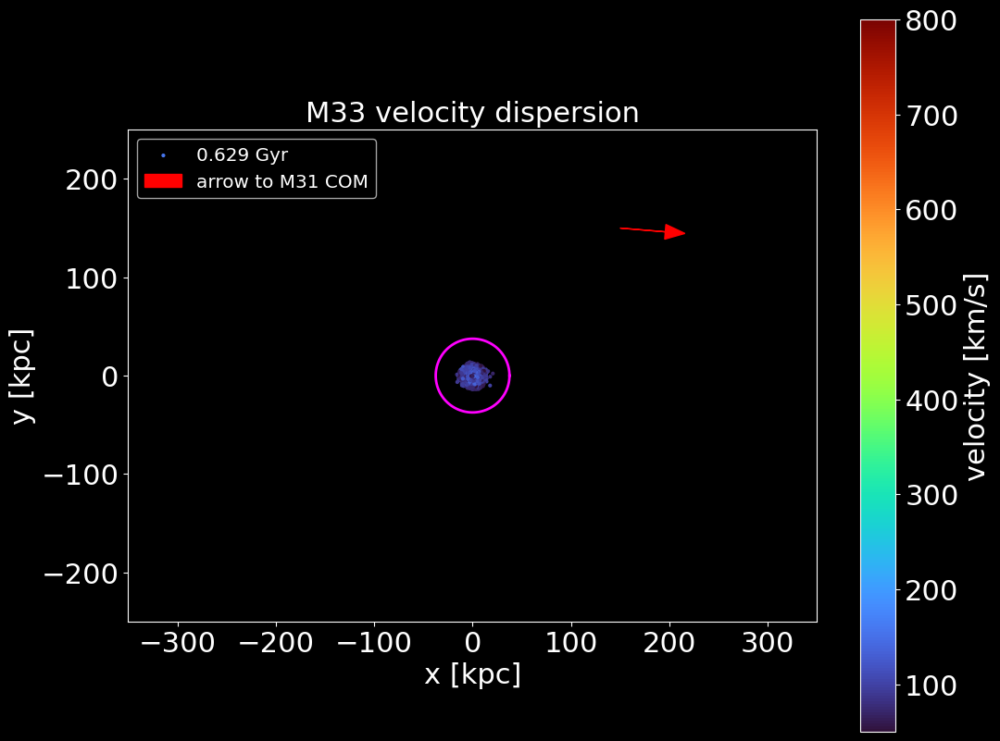

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


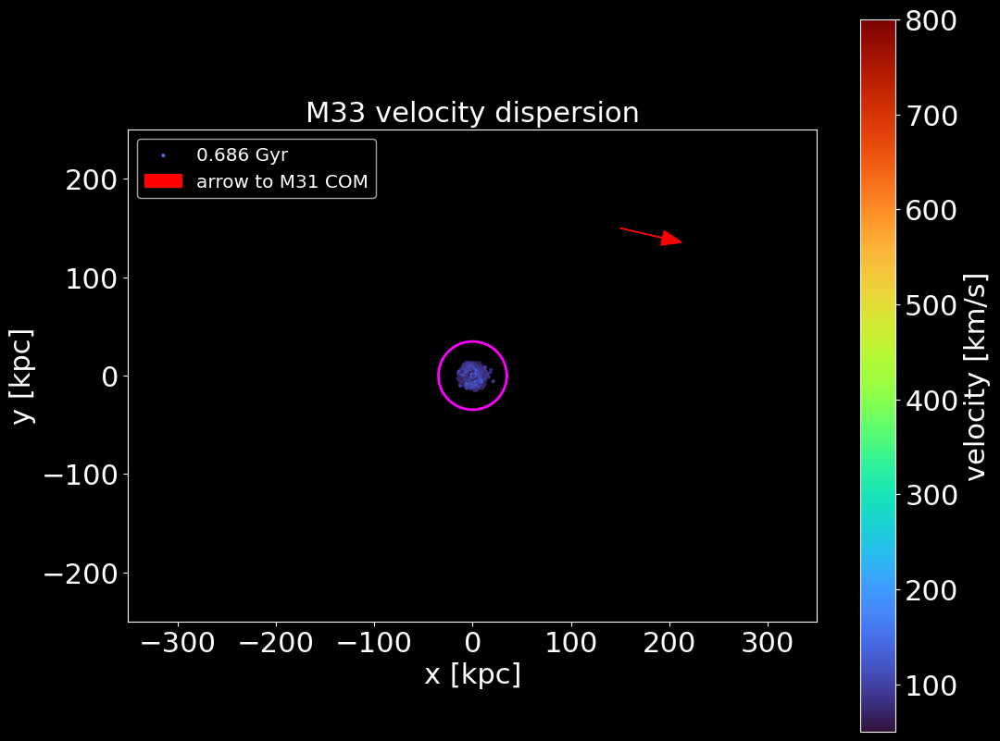

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


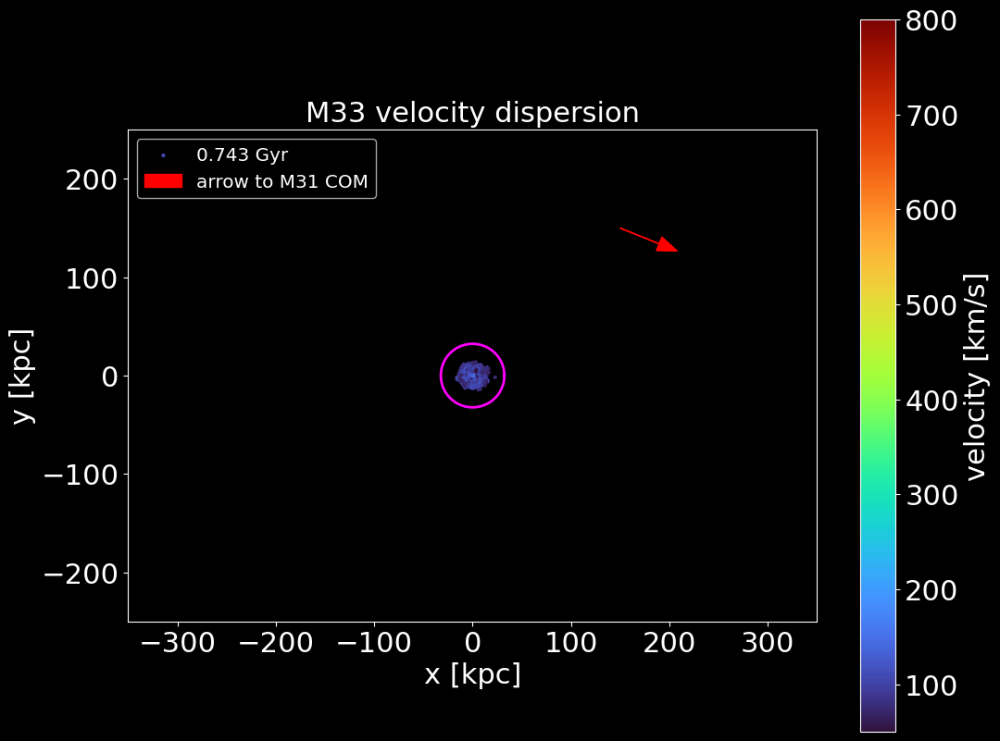

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


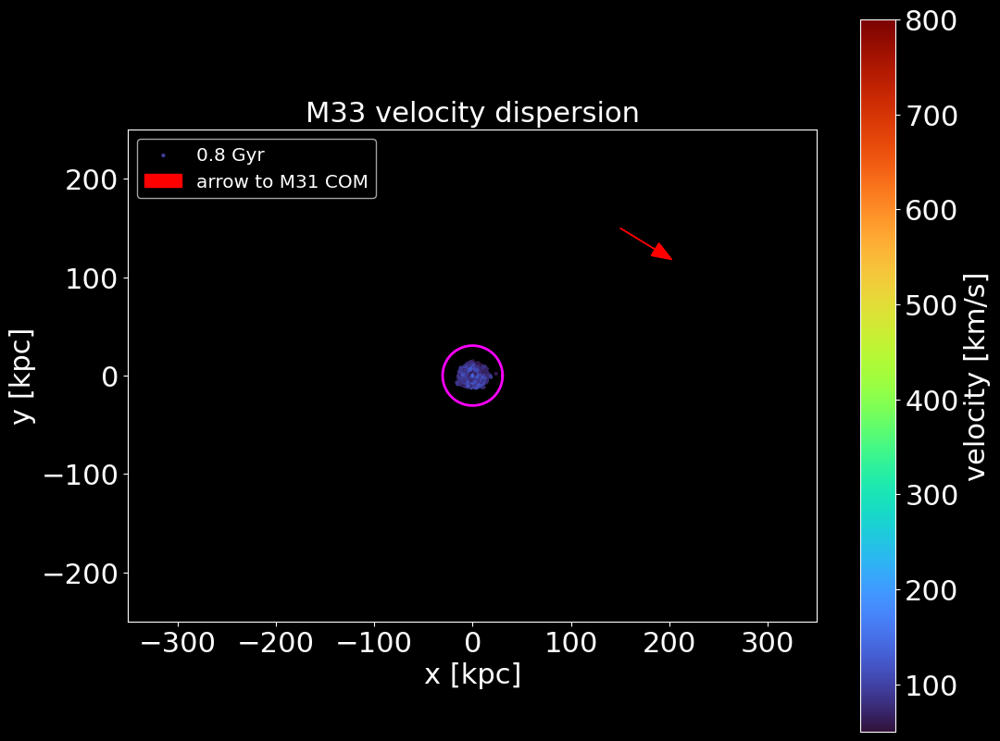

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


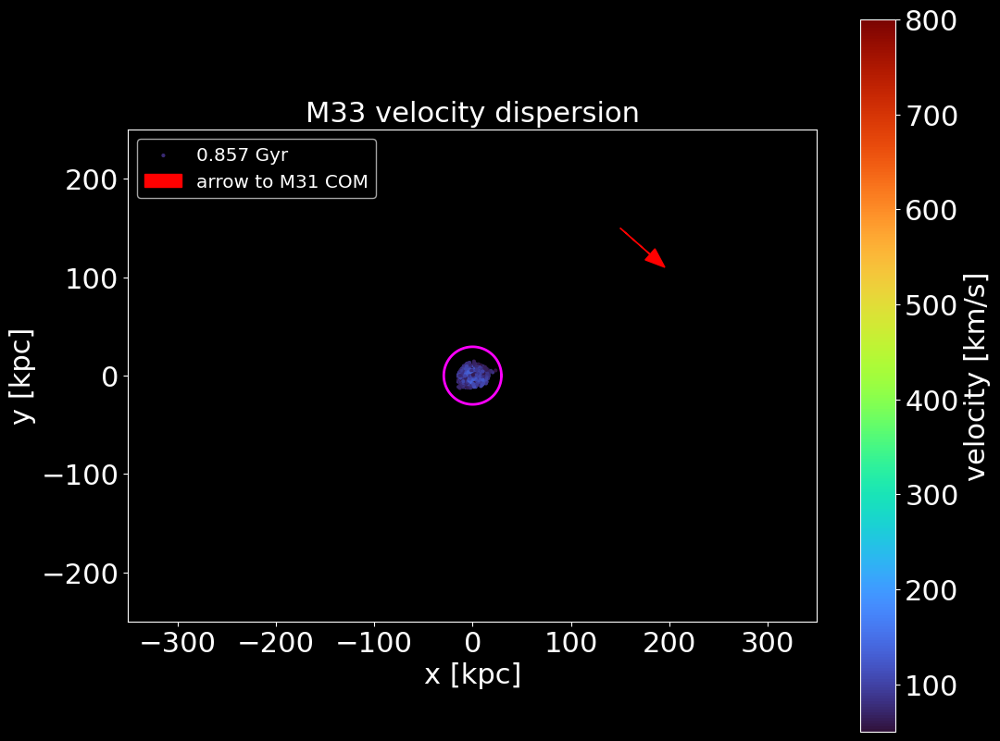

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


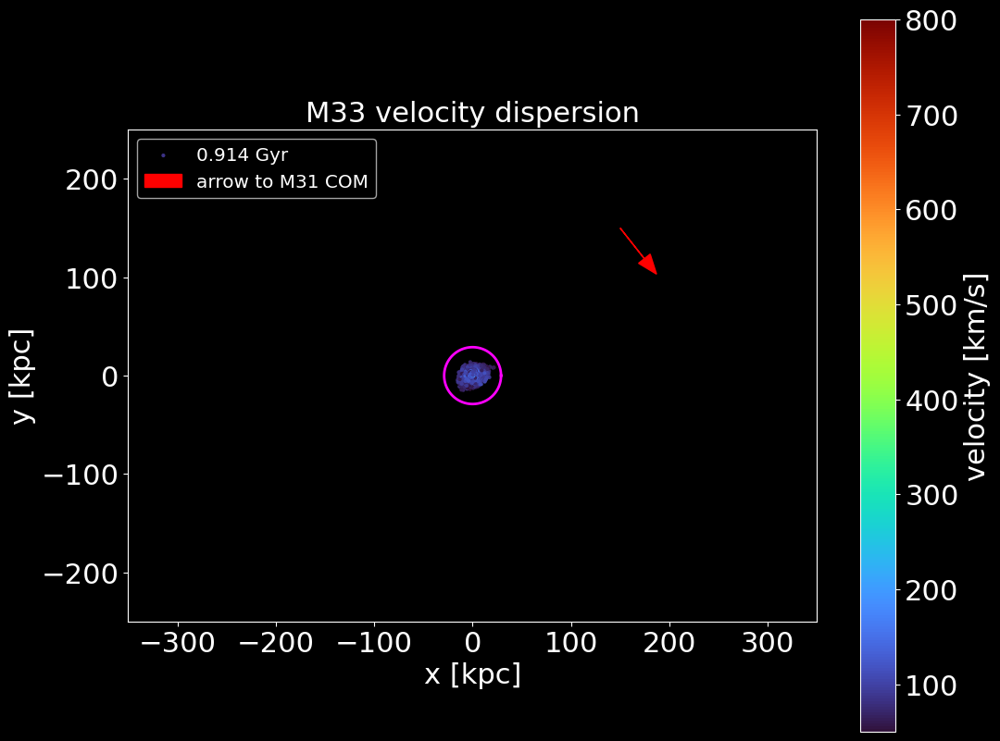

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


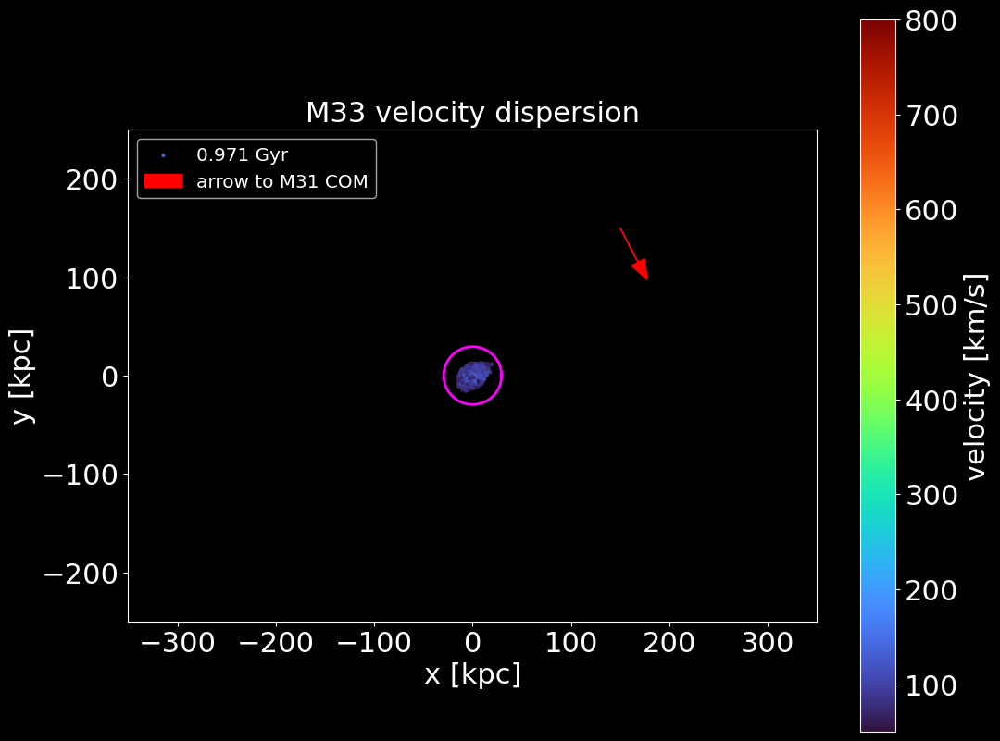

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


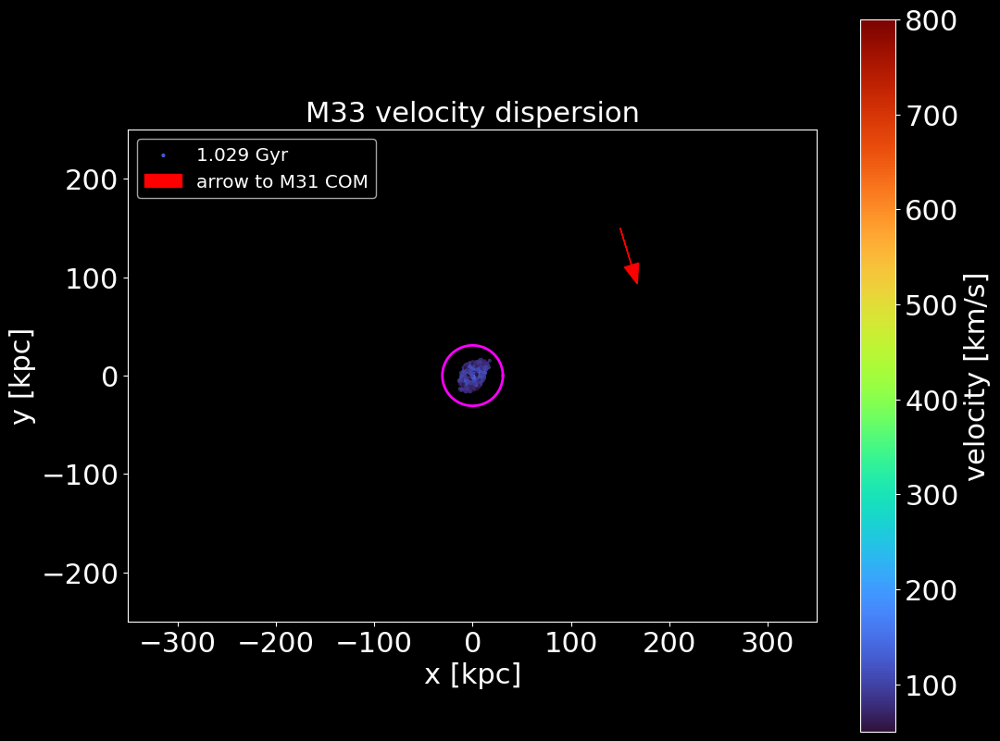

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


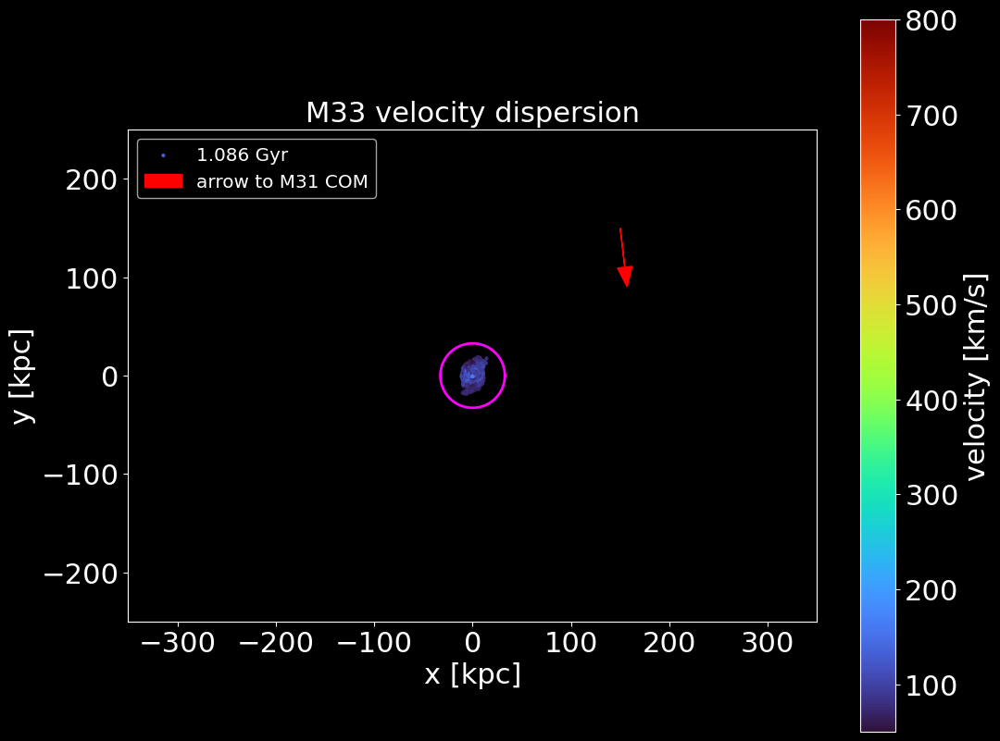

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


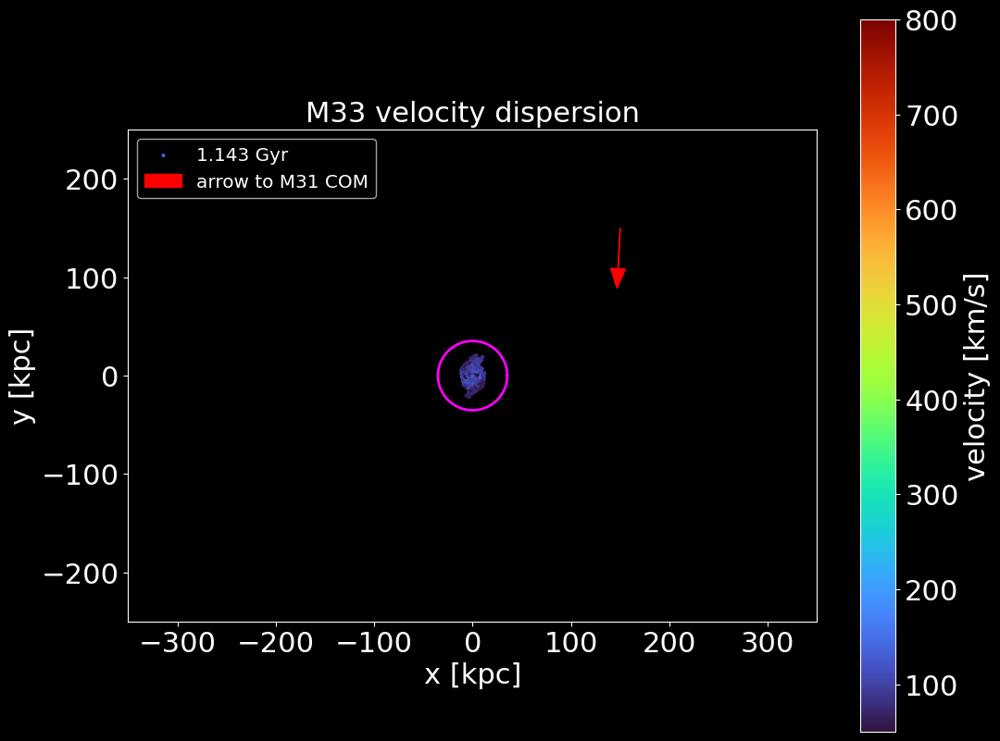

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


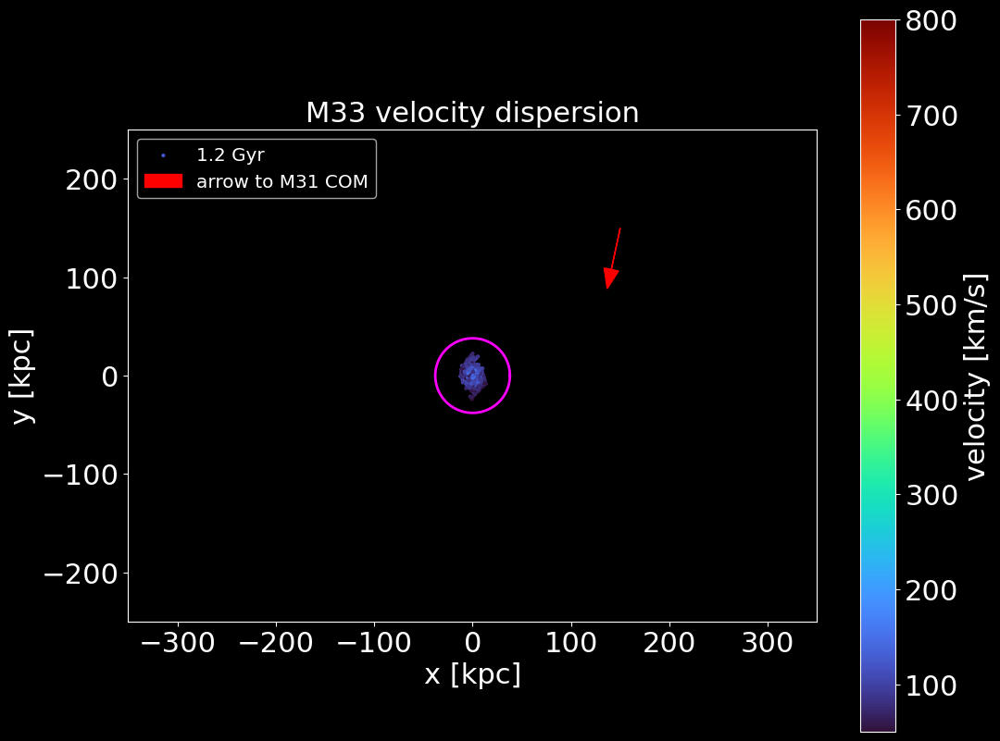

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


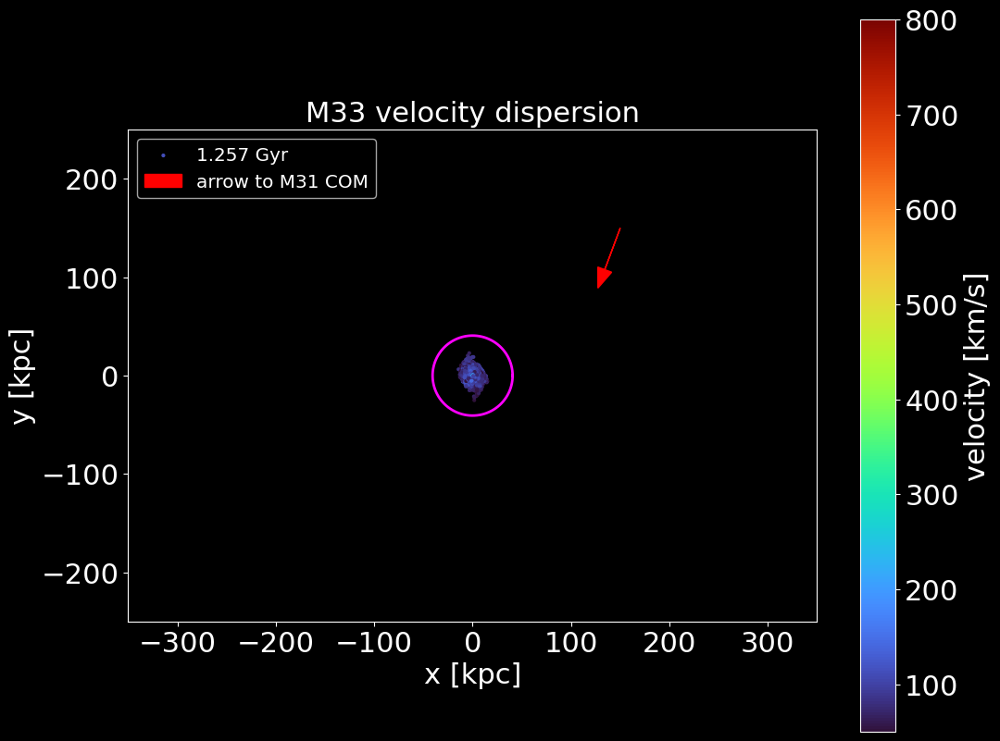

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


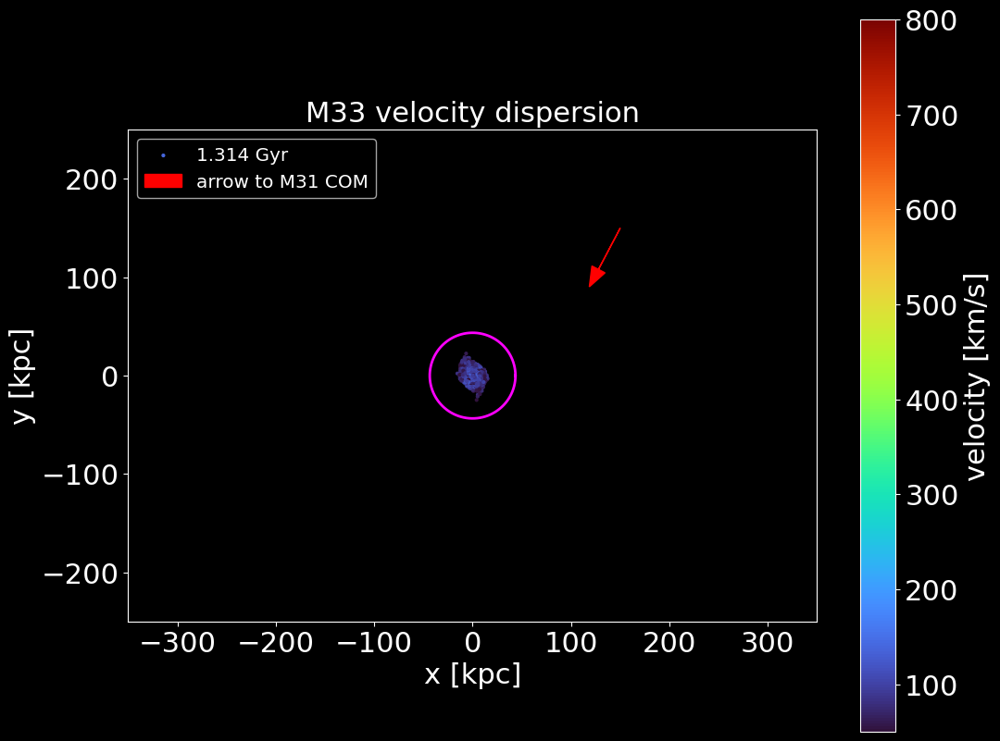

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


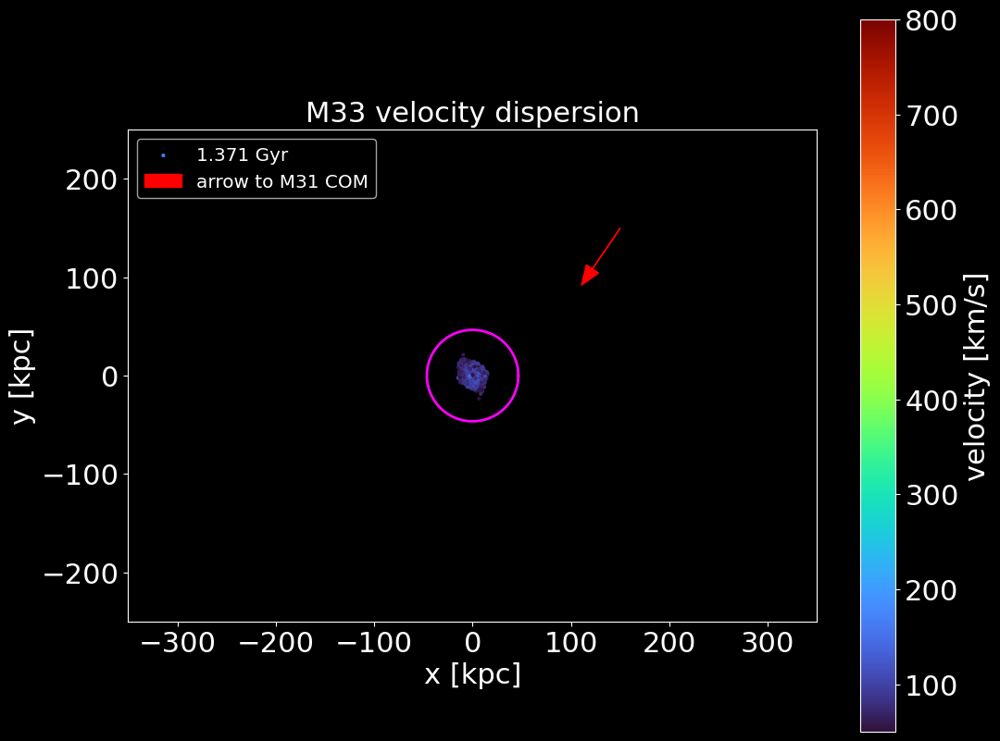

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


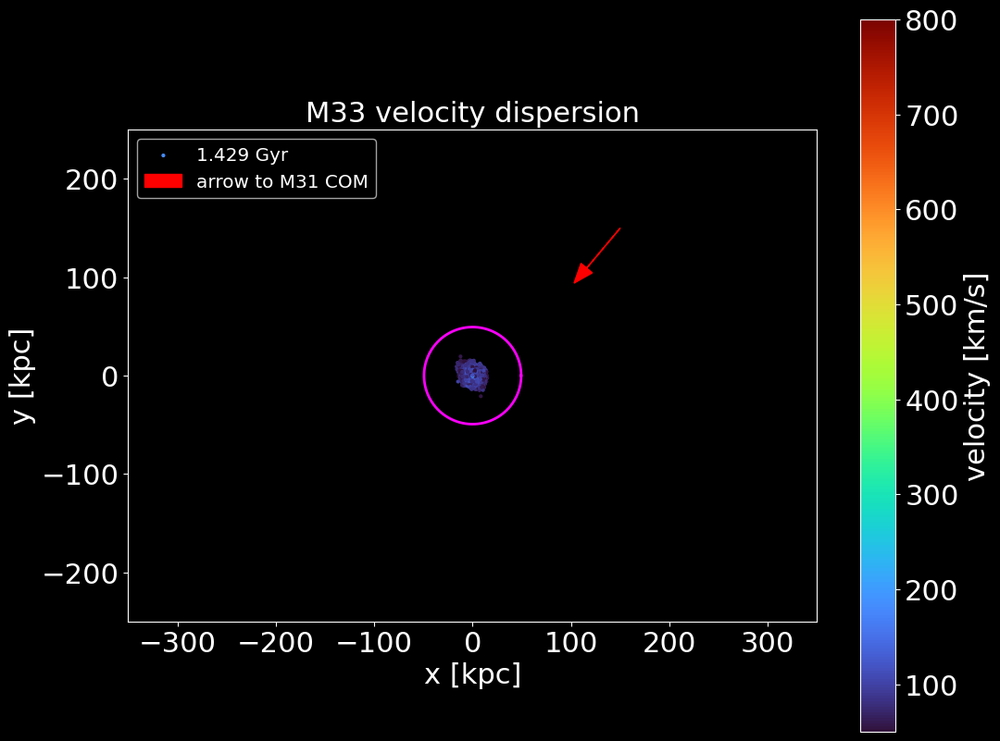

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


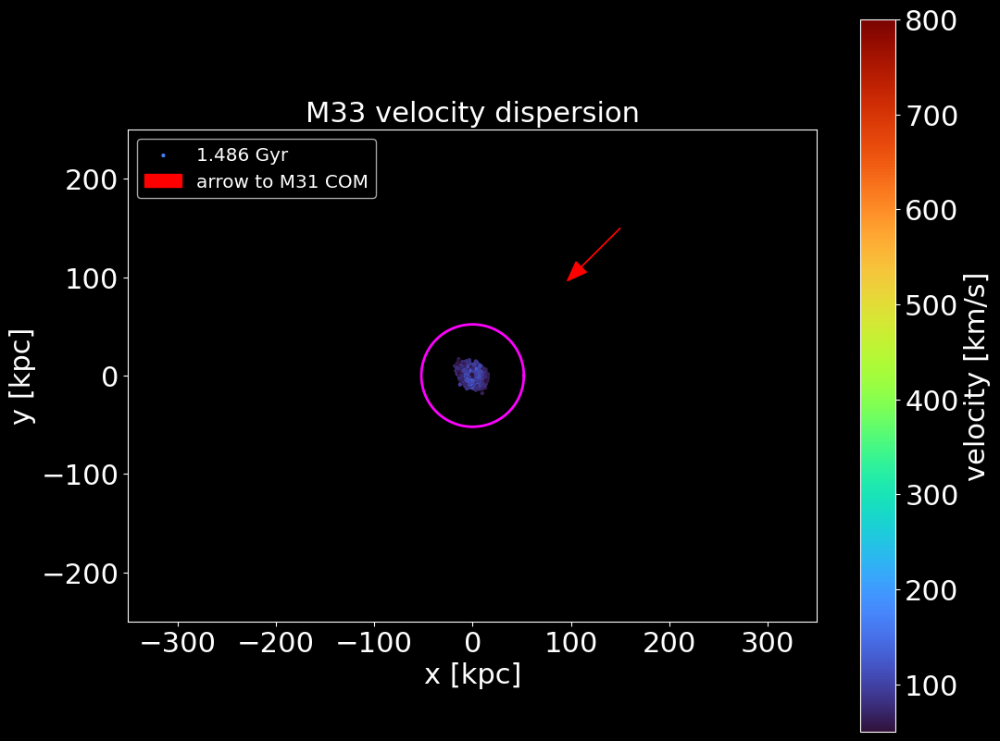

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


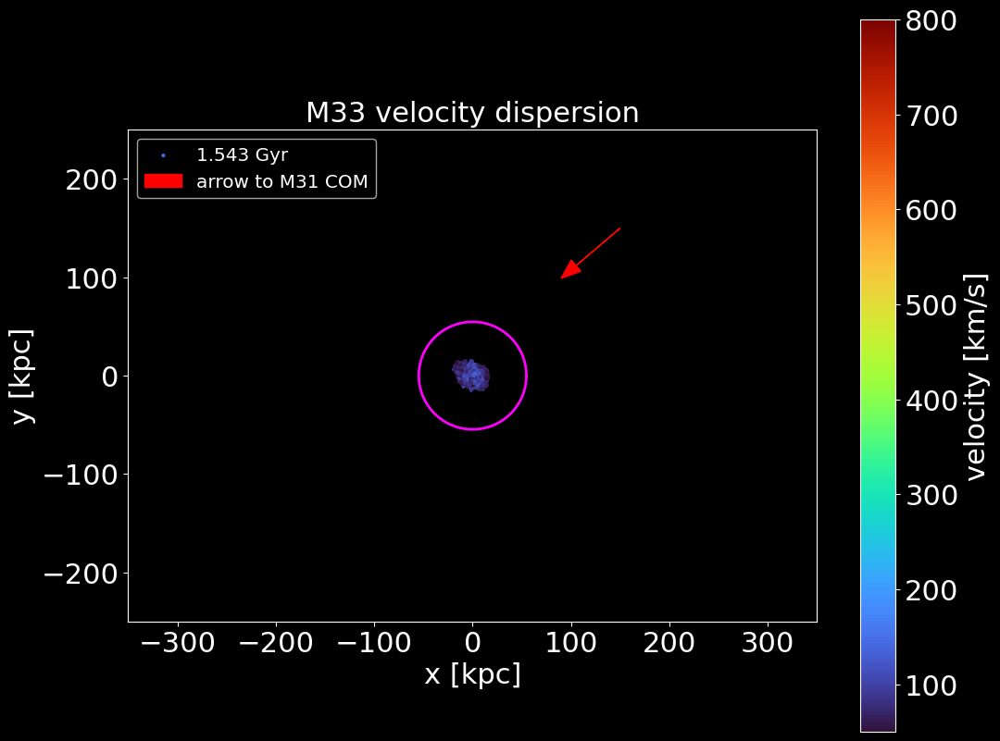

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


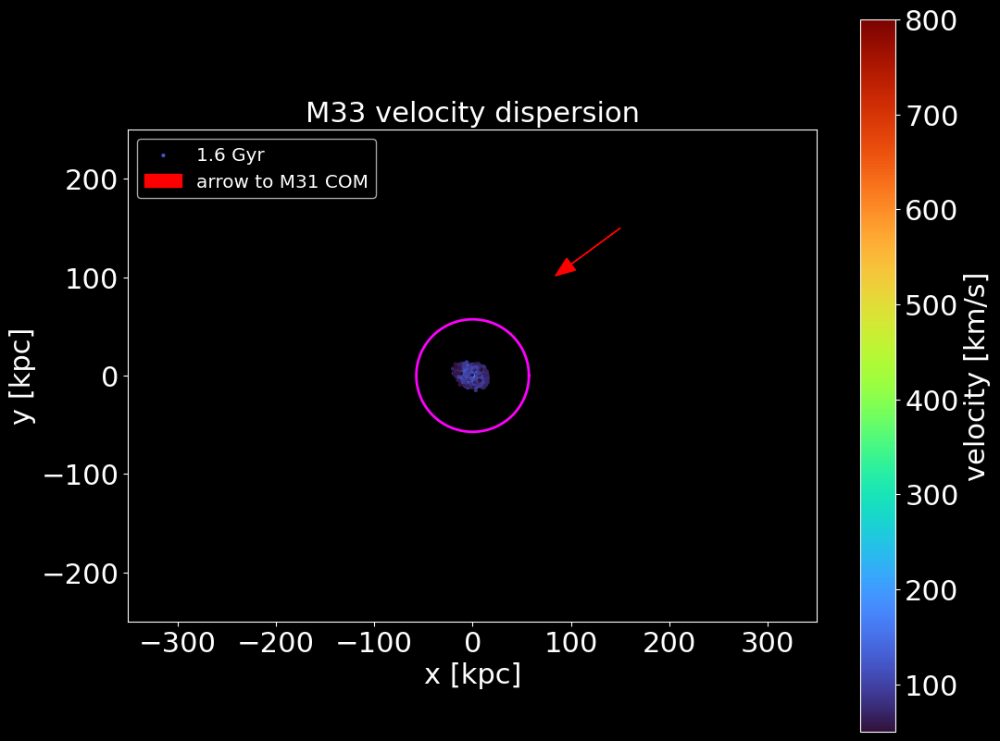

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


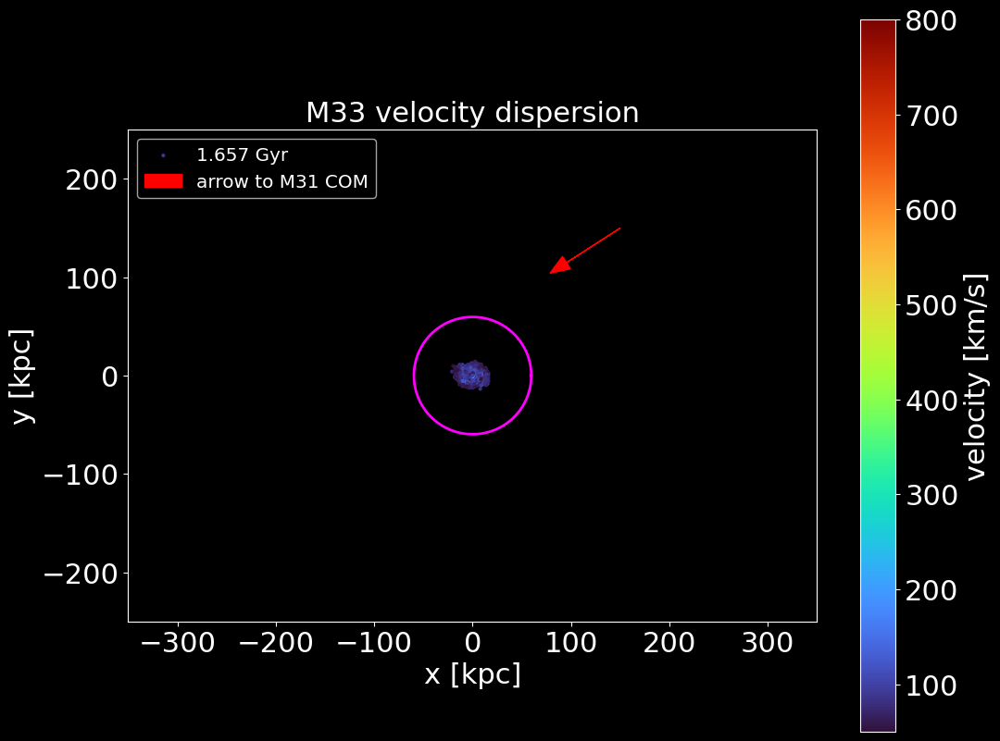

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


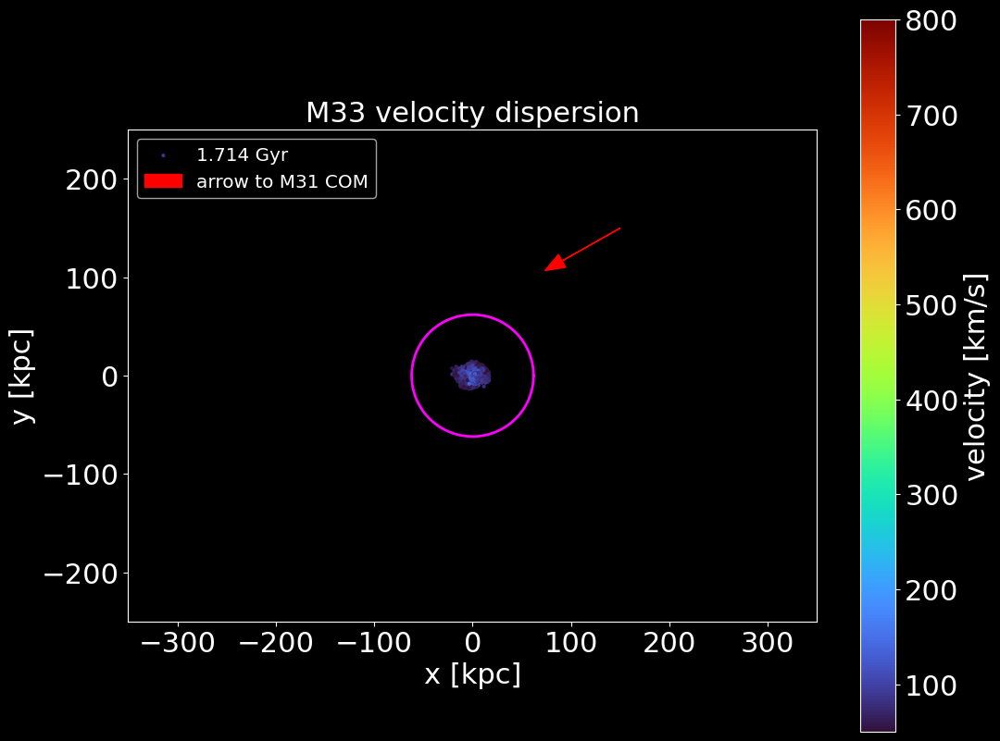

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


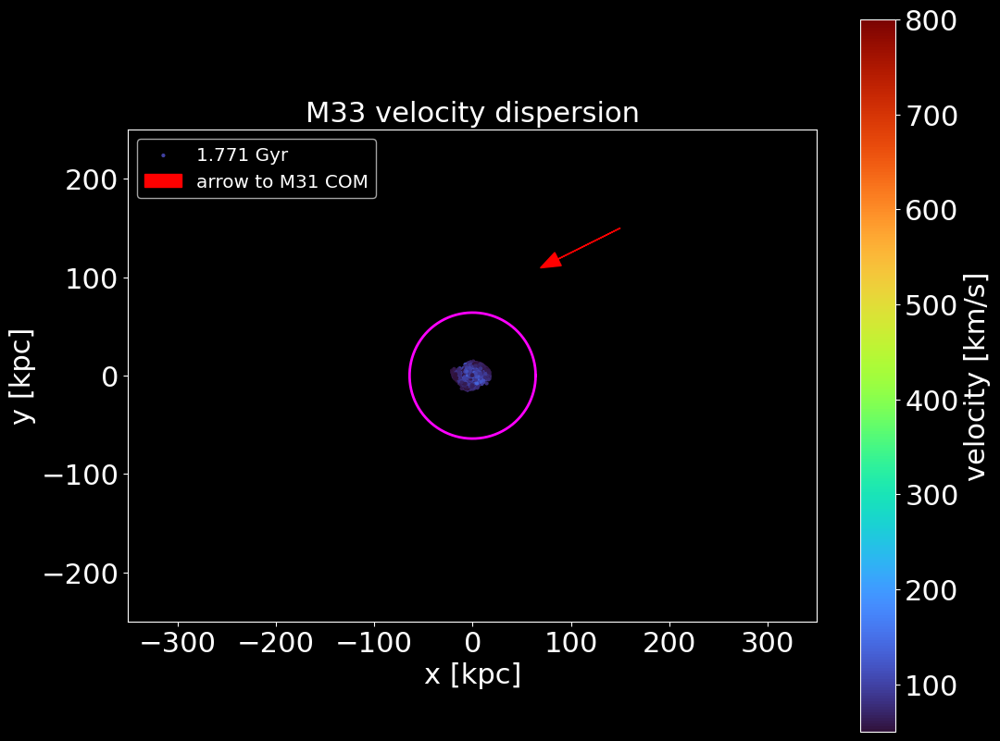

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


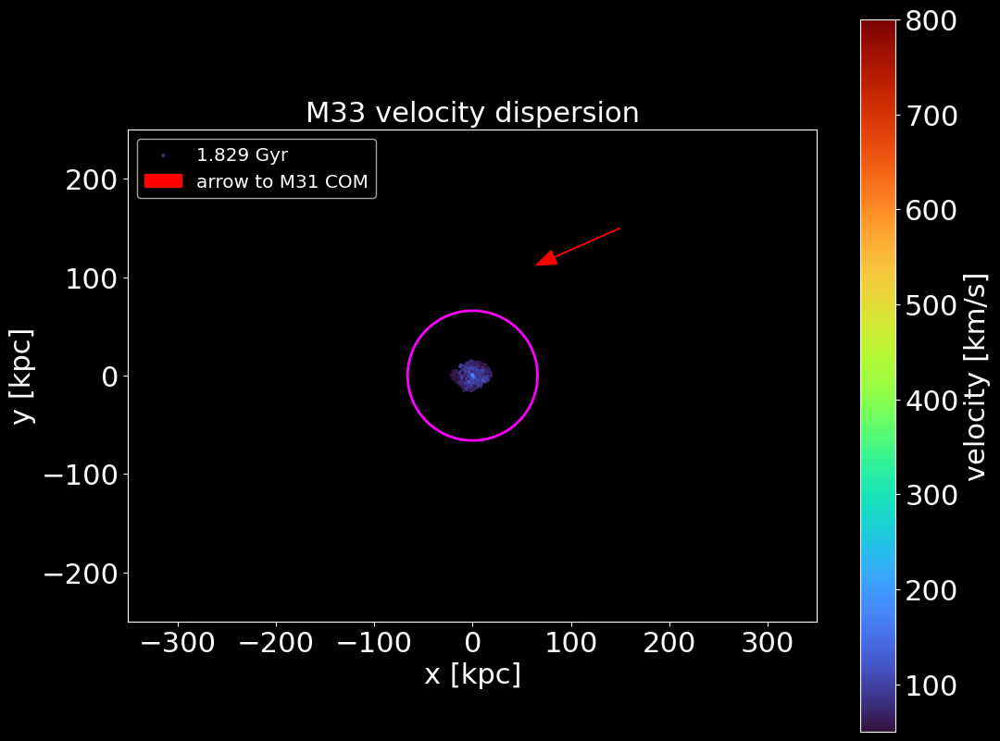

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


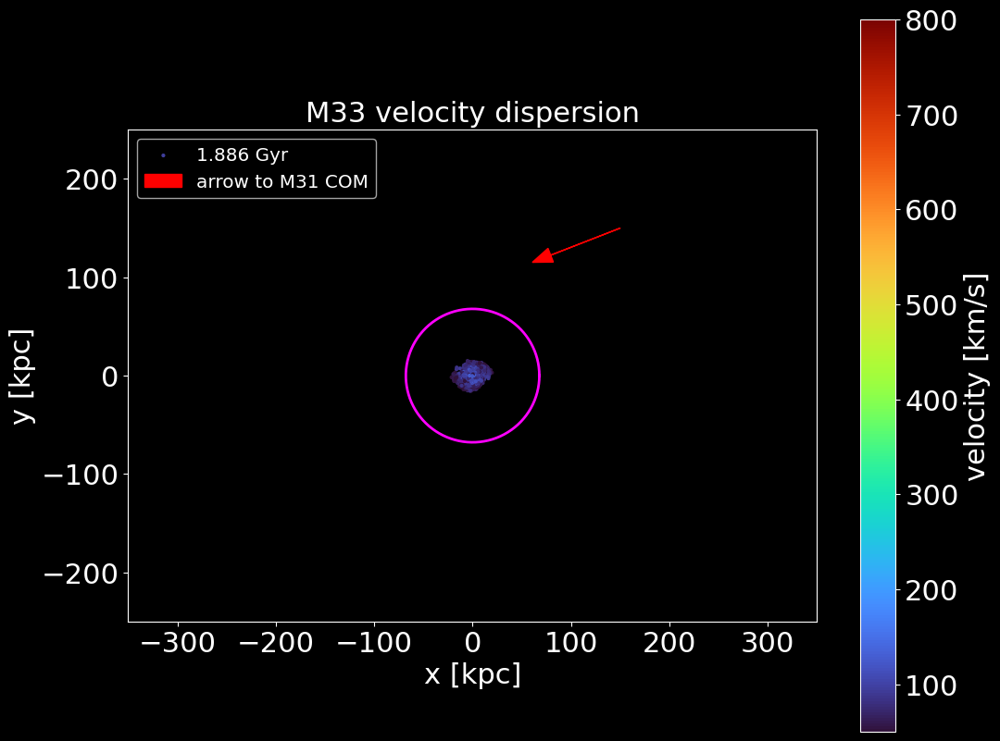

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


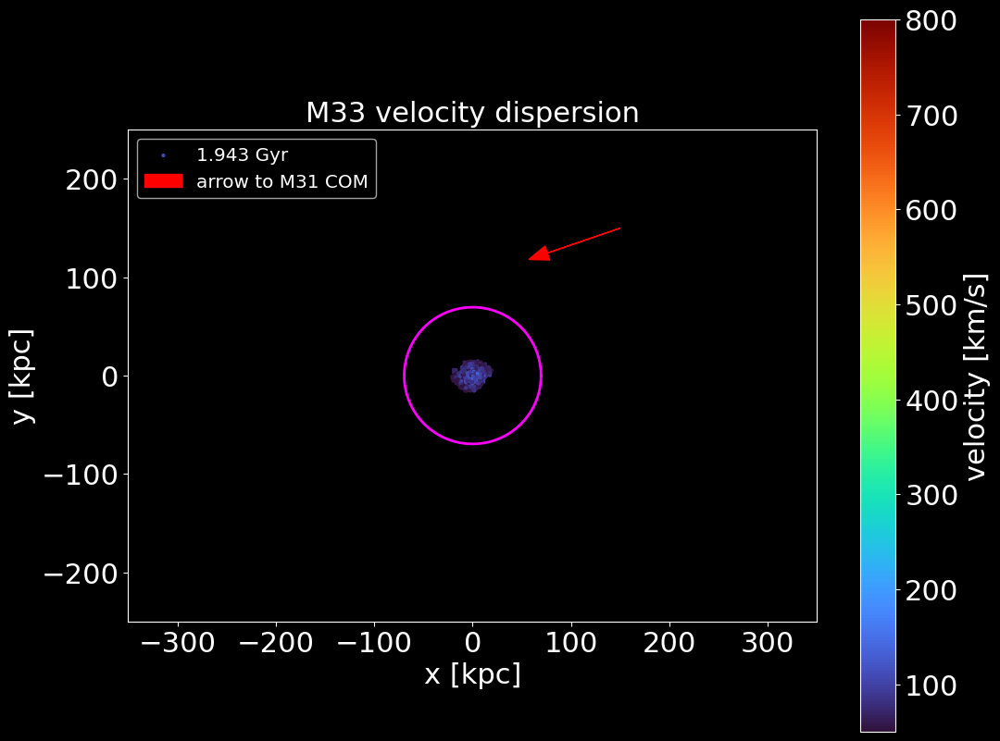

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


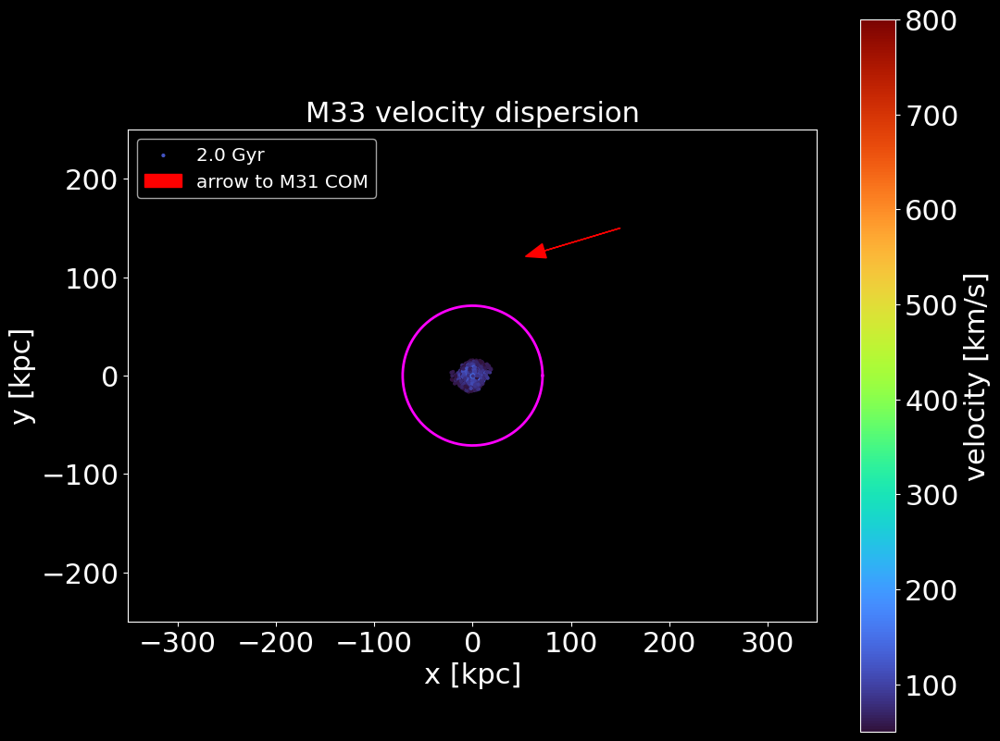

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


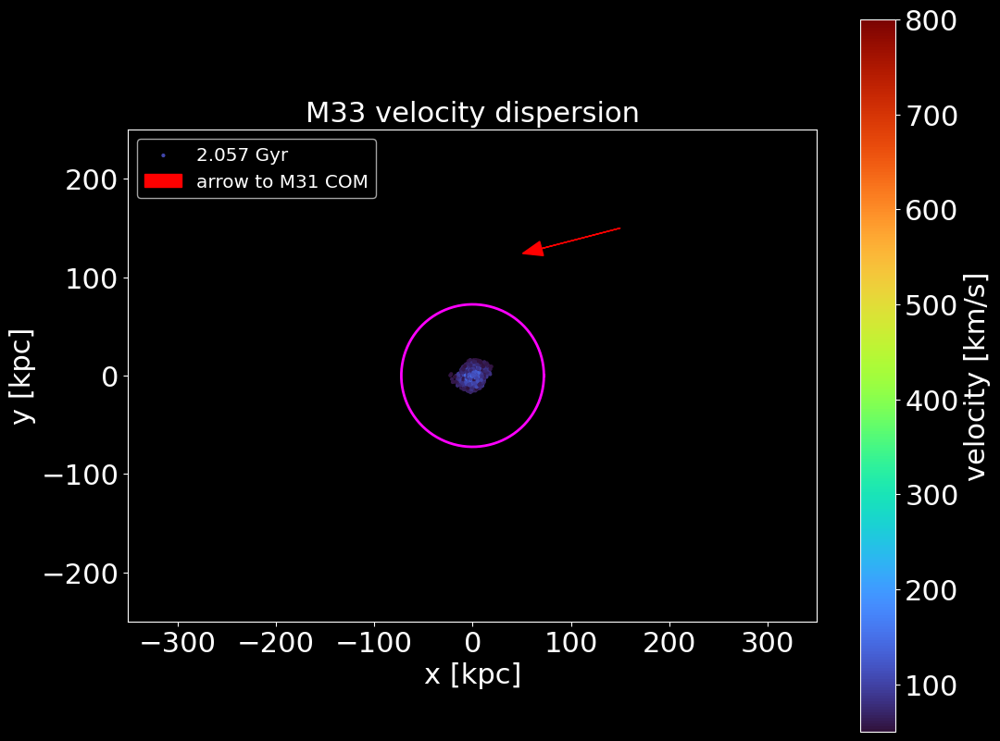

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


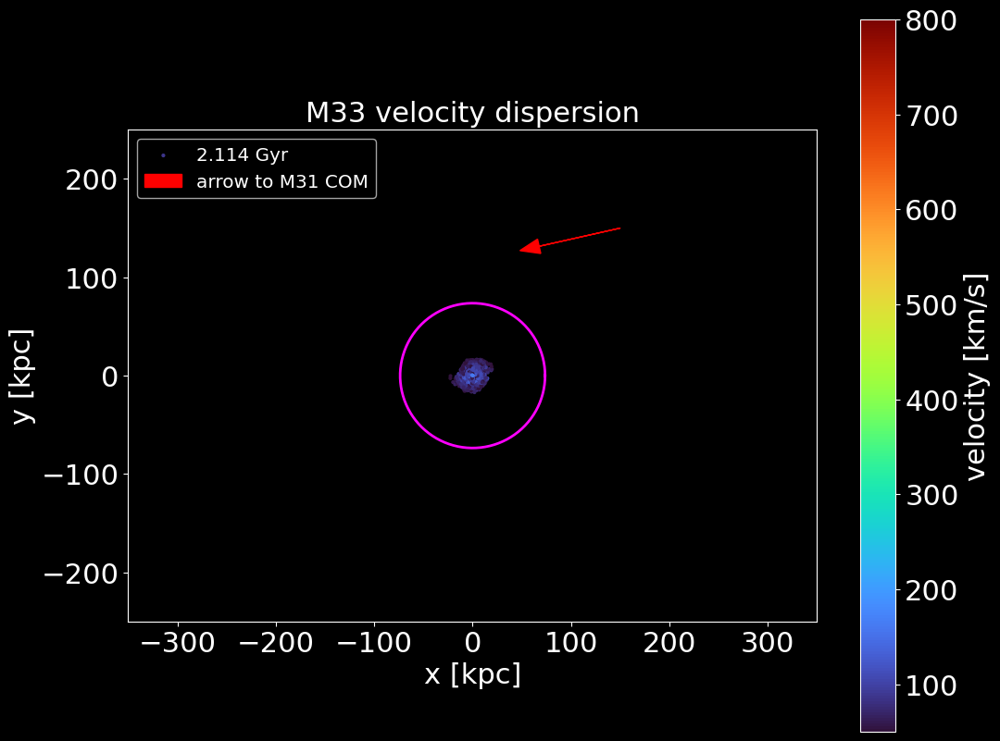

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


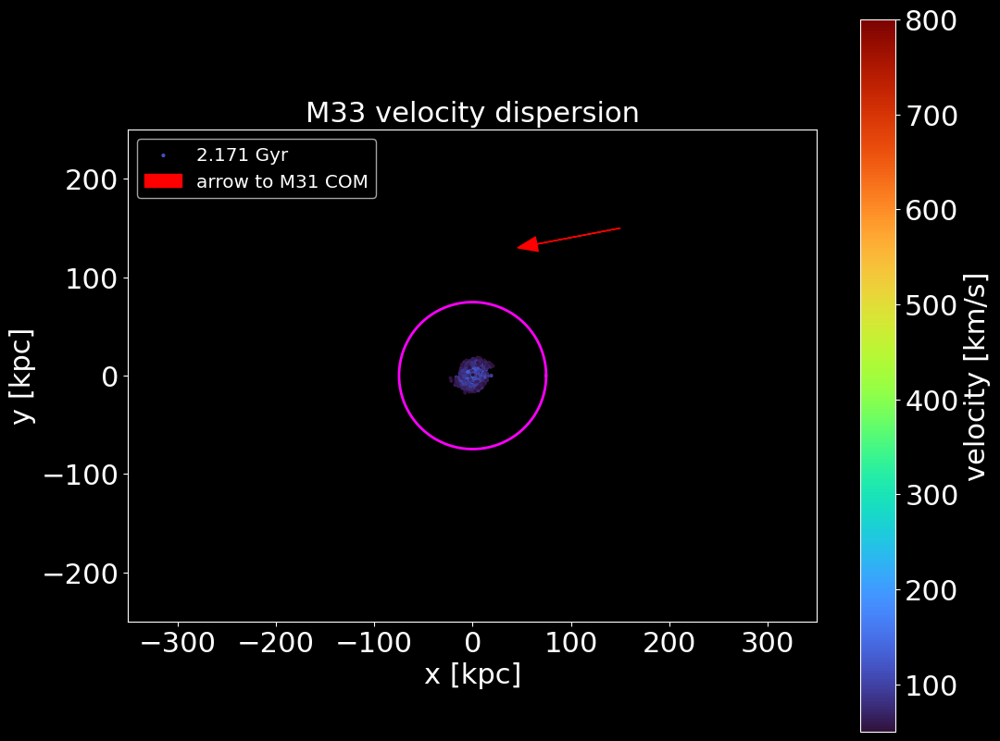

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


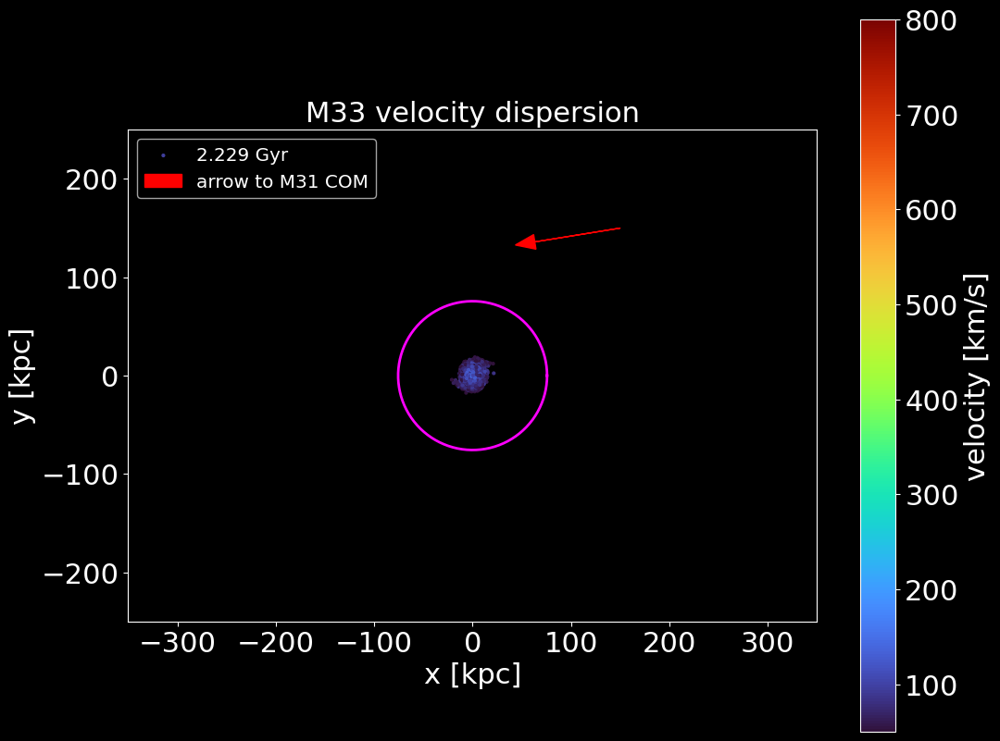

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


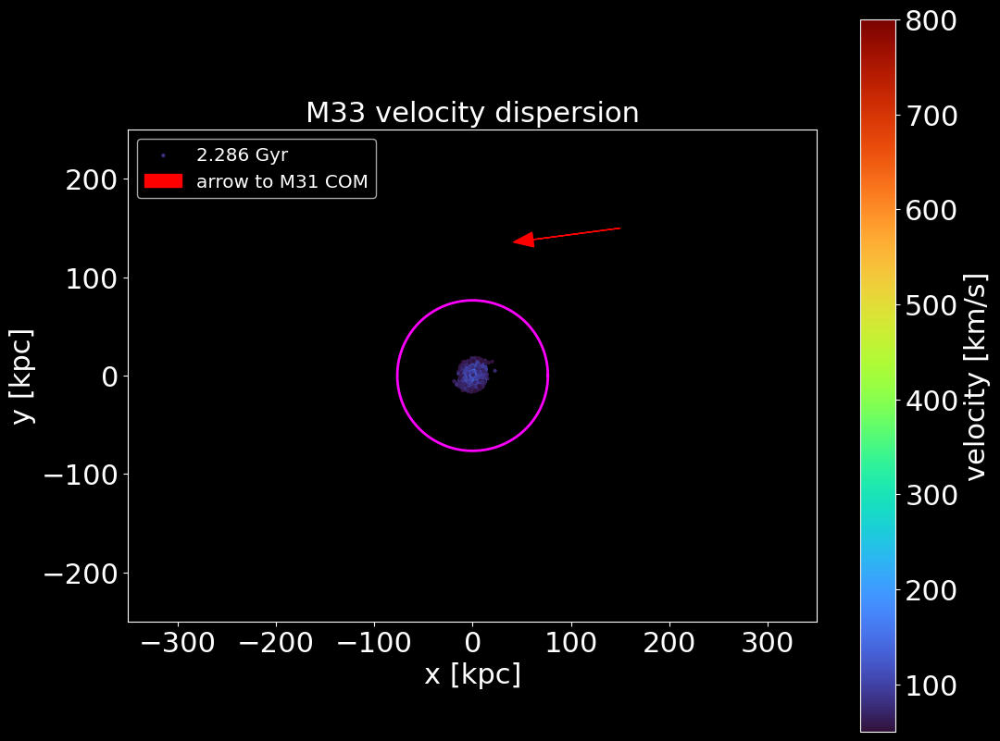

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


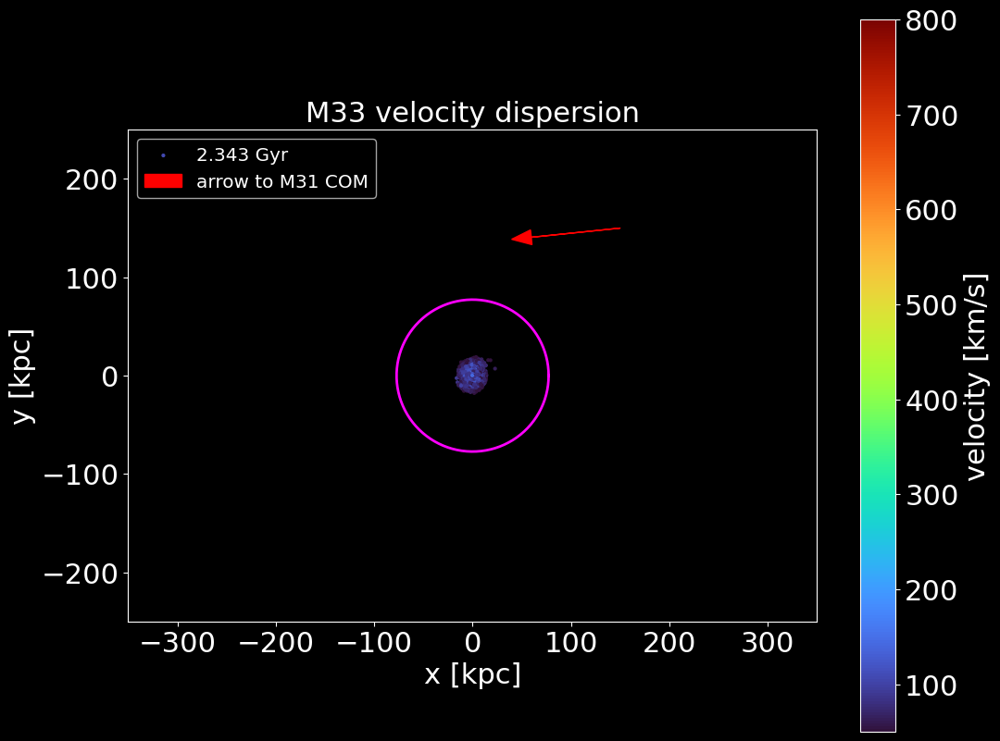

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


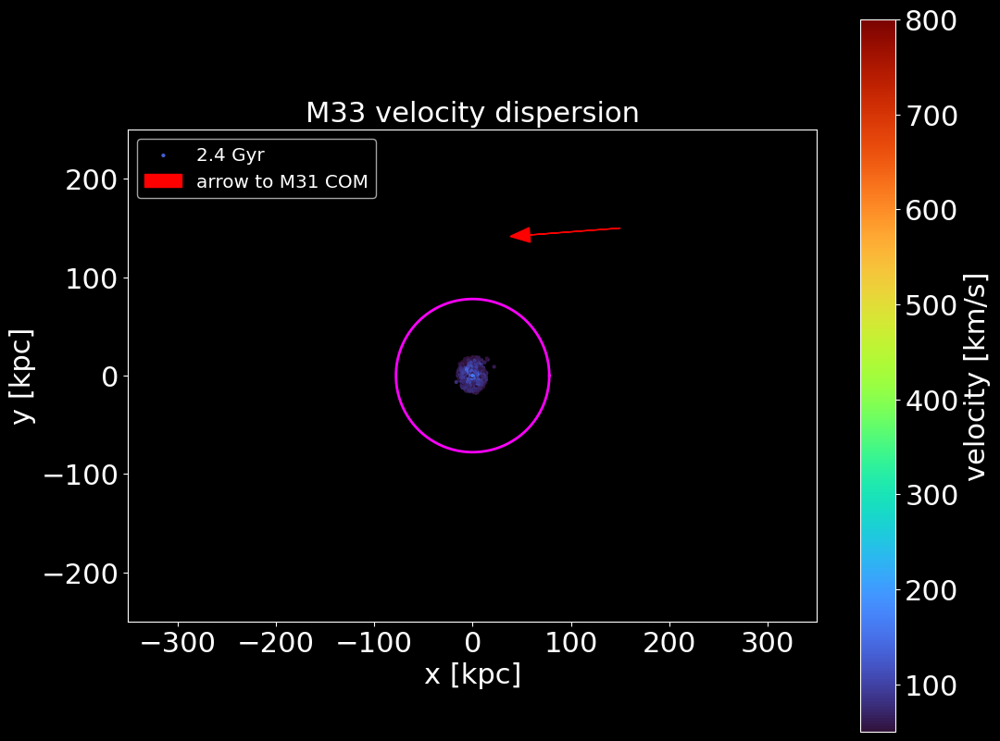

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


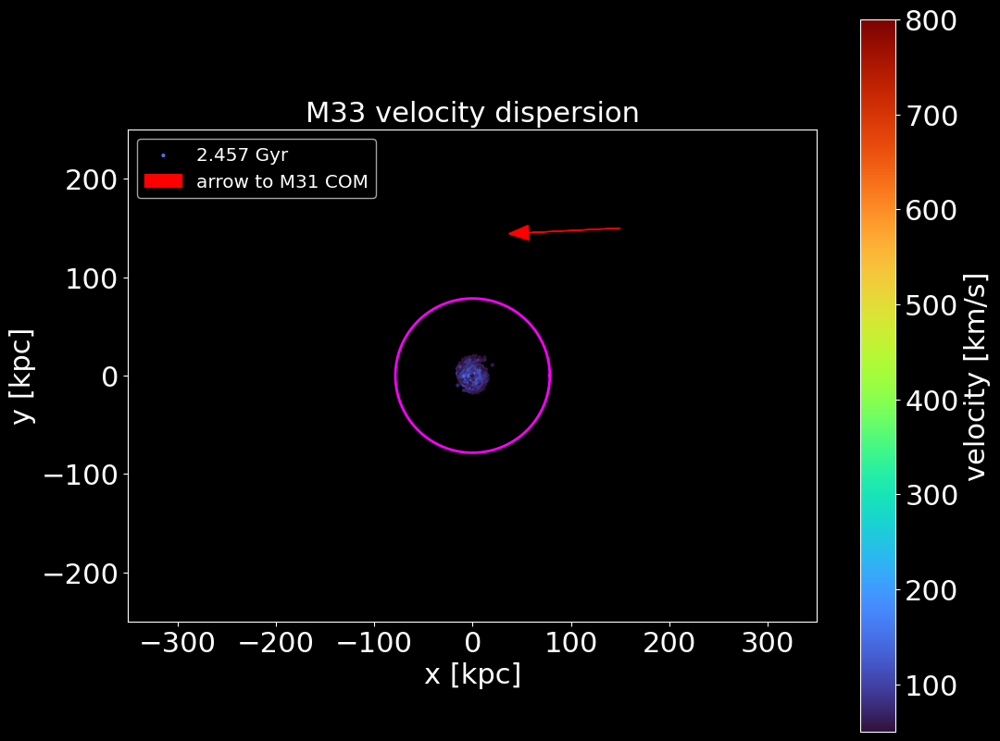

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


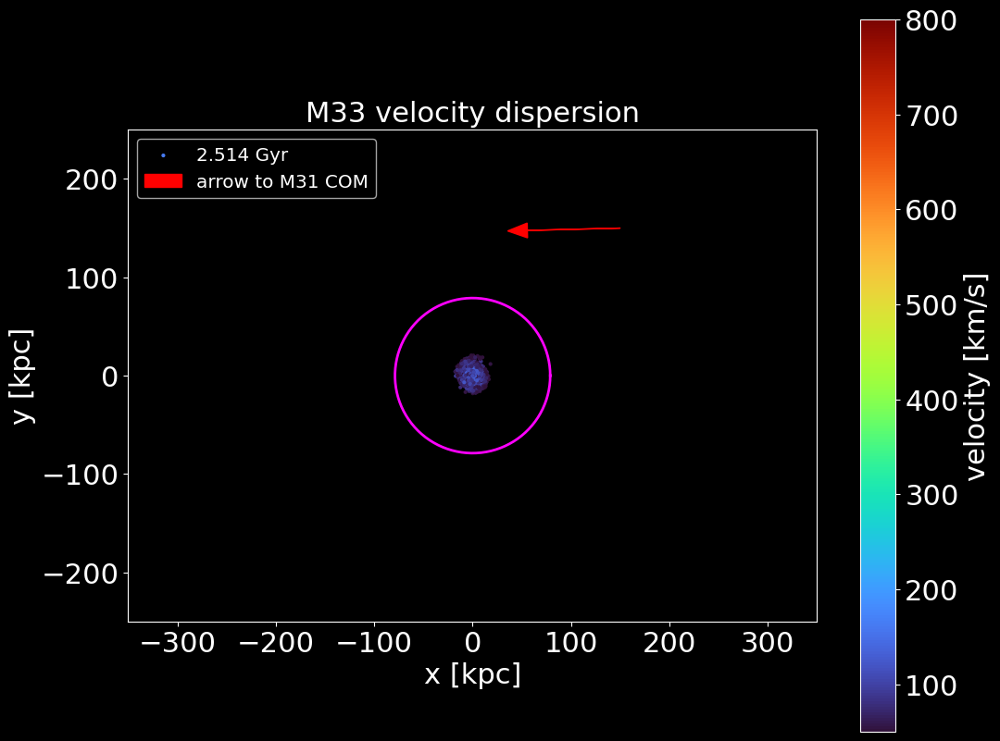

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


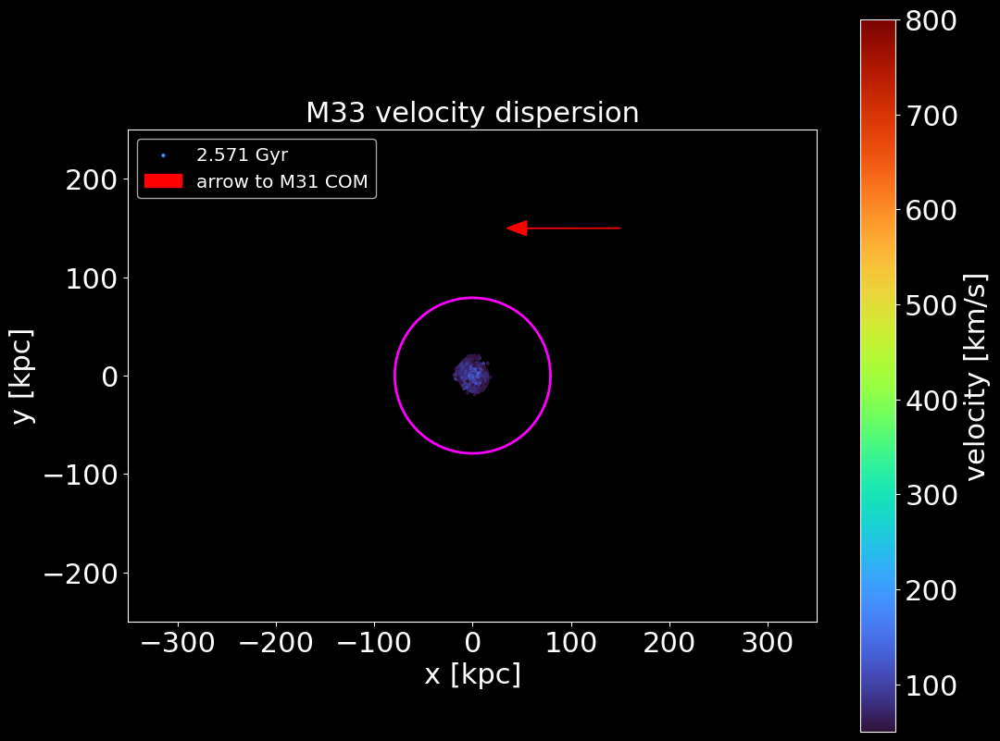

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


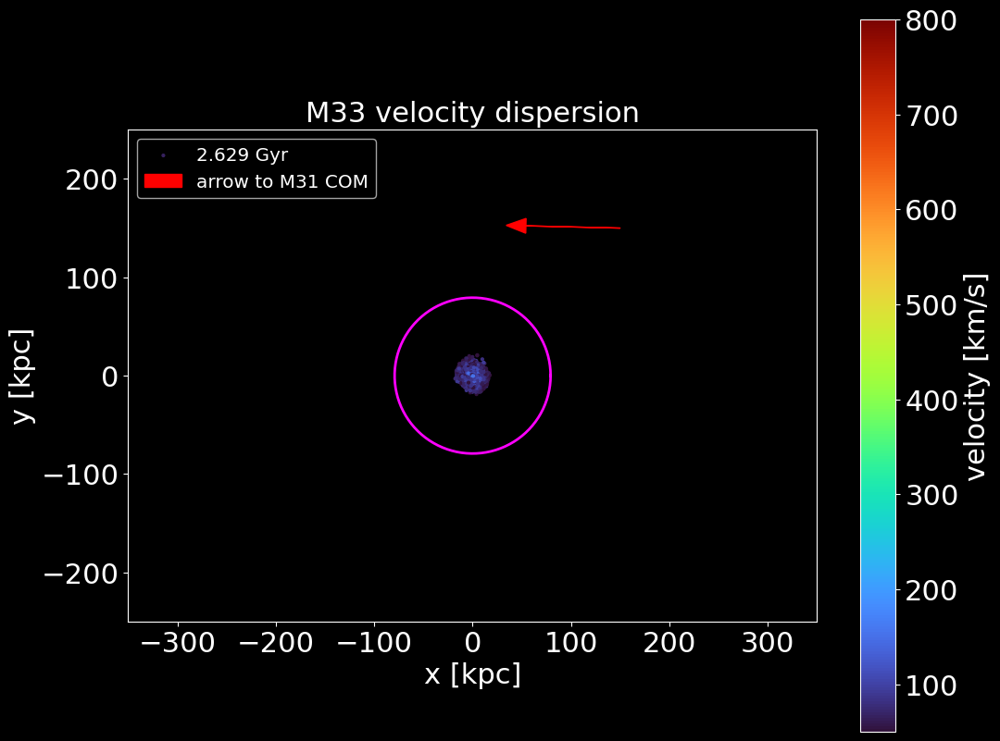

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


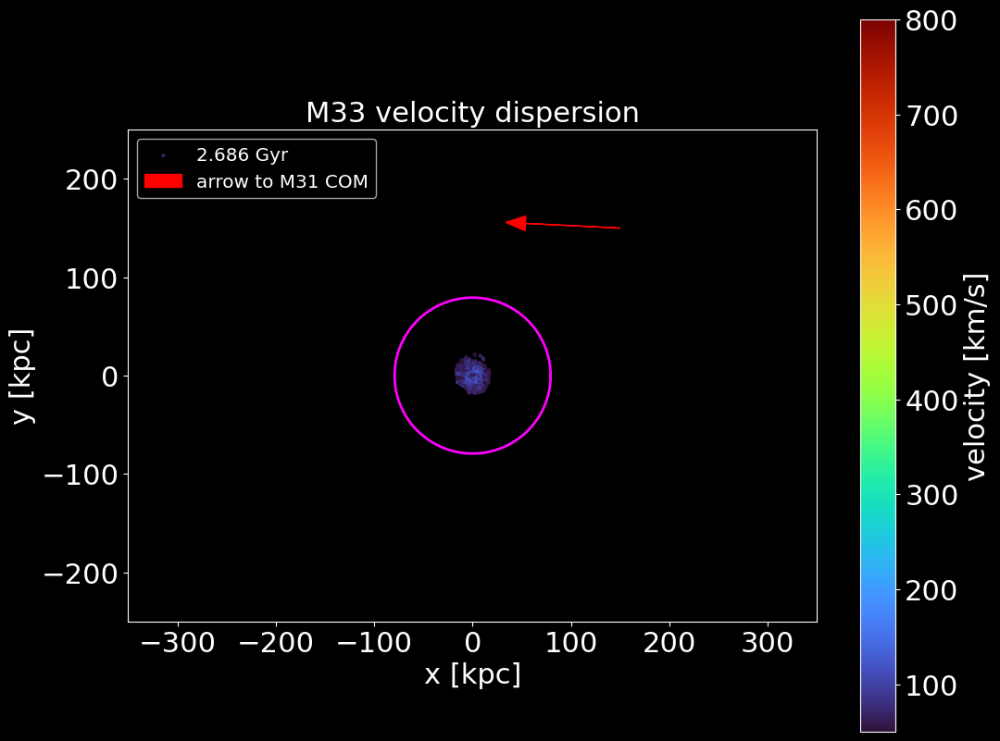

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


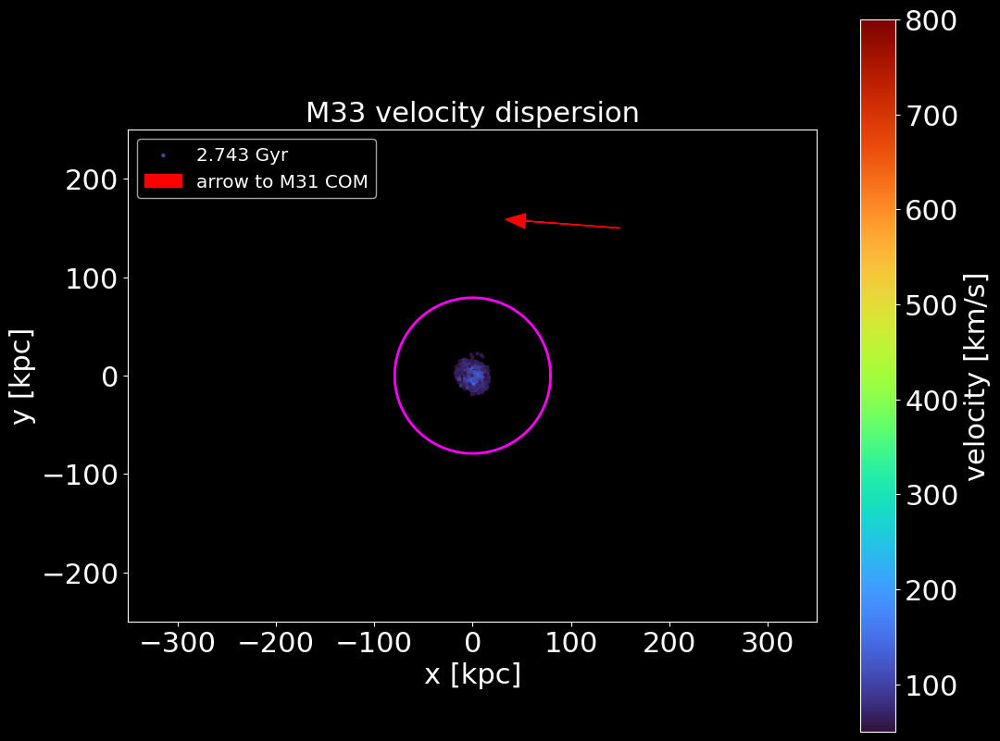

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


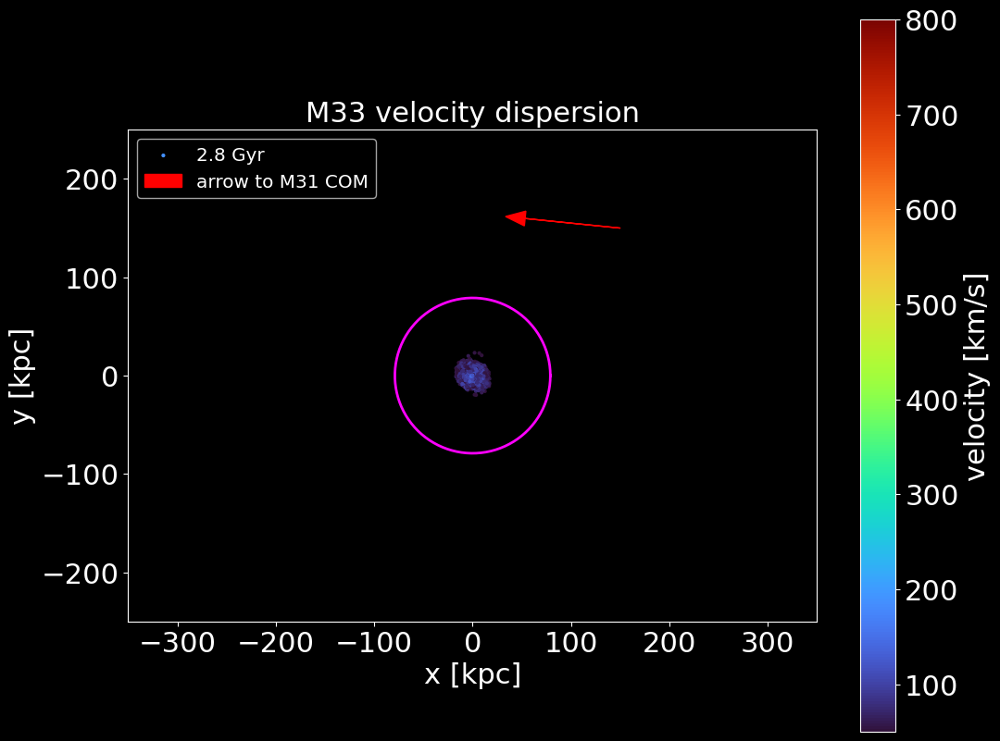

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


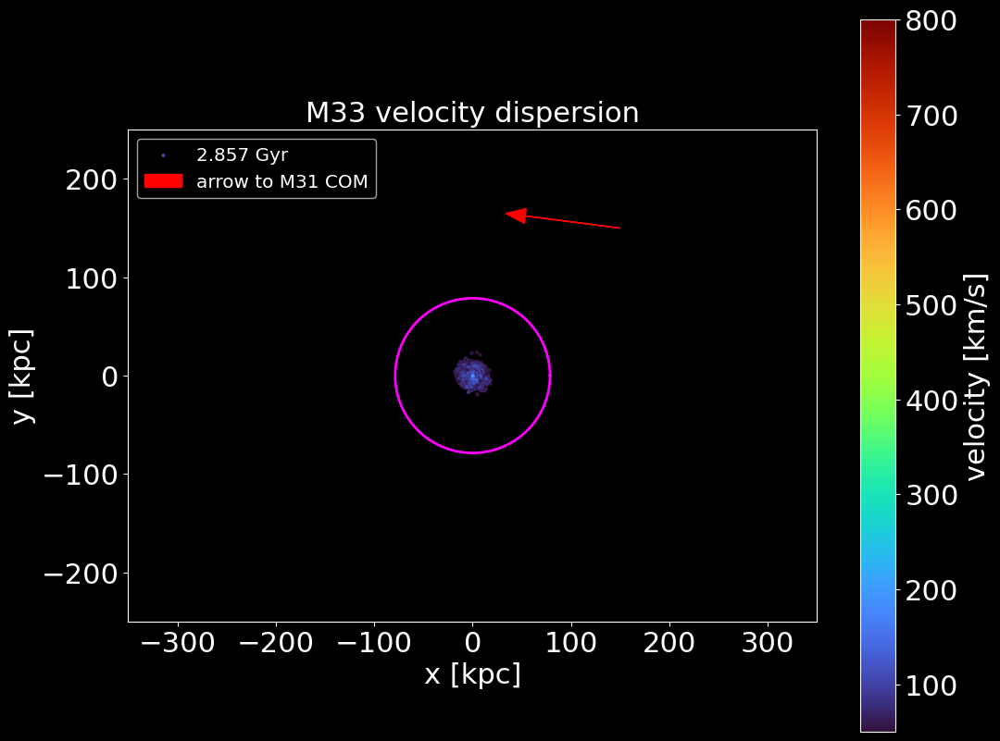

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


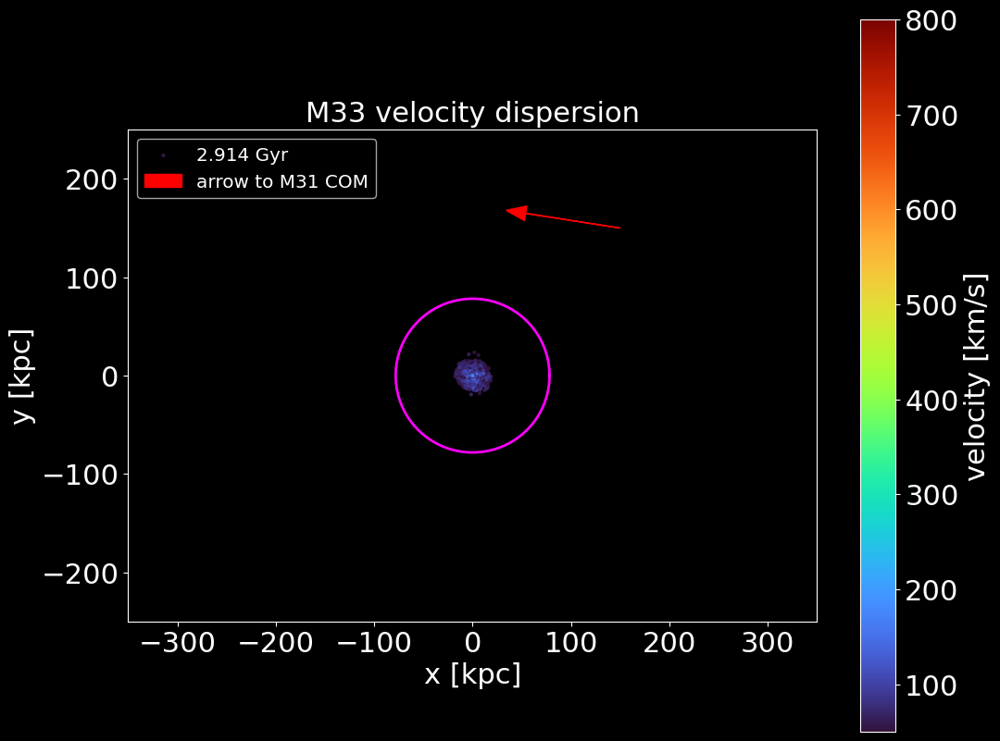

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


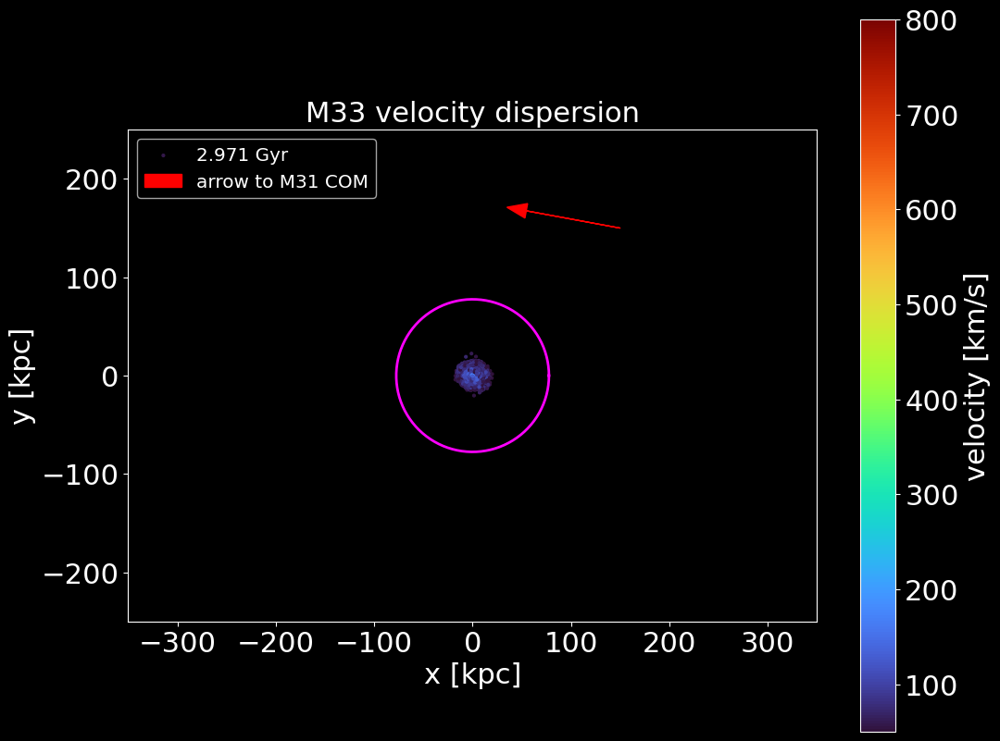

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


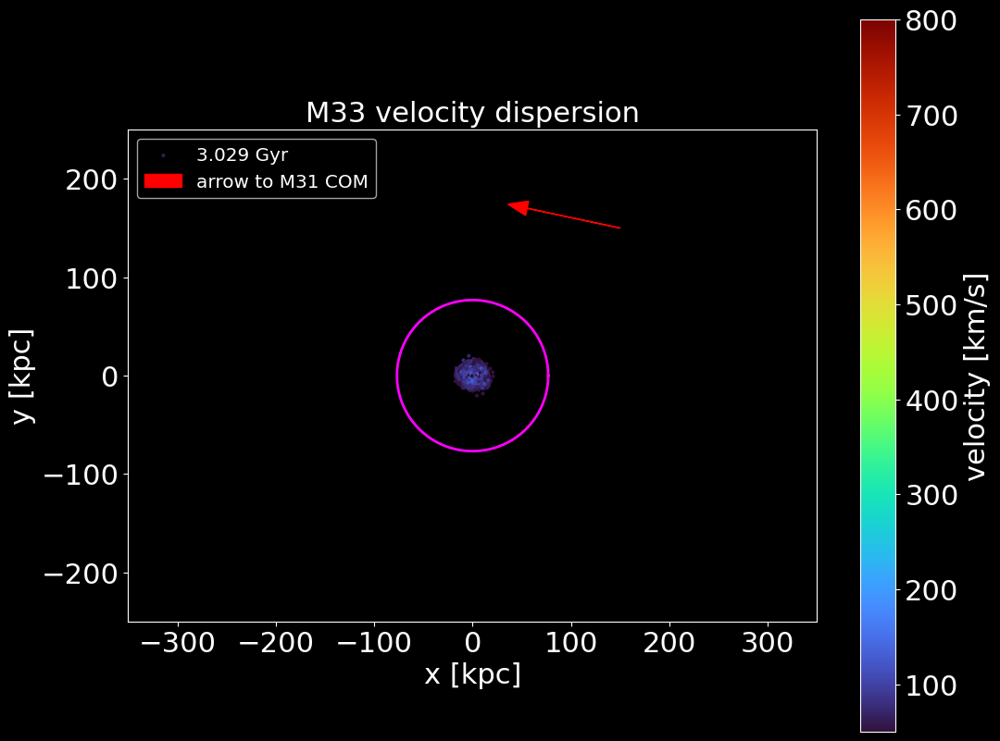

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


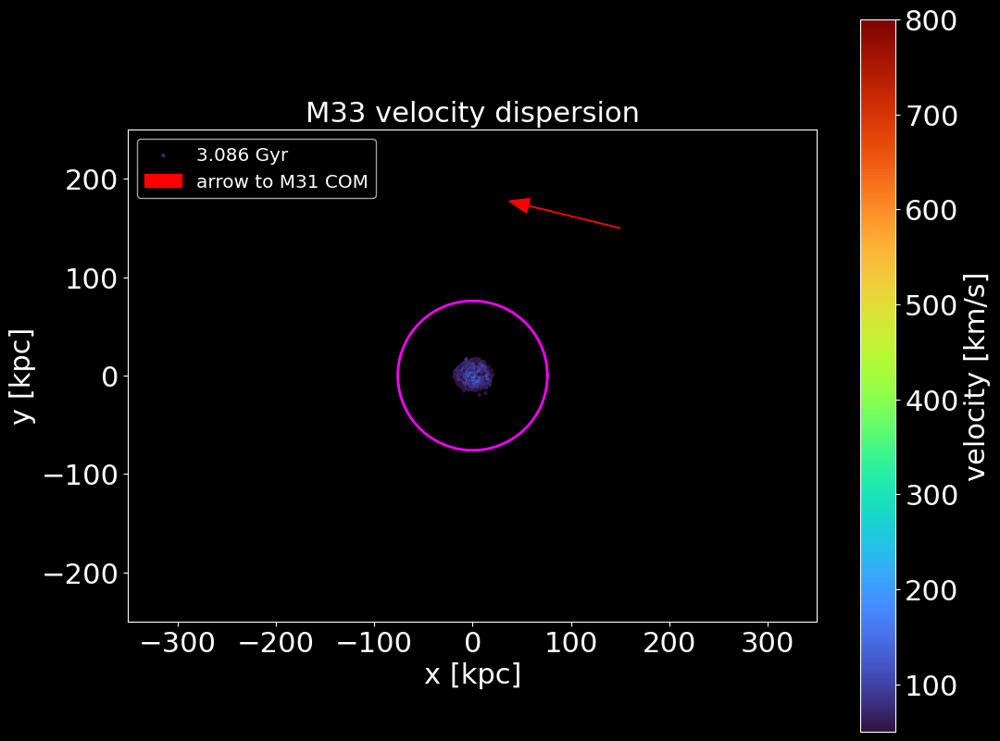

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


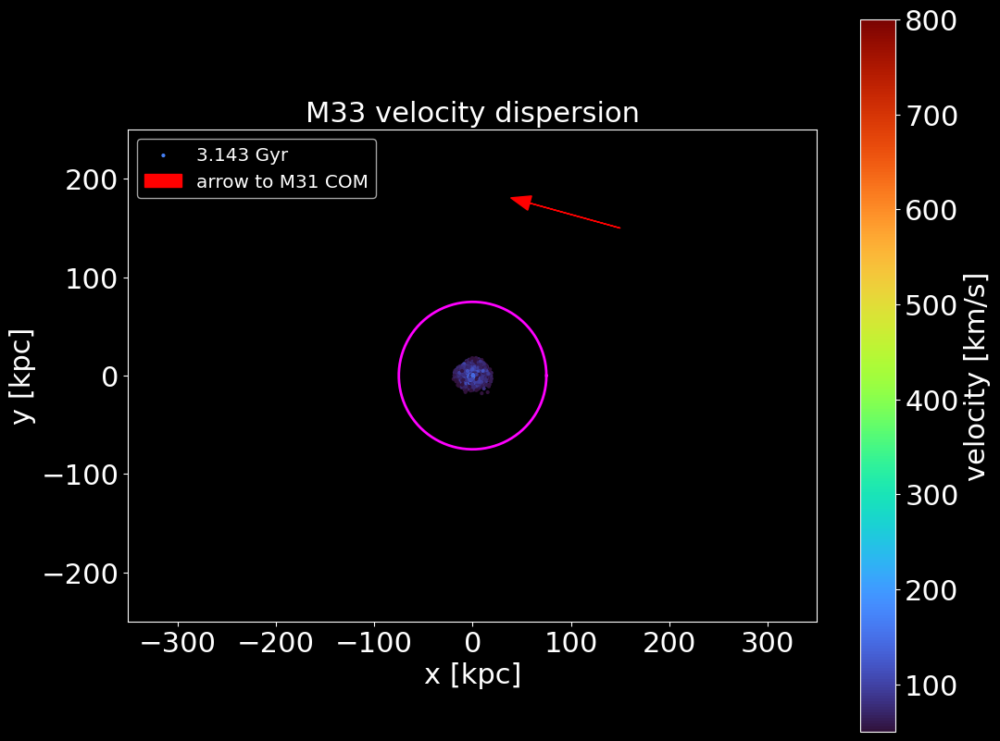

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


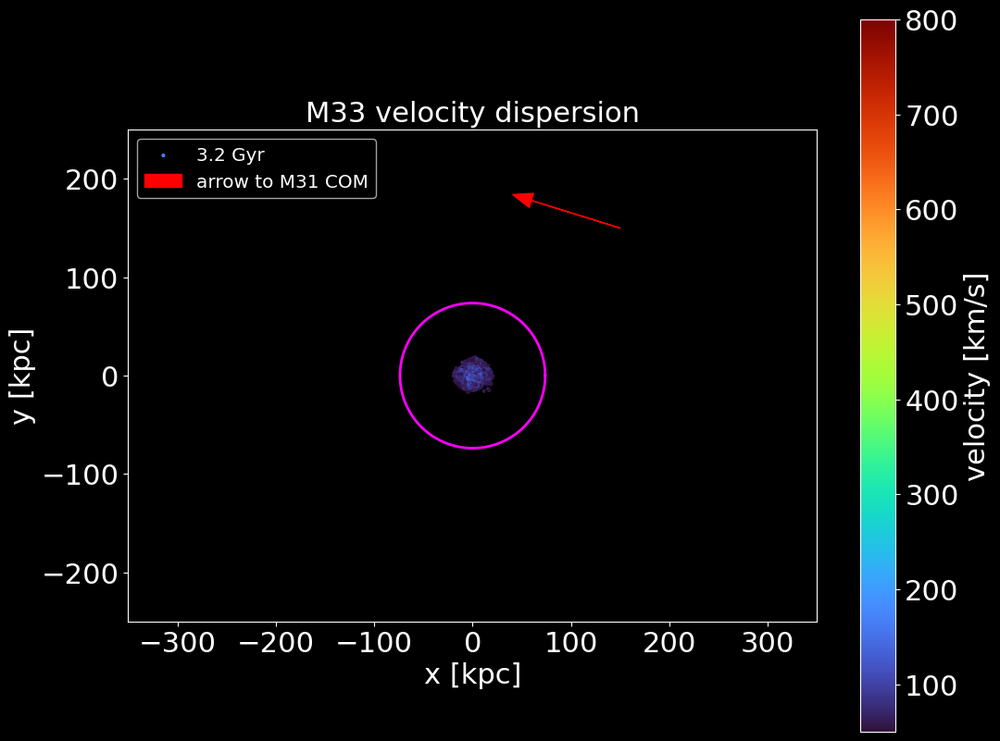

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


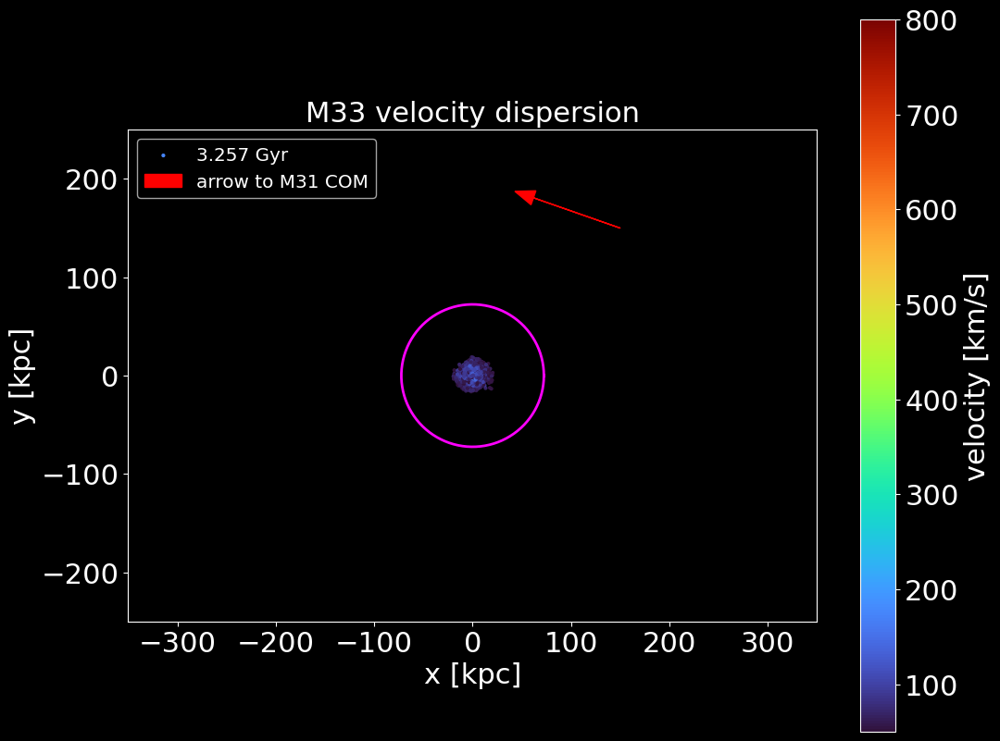

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


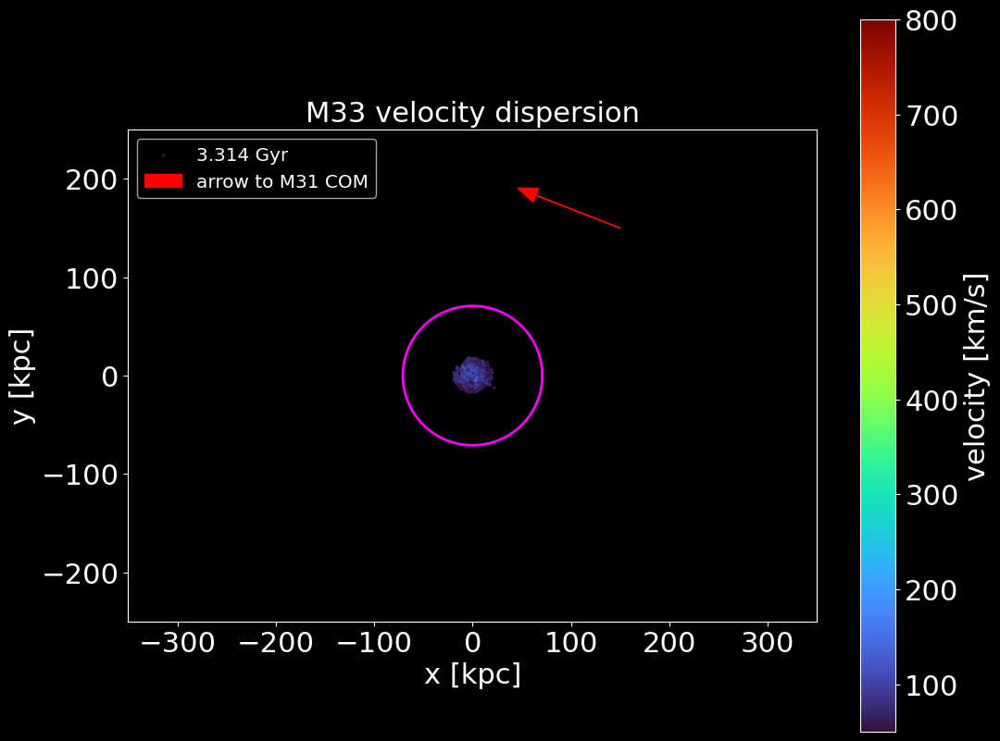

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


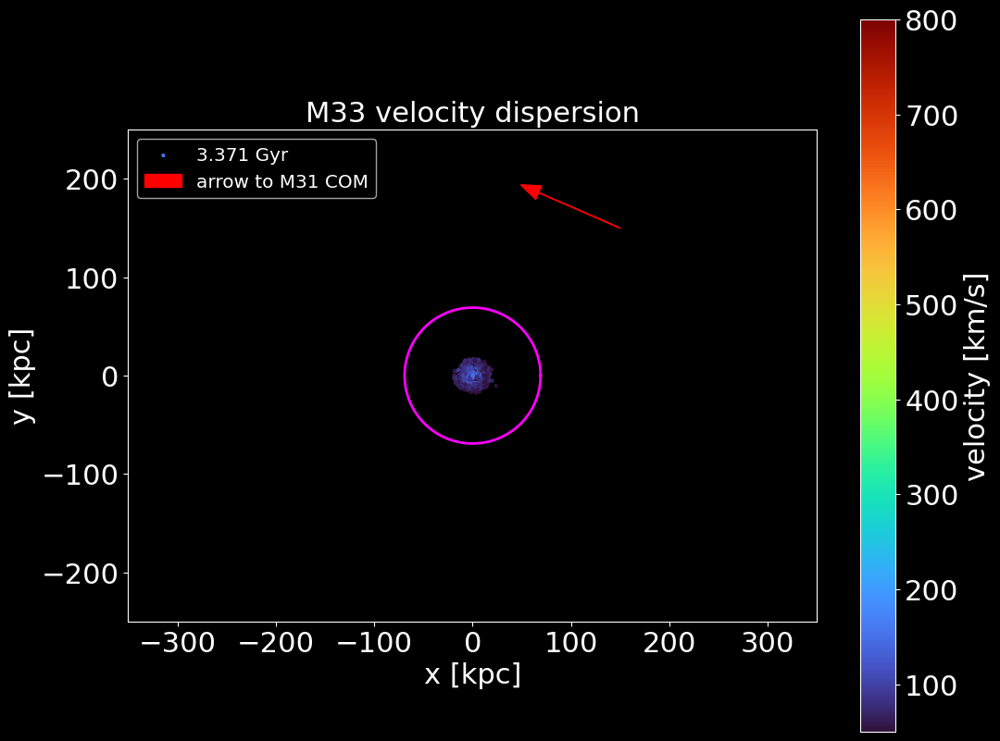

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


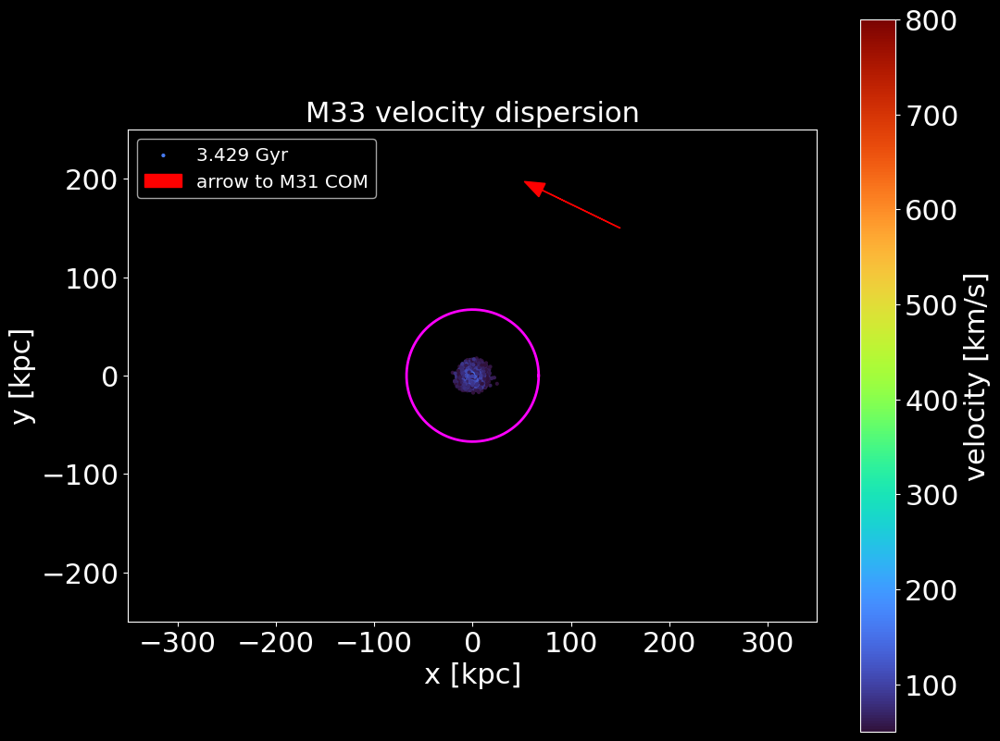

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


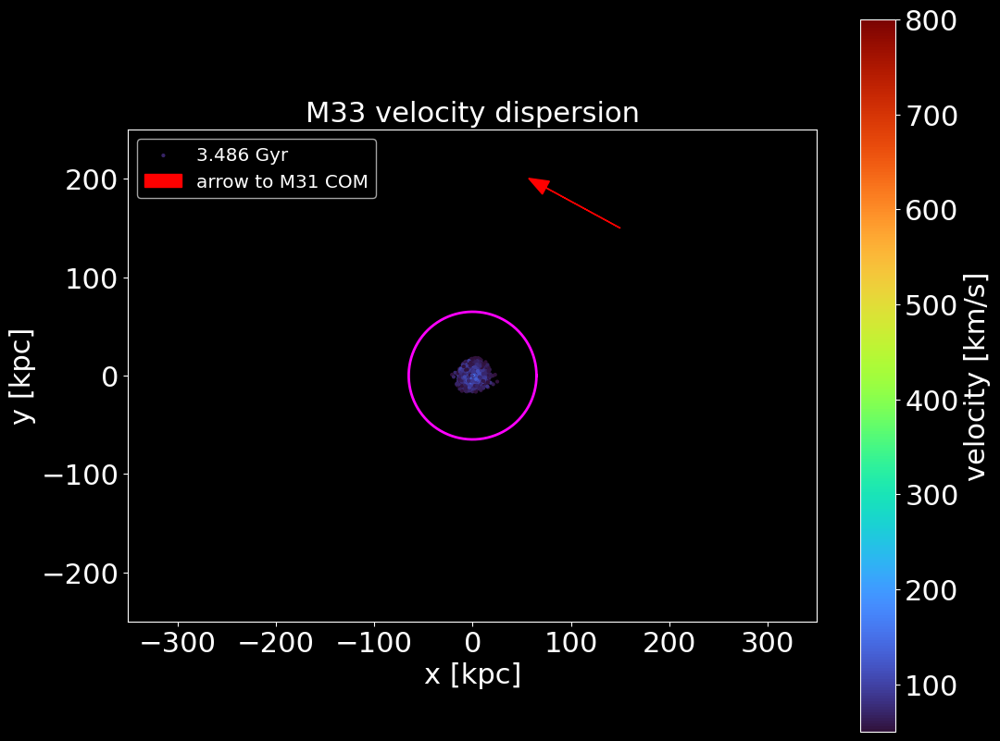

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


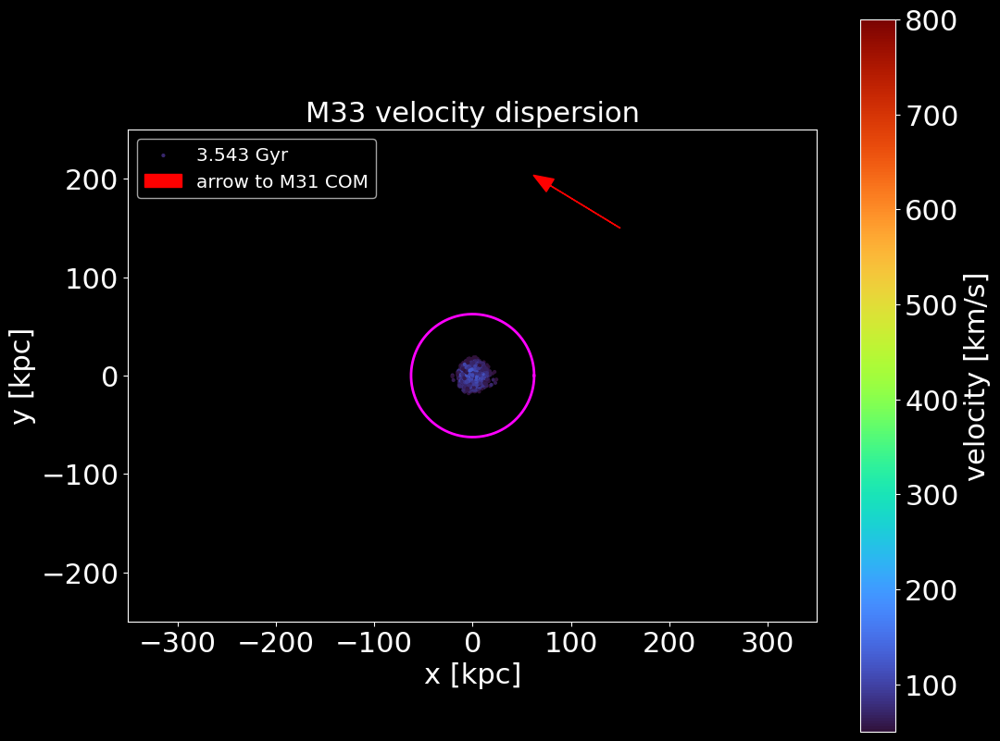

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


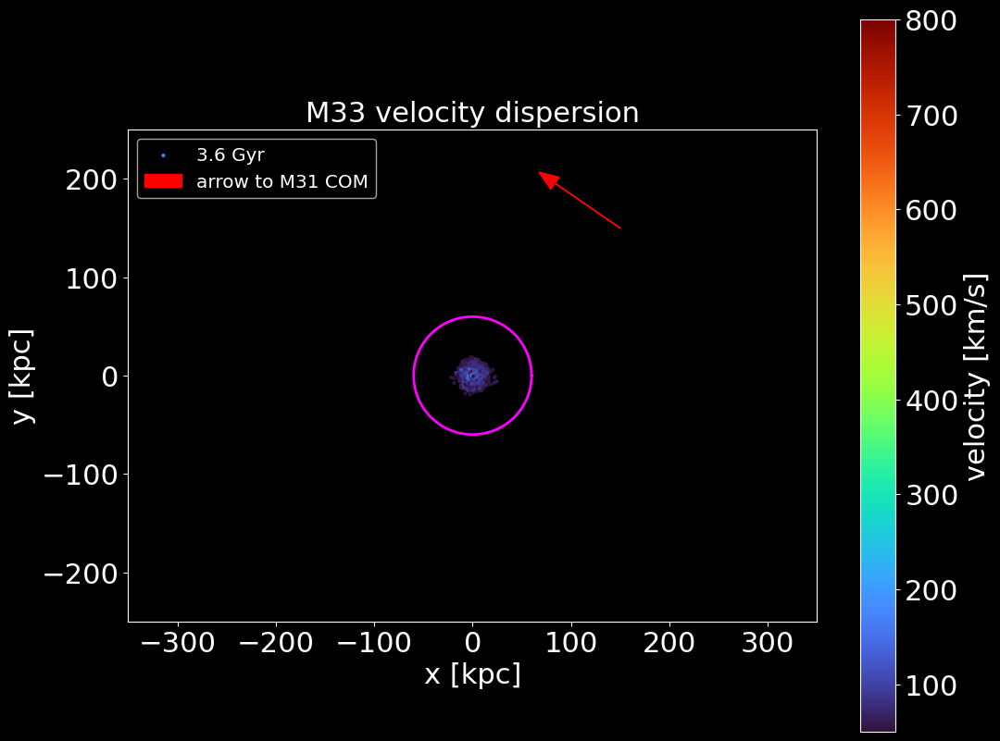

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


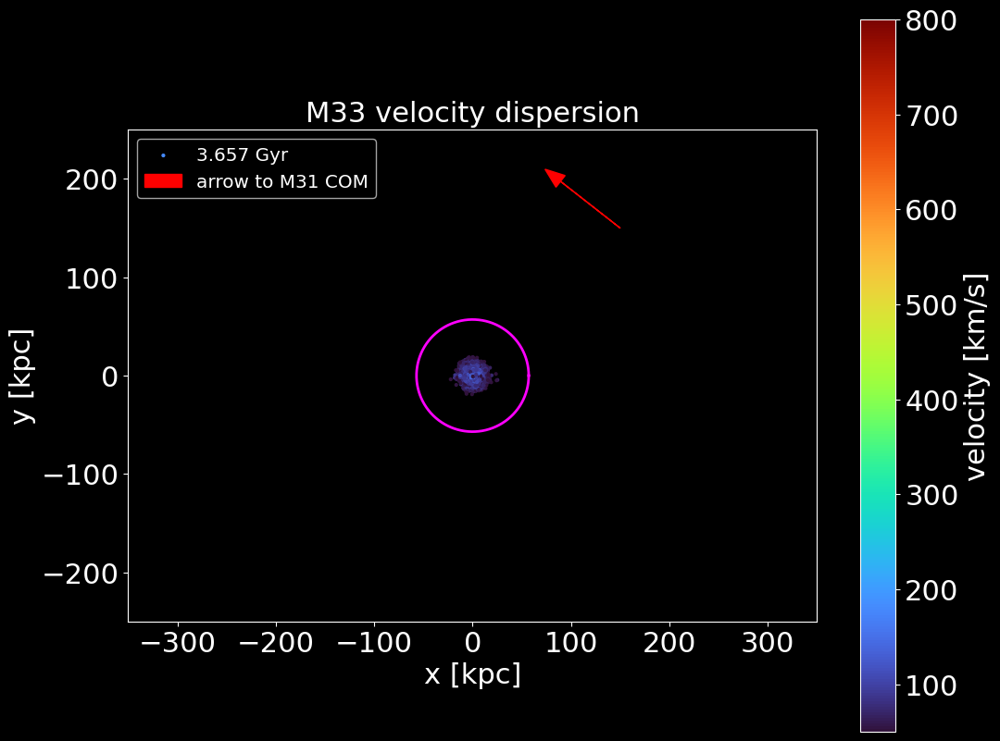

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


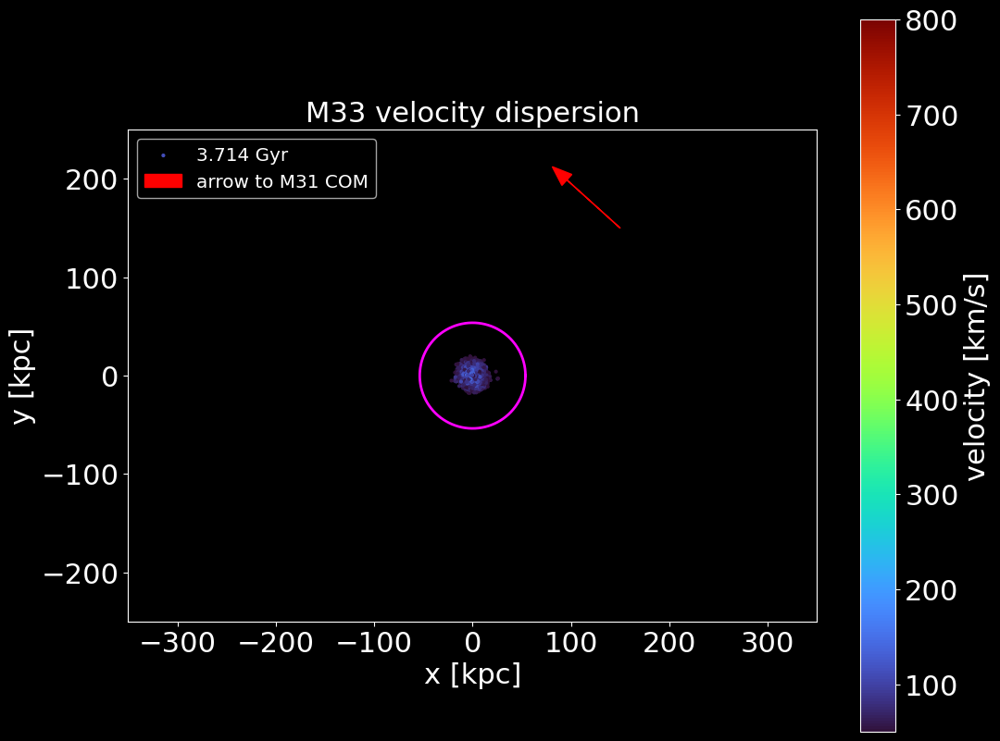

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


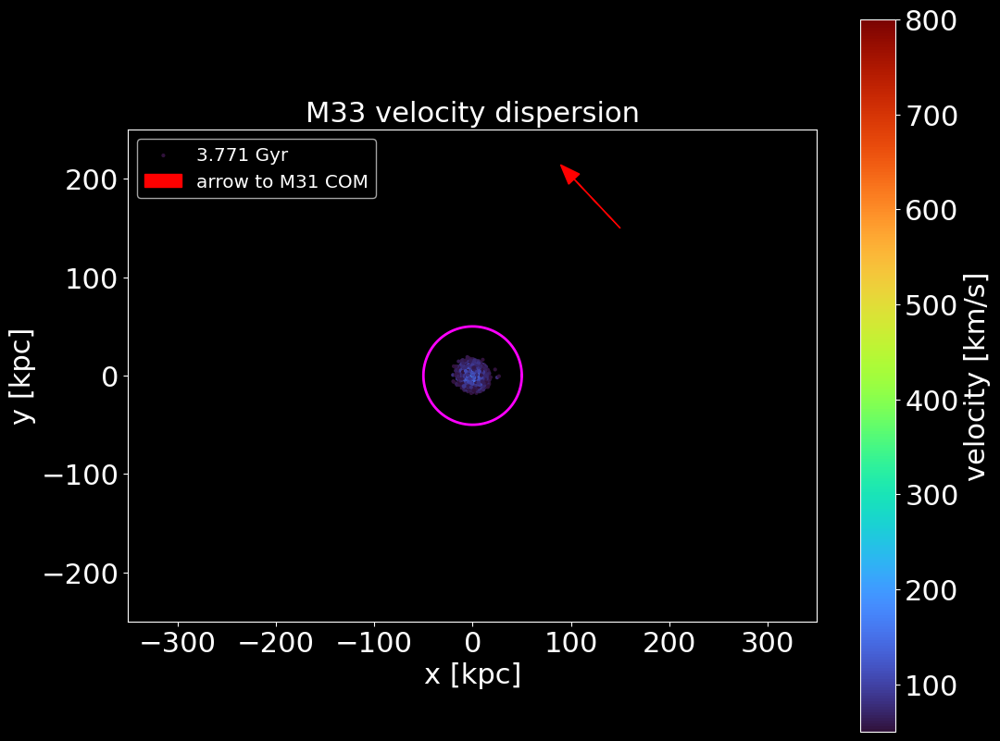

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


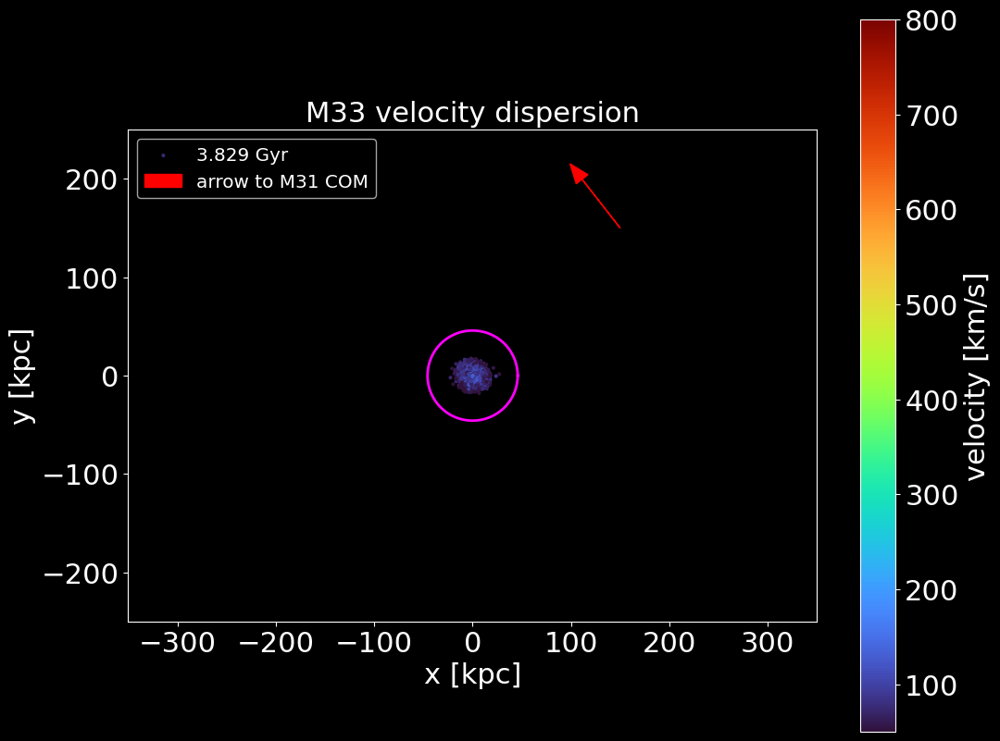

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


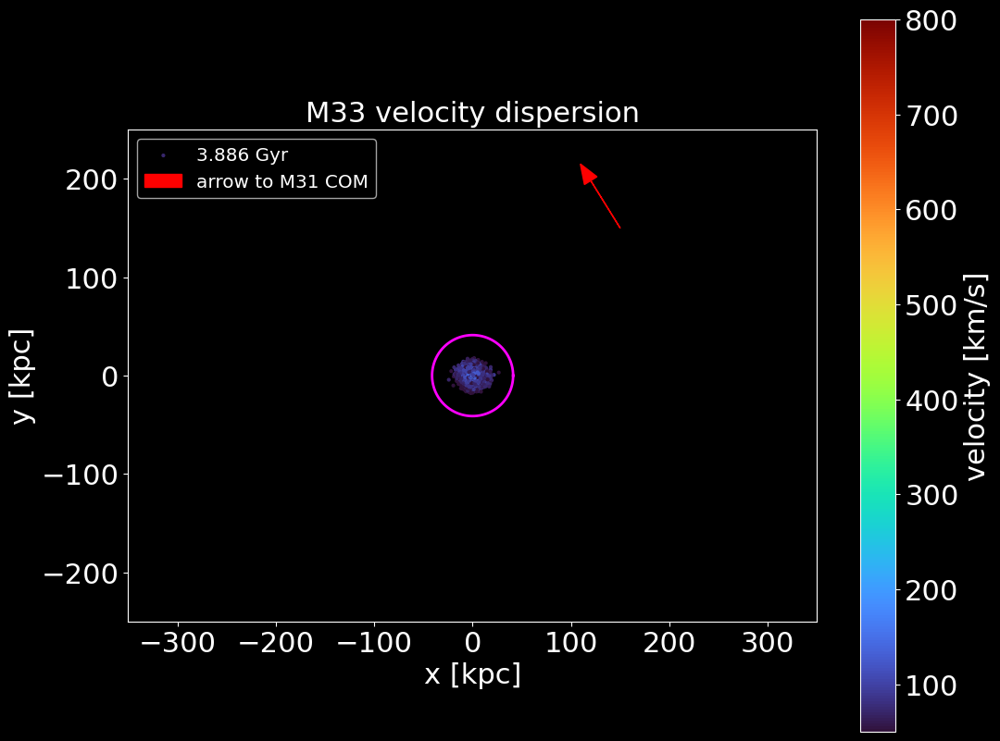

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


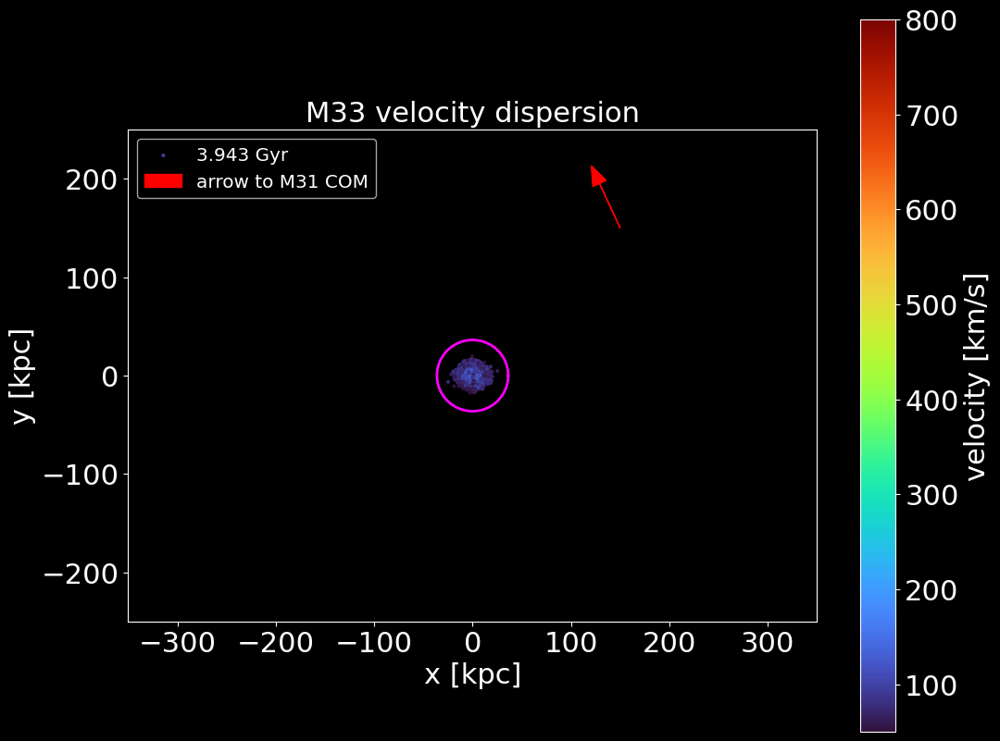

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


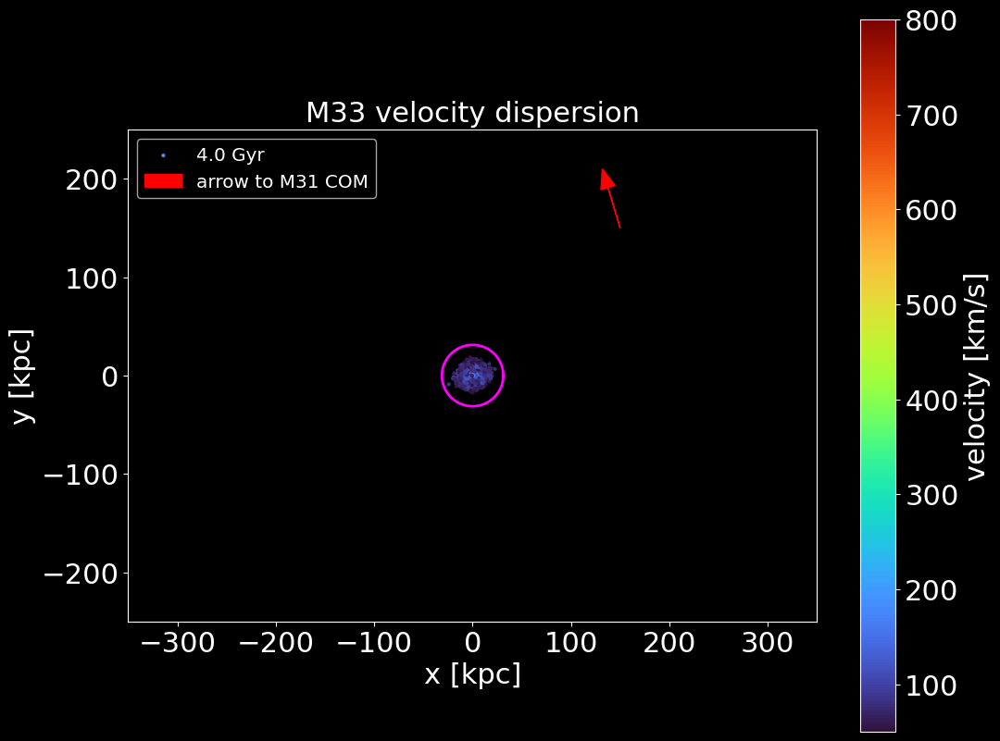

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


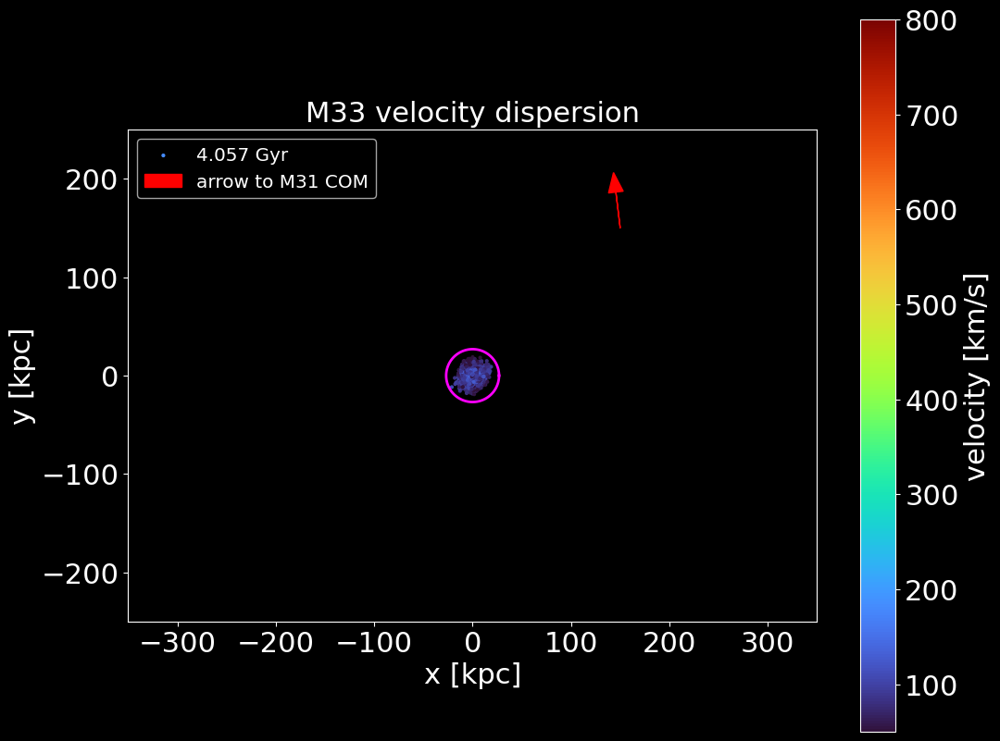

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


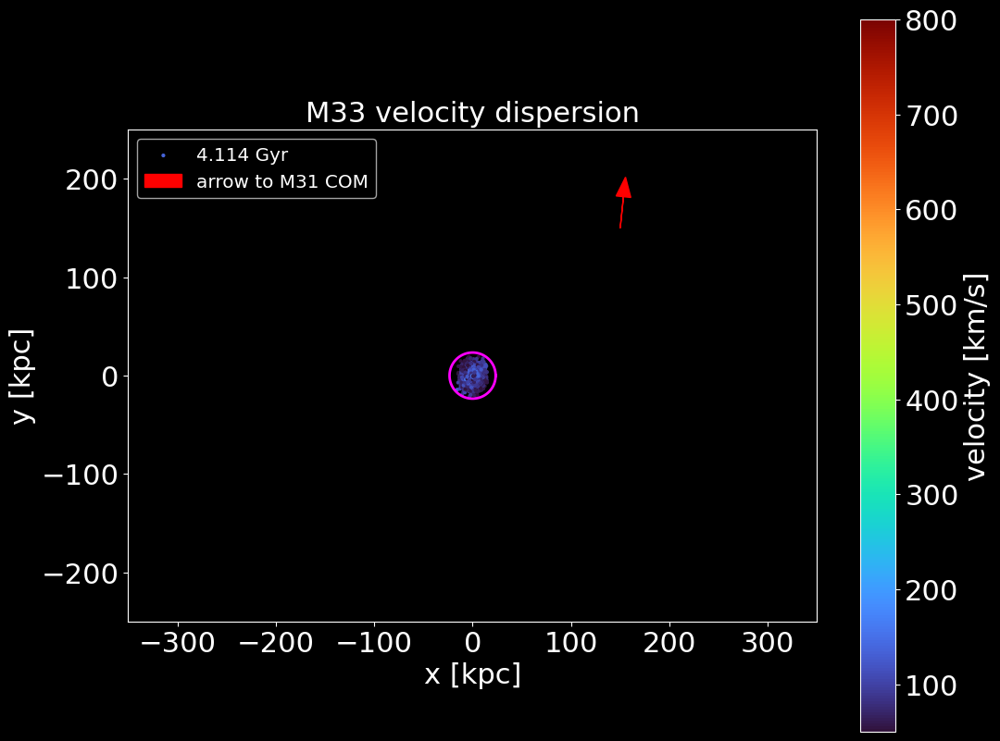

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


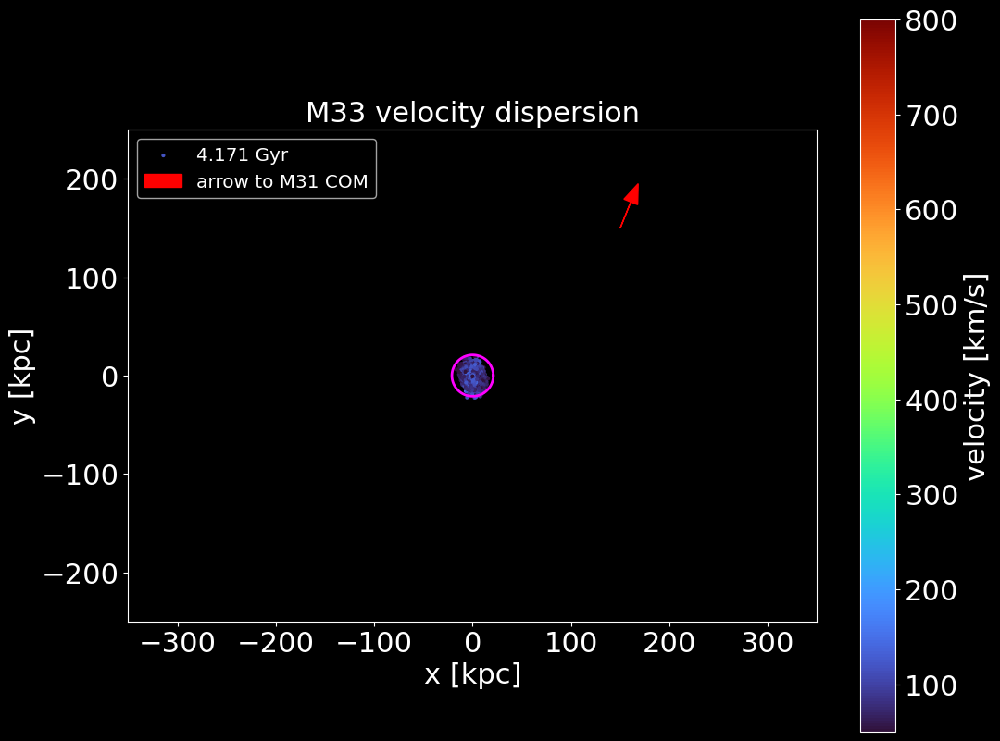

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


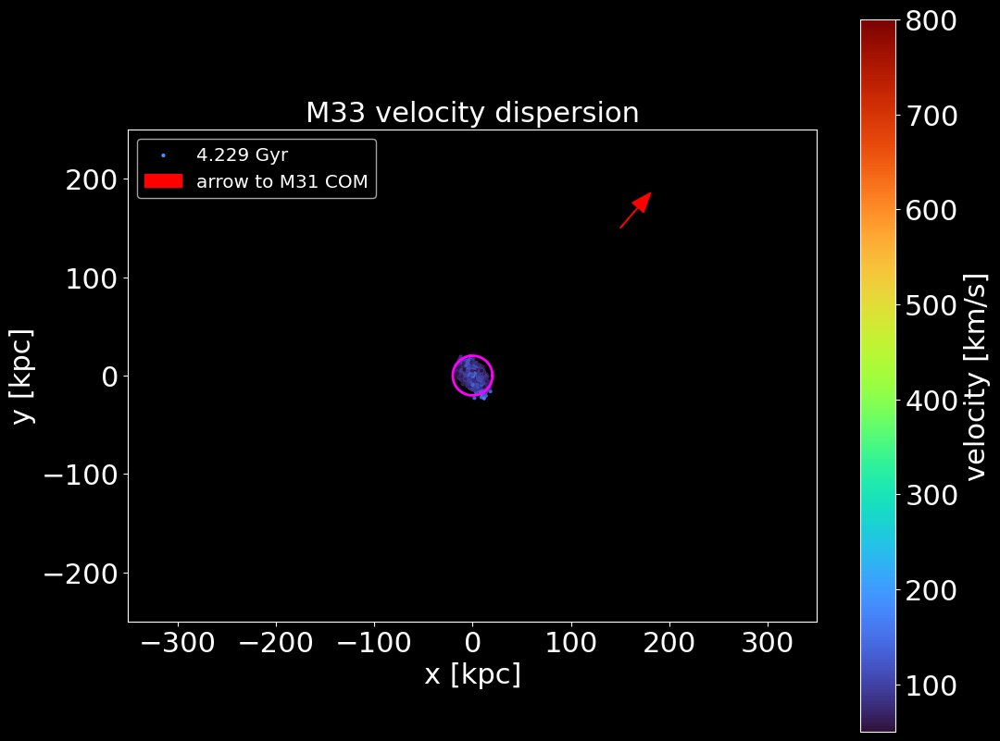

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


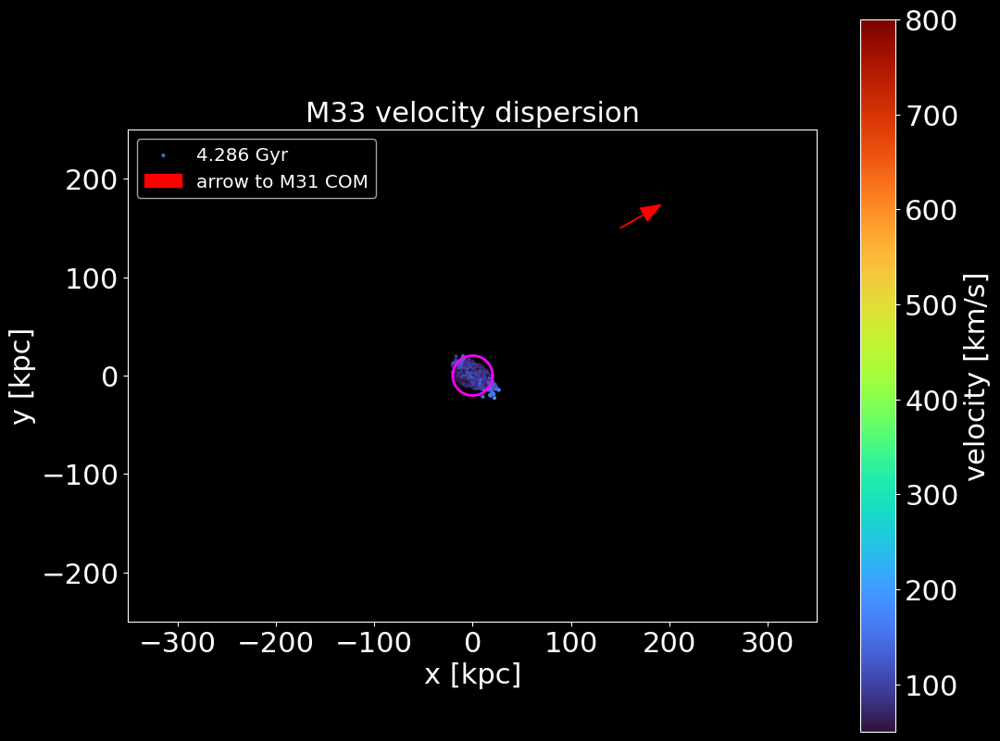

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


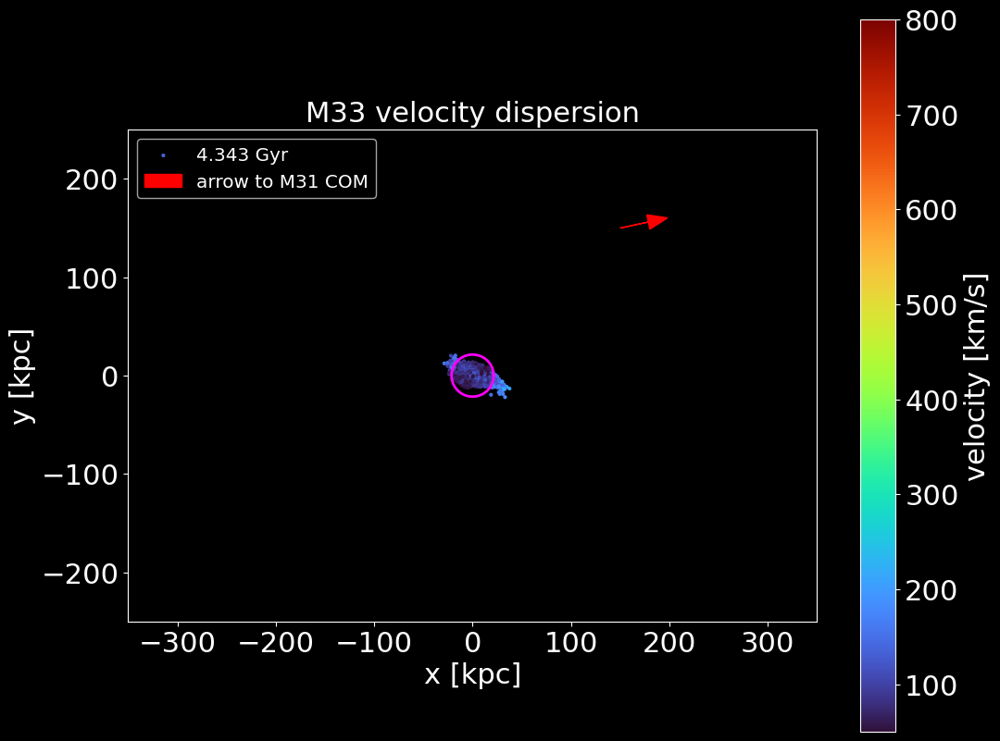

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


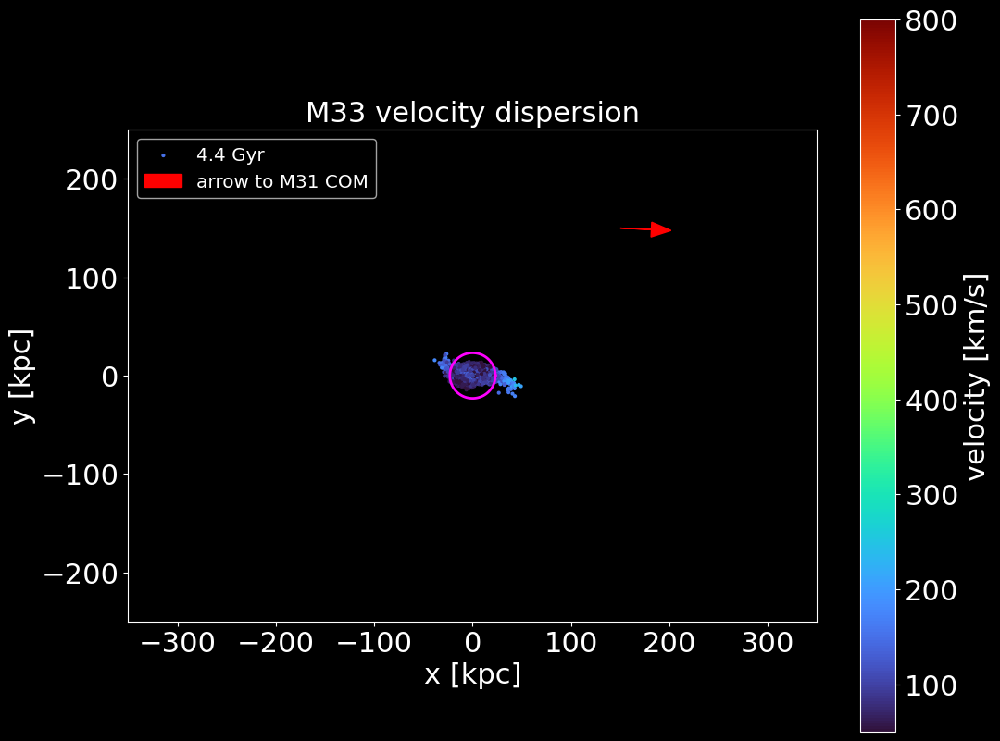

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


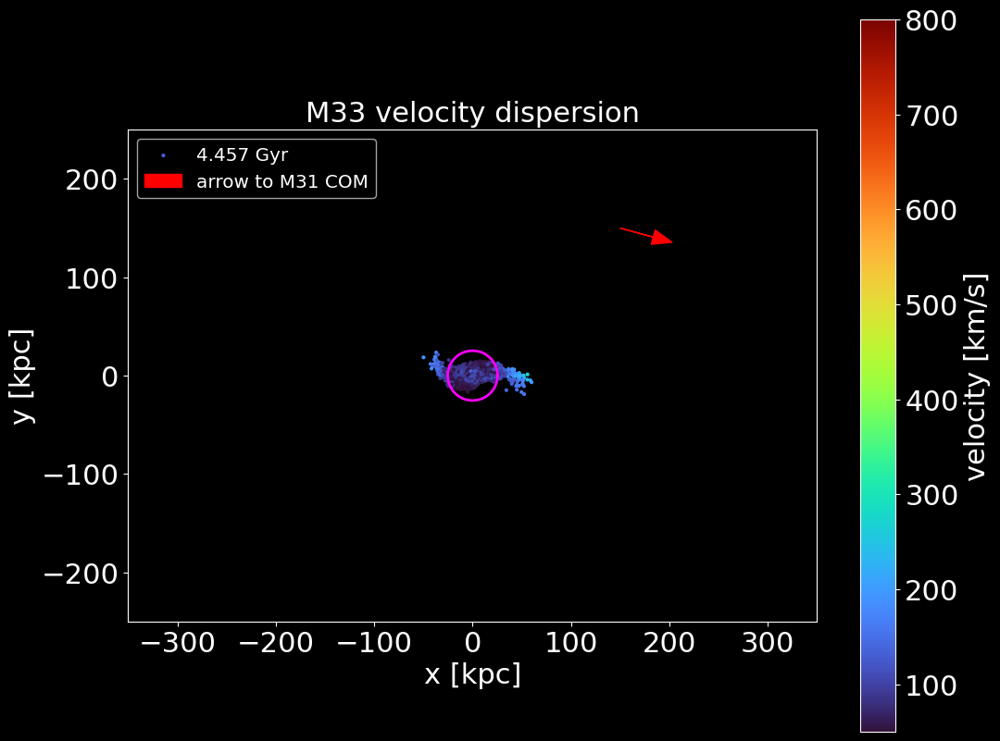

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


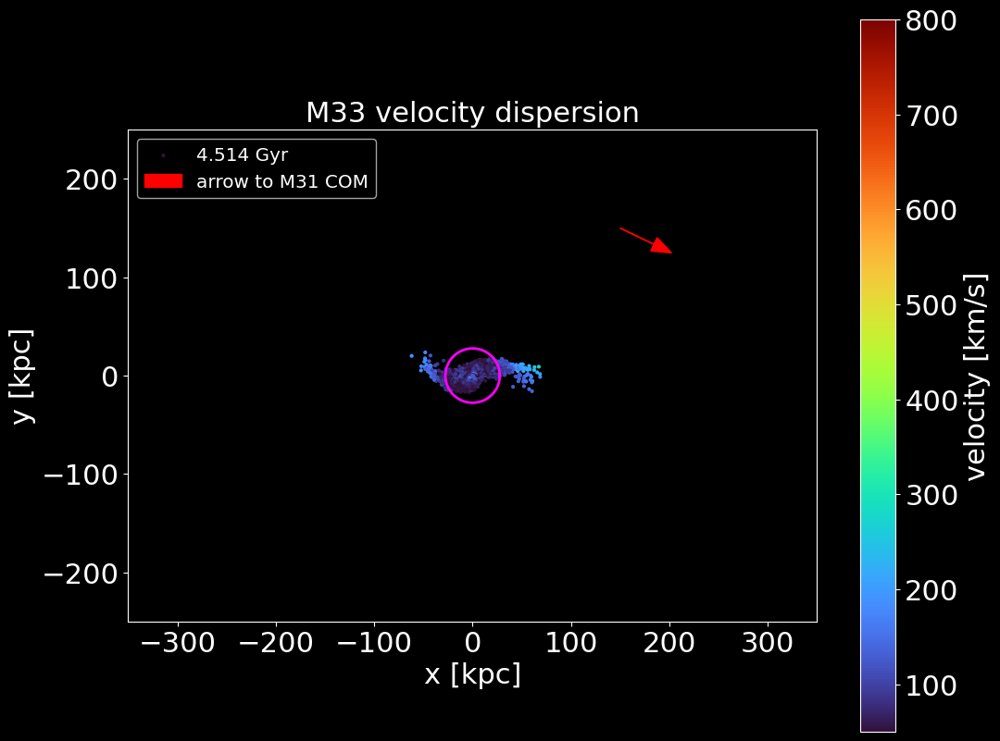

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


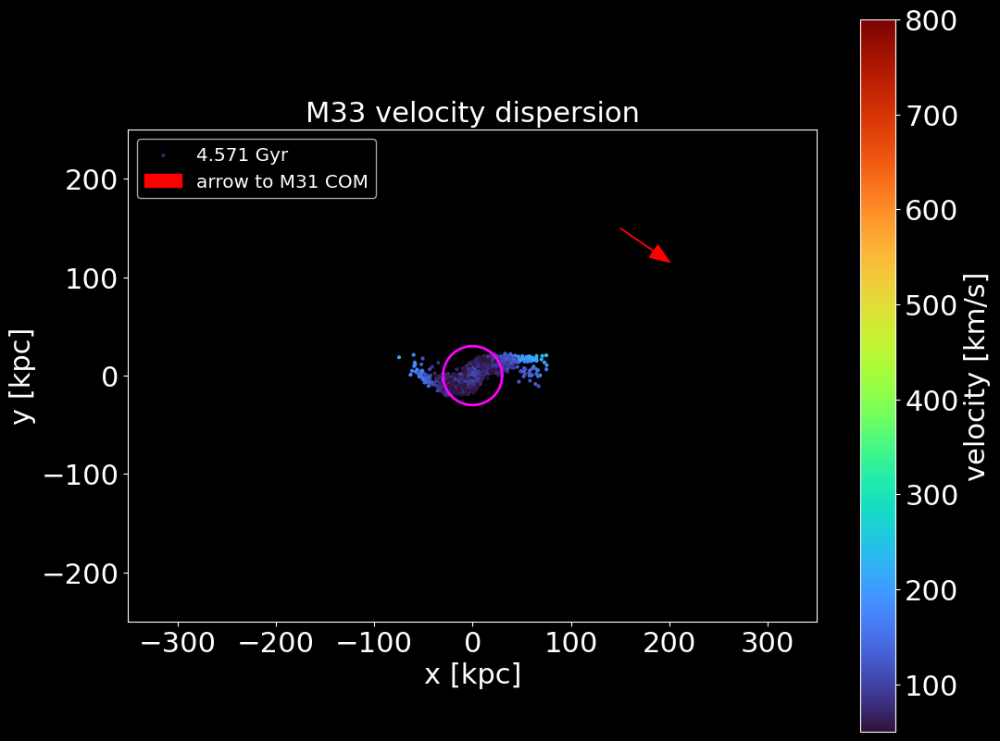

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


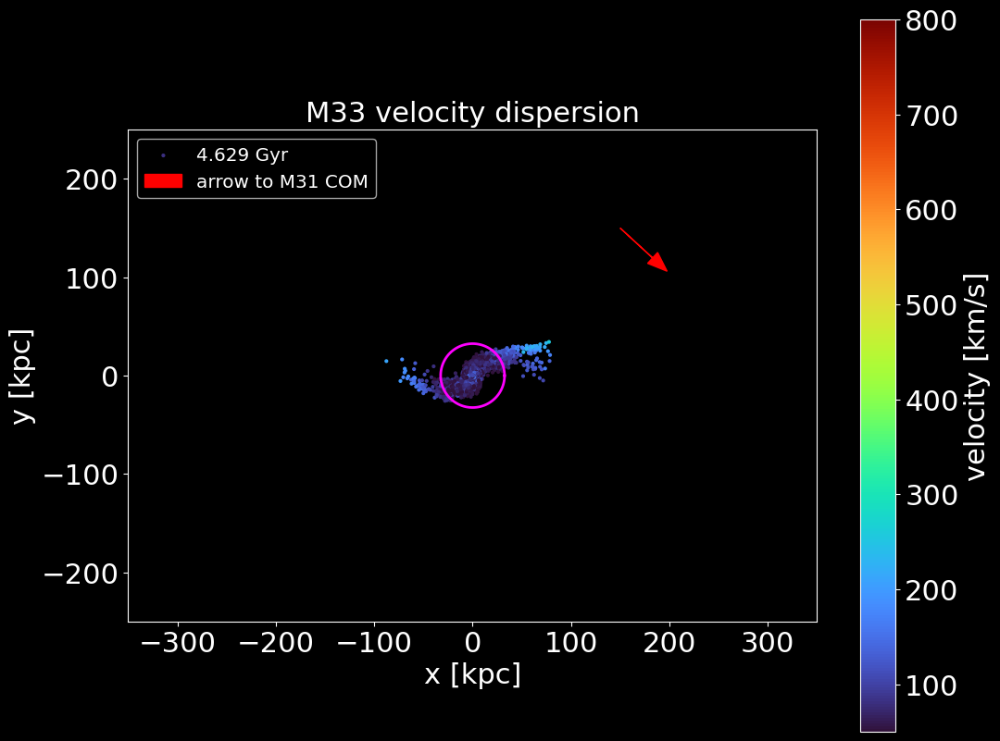

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


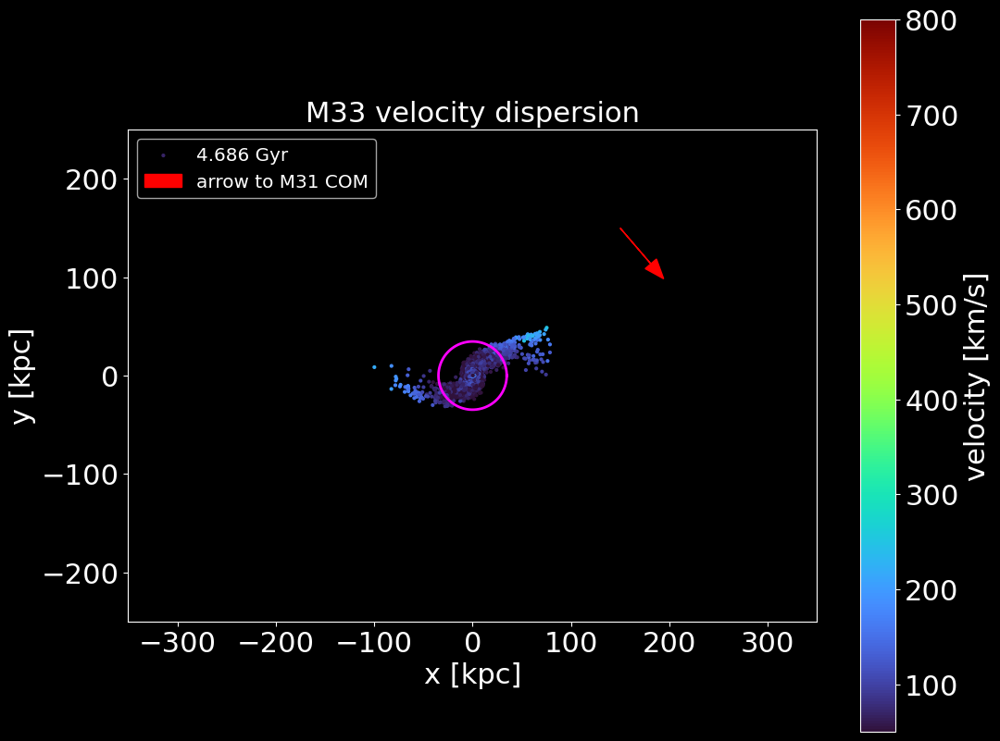

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


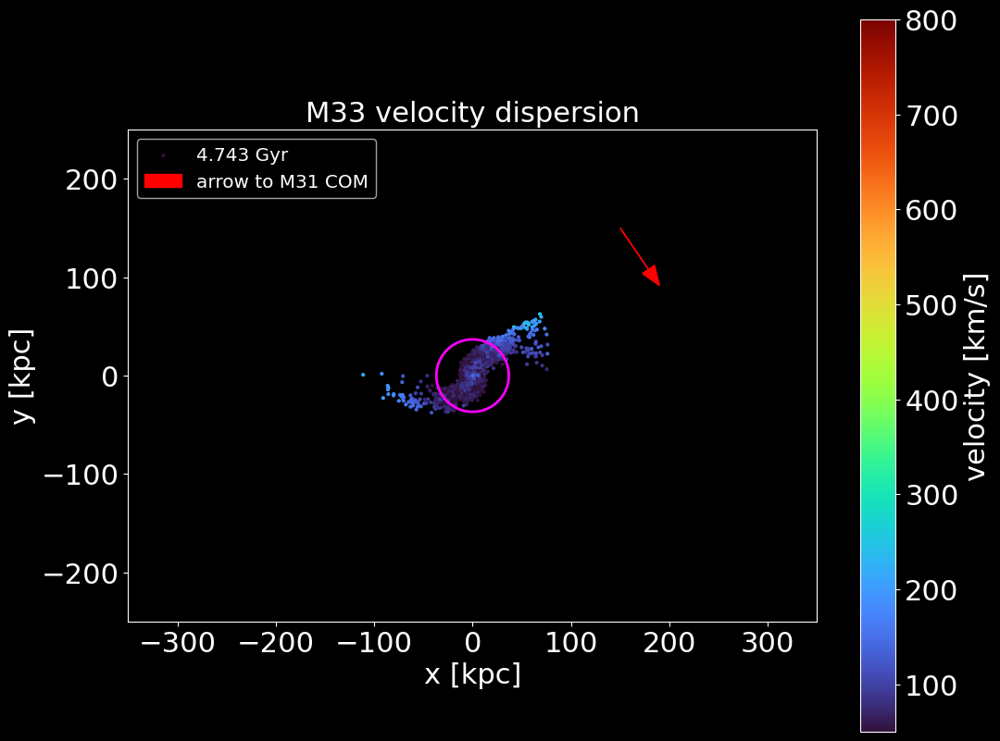

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


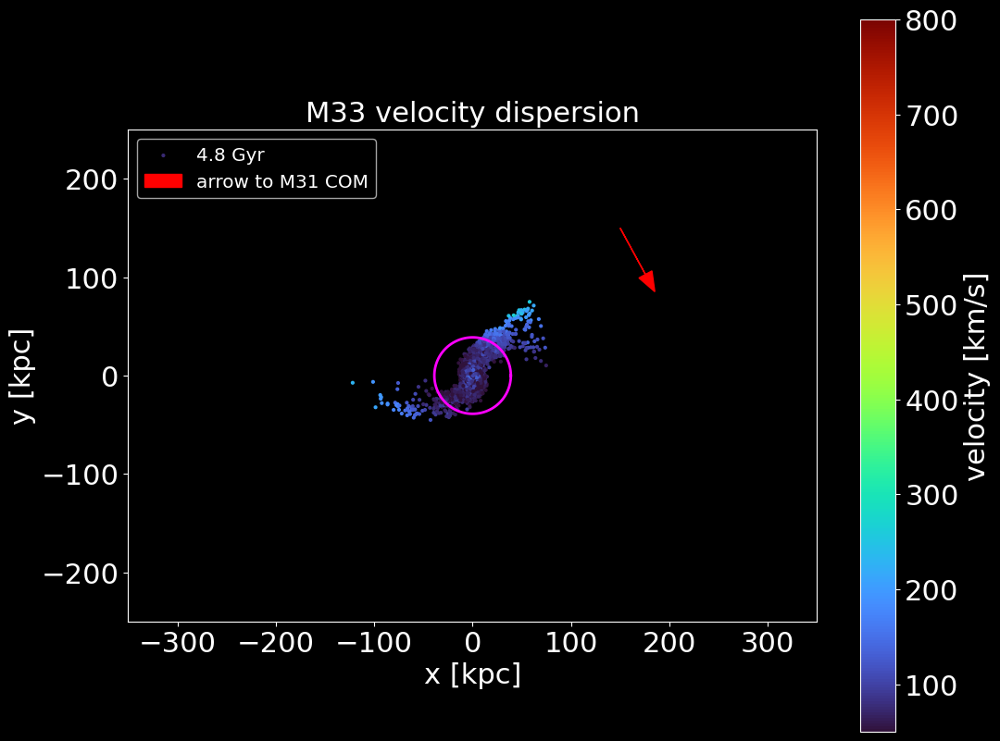

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


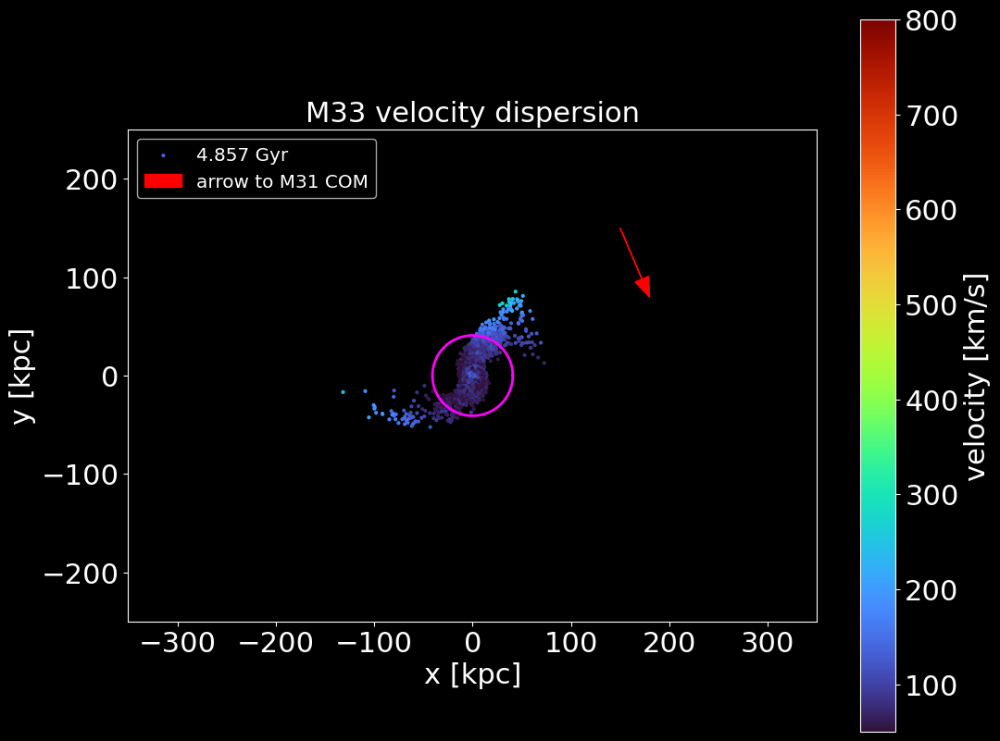

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


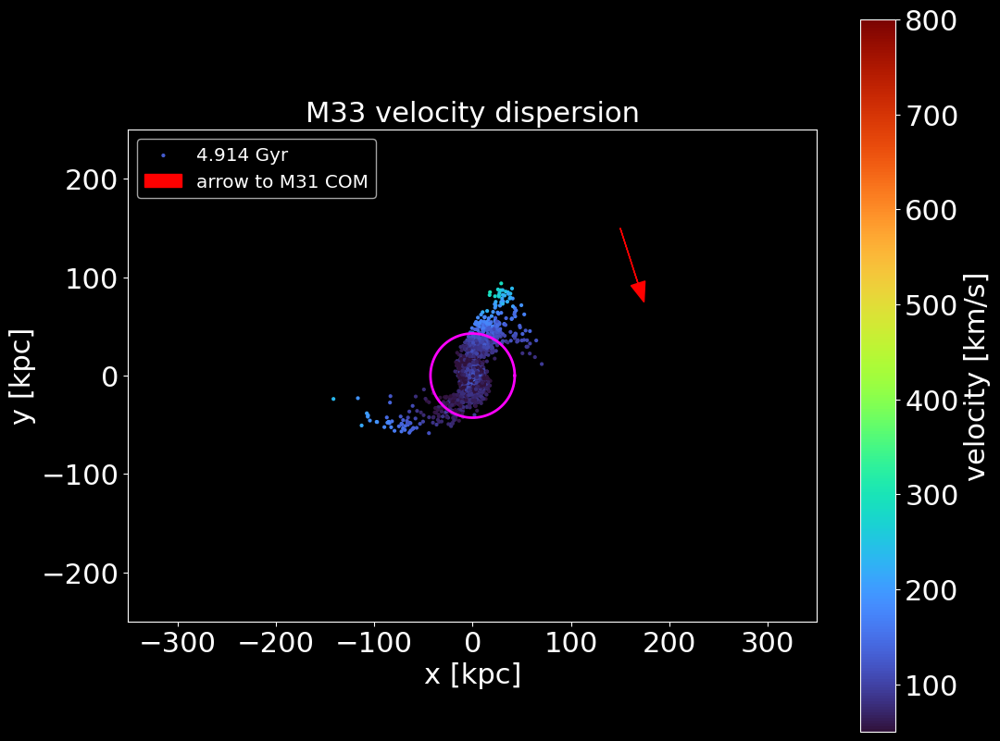

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


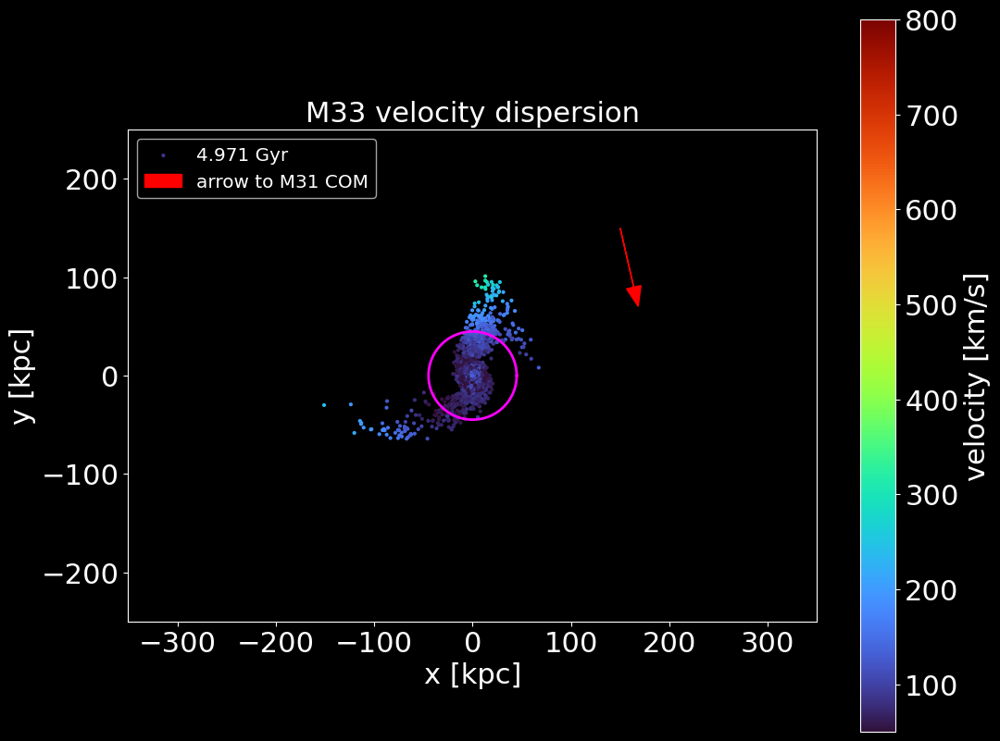

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


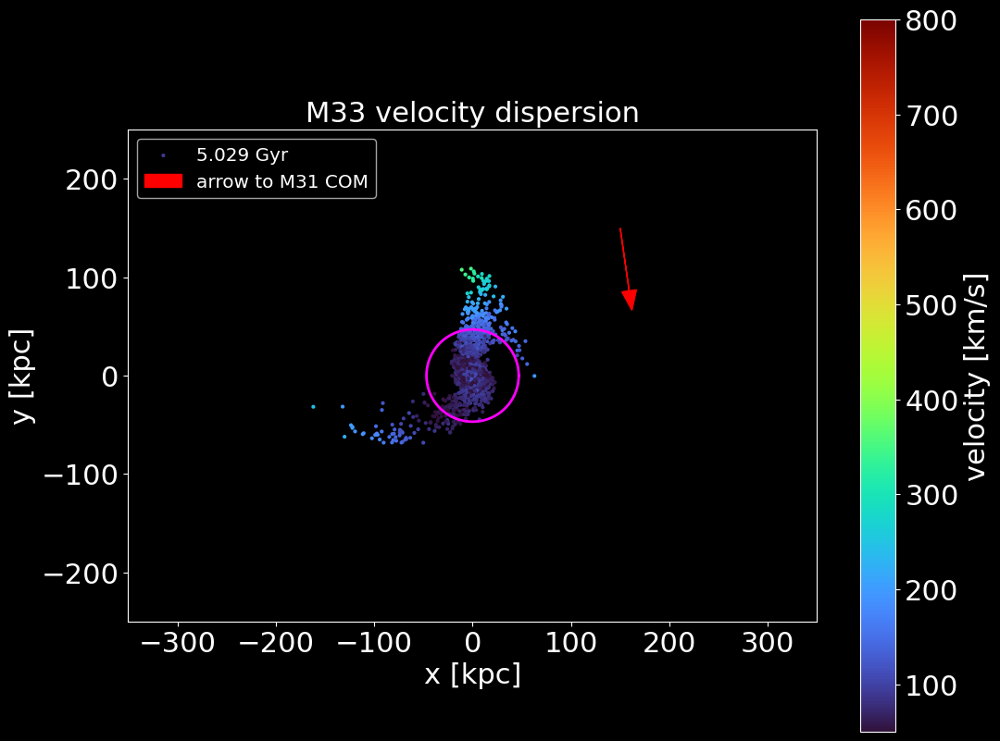

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


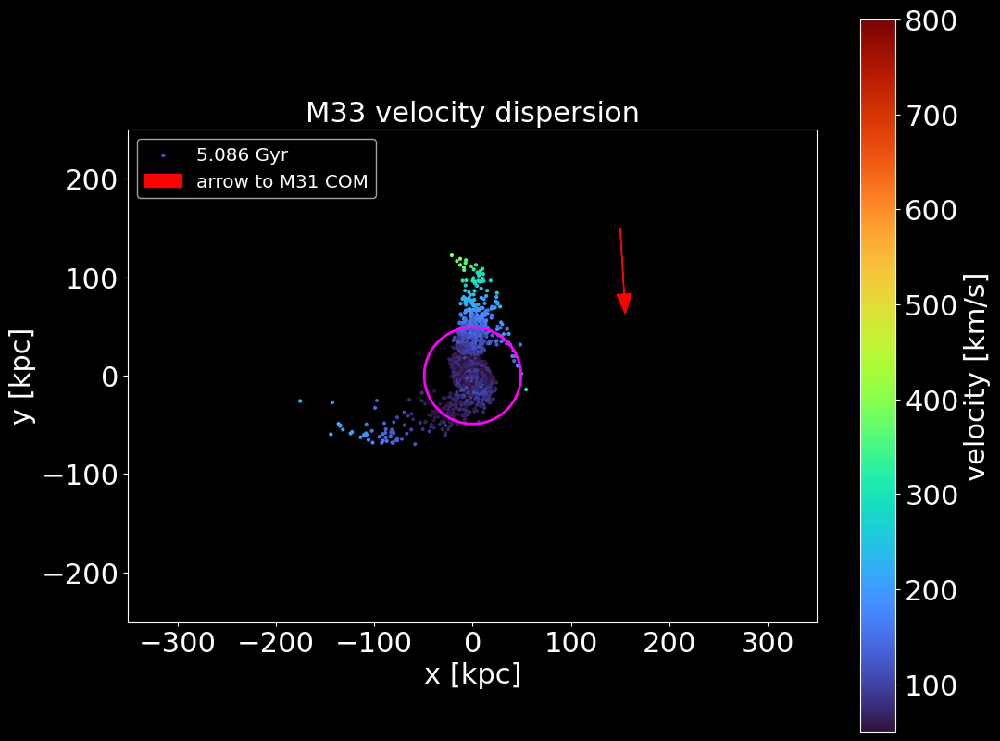

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


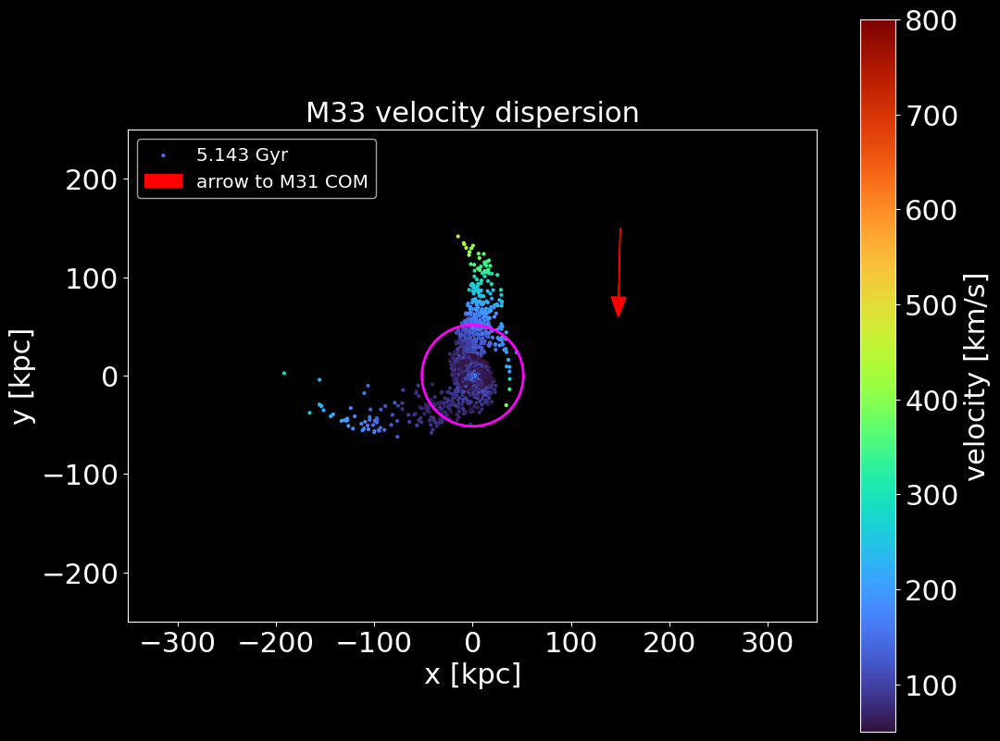

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


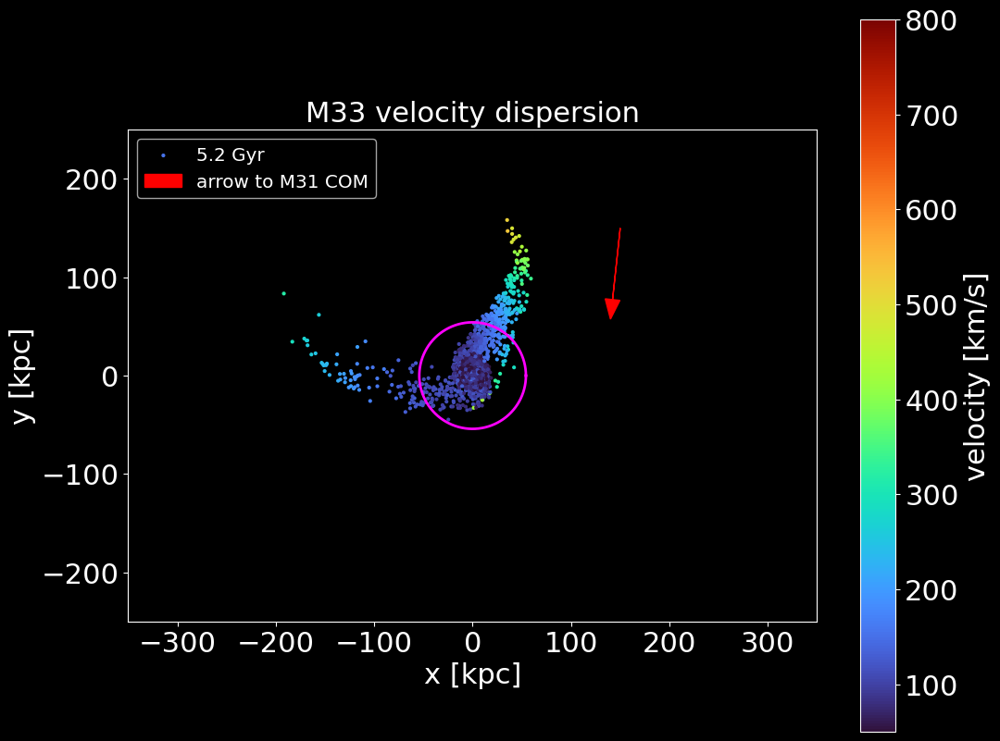

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


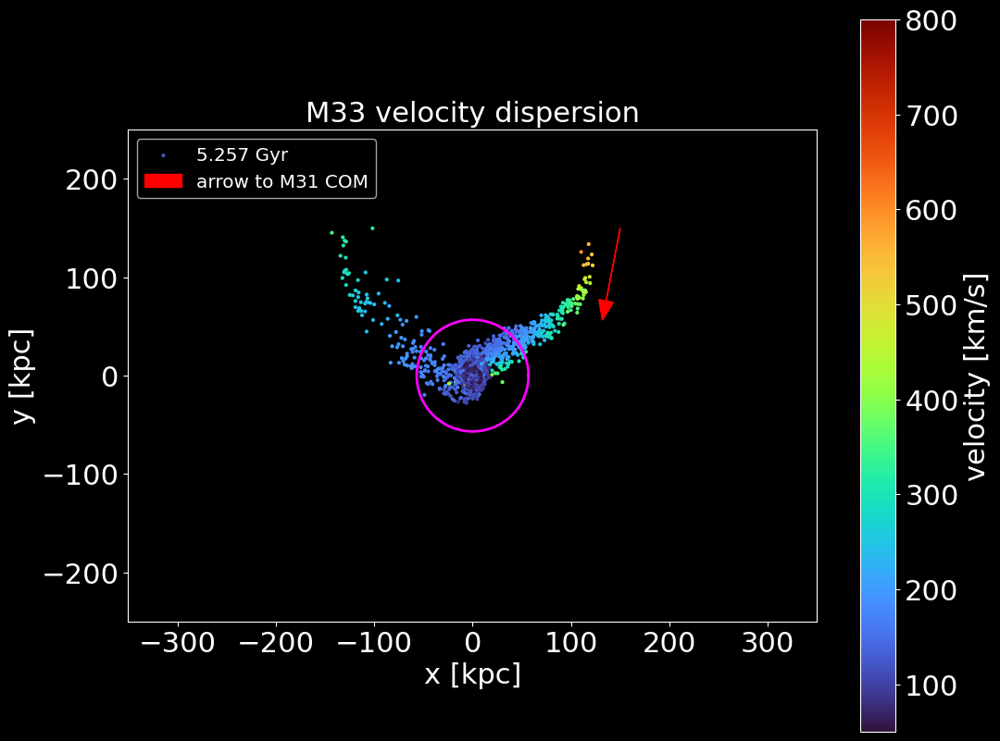

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


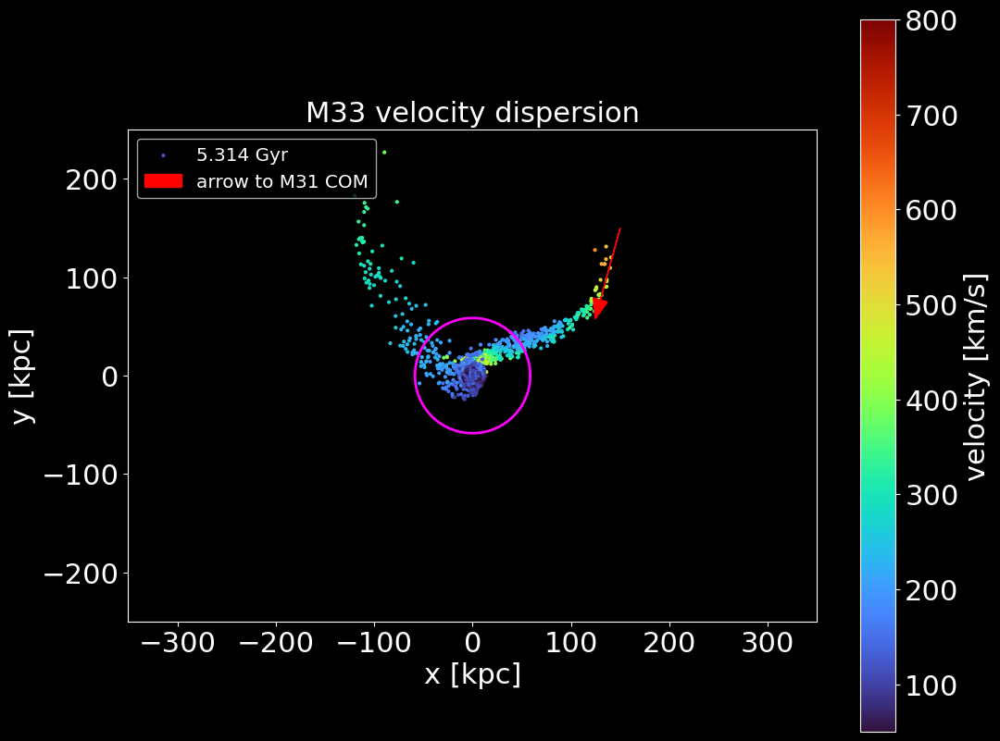

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


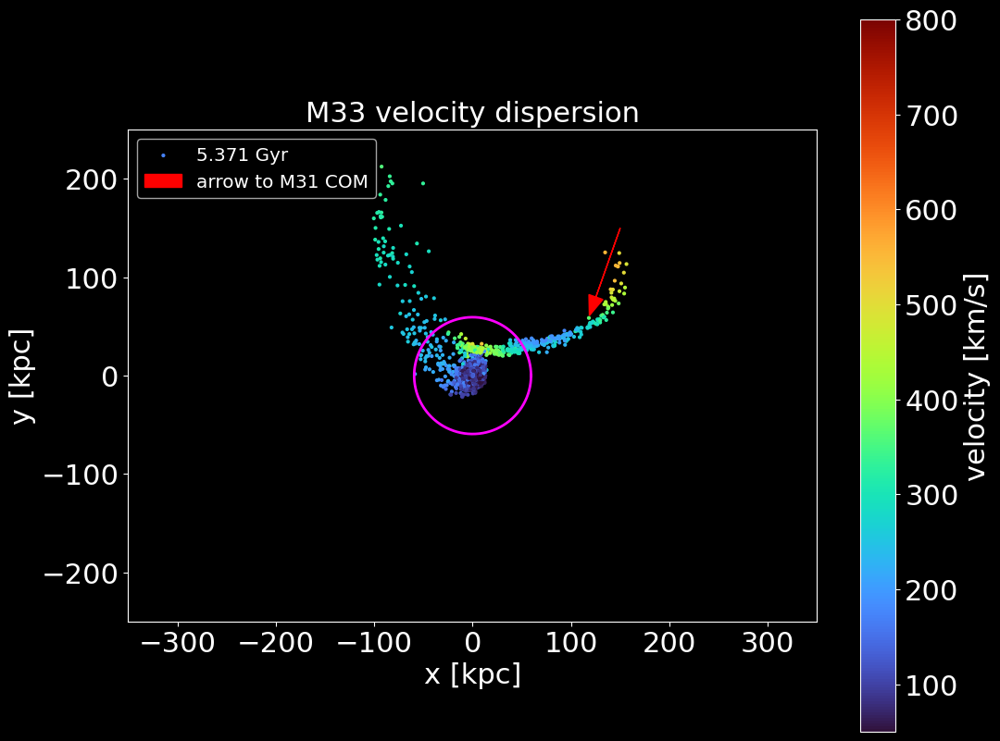

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


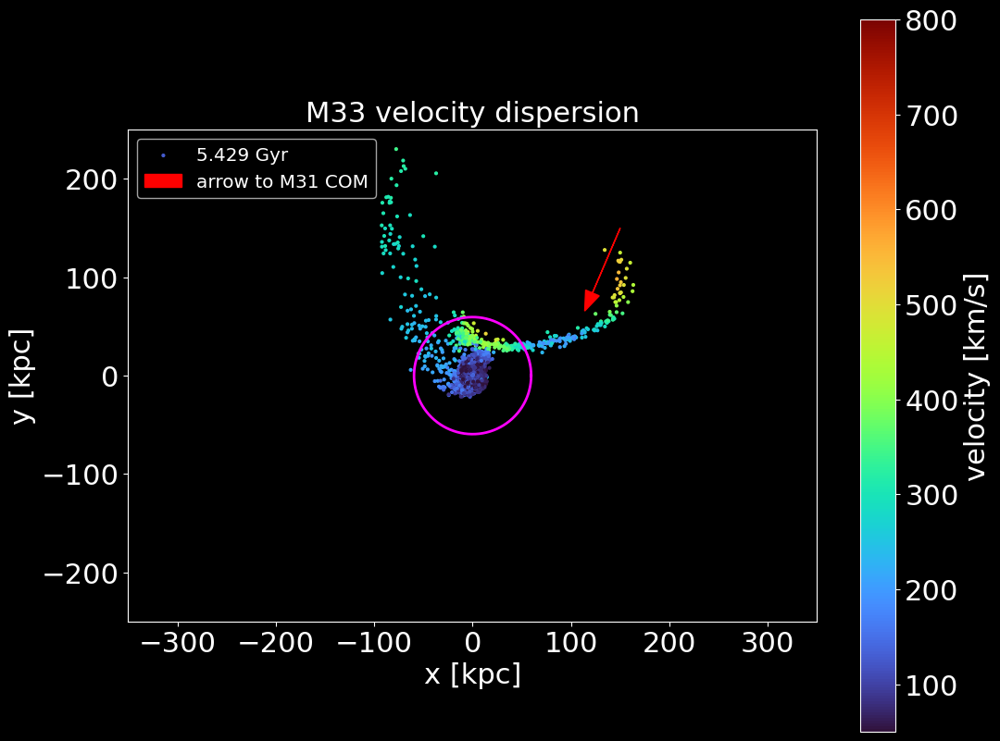

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


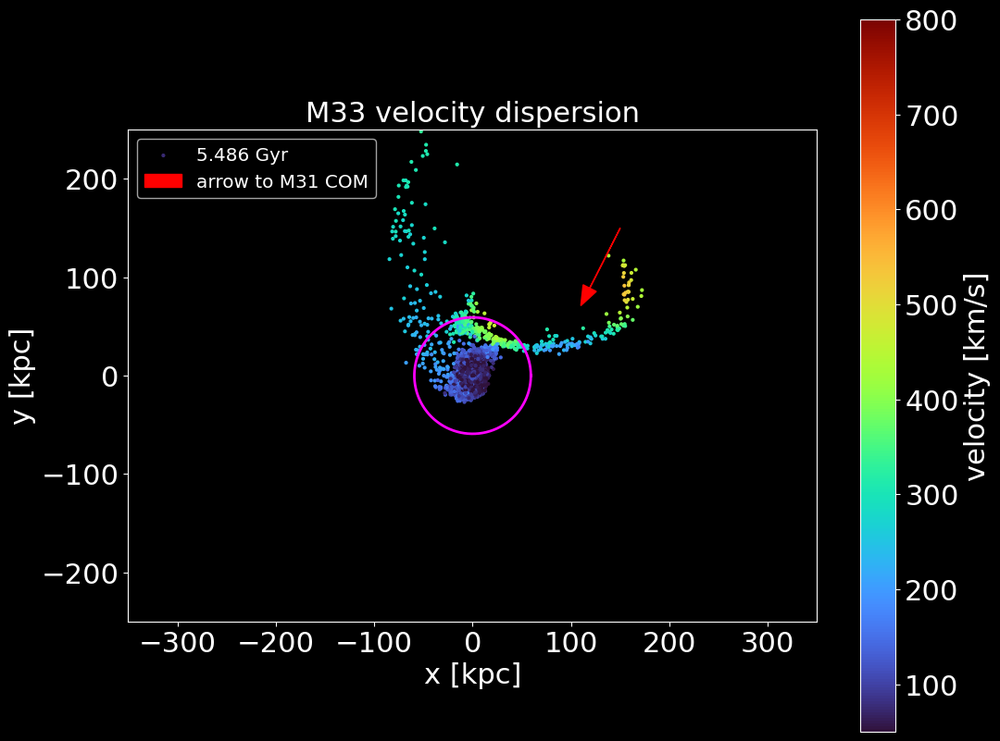

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


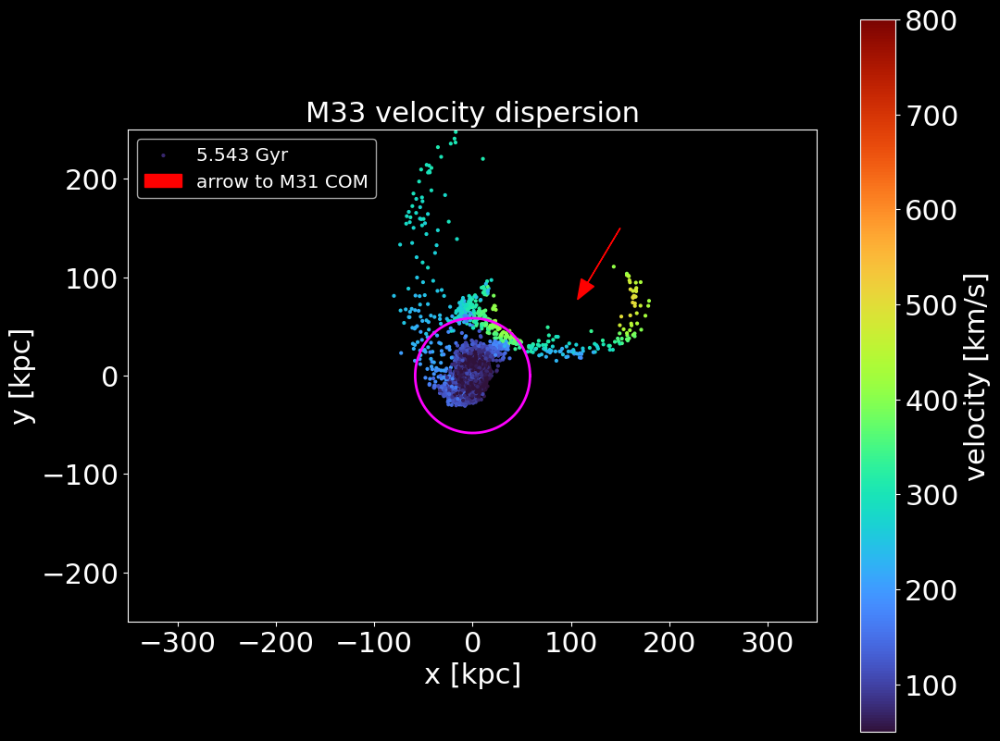

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


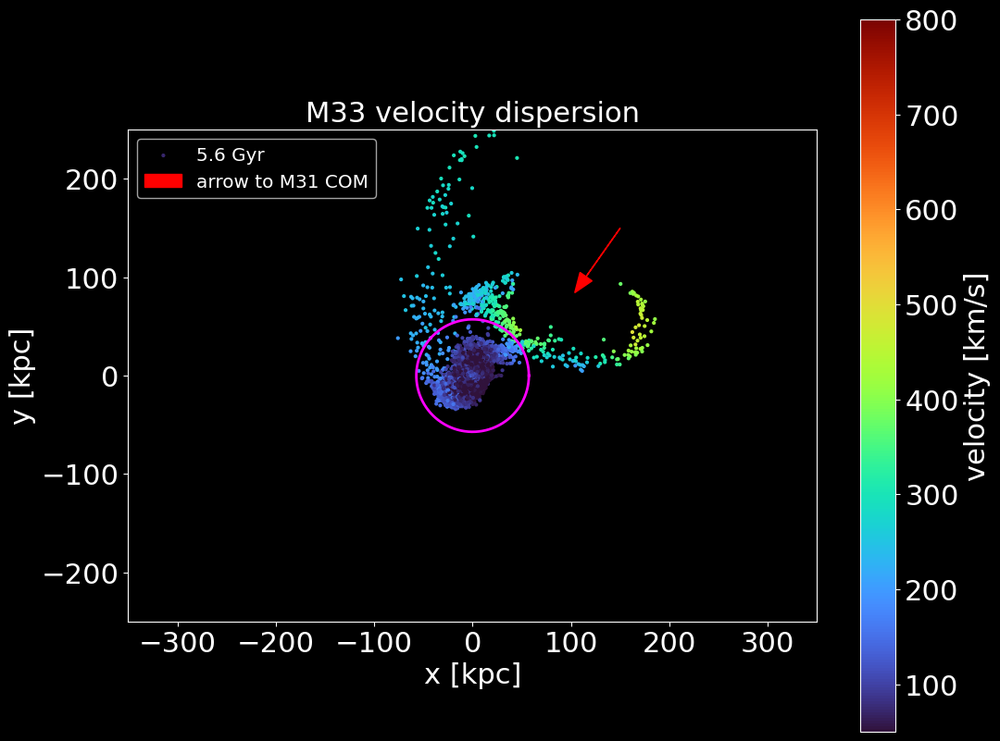

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


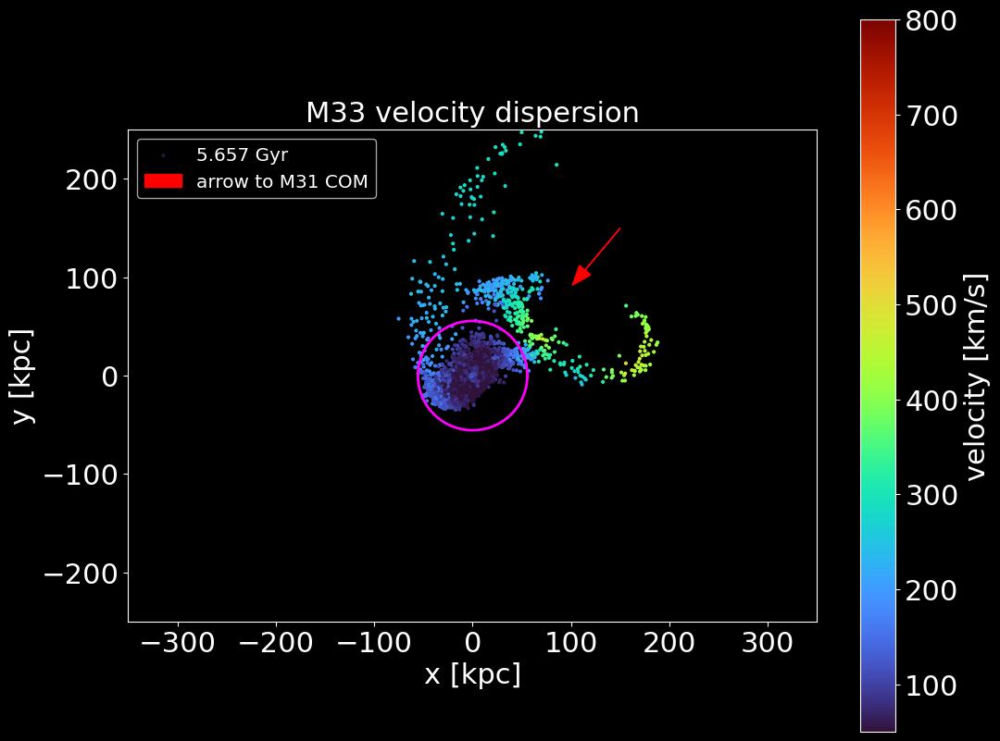

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


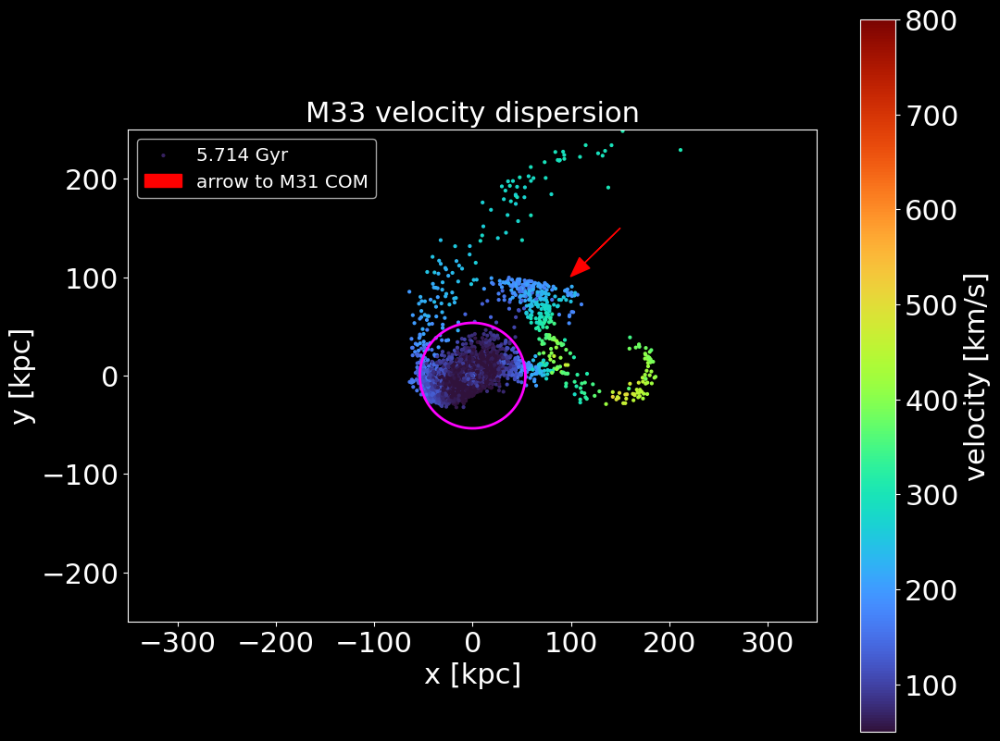

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


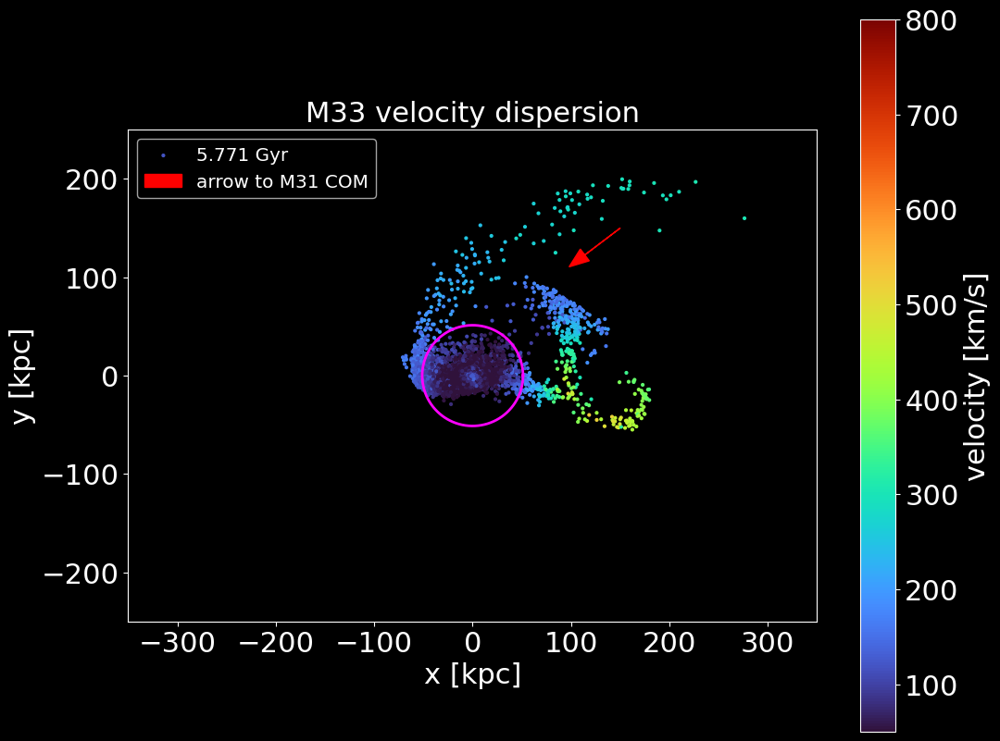

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


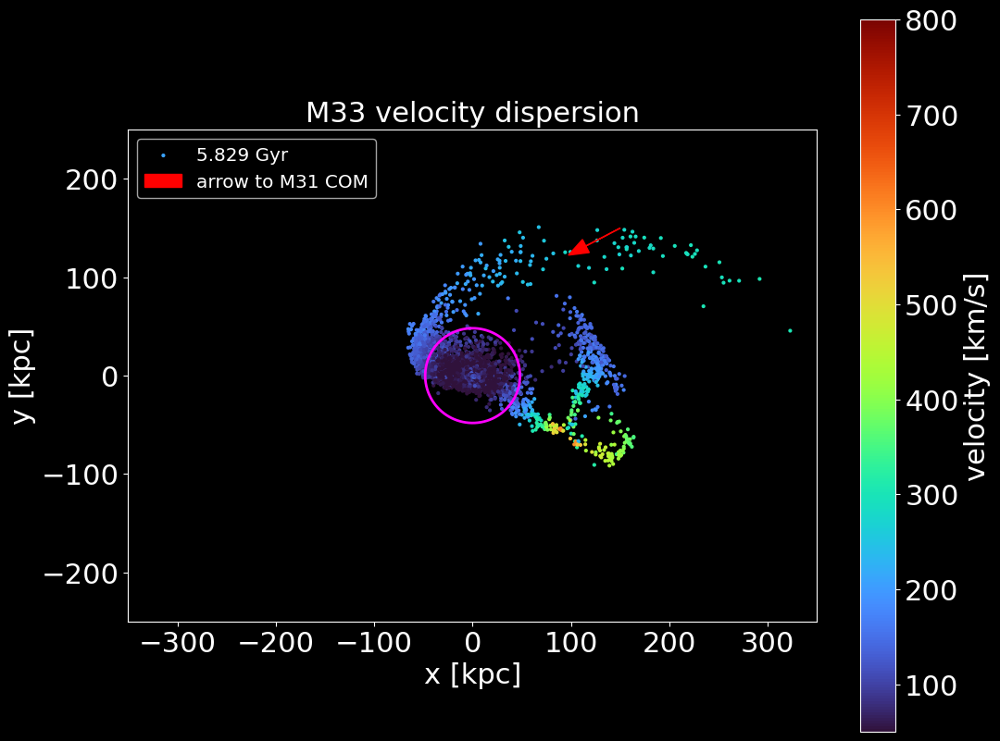

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


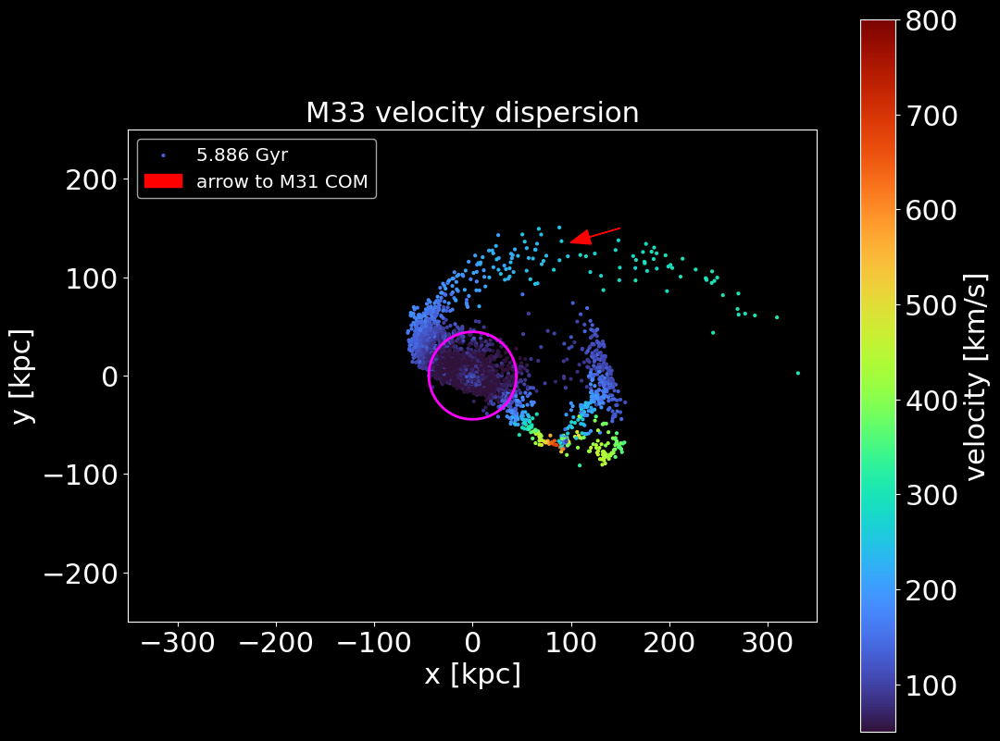

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


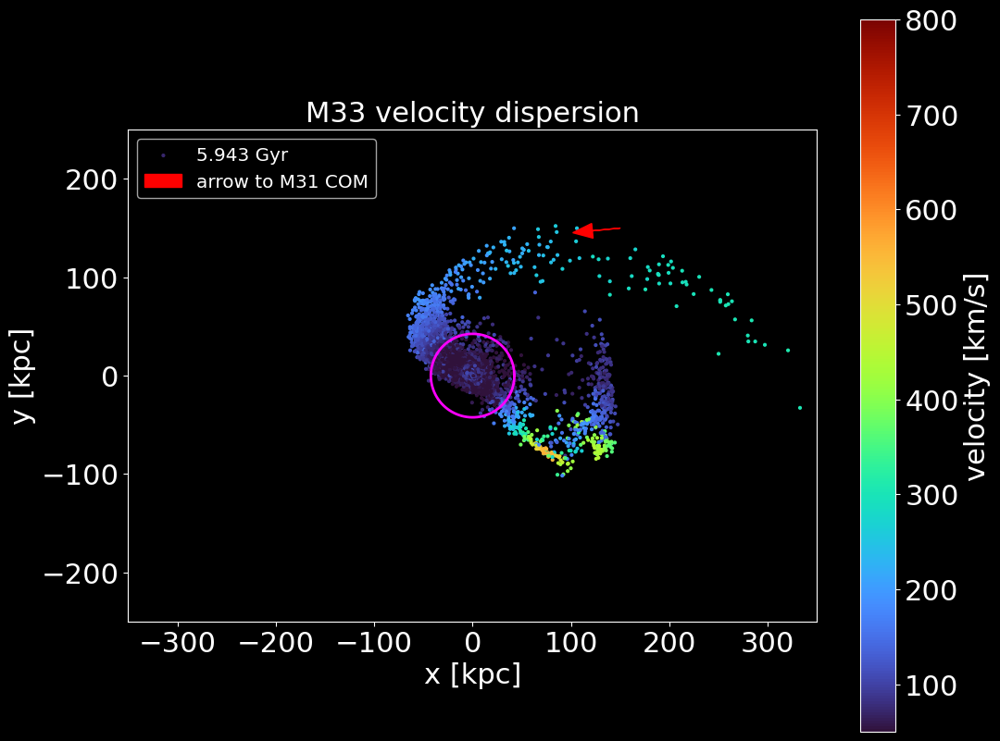

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


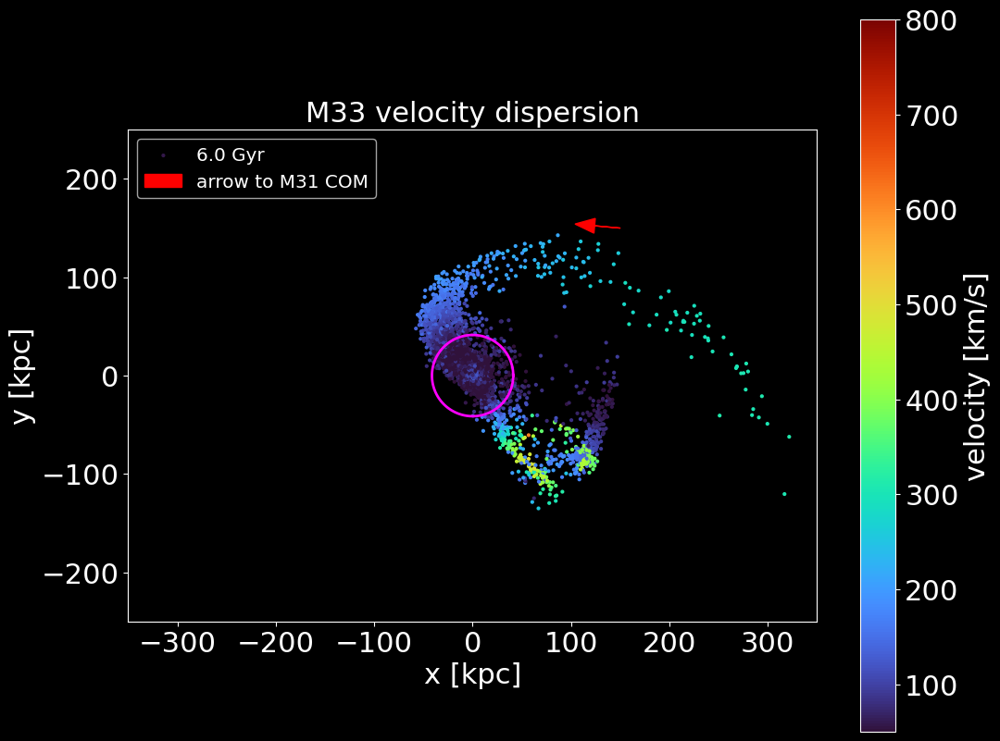

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


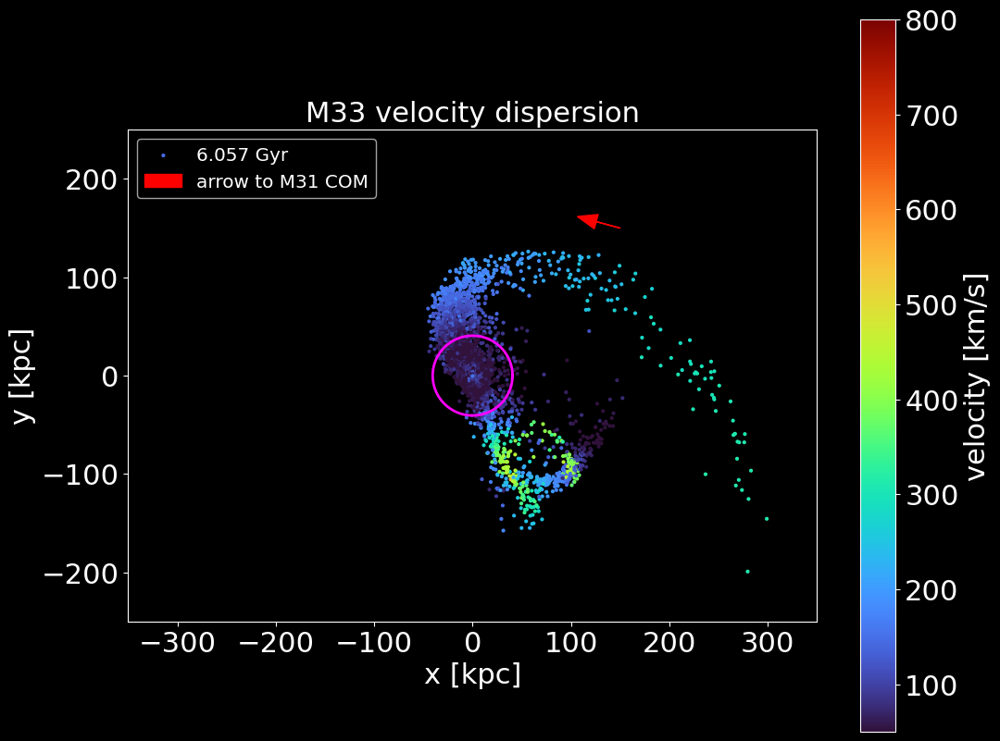

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


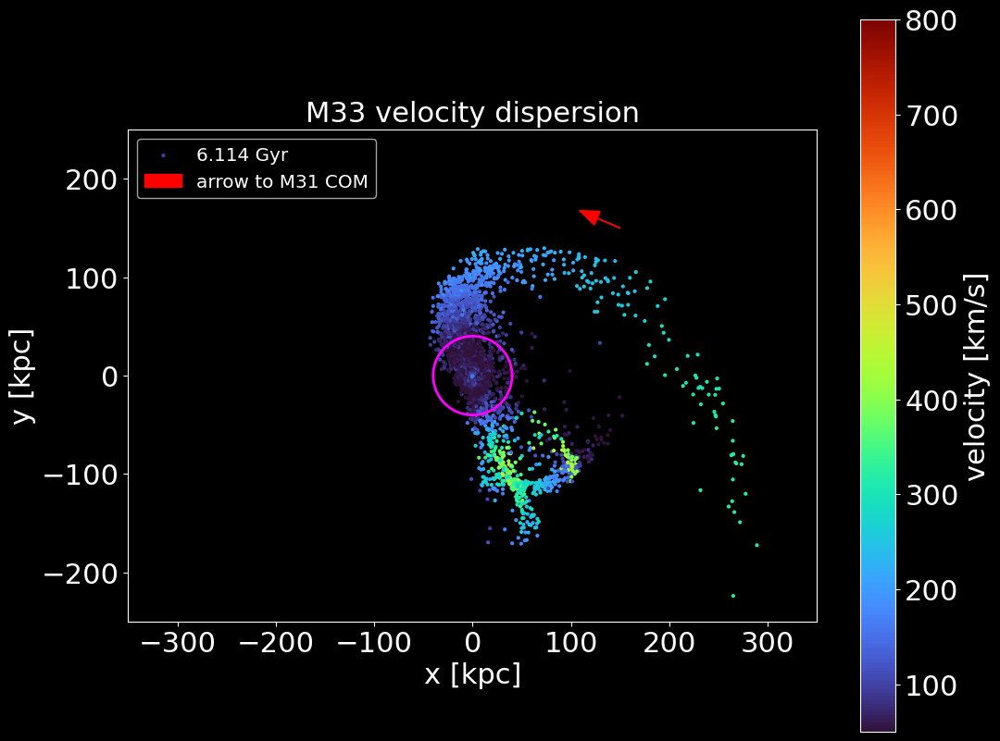

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


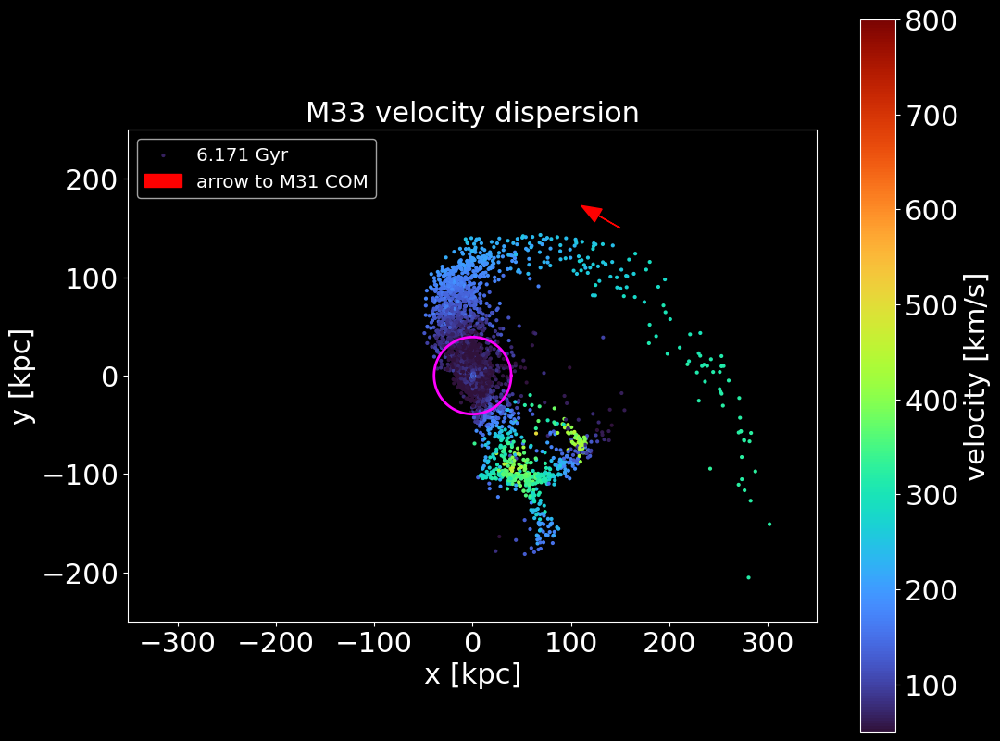

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


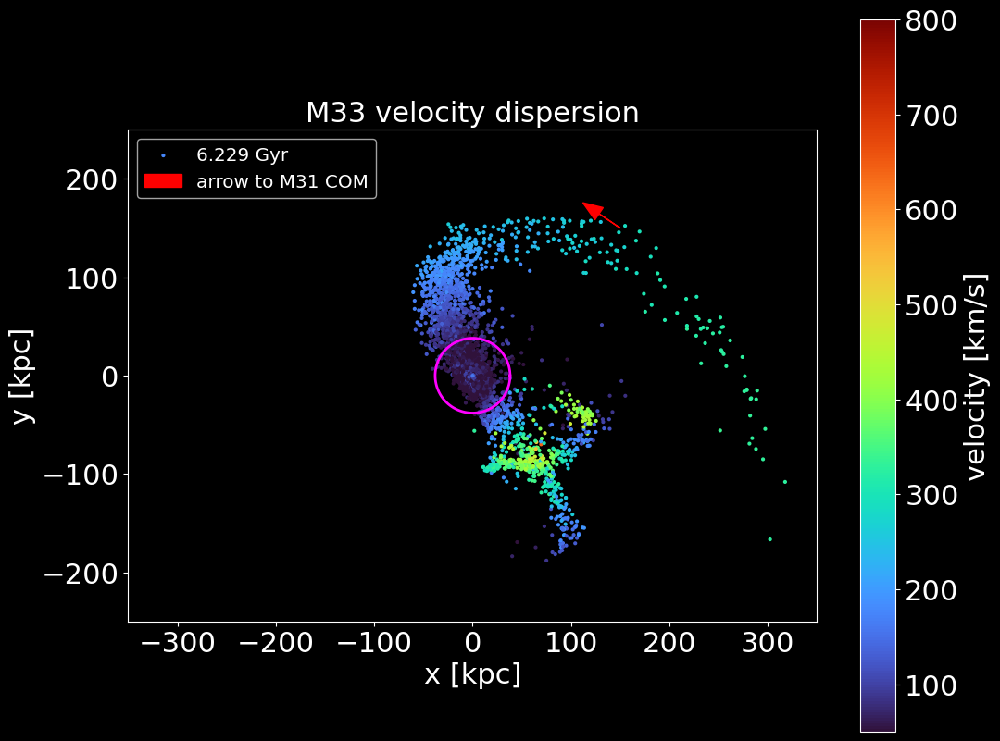

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


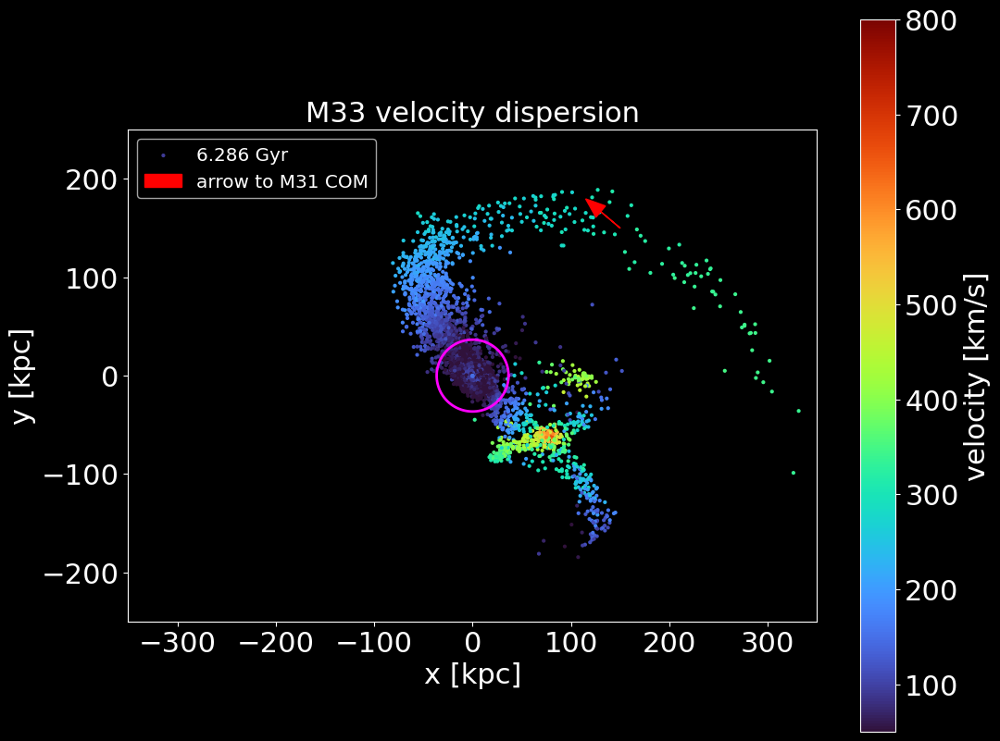

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


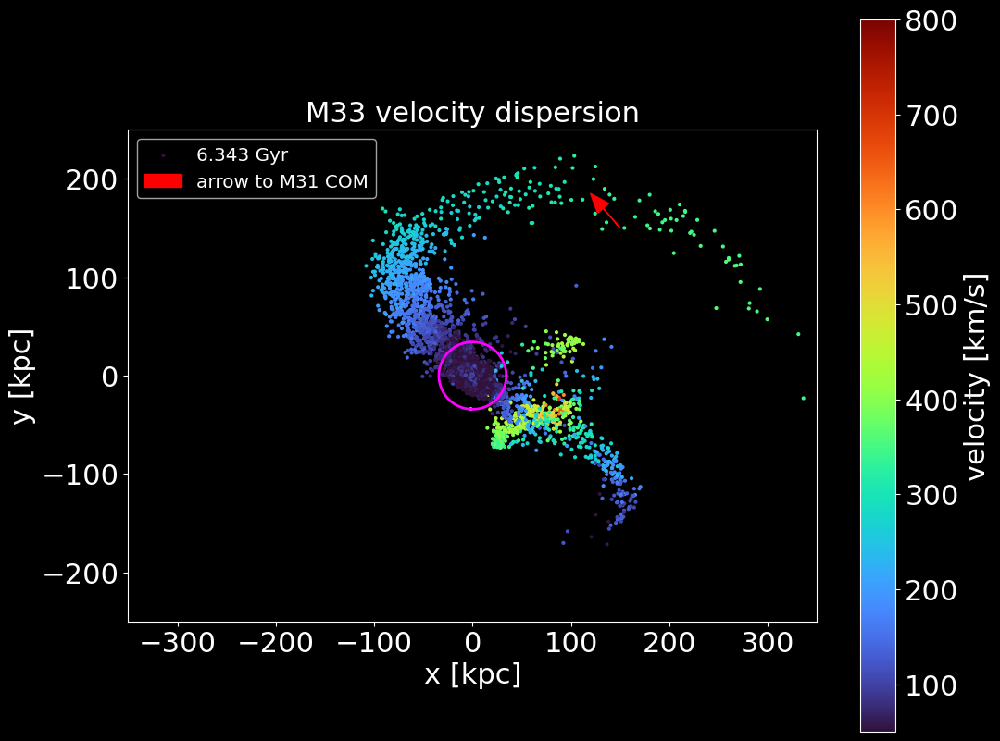

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


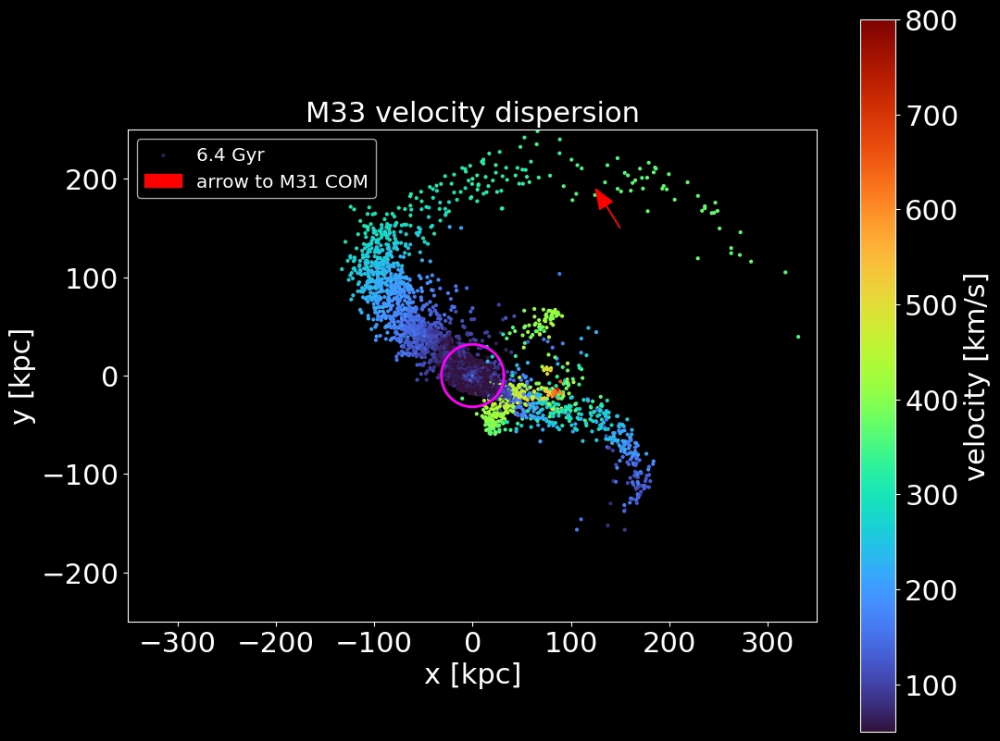

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


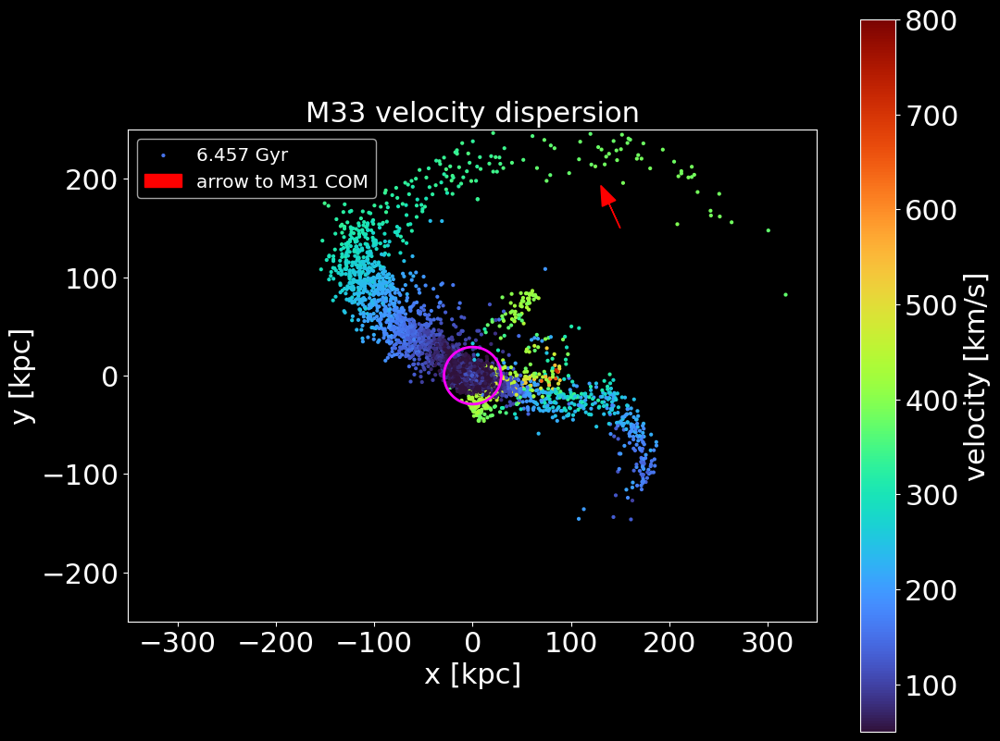

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


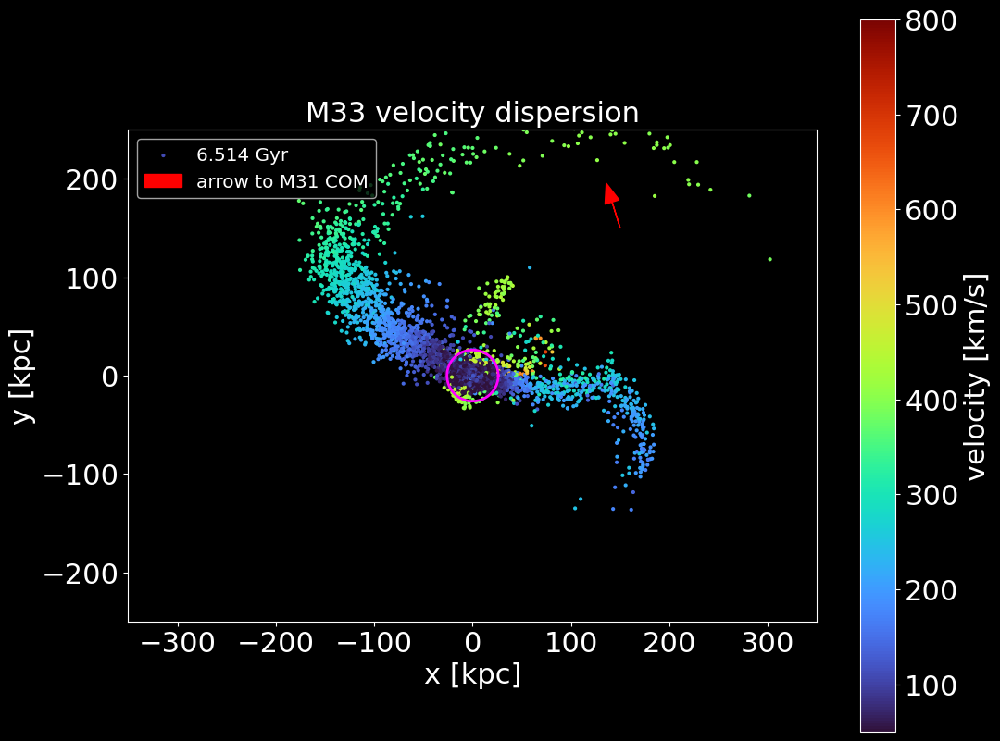

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


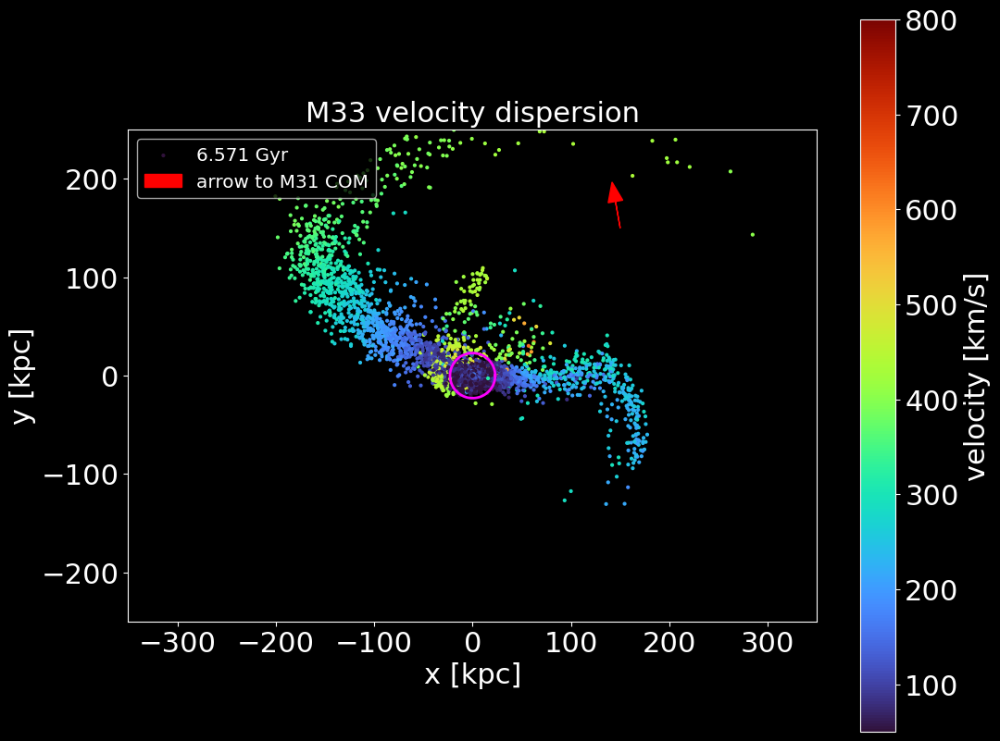

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


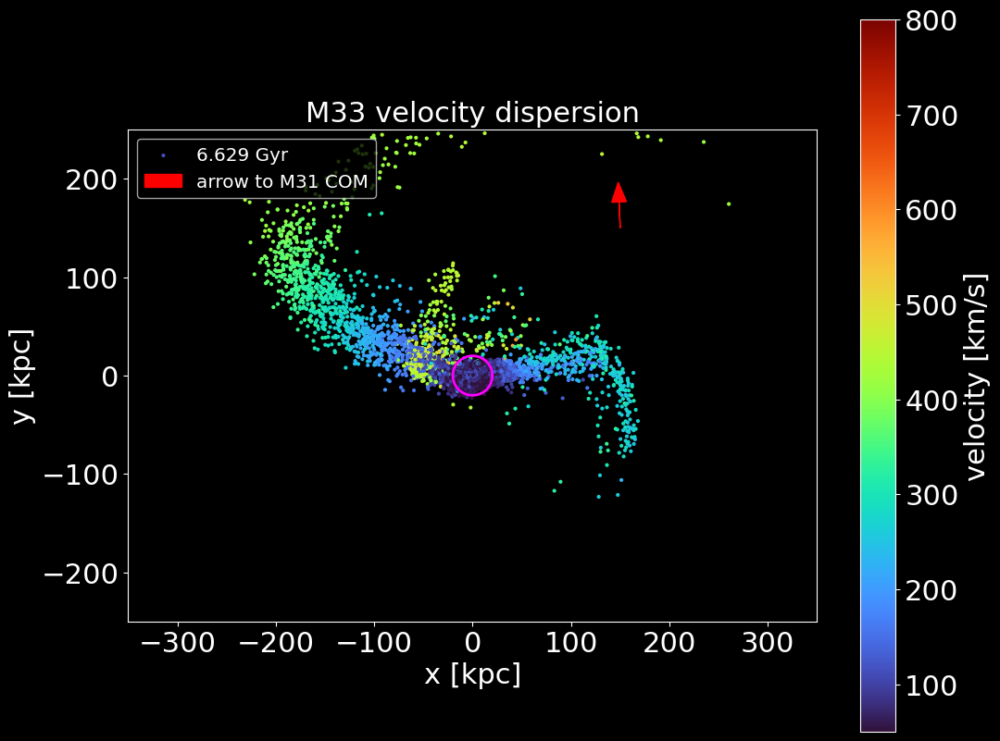

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


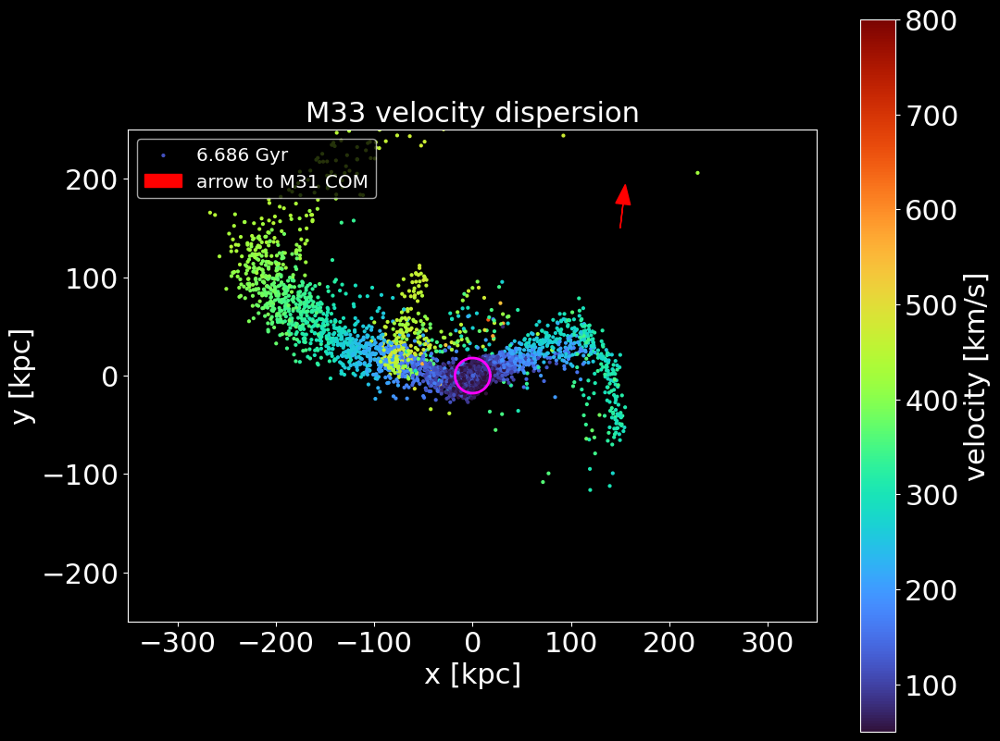

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


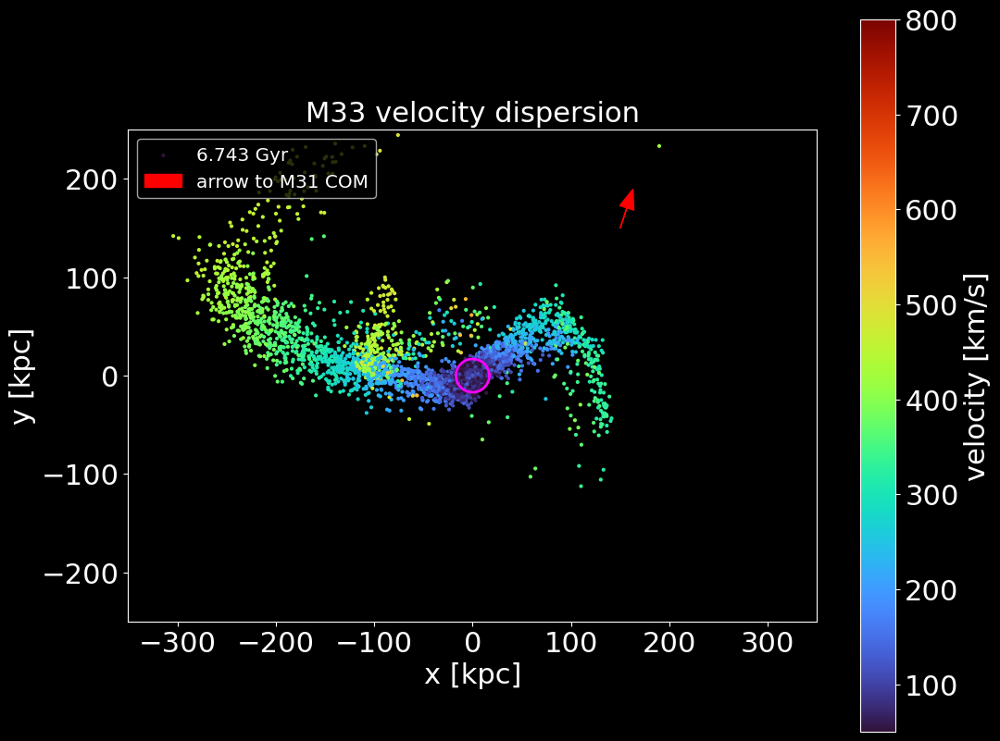

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


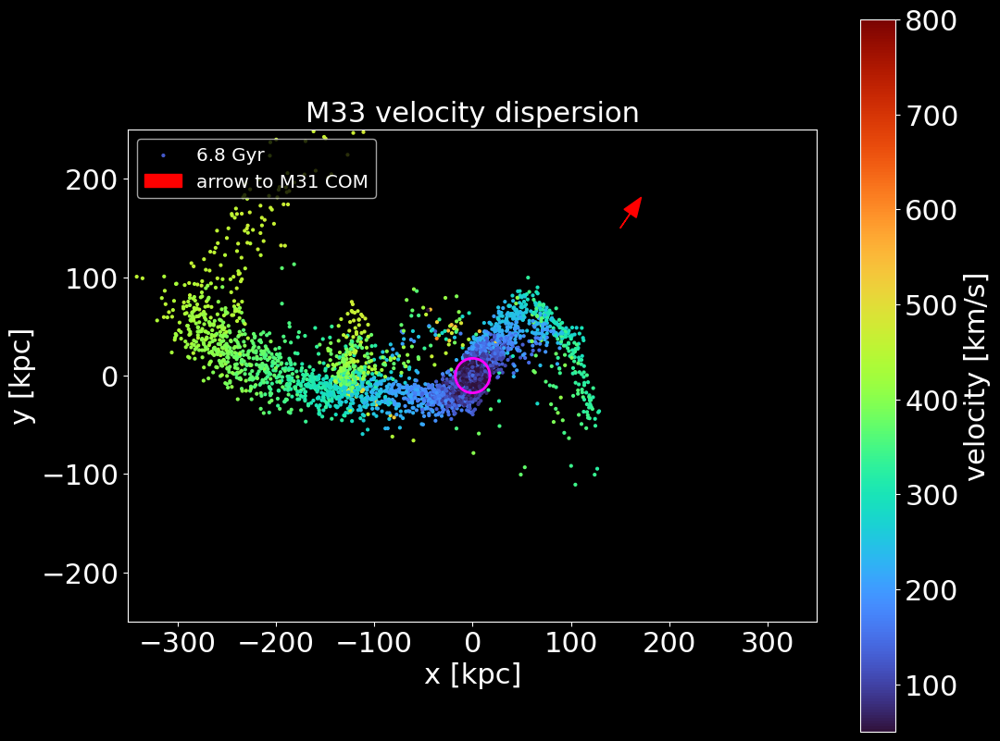

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


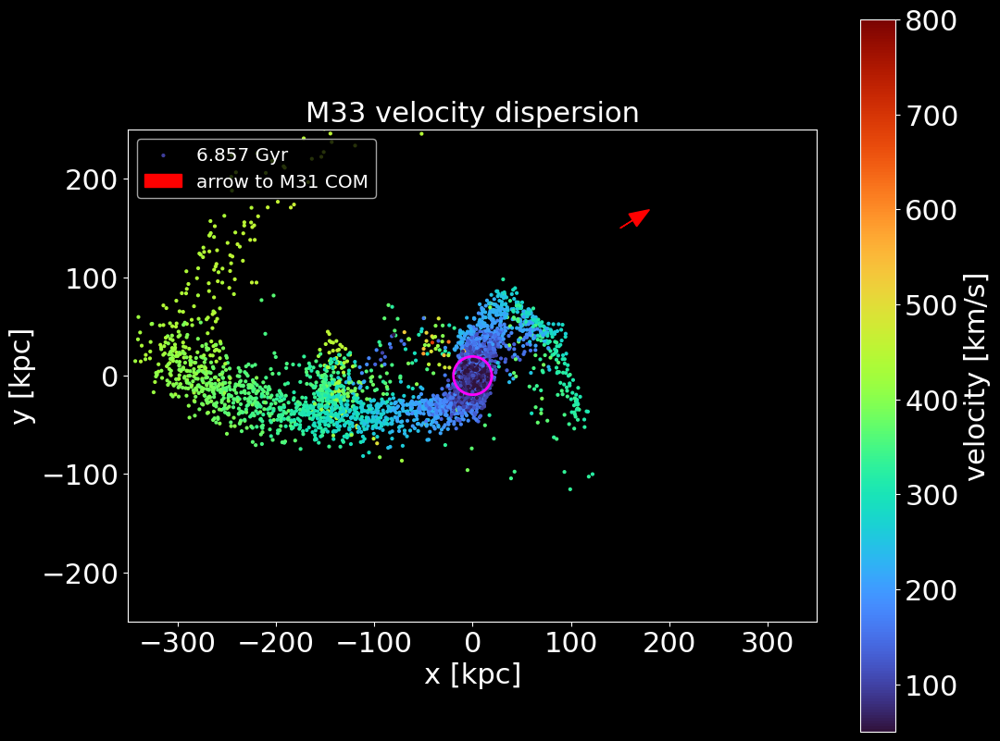

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


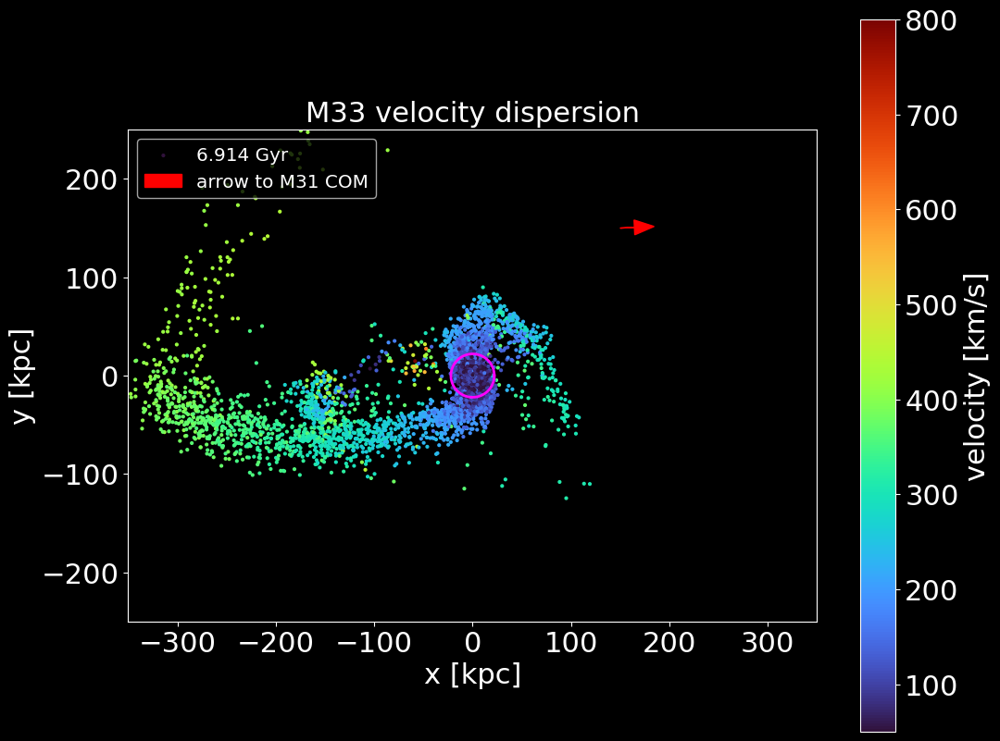

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


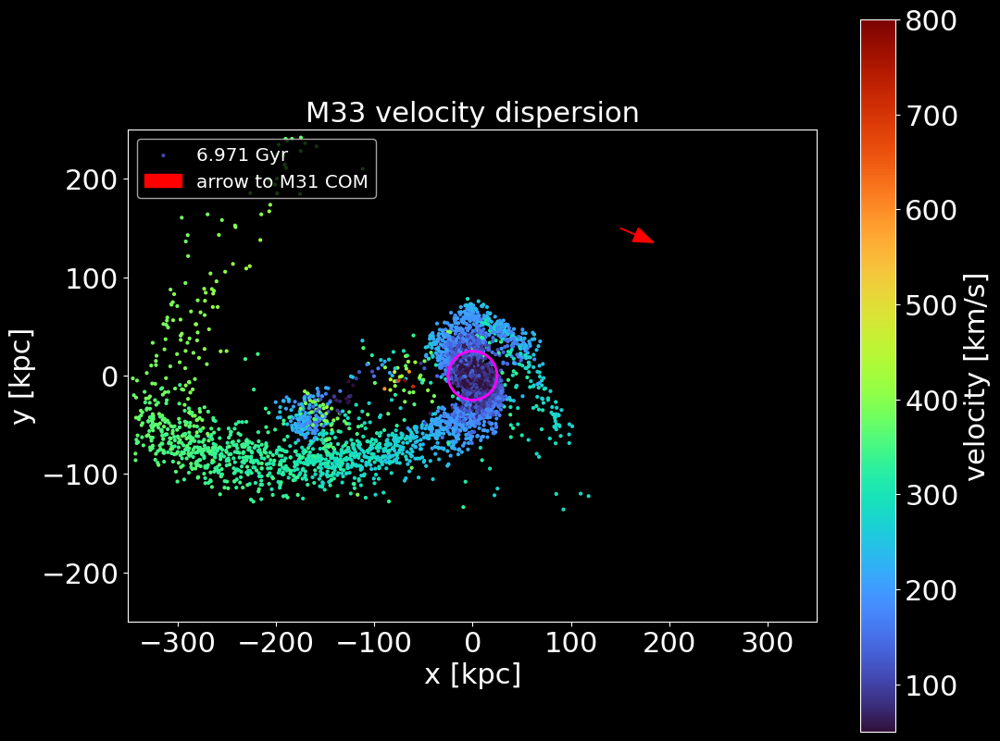

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


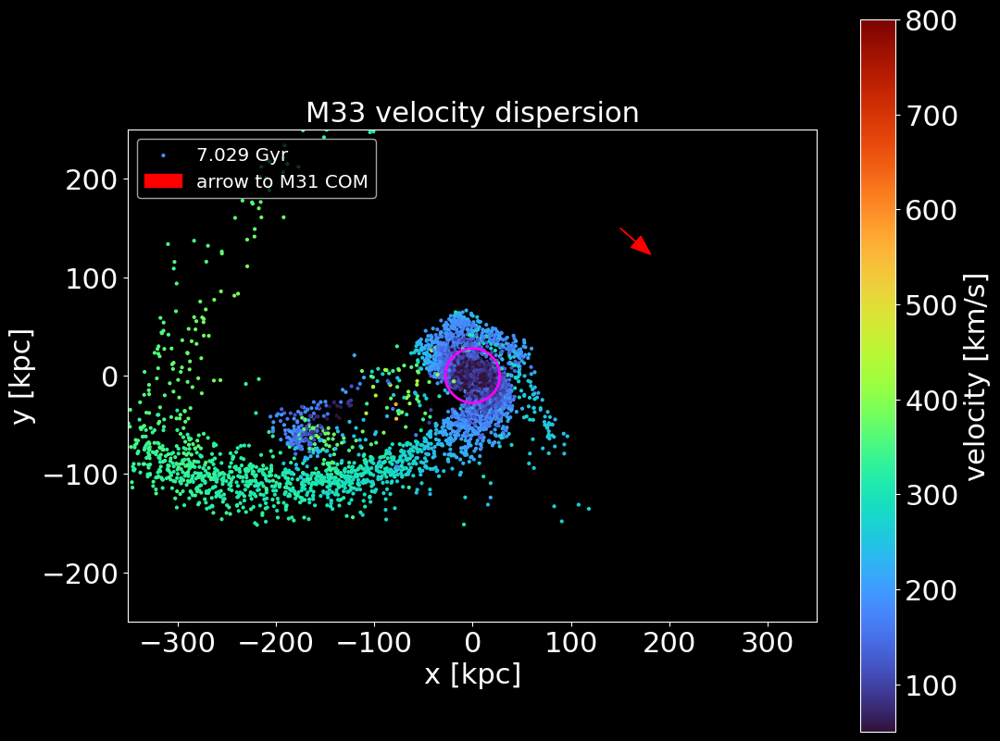

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


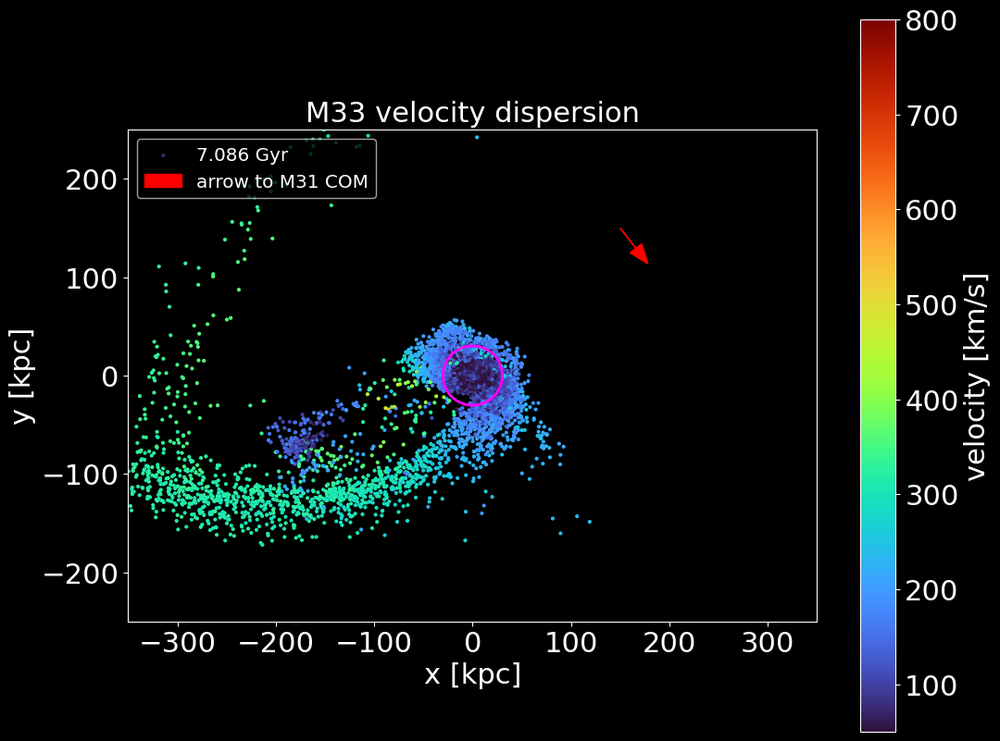

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


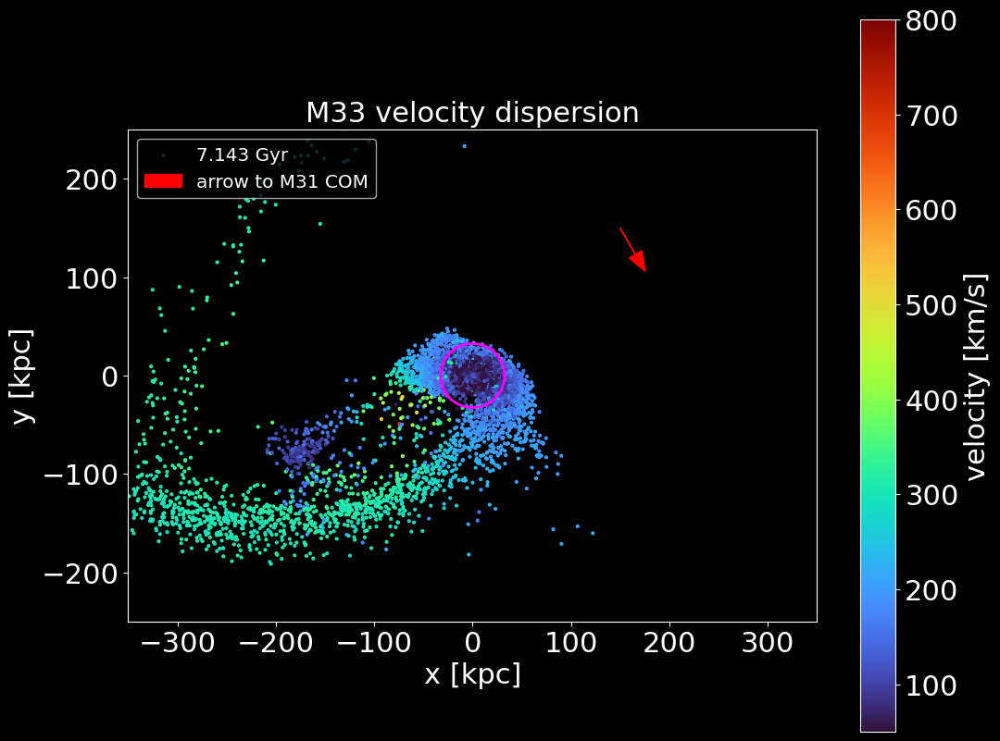

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


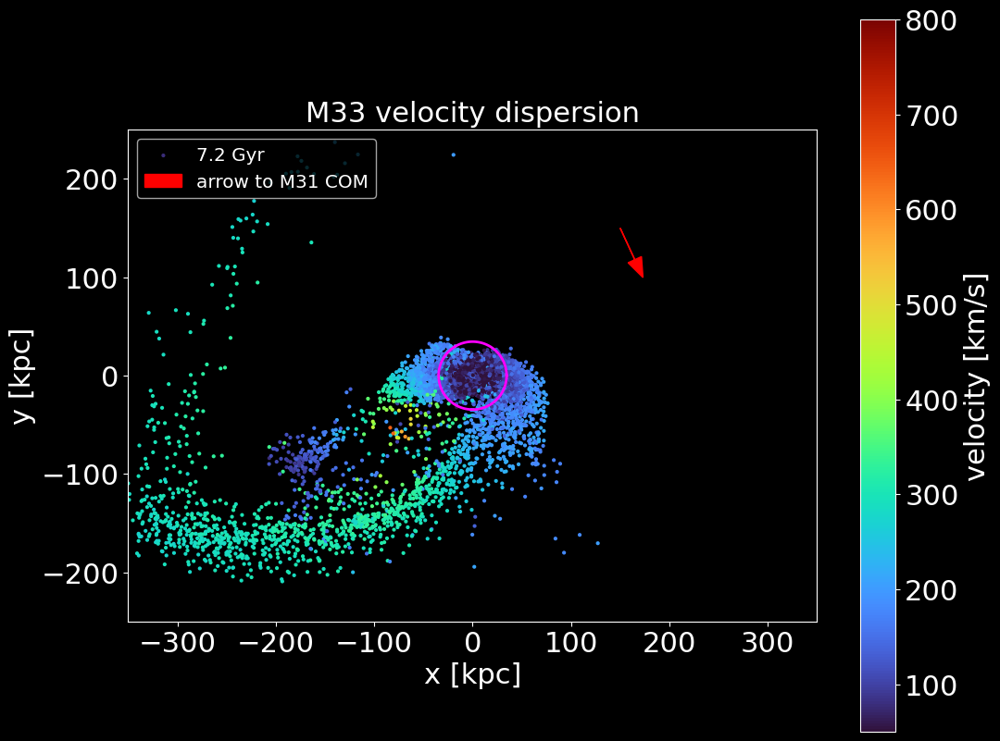

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


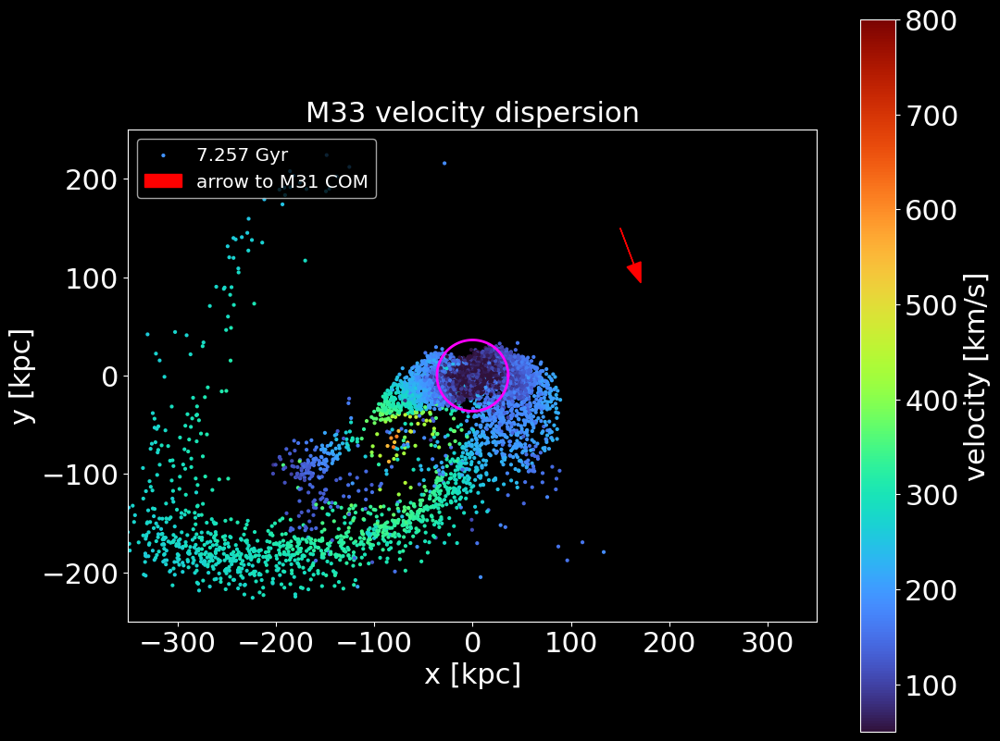

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


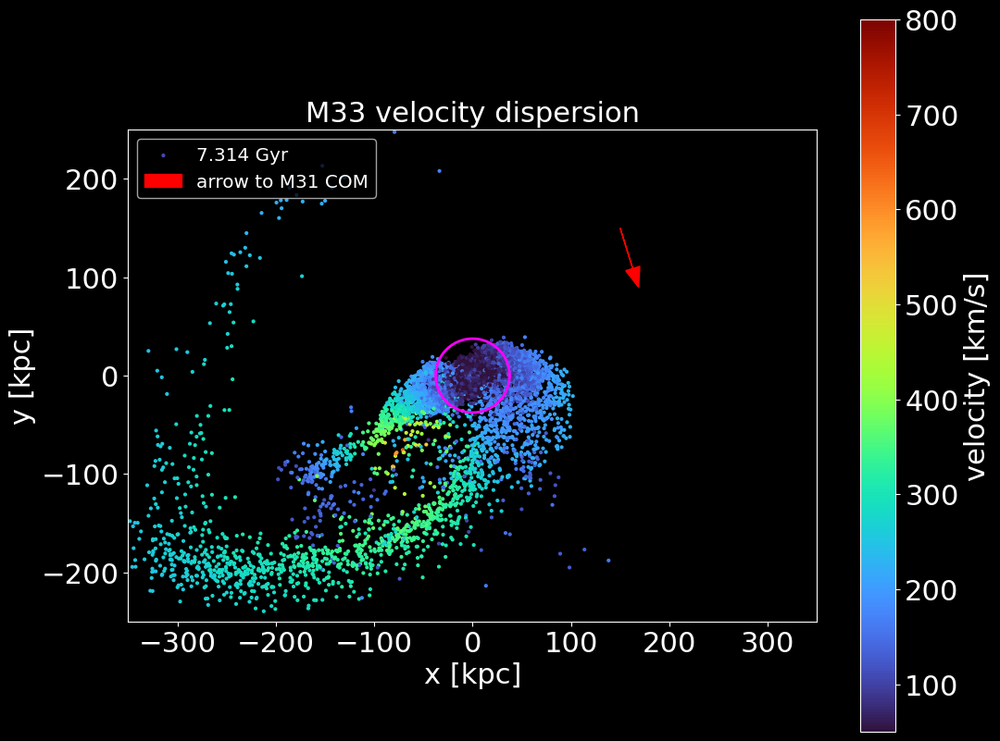

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


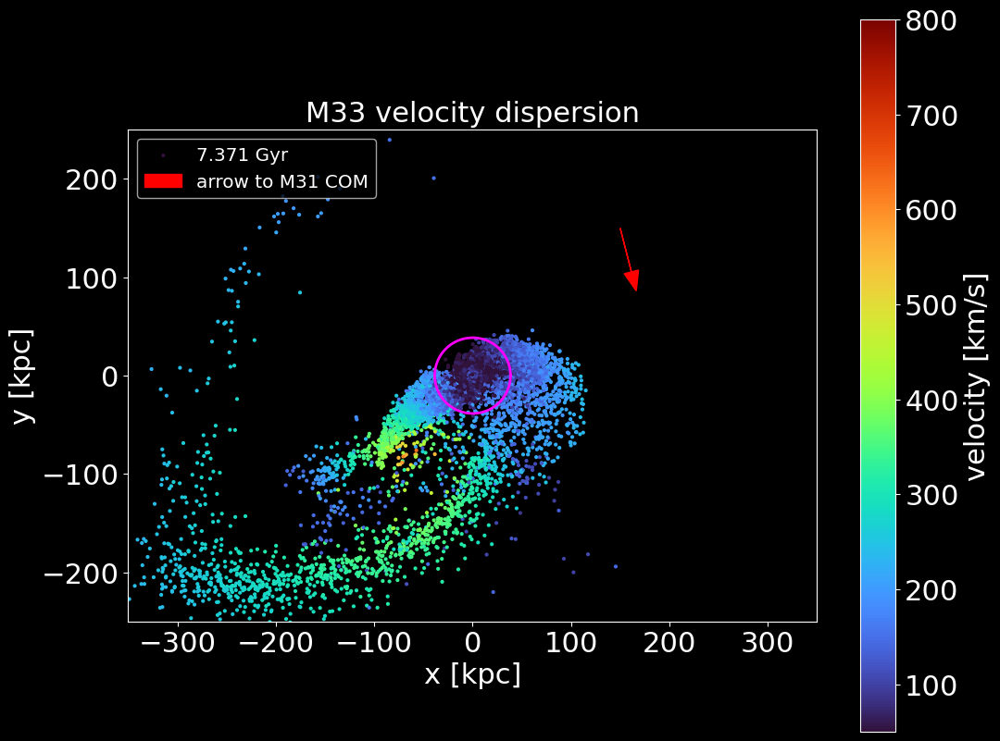

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


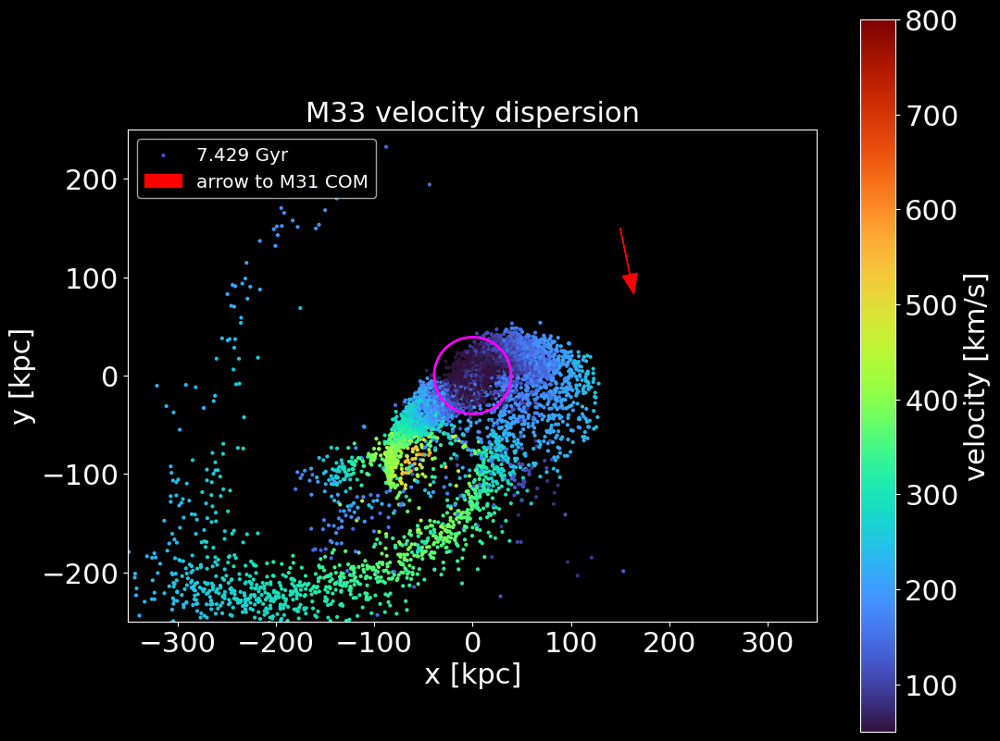

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


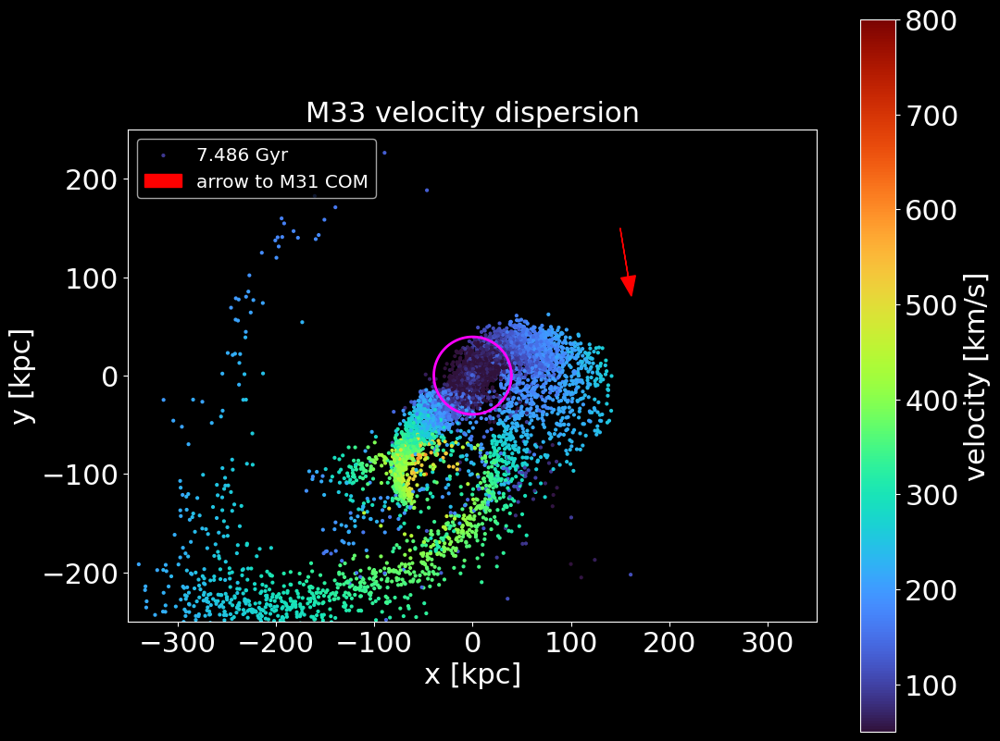

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


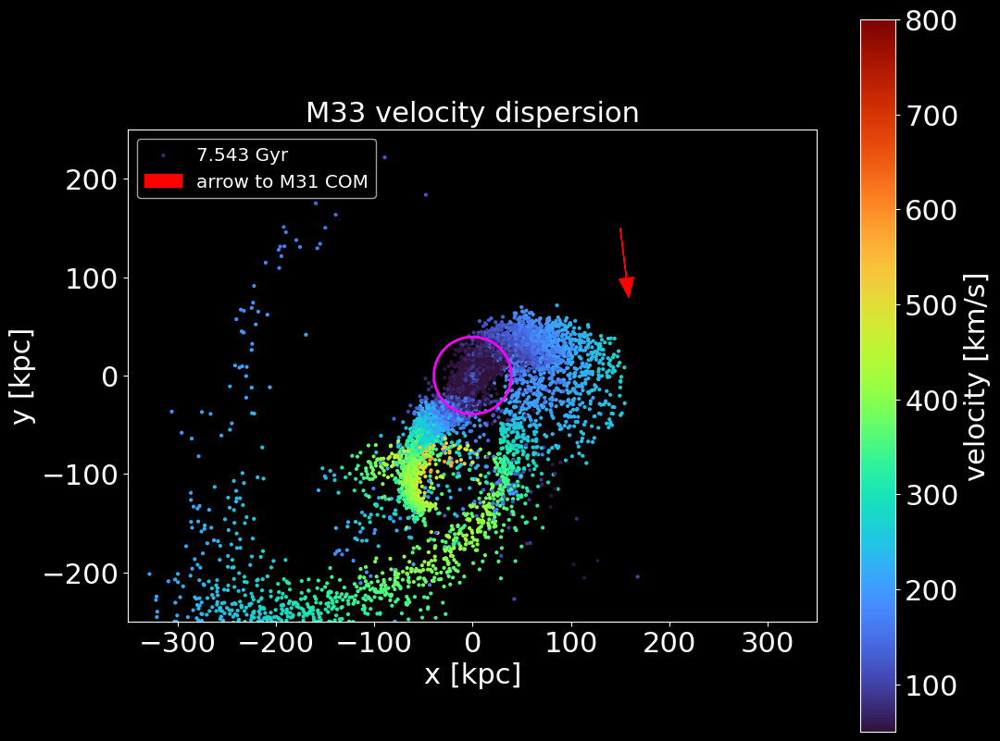

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


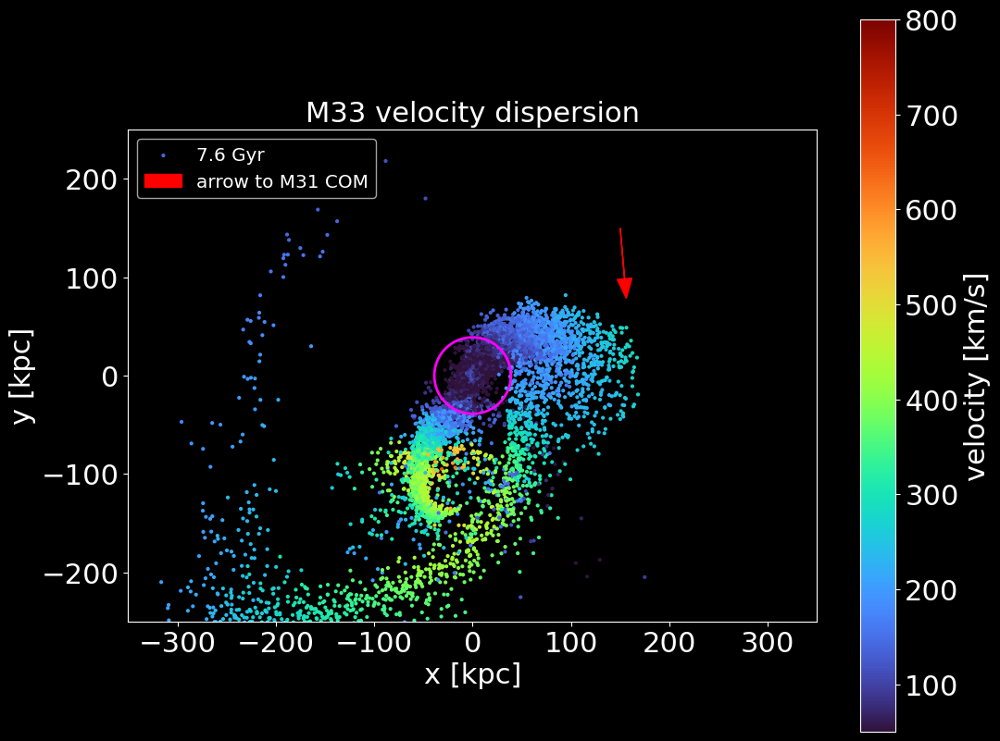

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


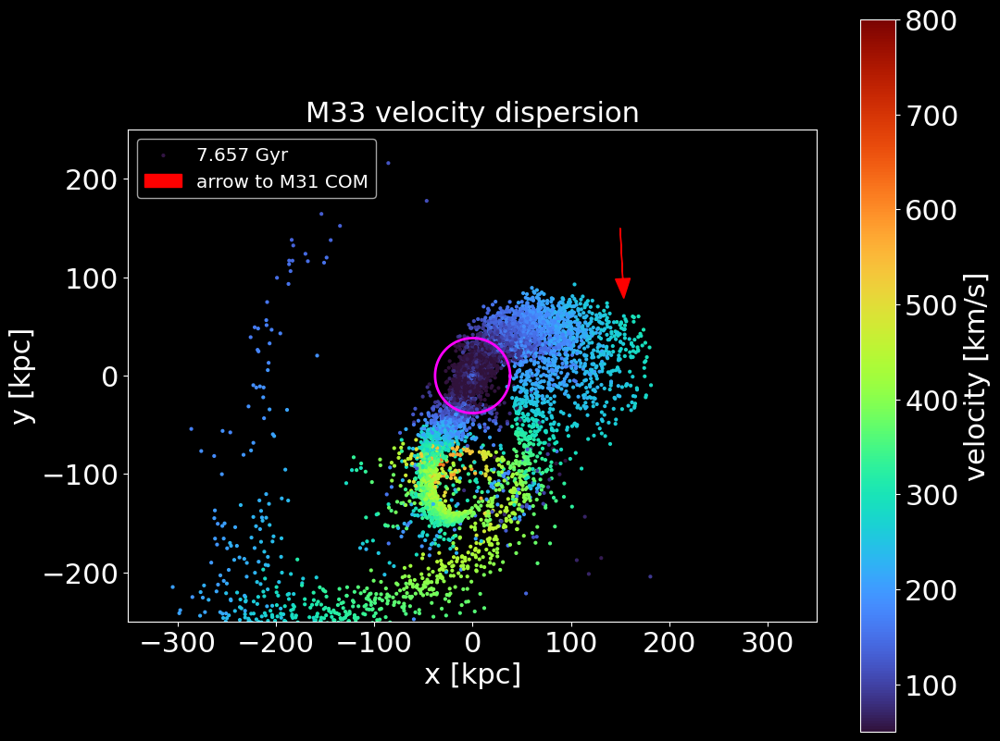

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


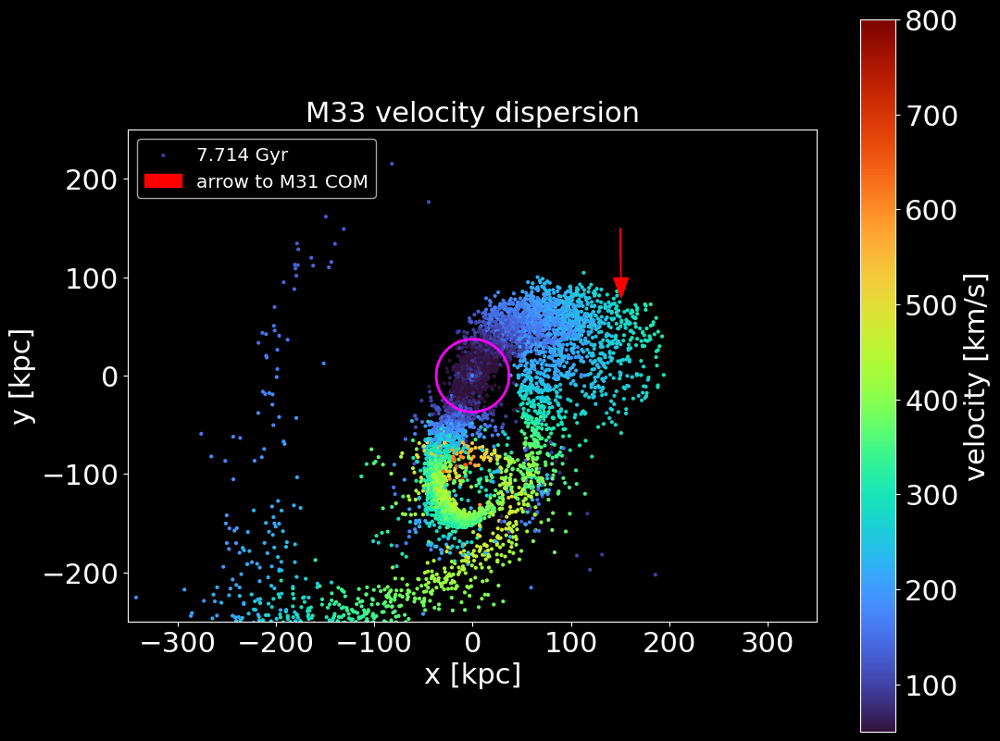

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


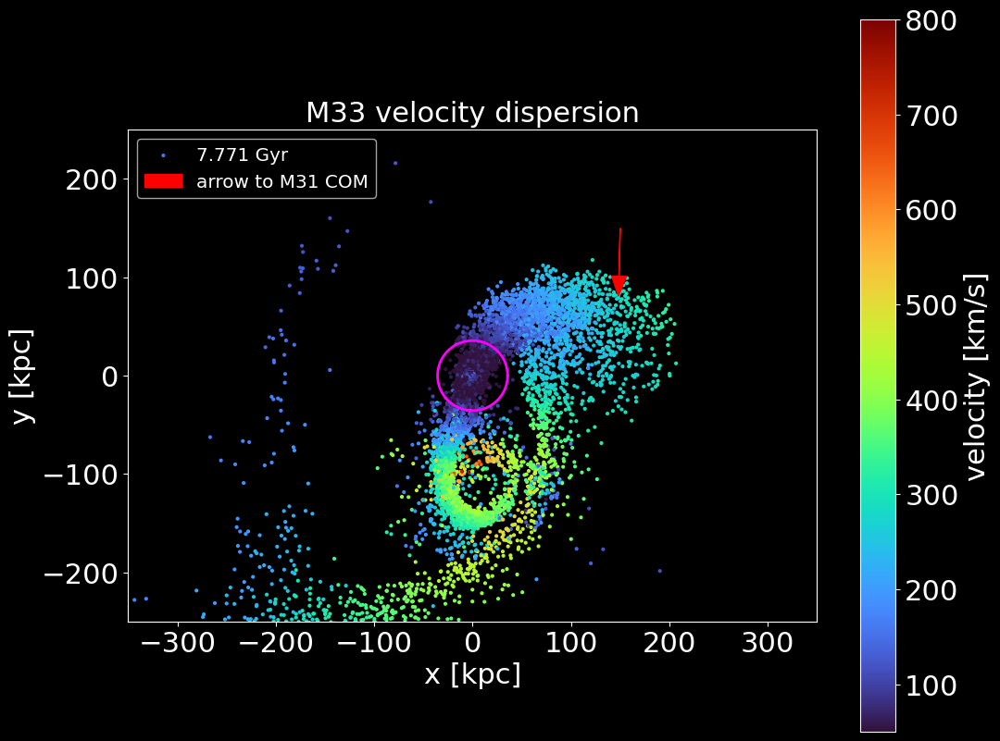

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


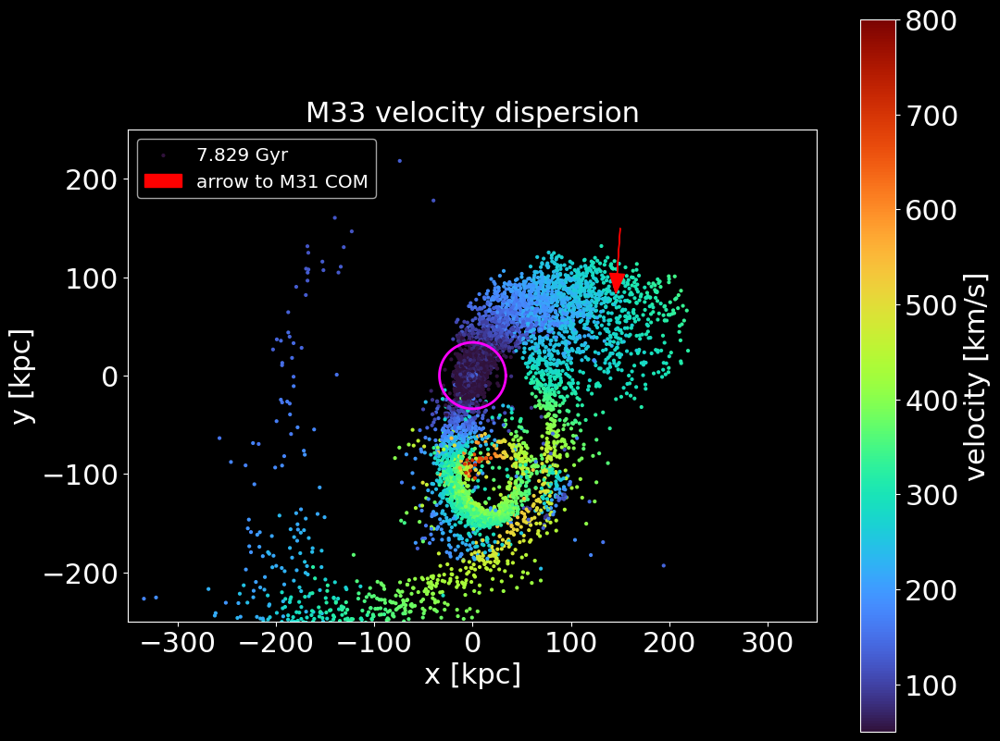

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


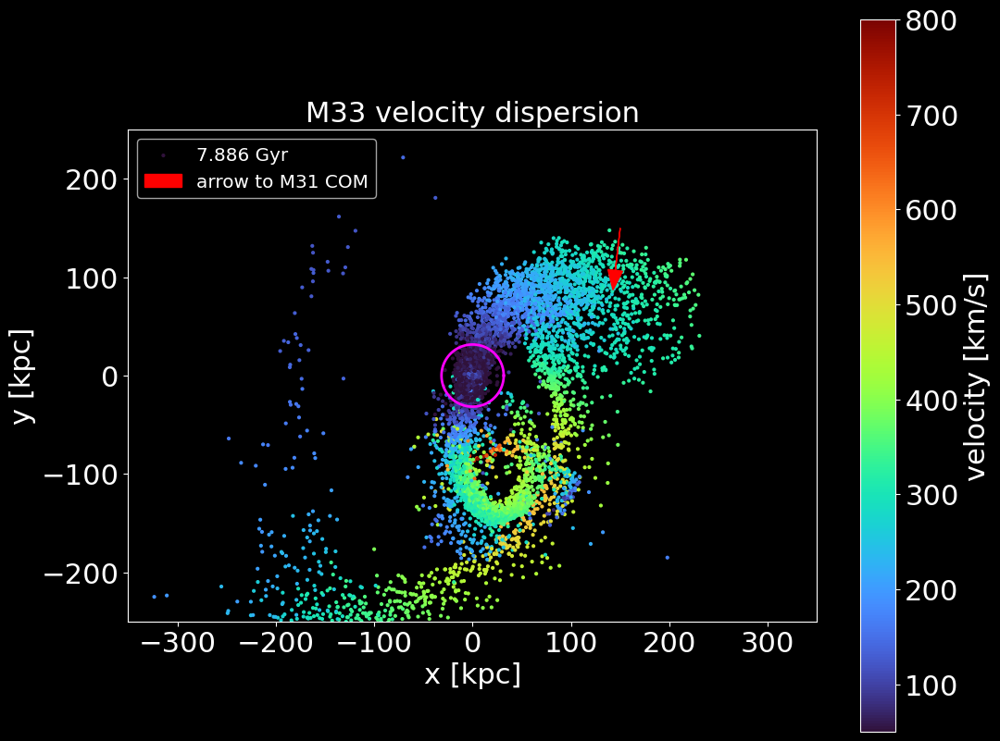

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


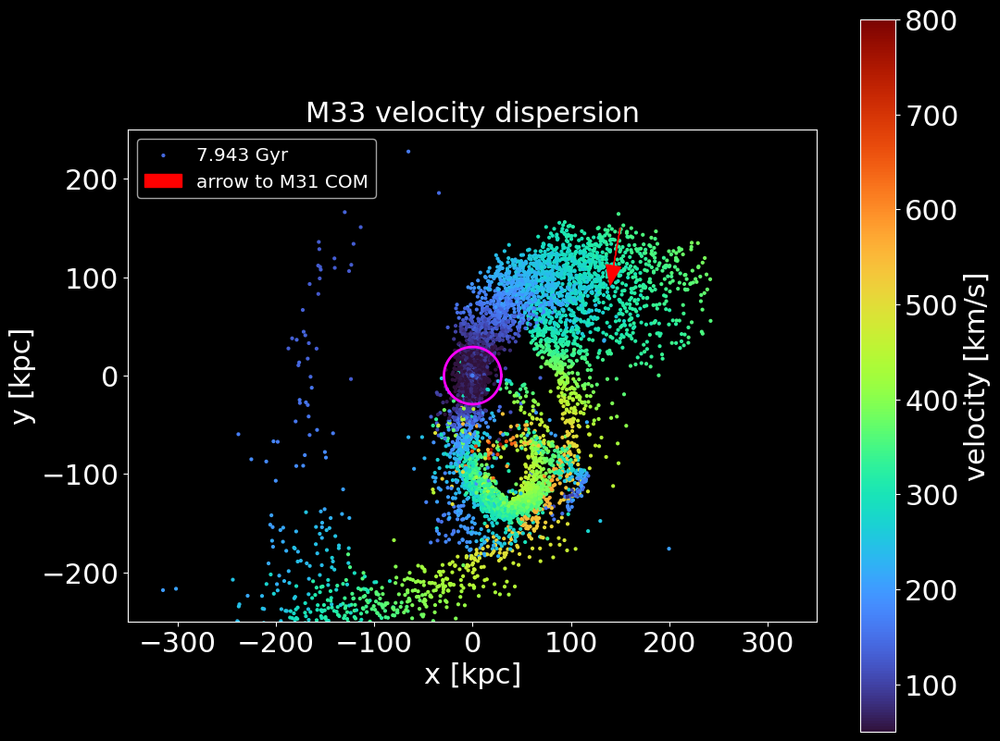

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


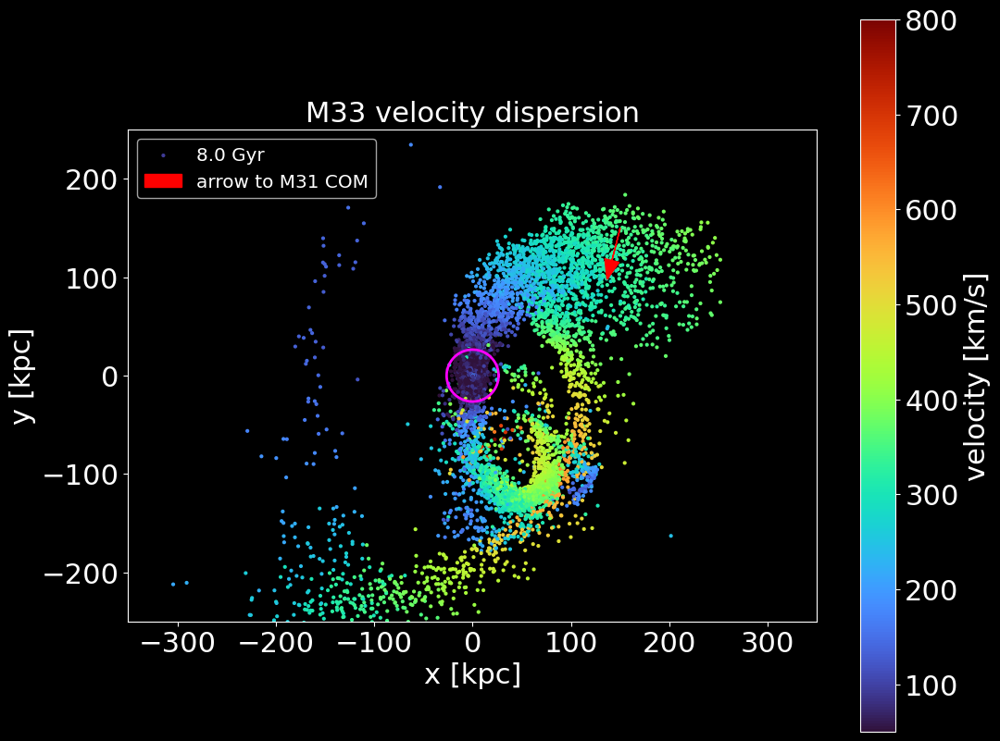

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


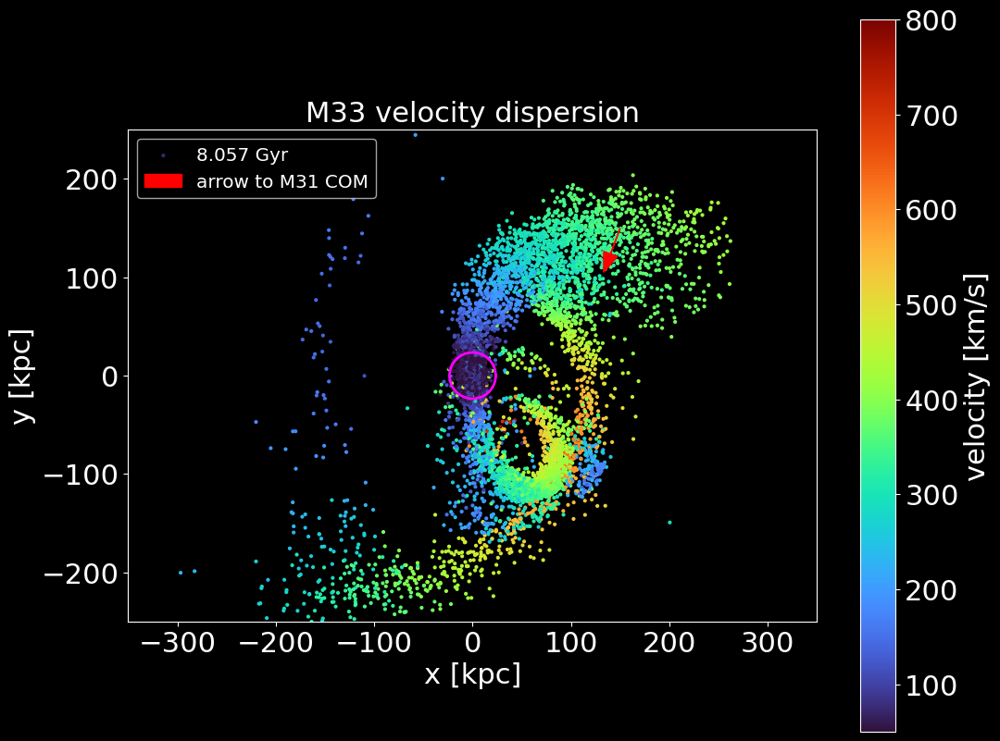

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


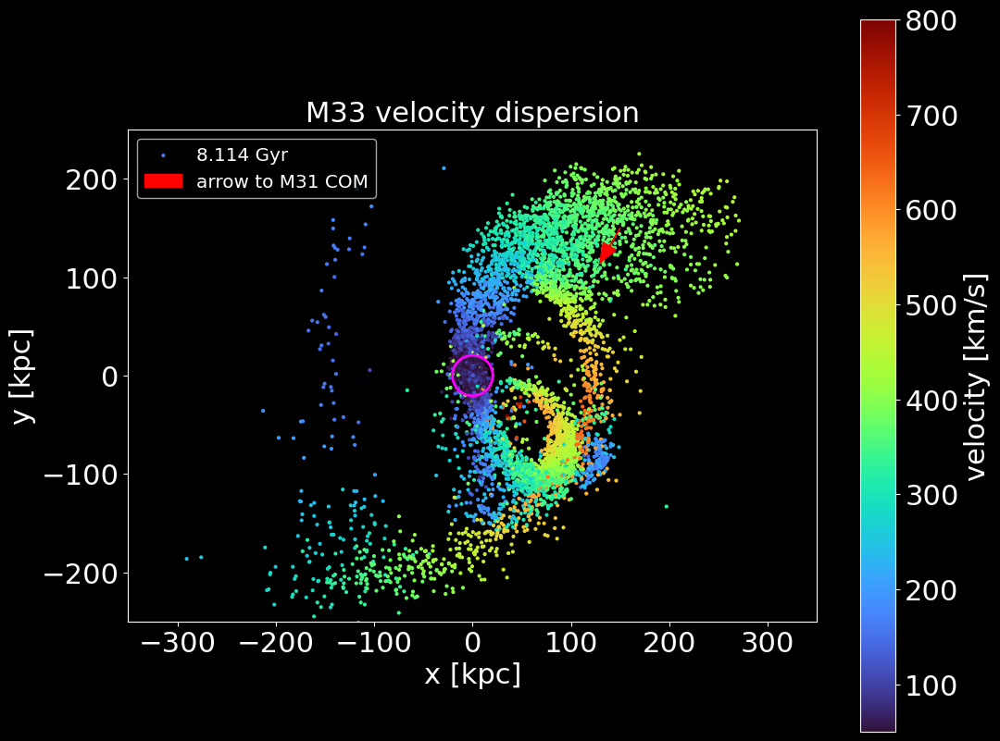

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


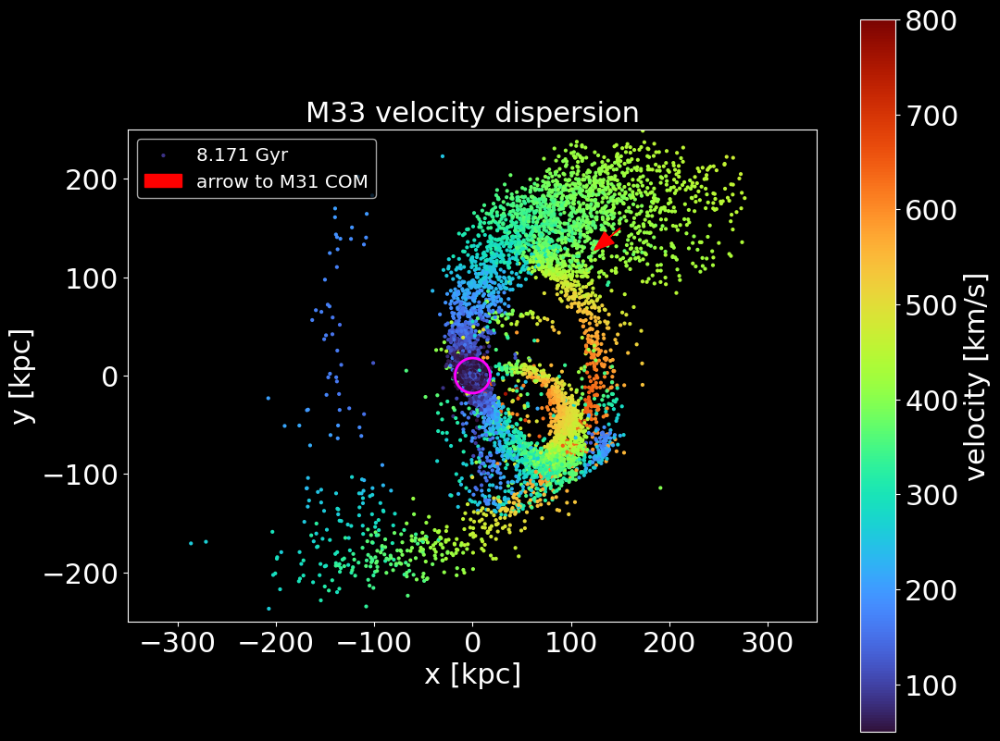

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


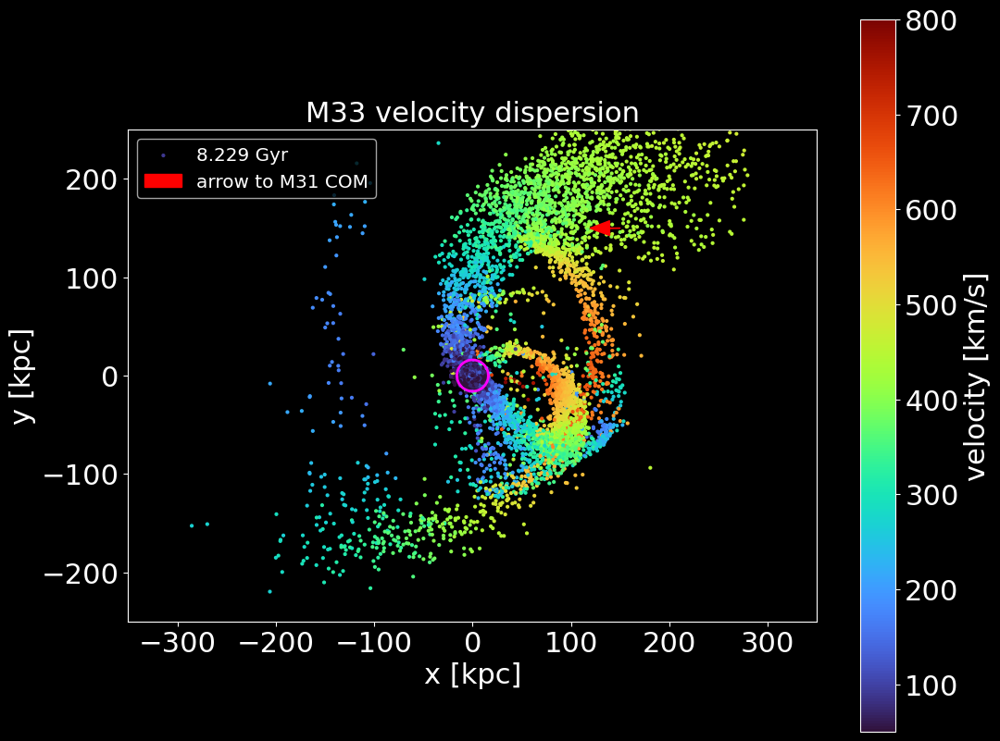

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


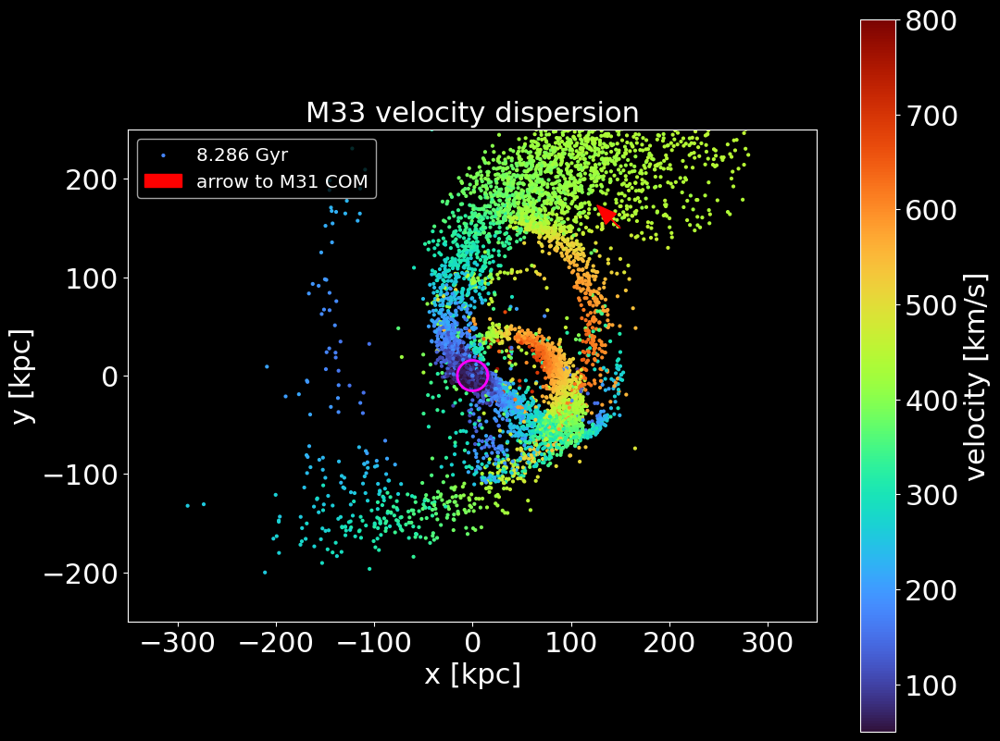

/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:66: RuntimeWarning: invalid value encountered in scalar divide
  a_com = np.sum(a*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:68: RuntimeWarning: invalid value encountered in scalar divide
  b_com = np.sum(b*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:70: RuntimeWarning: invalid value encountered in scalar divide
  c_com = np.sum(c*m)/np.sum(m)


M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


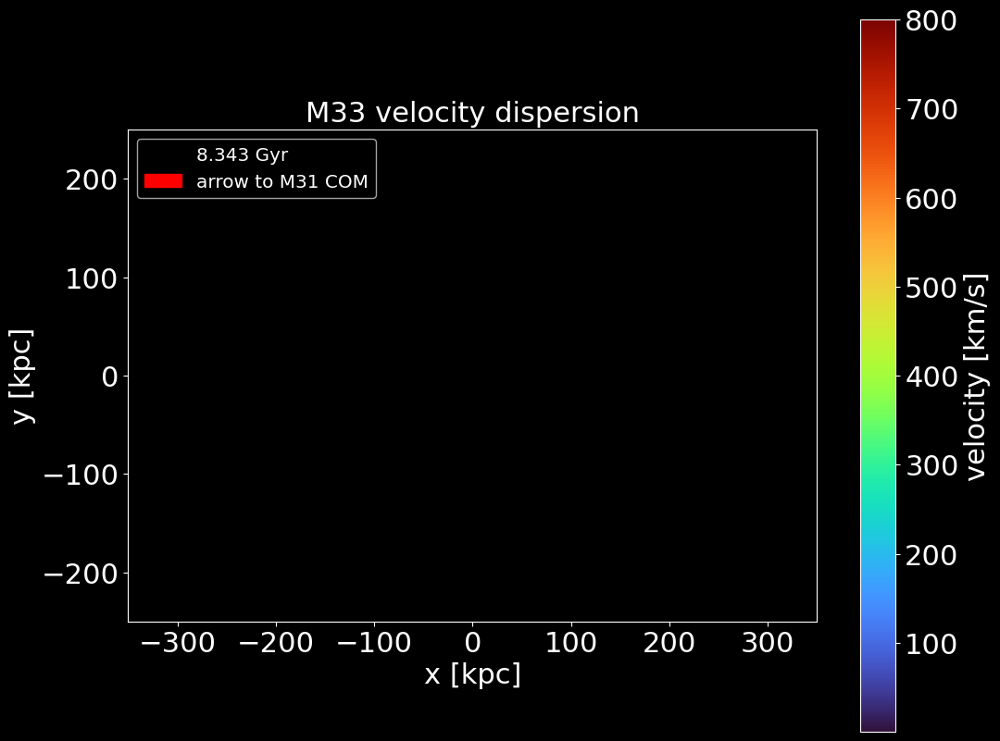

/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:66: RuntimeWarning: invalid value encountered in scalar divide
  a_com = np.sum(a*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:68: RuntimeWarning: invalid value encountered in scalar divide
  b_com = np.sum(b*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:70: RuntimeWarning: invalid value encountered in scalar divide
  c_com = np.sum(c*m)/np.sum(m)


M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


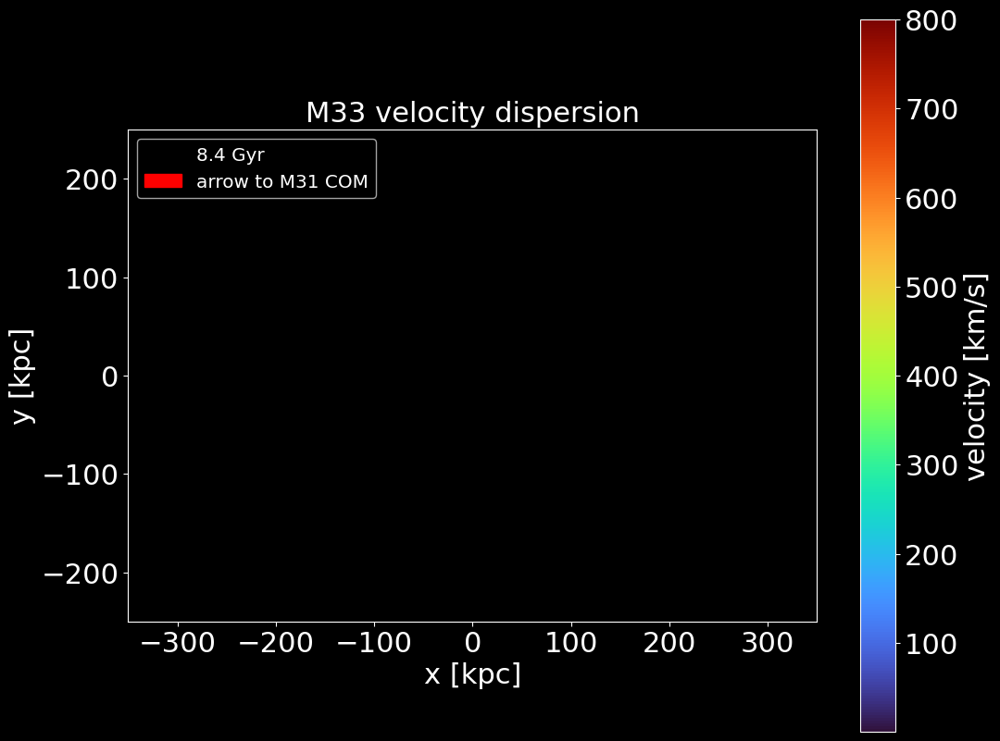

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


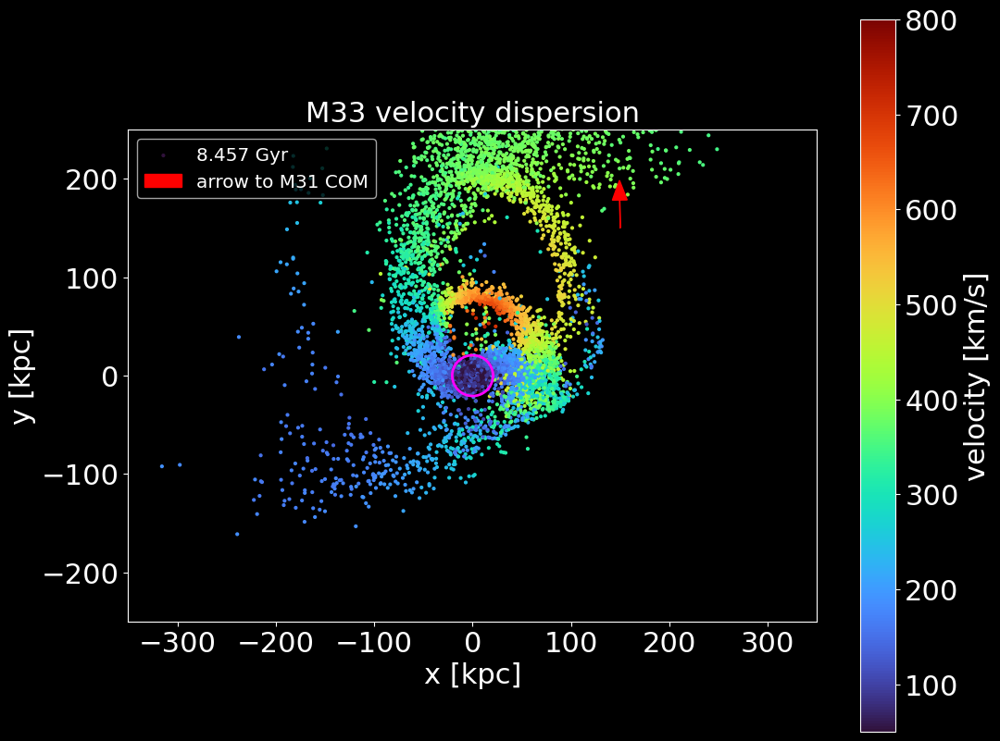

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


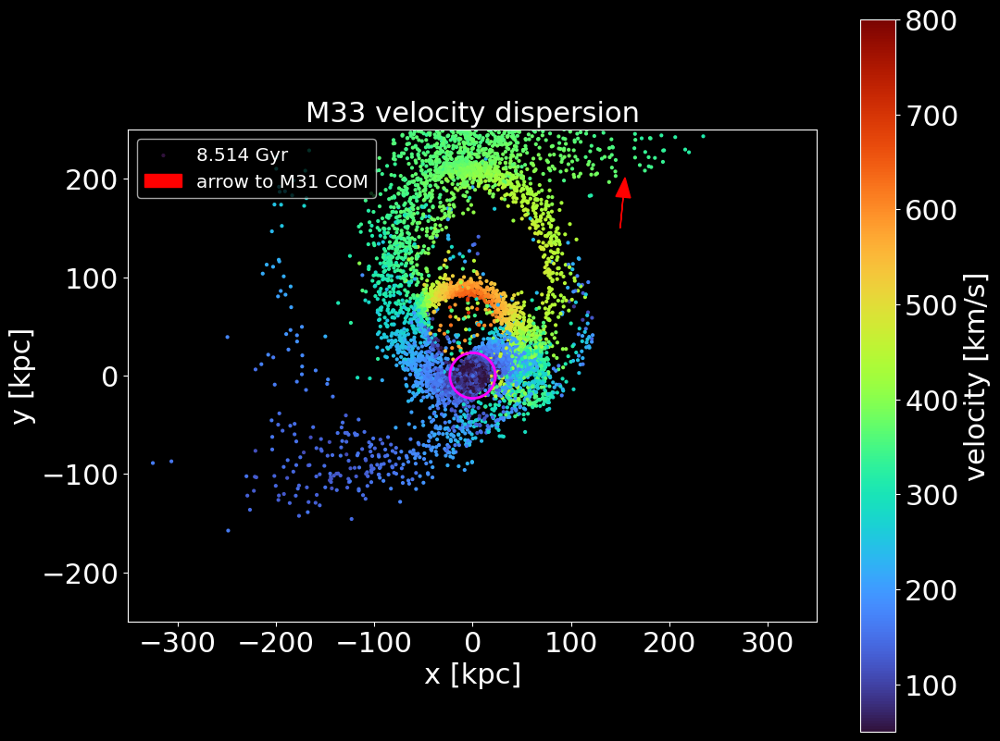

In [41]:
# array of timeteps 
tsteps = np.arange(0,600,4)

for i, step in enumerate(tsteps):# loop over numers in timestep array
    
    # create filename based on corresponding timestep
    if step < 10:
        ilbl = 'M33'+'_00'+str(step)+'.txt'
        ilbl31 = 'M31'+'_00'+str(step)+'.txt'
    elif step >= 10 and step < 100:
        ilbl = 'M33'+'_0'+str(step)+'.txt'
        ilbl31 = 'M31'+'_0'+str(step)+'.txt'
    else:
        ilbl = 'M33'+'_'+str(step)+'.txt'
        ilbl31 = 'M31'+'_'+str(step)+'.txt'

    filename = 'M33'+'/'+ilbl
    M31file = 'M31'+'/'+ilbl31

    # call Positions2D function for positions, velocities, and time
    rn, vn, dist, vel, t, mp = Positions2D(filename)

    #Plotting  code:
    fig, ax= plt.subplots(figsize=(12, 10))
    # c=vel colors the particles based on their velocity magnitude
    plt.scatter(rn[:,0], rn[:,1], c=vel, cmap='turbo', s=4, label=f"{np.round(t,3)} Gyr")


    # plot arrow towards M31 COM
    COMM33 = CenterOfMass(filename,2)
    COMP_33 = COMM33.COM_P(0.1,4).value
    COMM31 = CenterOfMass(M31file,2)
    COMP_31 = COMM31.COM_P(0.1,2).value
    
    plt.arrow(0+150, 0+150, (COMP_31[0]-COMP_33[0])/2, (COMP_31[1]-COMP_33[1])/2, head_width=15, head_length=20, fc='red', ec='red', label='arrow to M31 COM')

    cbar = plt.colorbar()
    plt.clim(50, 800)
    cbar.set_label("velocity [km/s]", fontsize=22)
    
    #Add axis labels
    plt.xlabel('x [kpc]', fontsize=22)
    plt.ylabel('y [kpc]', fontsize=22)
    
    plt.legend(loc='upper left',fontsize='x-large')
    plt.title('M33 velocity dispersion',fontsize=22)

    '''
    plot Jacobi radius code:
    '''
    m31 = Totmass(M31file)
    m33 = Totmass(filename)
    # m33's mass also changes with time but dont worry about that 
    
    R = COMP_33-COMP_31
    R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2)
    
    rj = JacobiR(m31, m33, R_mag)

    # plot circle or radius = jacobi radius
    theta = np.linspace(0, 2*np.pi, 100)
    circx = rj * np.cos(theta)
    circy = rj * np.sin(theta)     
    plt.plot(circx, circy, linewidth=2, color='magenta')
    plt.gca().set_aspect('equal', adjustable='box') # Ensure circle appears as a circle

    # #set axis limits
    plt.ylim(-250,250)
    plt.xlim(-350,350)
    
    #adjust tick label font size
    label_size = 22
    matplotlib.rcParams['xtick.labelsize'] = label_size 
    matplotlib.rcParams['ytick.labelsize'] = label_size

    # Save file
    if i < 10:
        plt.savefig('00'+str(i)+'.png')
    elif 10 <= i < 100:
        plt.savefig('0'+str(i)+'.png')
    else:
        plt.savefig(str(i)+'.png')

    plt.style.use("dark_background")
    plt.show()



In [ ]:
# first close encounter at file number 280

# Step 3: plot Jacobi radius over 2D M33 velocity dispersion plots

We are insterested in the stellar streams, which will exist at a distance of or above the Jacobi radius
\begin{equation}
    R_j = r  \bigg( \frac{M_{sat}}{2 M_{host}(<r)} \bigg)^{1/3}
\end{equation}

In [33]:
def JacobiR(Mhost, Msat, r):
    '''
    Function that computes the Jacobi radius of a
    satellite around a host galaxy.
    INPUTS:
        Mhost = 'float', mass of host galaxy in solar masses
        Msat = 'float', mass of satellite galaxy in solar masses
        r = 'float', semi major axis of the satellite's orbit around the primary in kpc
        m = mass of a test particle in solar masses
    OUTPUTS:
        Rj = 'float', Jacobi radius in kpc

    '''
    a = Msat**(1/3) 
    b = (2*Mhost)**(1/3)

    Rj = r*(a/b)

    return Rj
    

In [35]:
def Totmass(filename):
    '''
    Function that computes the total mass within a radius of R
    INPUT: 
        r = array, array of distance magitudes of M31 particles (how far from COMP)
        R = 'float', magnitude of distance between M33 and M31
    OUTPUT:
        M = 'float', mass of M31 within radius R
    '''
    bulge = ComponentMass(filename,3)*1e12 # bulge 
    disk = ComponentMass(filename,2)*1e12 # disk 
    halo = ComponentMass(filename,1)*1e12 #dark matter

    M = bulge+disk+halo
    
    
    return M
        

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses
72.86034182525817
Jacobi radius: 72.86034182525817


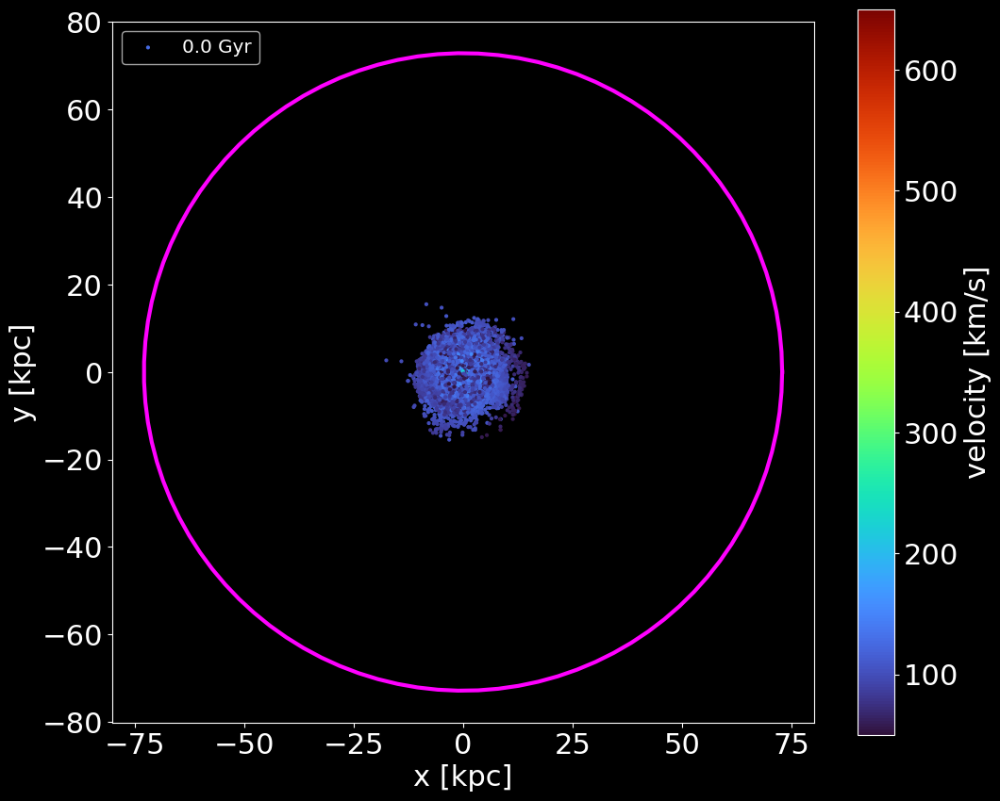

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses
78.69107720474781
Jacobi radius: 78.69107720474781


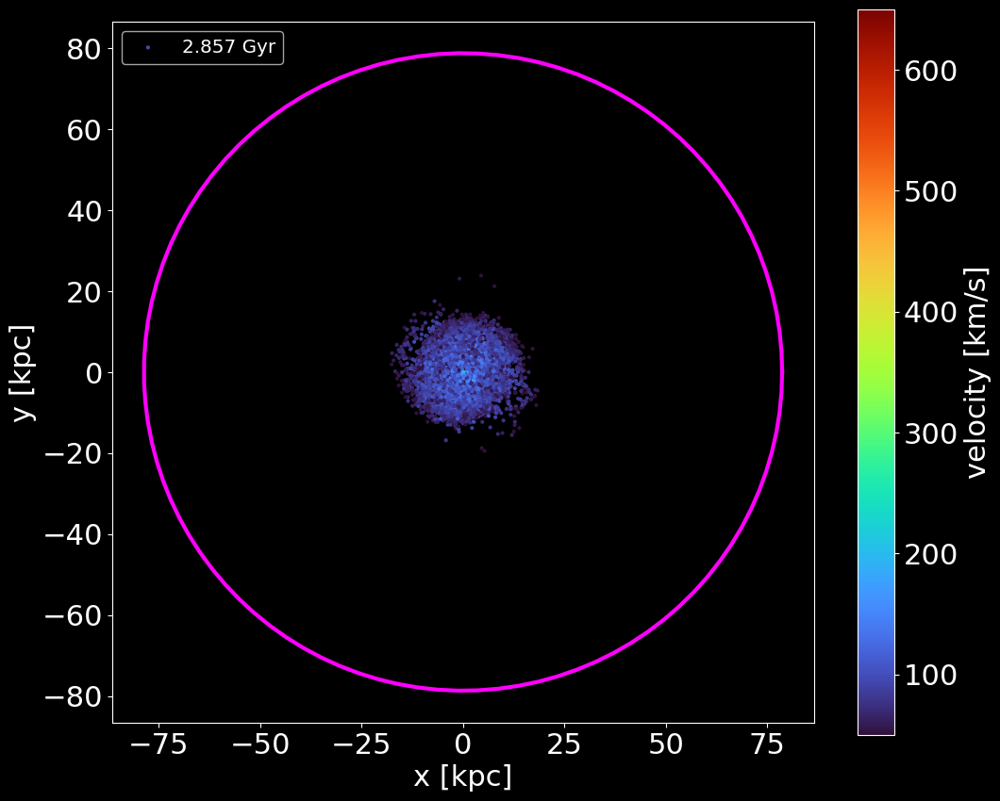

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses
53.633856811899264
Jacobi radius: 53.633856811899264


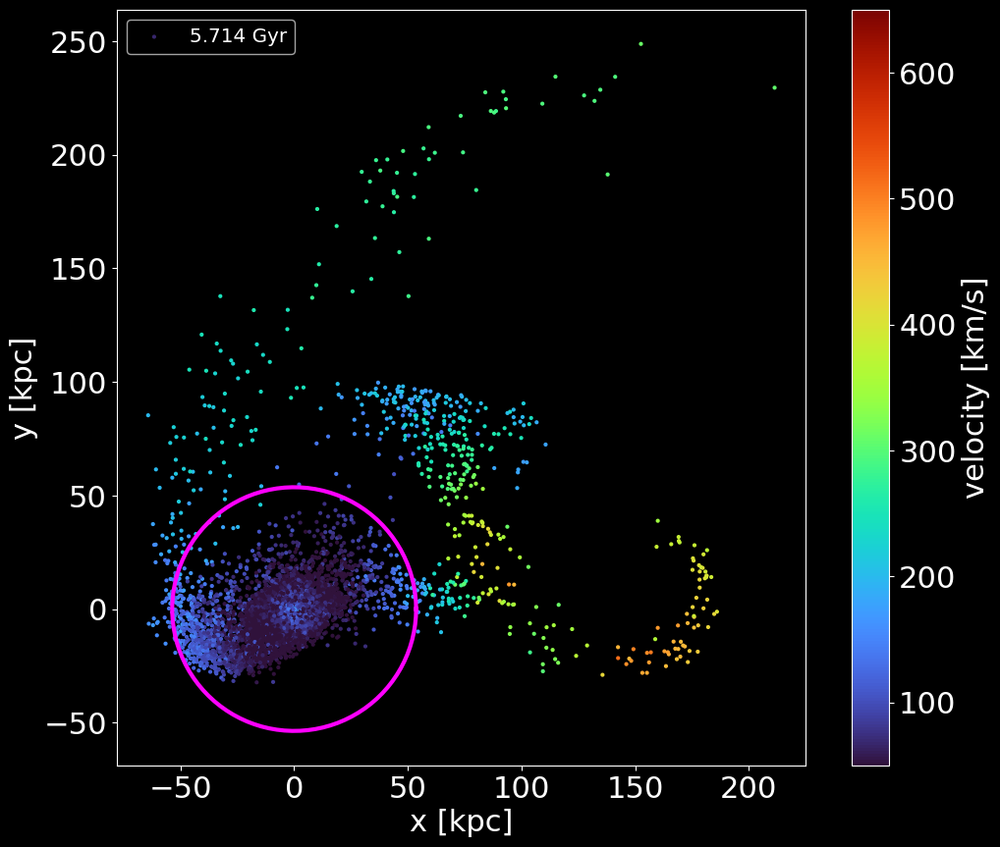

In [68]:
# array of timeteps 
tsteps = np.arange(0,600,200)


for i, step in enumerate(tsteps):# loop over numers in timestep array
    
    # create filename based on corresponding timestep
    if step < 10:
        ilbl = 'M33'+'_00'+str(step)+'.txt'
        ilbl31 = 'M31'+'_00'+str(step)+'.txt'
    elif step >= 10 and step < 100:
        ilbl = 'M33'+'_0'+str(step)+'.txt'
        ilbl31 = 'M31'+'_0'+str(step)+'.txt'
    else:
        ilbl = 'M33'+'_'+str(step)+'.txt'
        ilbl31 = 'M31'+'_'+str(step)+'.txt'

    filename = 'M33'+'/'+ilbl
    M31file = 'M31'+'/'+ilbl31

    # call Positions2D function for positions, velocities, and time
    rn, vn, dist, vel, t, mp = Positions2D(filename)

    #Plotting  code:
    #plt.style.use('default')
    
    # c=vel colors the particles based on their velocity magnitude
    plt.scatter(rn[:,0], rn[:,1], c=vel, cmap='turbo', s=4, label=f"{np.round(t,3)} Gyr")

    '''
    plot Jacobi radius code:
    '''
    # # distance between M31com and M33com
    COMM33 = CenterOfMass(filename,2)
    COMP_33 = COMM33.COM_P(0.1,4).value
    COMM31 = CenterOfMass(M31file,2)
    COMP_31 = COMM31.COM_P(0.1,2).value
    
    R = COMP_33-COMP_31
    R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2)
    mass31 = COMM31.m    # must sum all mass particles 
    r = np.sqrt(rn[:,0]**2+rn[:,1]**2)

    m31 = Totmass(M31file)
    m33 = Totmass(filename)
    # m33's mass also changes with time but dont worry about that 

    rj = JacobiR(m31, m33, R_mag)
    print(rj)

    # plot circle or radius = jacobi radius
    theta = np.linspace(0, 2*np.pi, 100)
    circx = rj * np.cos(theta)
    circy = rj * np.sin(theta)     
    plt.plot(circx, circy, linewidth=3, color='magenta')
    plt.gca().set_aspect('equal', adjustable='box') # Ensure circle appears as a circle
    
    cbar = plt.colorbar()
    plt.clim(50, 650)
    cbar.set_label("velocity [km/s]", fontsize=22)
    cbar.ax.tick_params(labelsize=22) 
    
    #Add axis labels
    plt.xlabel('x [kpc]', fontsize=22)
    plt.ylabel('y [kpc]', fontsize=22)
    
    plt.legend(loc='upper left',fontsize='x-large')
    #plt.title('M33 velocity dispersion',fontsize=22)
    
    #adjust tick label font size
    label_size = 22
    matplotlib.rcParams['xtick.labelsize'] = label_size 
    matplotlib.rcParams['ytick.labelsize'] = label_size

    print('Jacobi radius:',rj)

    plt.style.use("dark_background")
    plt.show()


# Plot significant frames of M33 velocity dispersion

In [282]:
rn1, vn1, dist1, vel1, t1, mp = Positions2D('M33/M33_000.txt') # present
rn2, vn2, dist2, vel2, t2, mp = Positions2D('M33/M33_306.txt') # first MW-M31 close encounter
rn3, vn3, dist3, vel3, t3, mp = Positions2D('M33/M33_330.txt') # between encounters
rn4, vn4, dist4, vel4, t4, mp = Positions2D('M33/M33_414.txt') # second MW-M31 close encounter
rn5, vn5, dist5, vel5, t5, mp = Positions2D('M33/M33_456.txt') # merger
rn6, vn6, dist6, vel6, t6, mp = Positions2D('M33/M33_562.txt') # remant

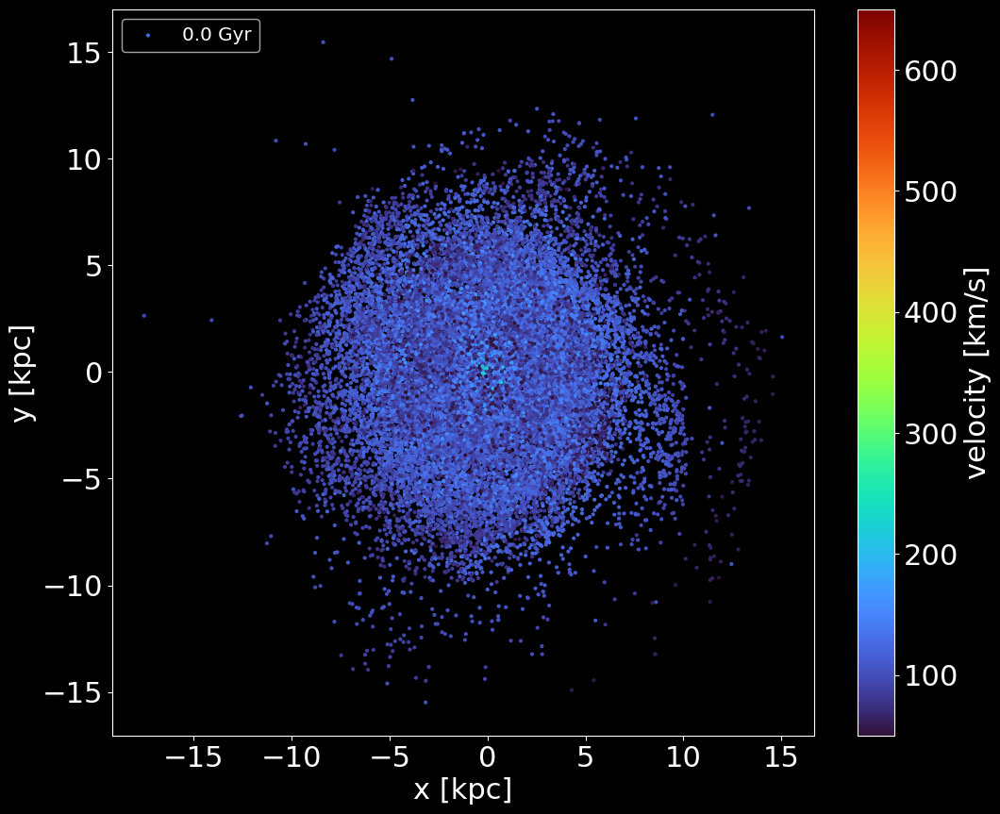

In [218]:

fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn1[:,0], rn1[:,1], c=vel1, cmap='turbo', s=4, label=f"{np.round(t1,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 
    
#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_0.png')


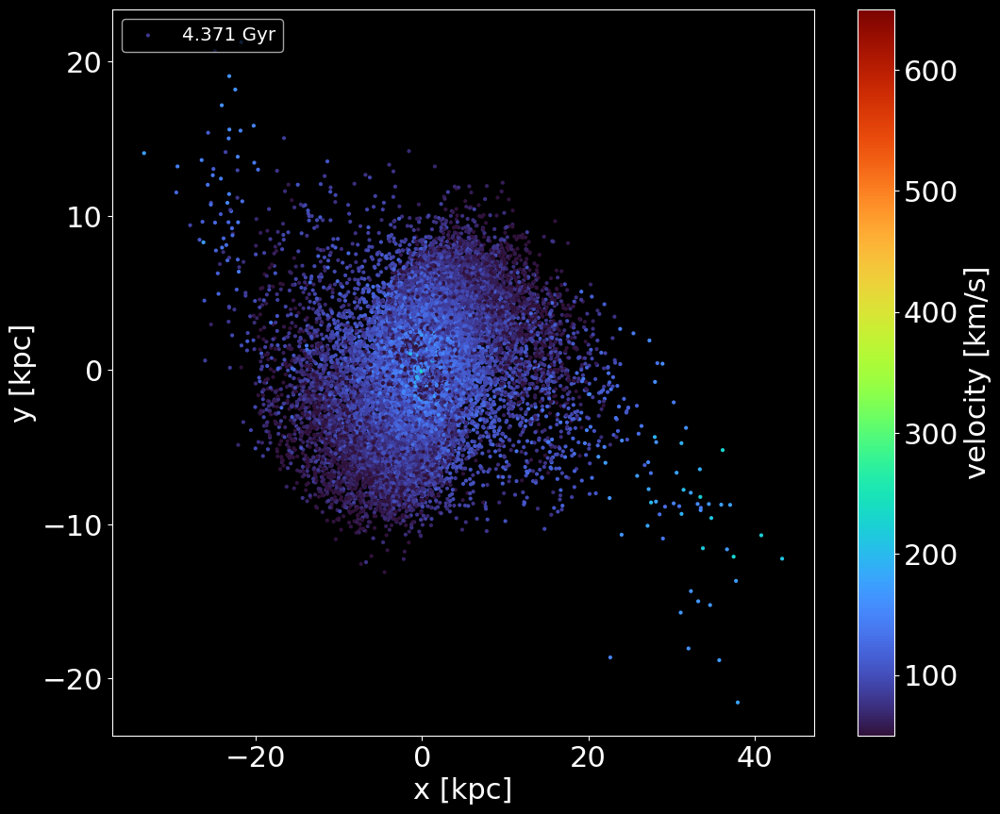

In [256]:
fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn2[:,0], rn2[:,1], c=vel2, cmap='turbo', s=4, label=f"{np.round(t2,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 
    
#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_1.png')

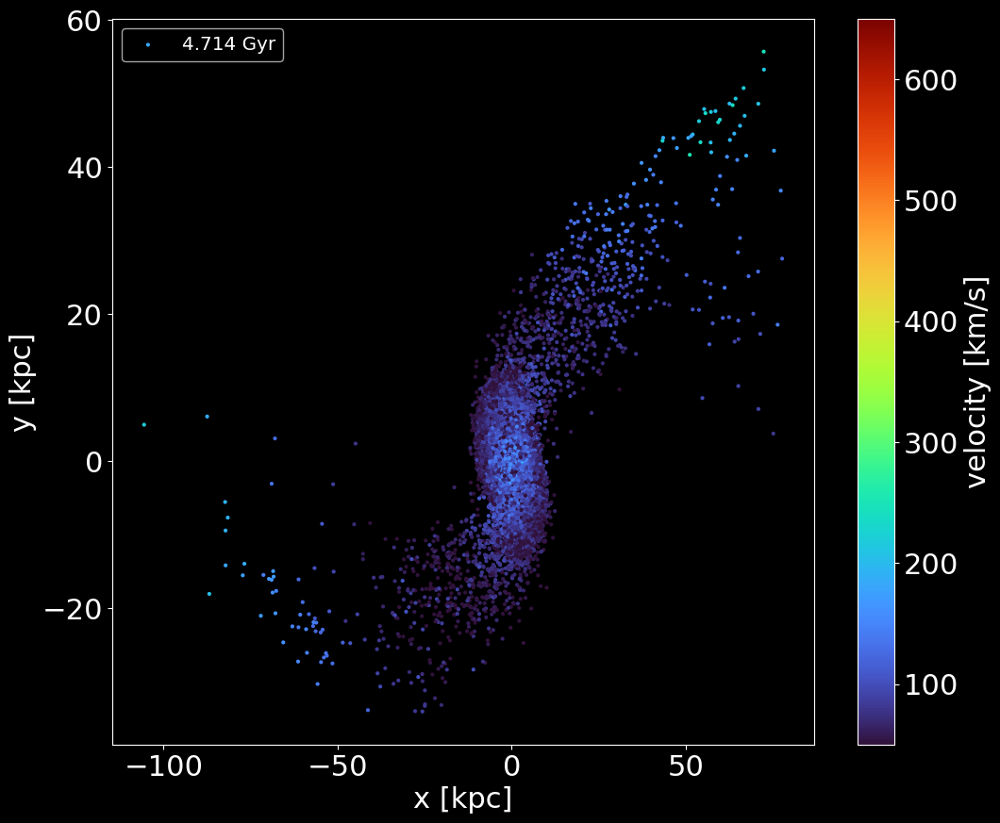

In [284]:
fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn3[:,0], rn3[:,1], c=vel3, cmap='turbo', s=4, label=f"{np.round(t3,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 
    
#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_2.png')

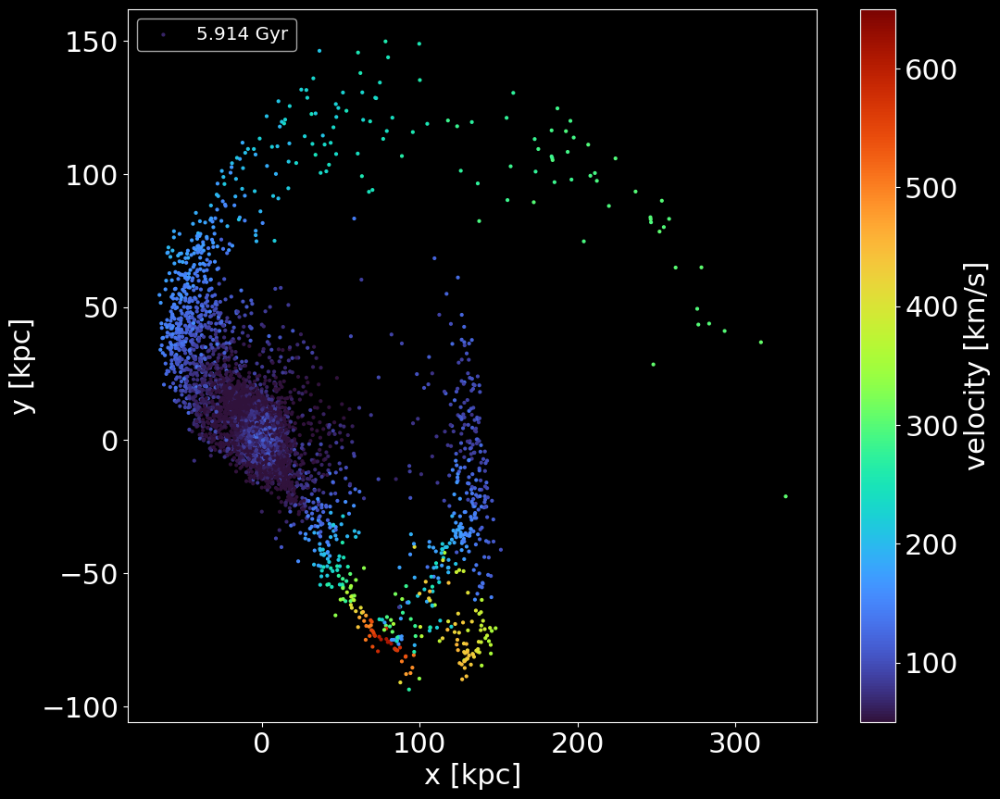

In [244]:
fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn4[:,0], rn4[:,1], c=vel4, cmap='turbo', s=4, label=f"{np.round(t4,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 
    
#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_3.png')

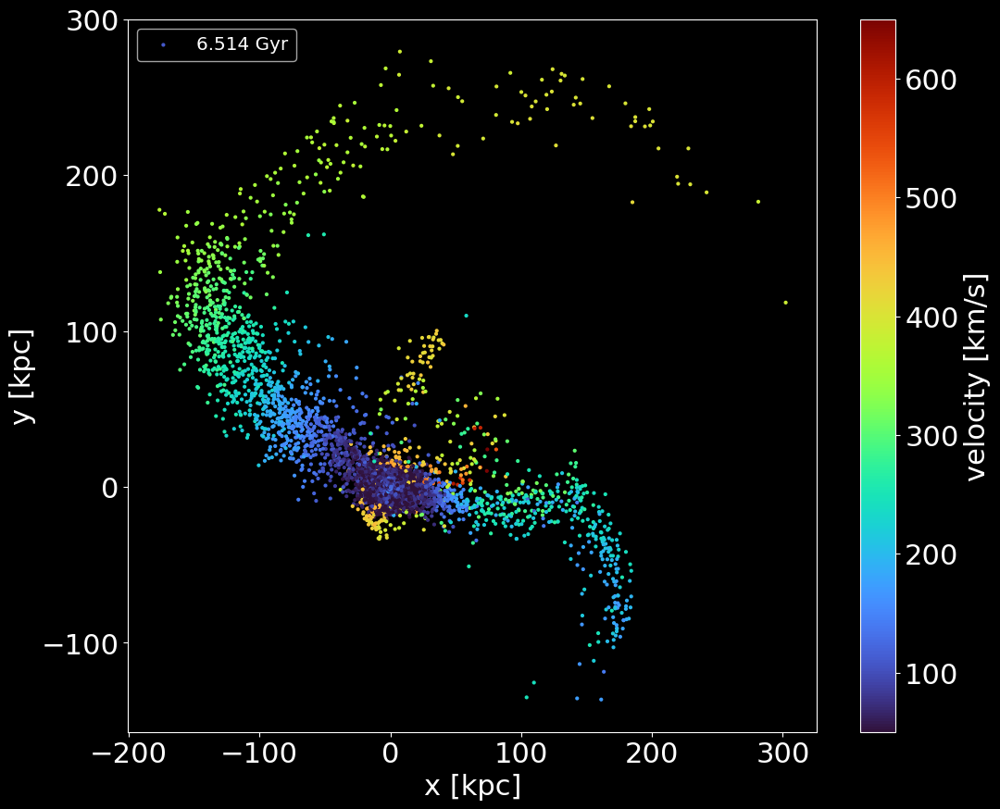

In [226]:
fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn5[:,0], rn5[:,1], c=vel5, cmap='turbo', s=4, label=f"{np.round(t5,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 
    
#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_4.png')

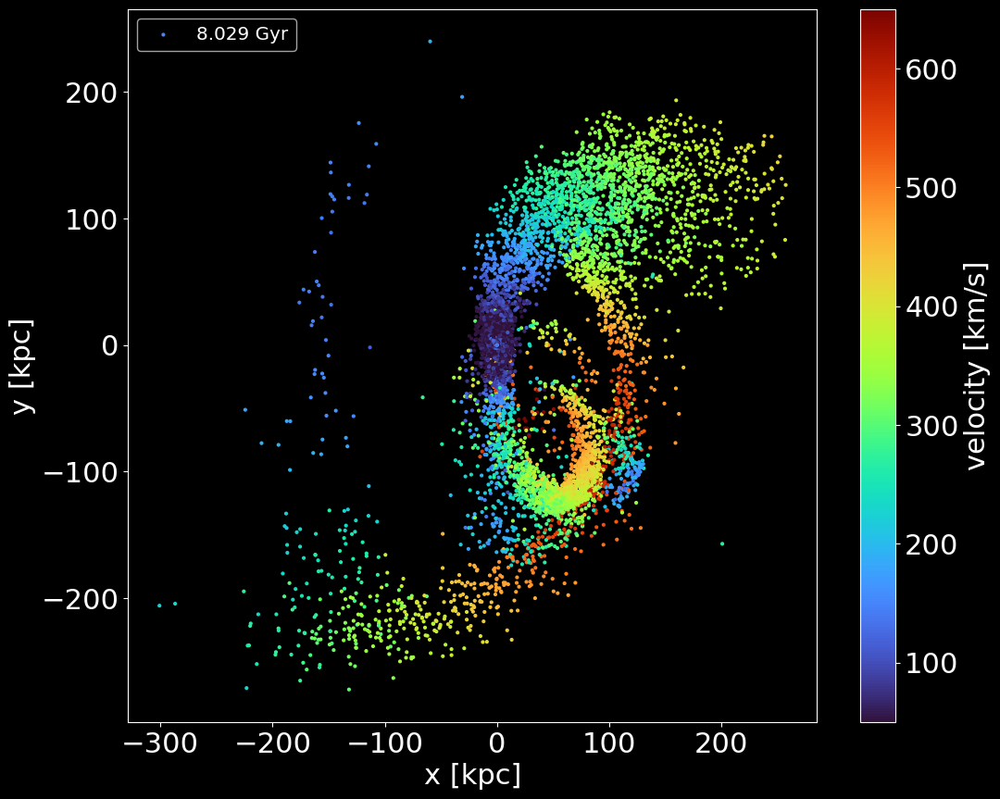

In [228]:
fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn6[:,0], rn6[:,1], c=vel6, cmap='turbo', s=4, label=f"{np.round(t6,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 
    
#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_5.png')

In [734]:
#**** ask if jacobi radius is correct

# Step 4: make velocity dispersion plots of just stellar streams and make v_avg vs time plot

Use lab9 tracking particles code to choose stellar stream particles, where cylindrical radius index is jacobi radius

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


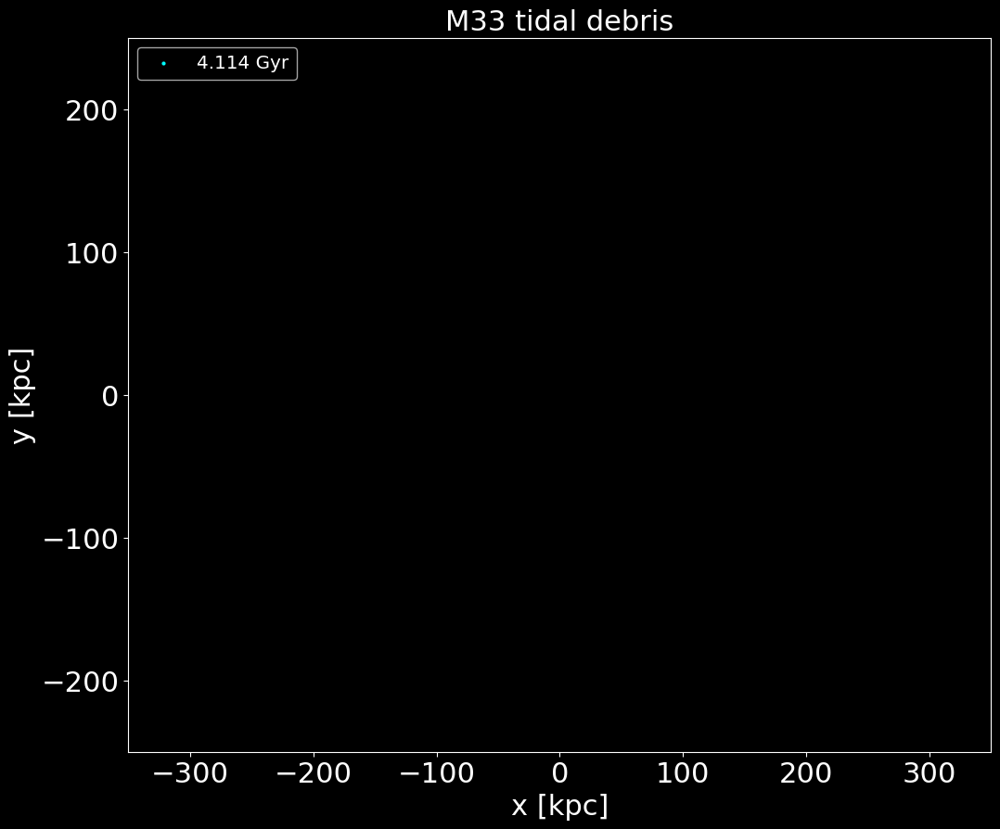

/opt/anaconda3/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/anaconda3/lib/python3.12/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


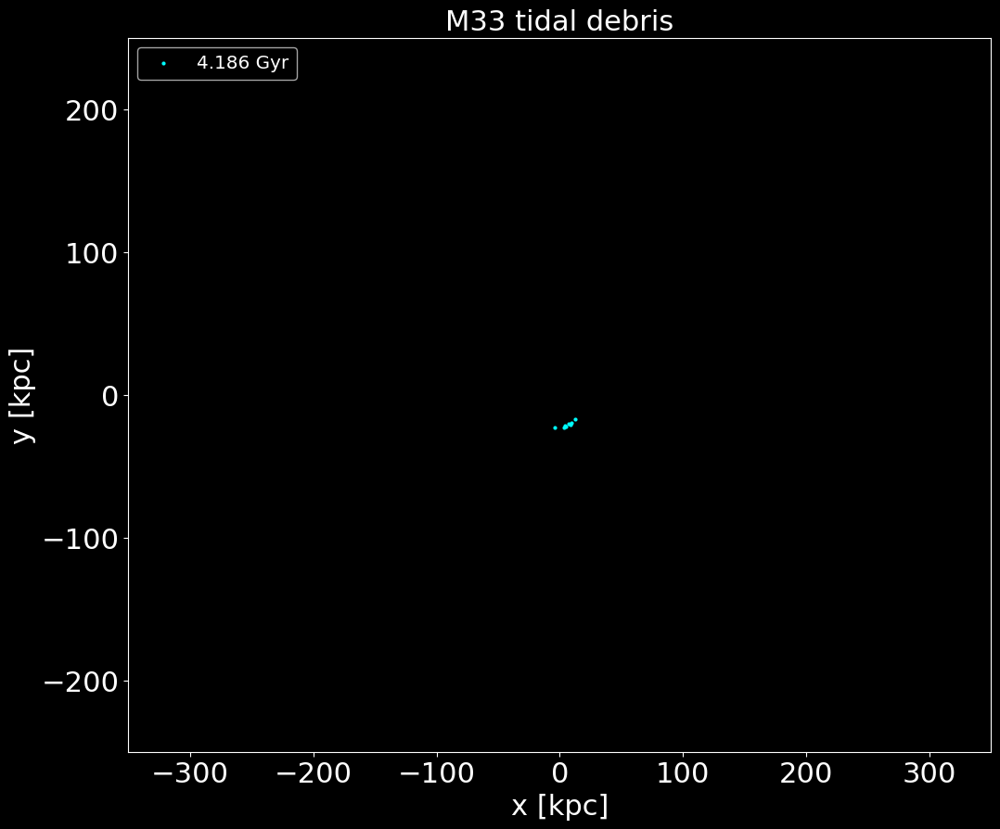

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


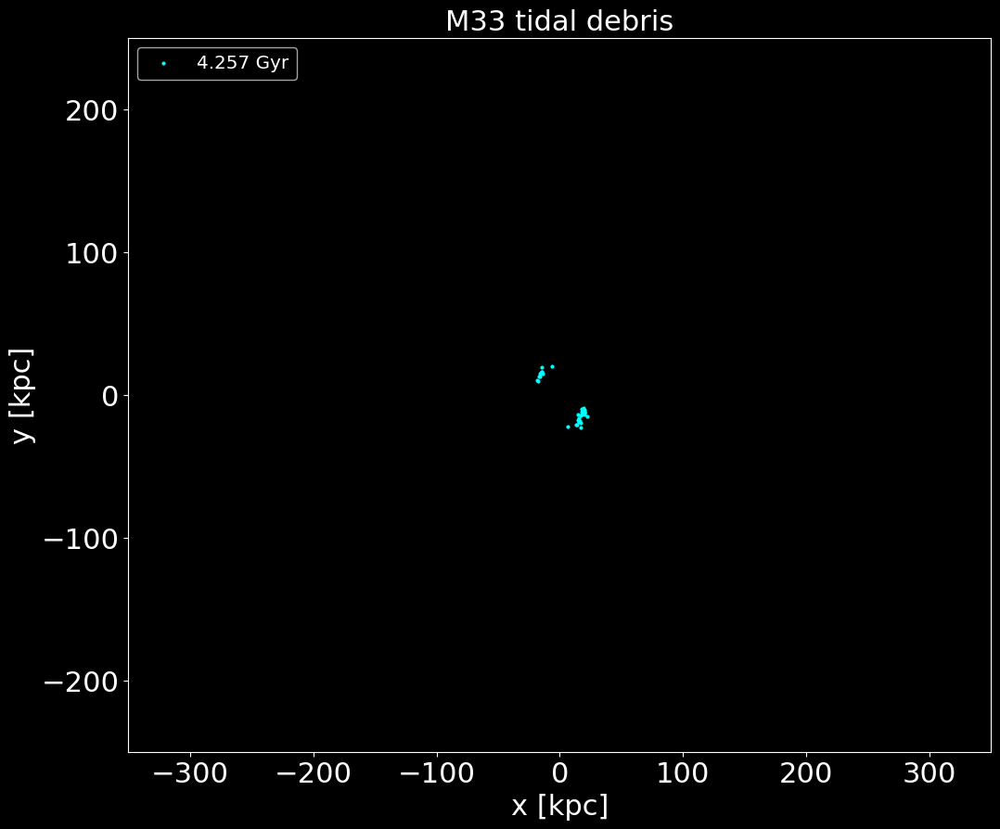

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


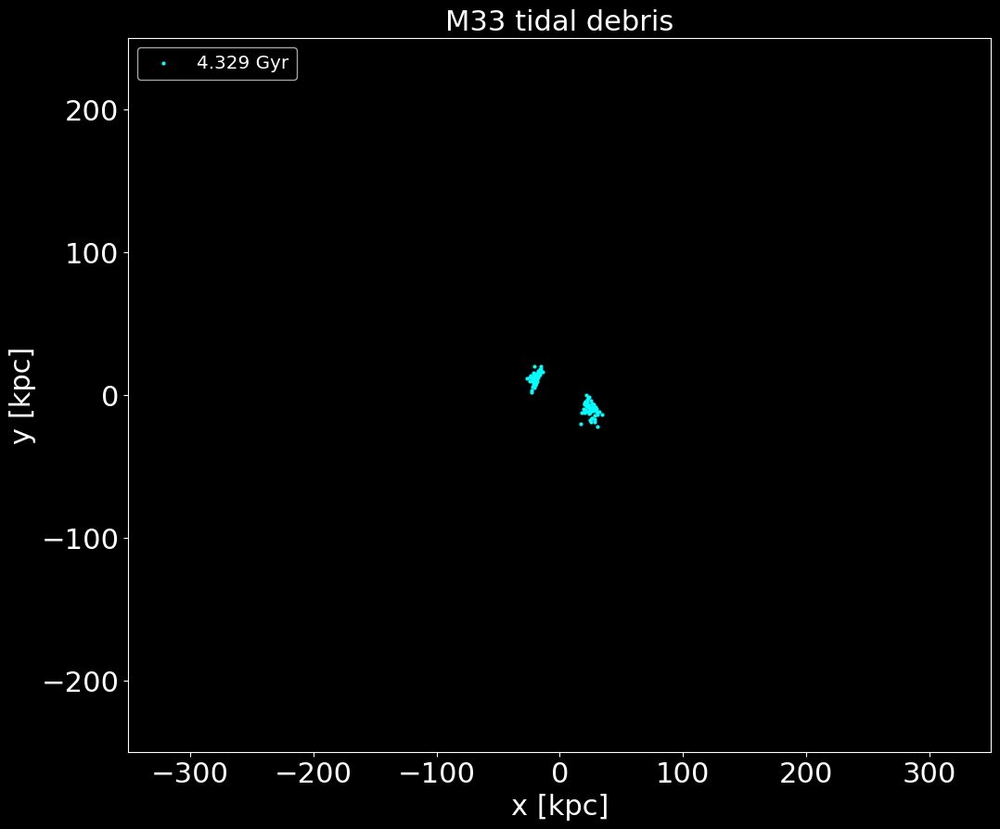

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


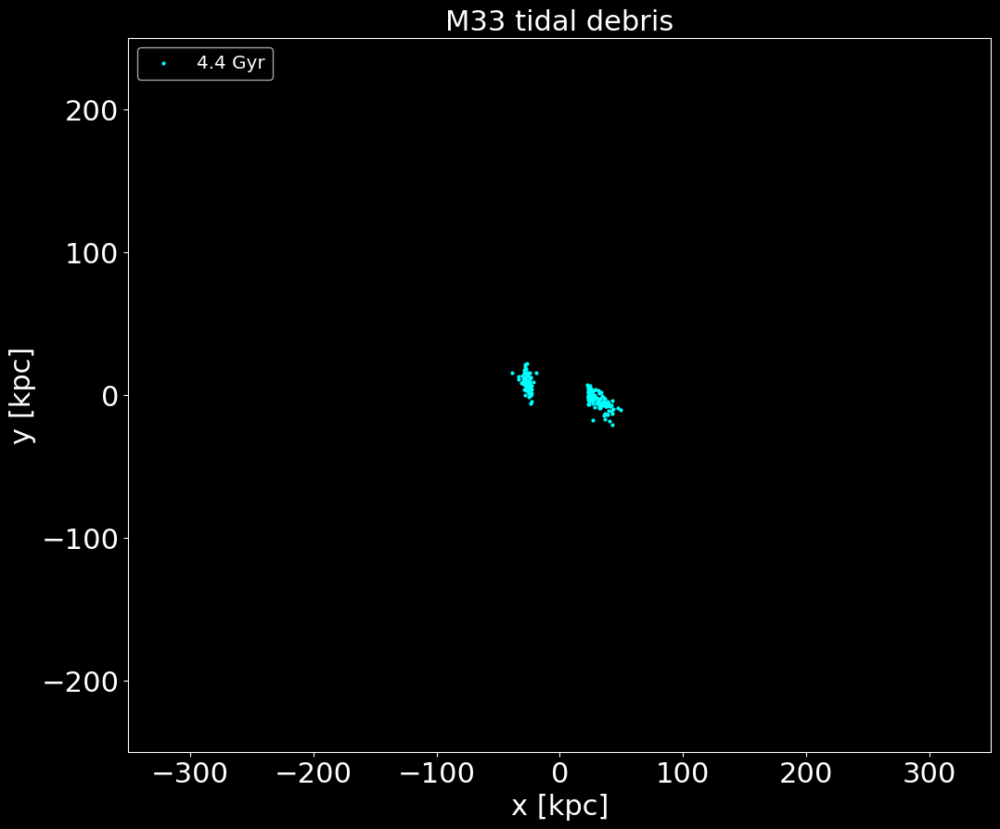

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


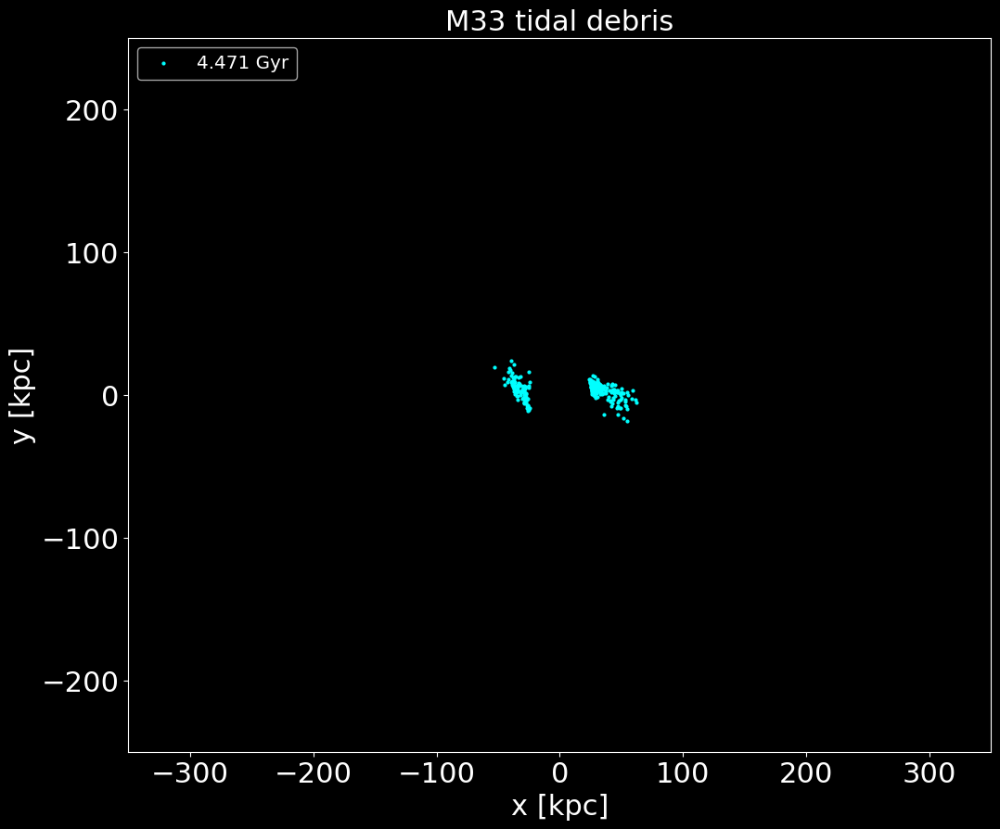

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


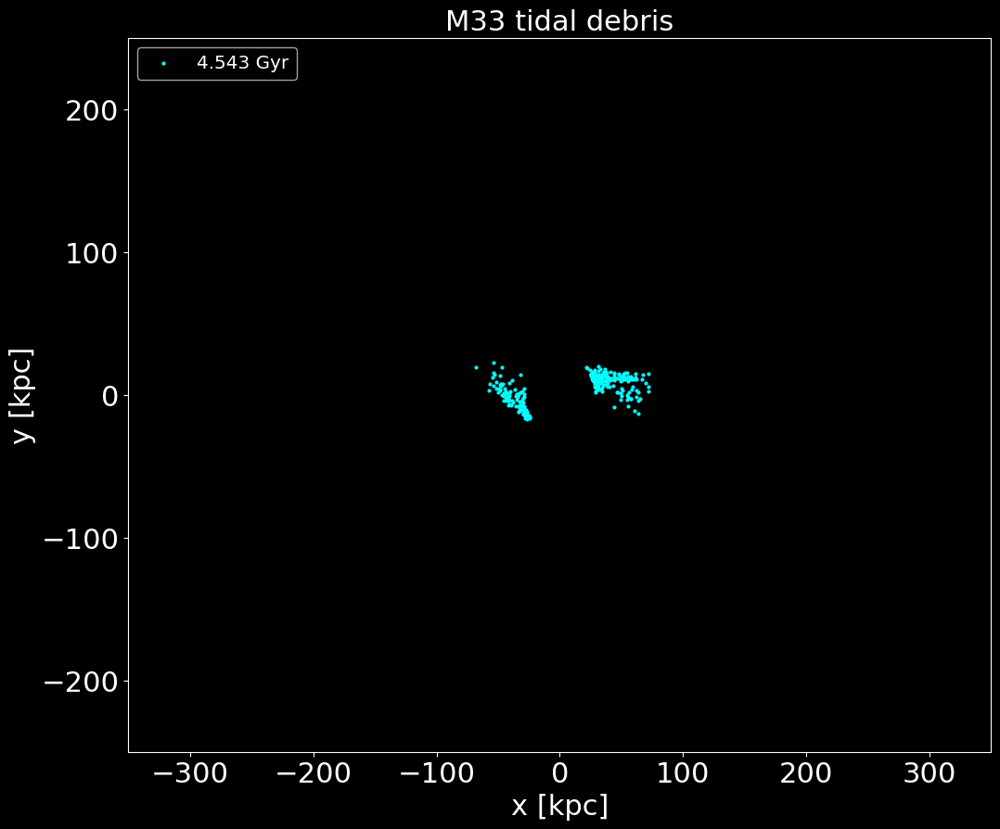

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


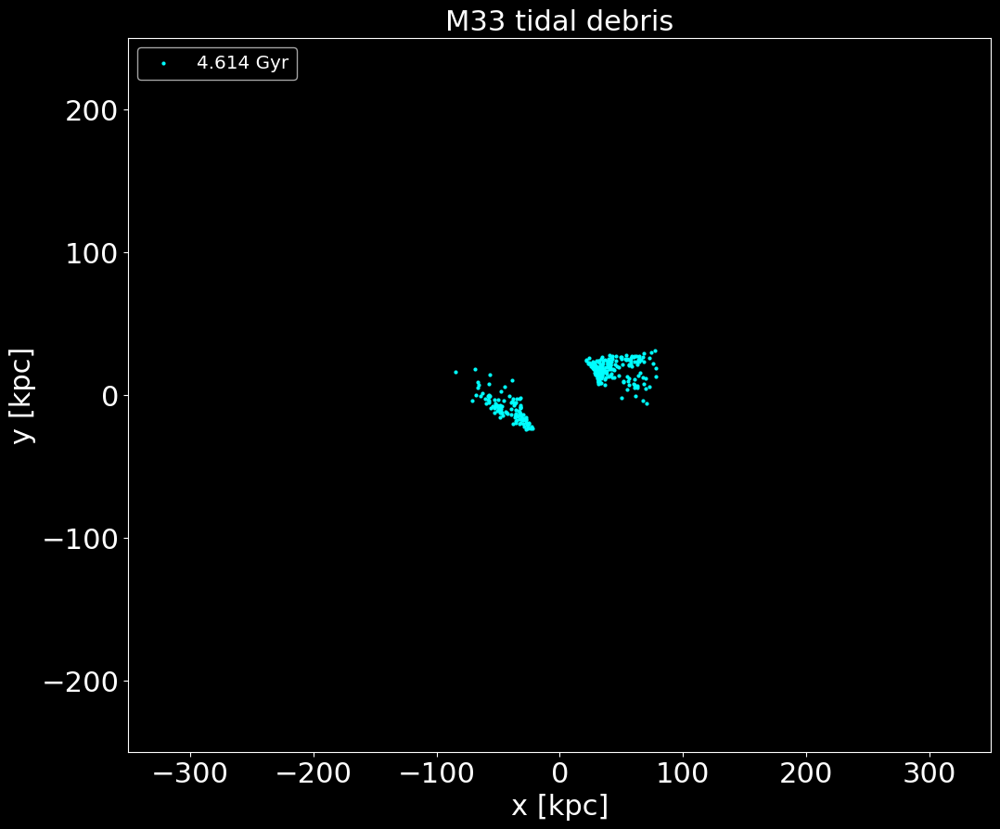

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


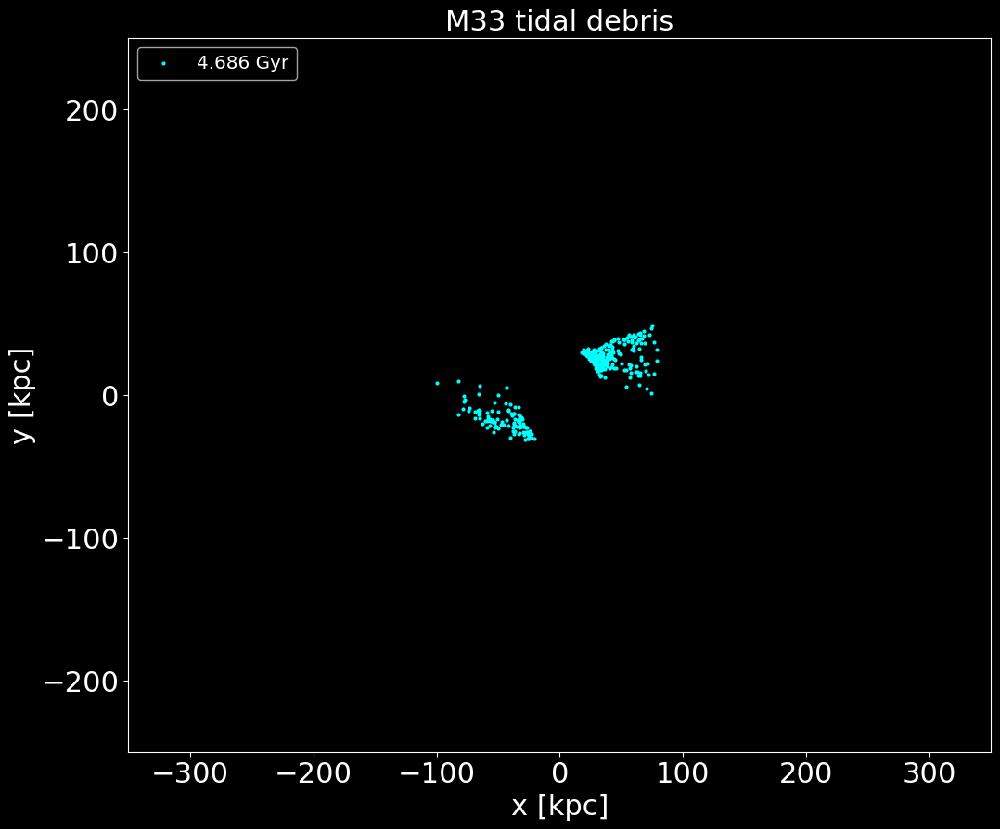

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


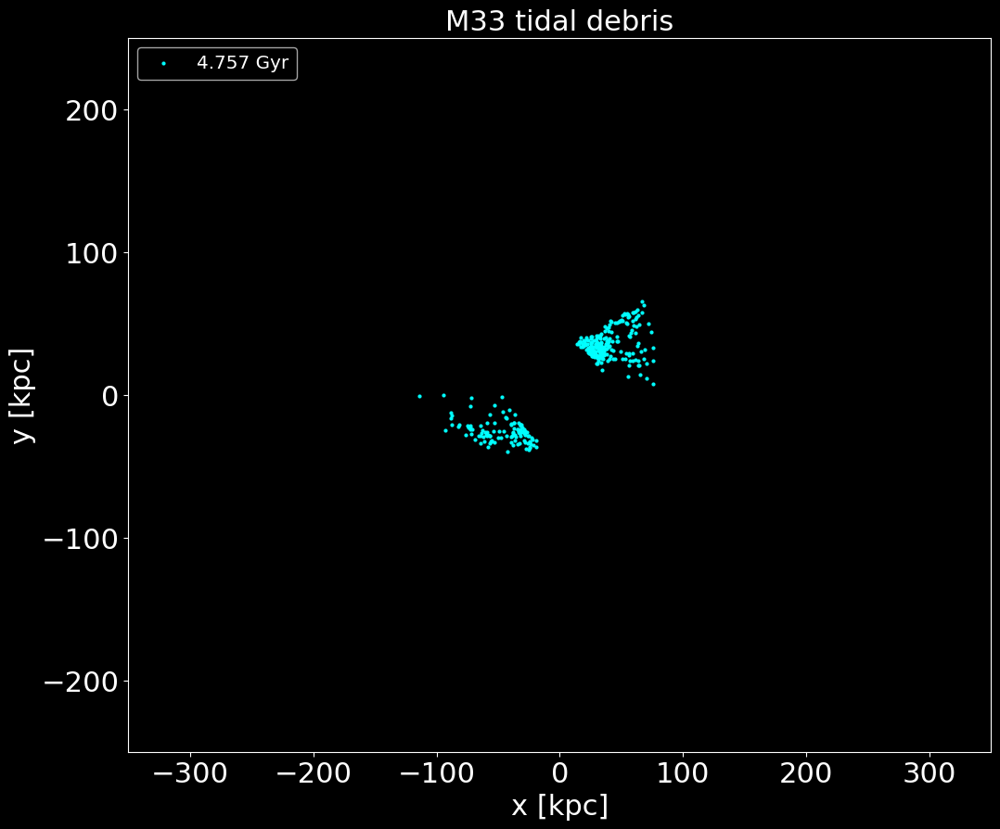

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


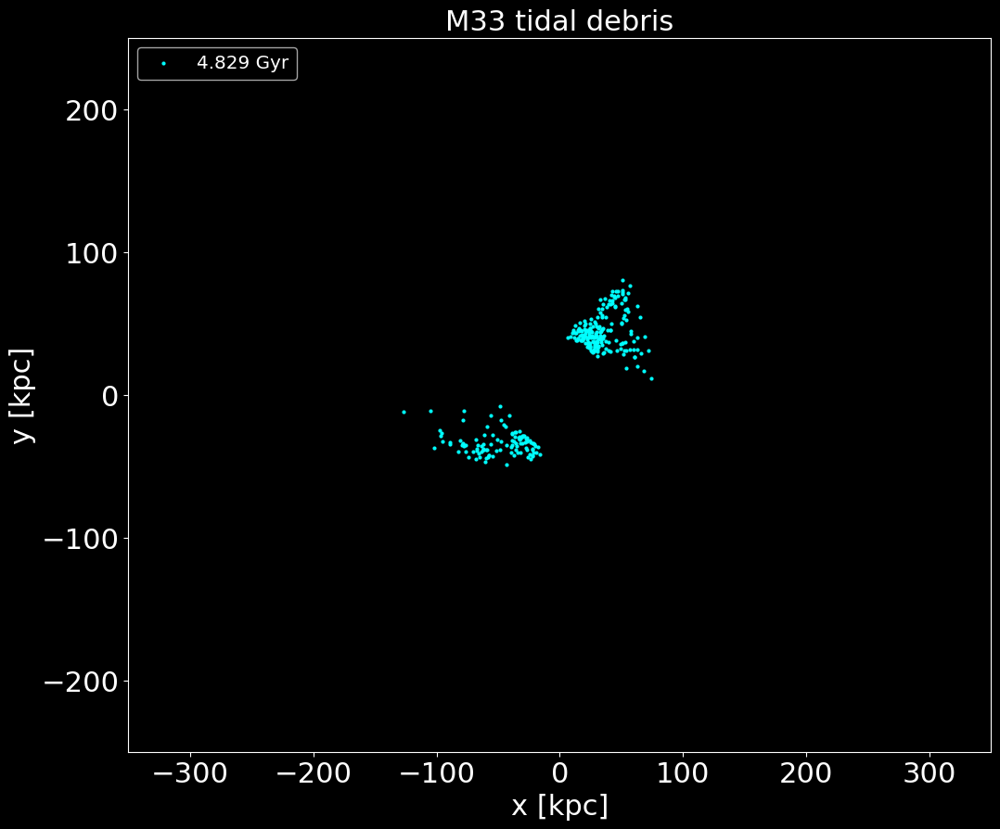

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


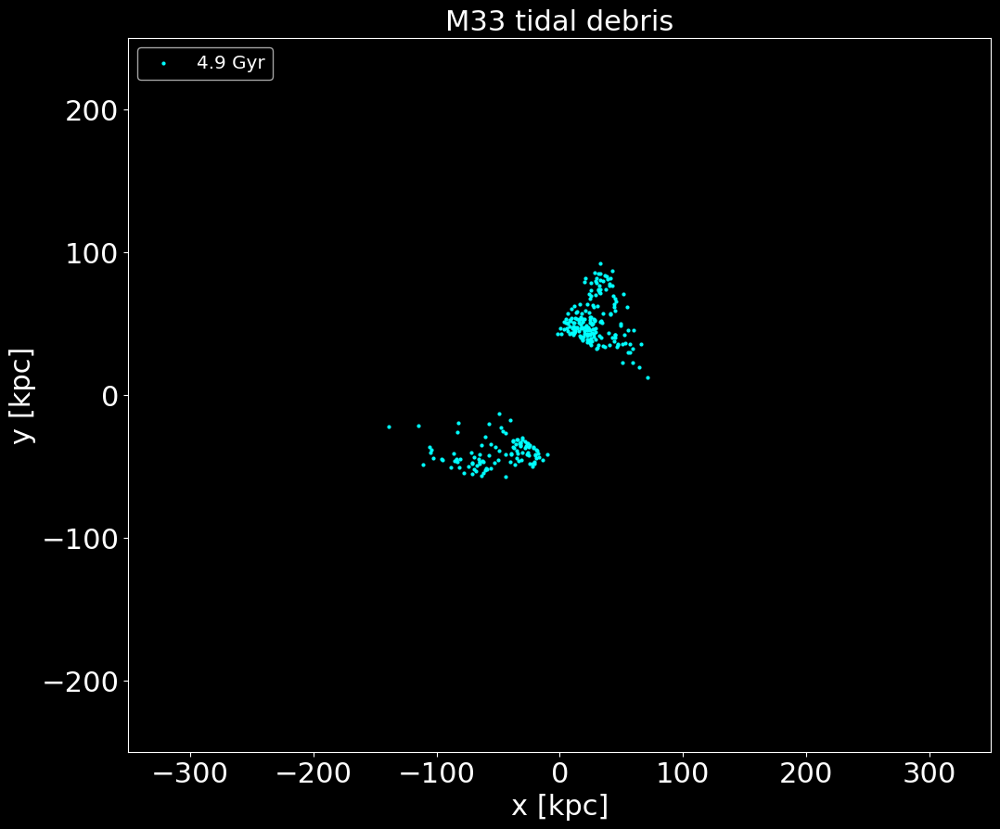

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


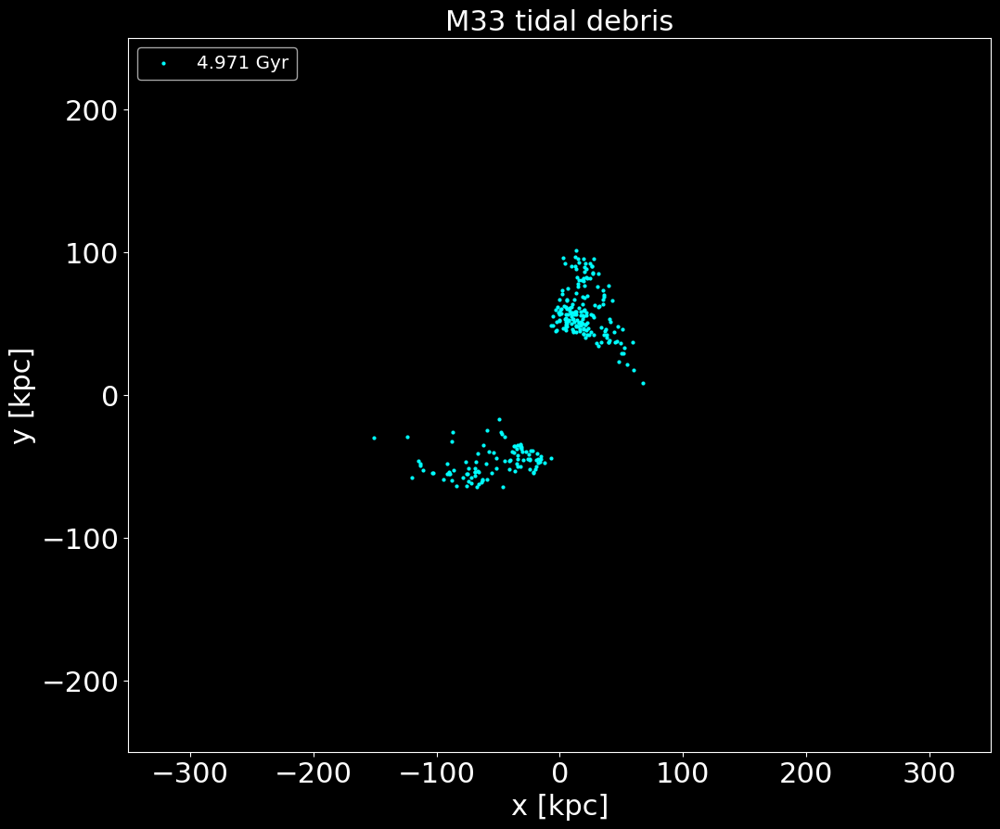

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


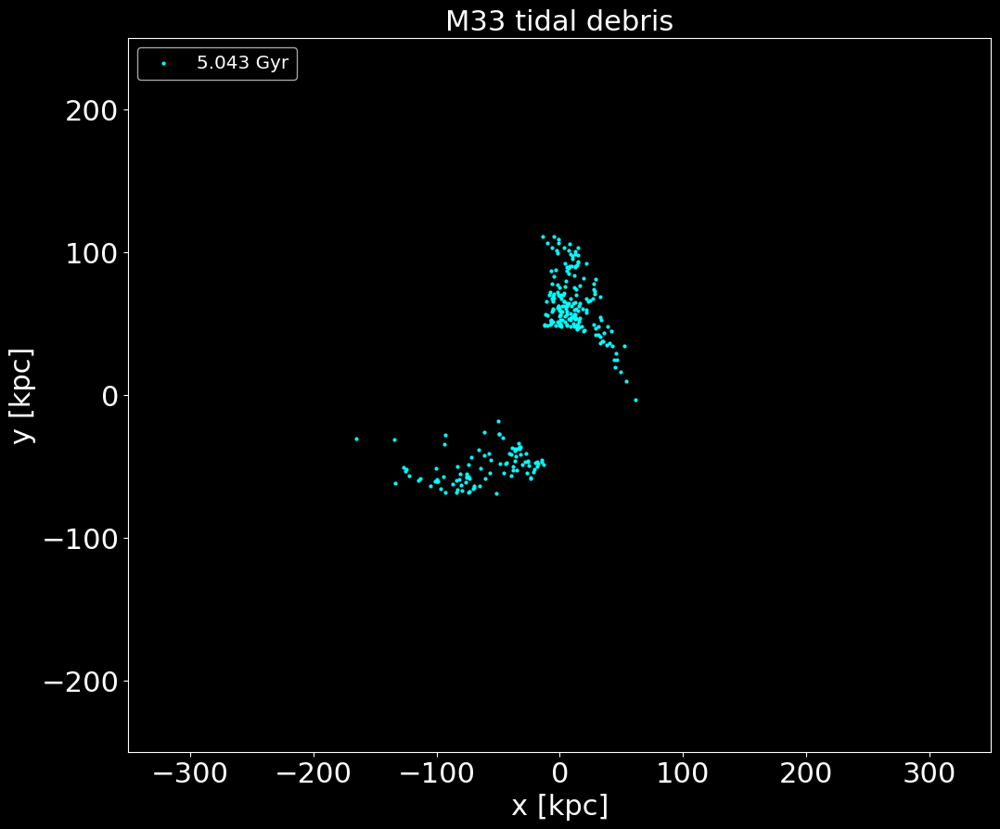

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


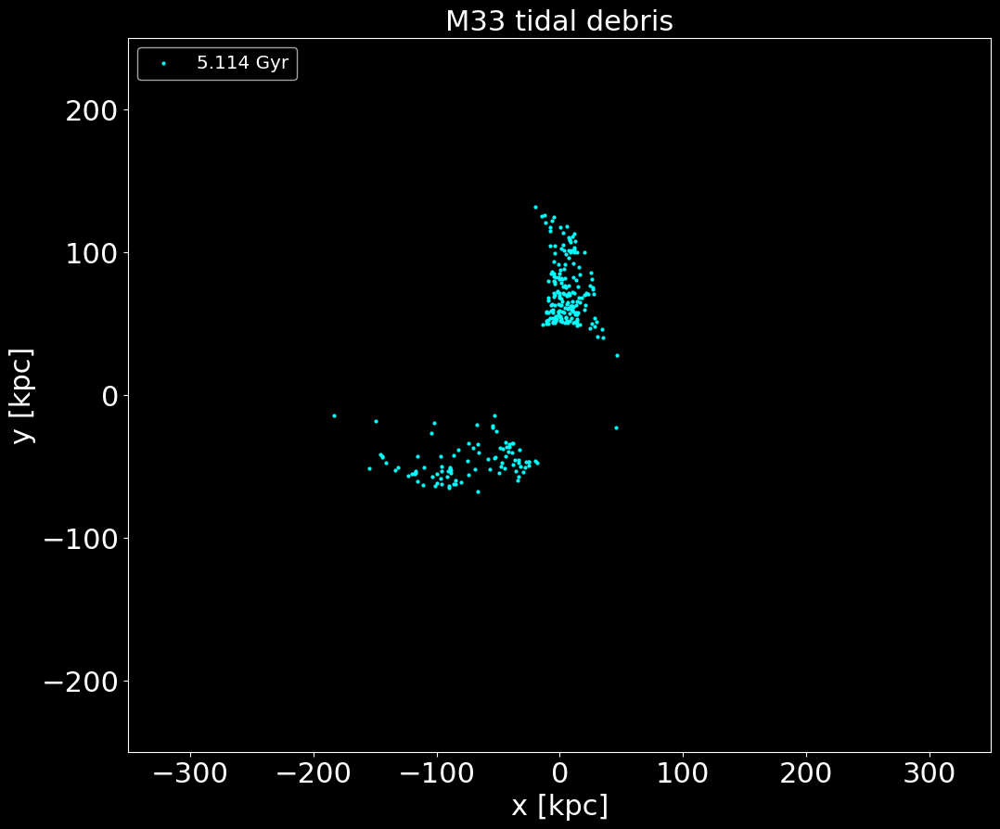

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


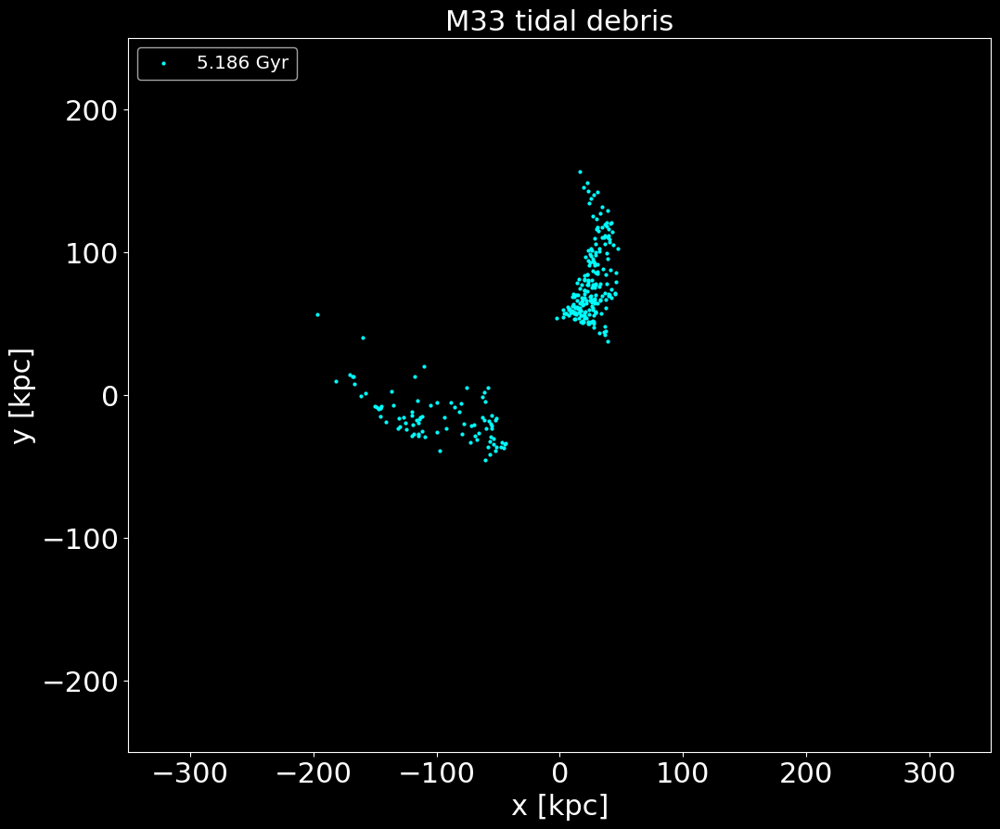

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


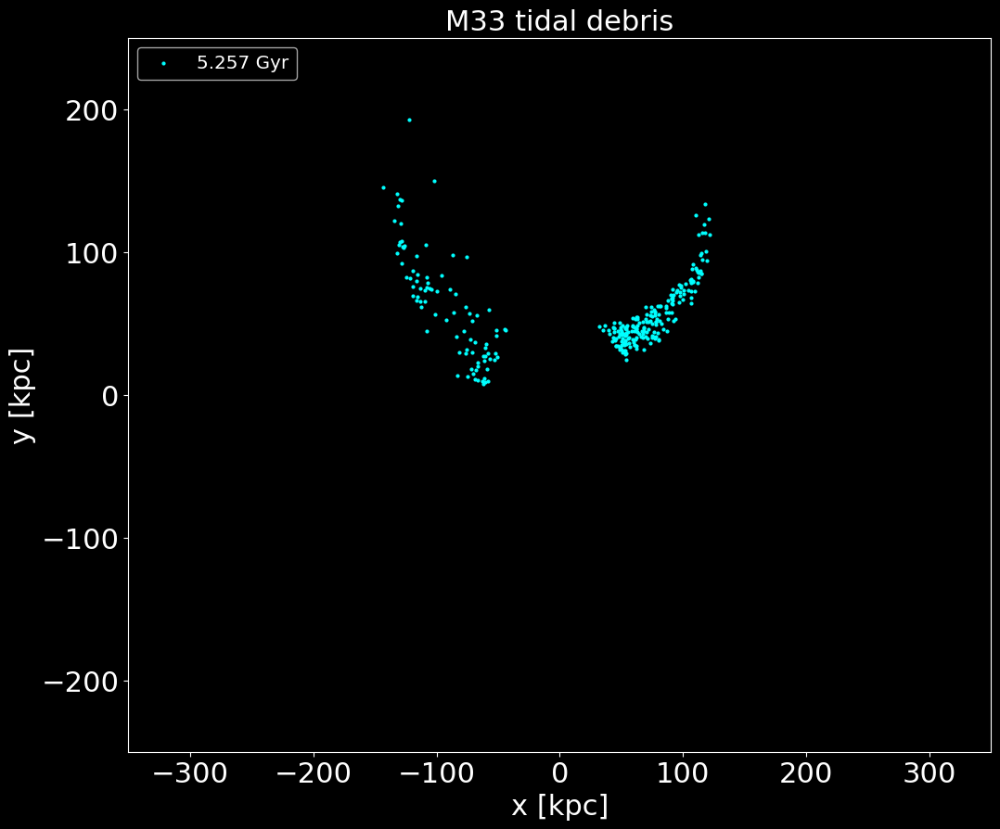

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


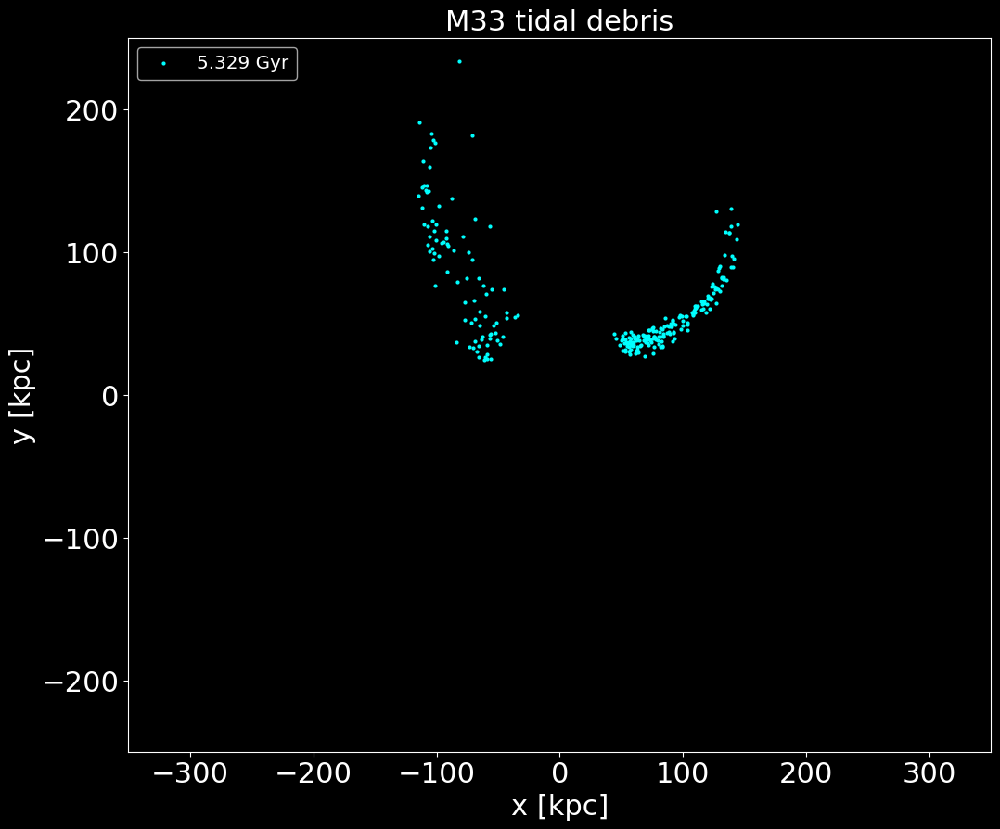

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


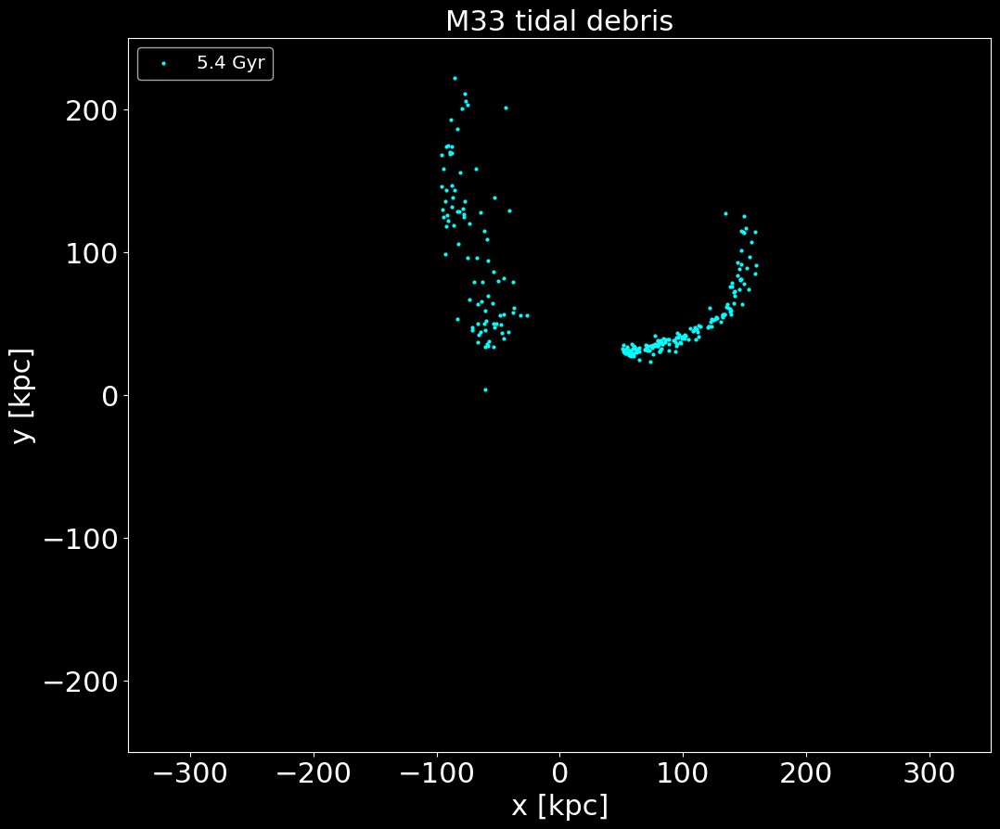

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


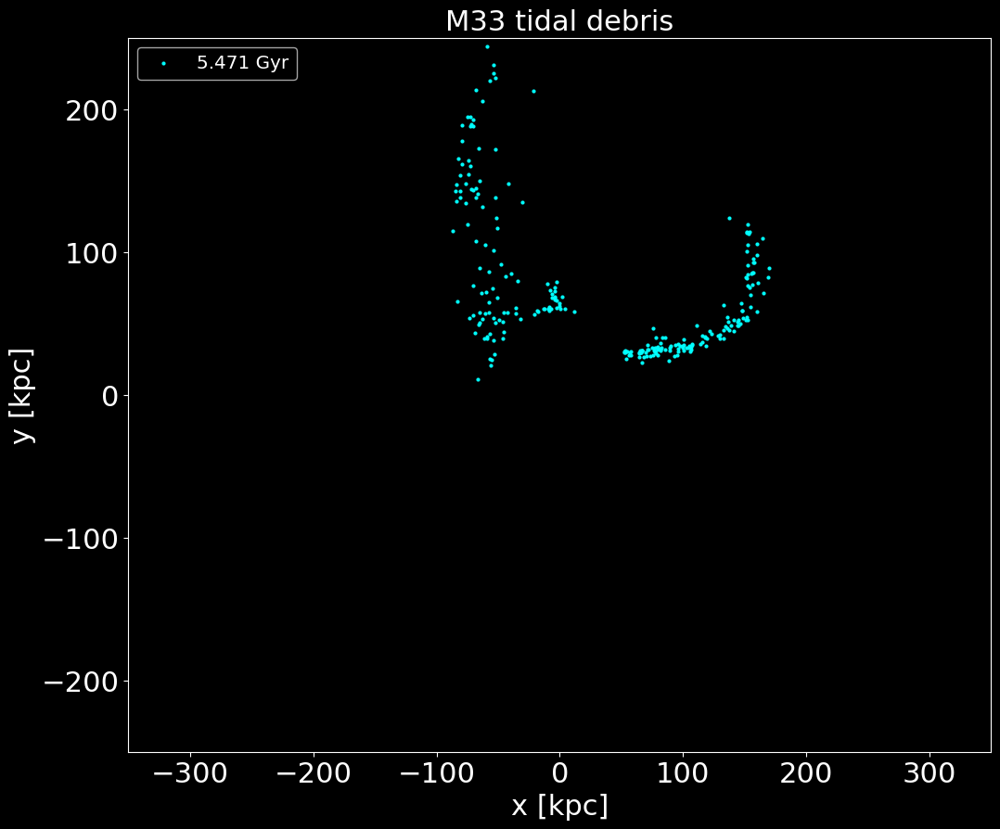

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


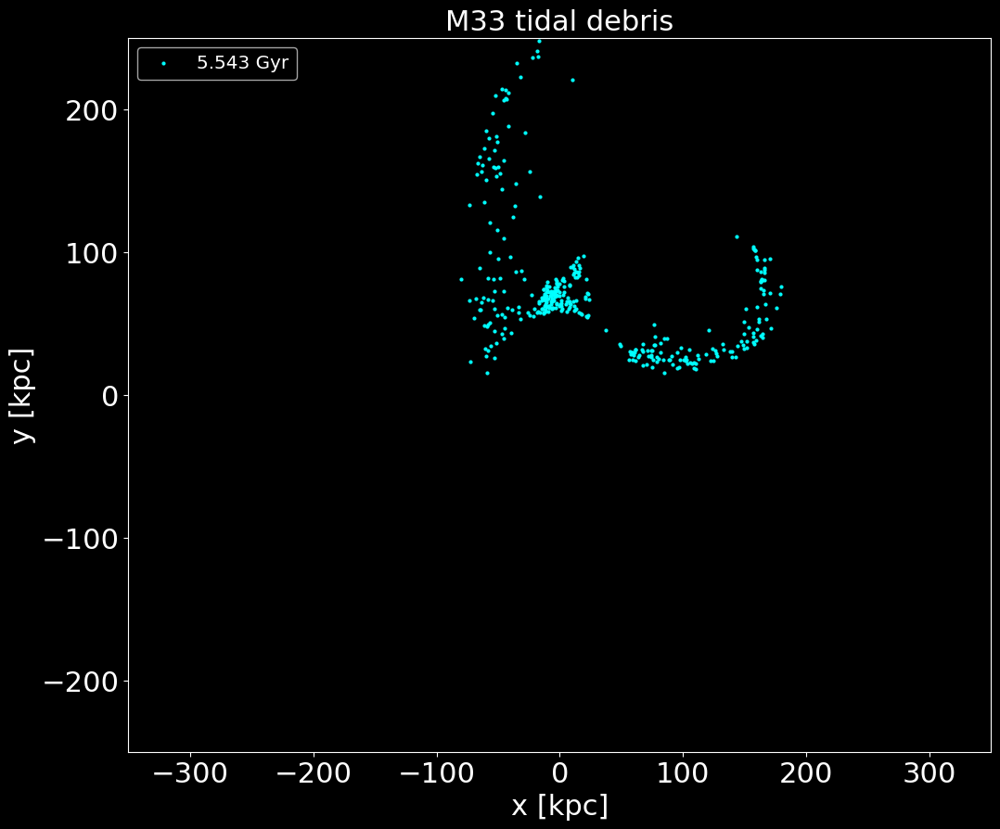

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


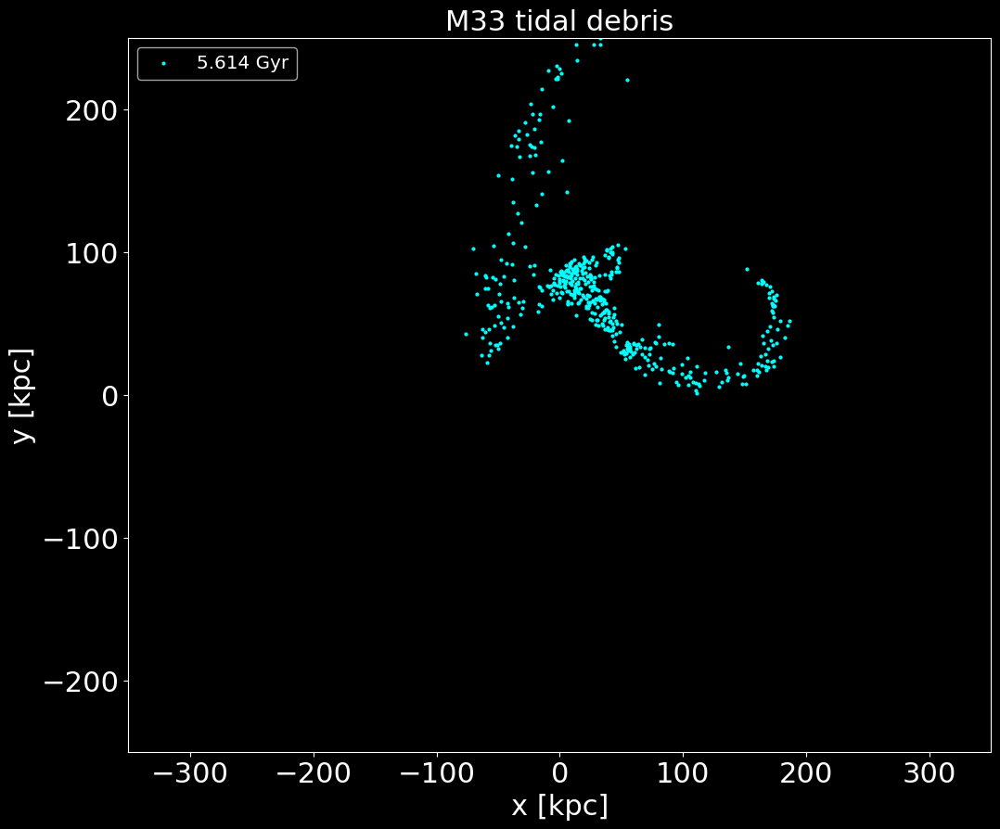

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


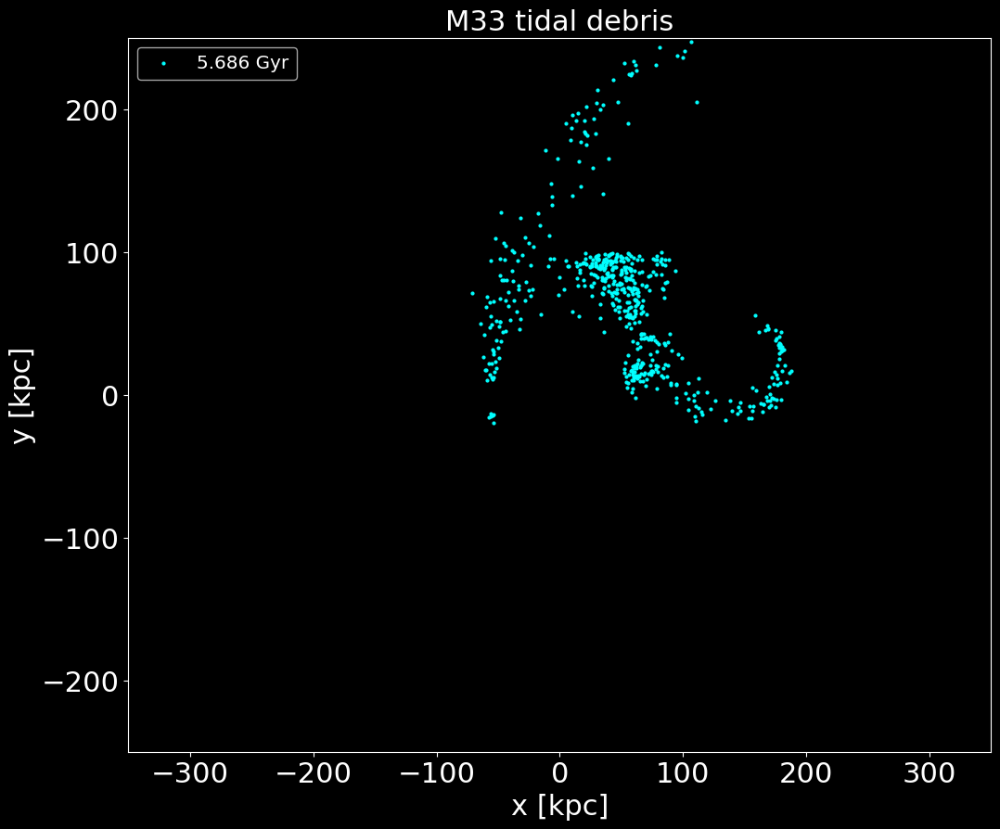

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


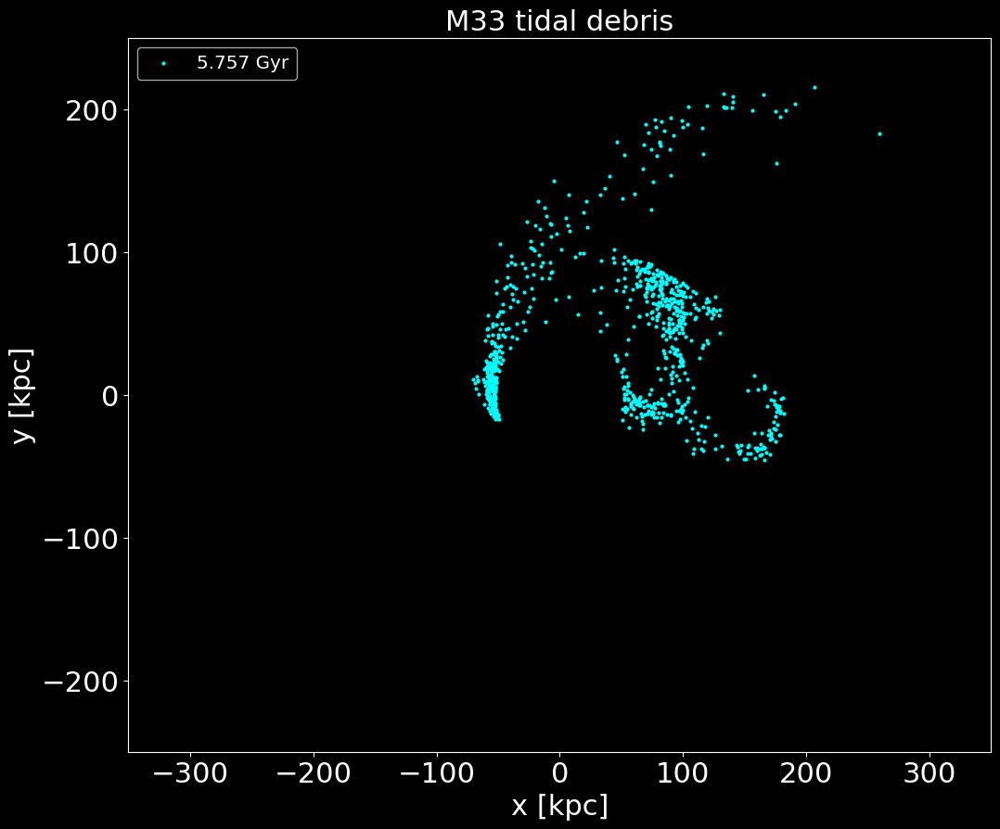

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


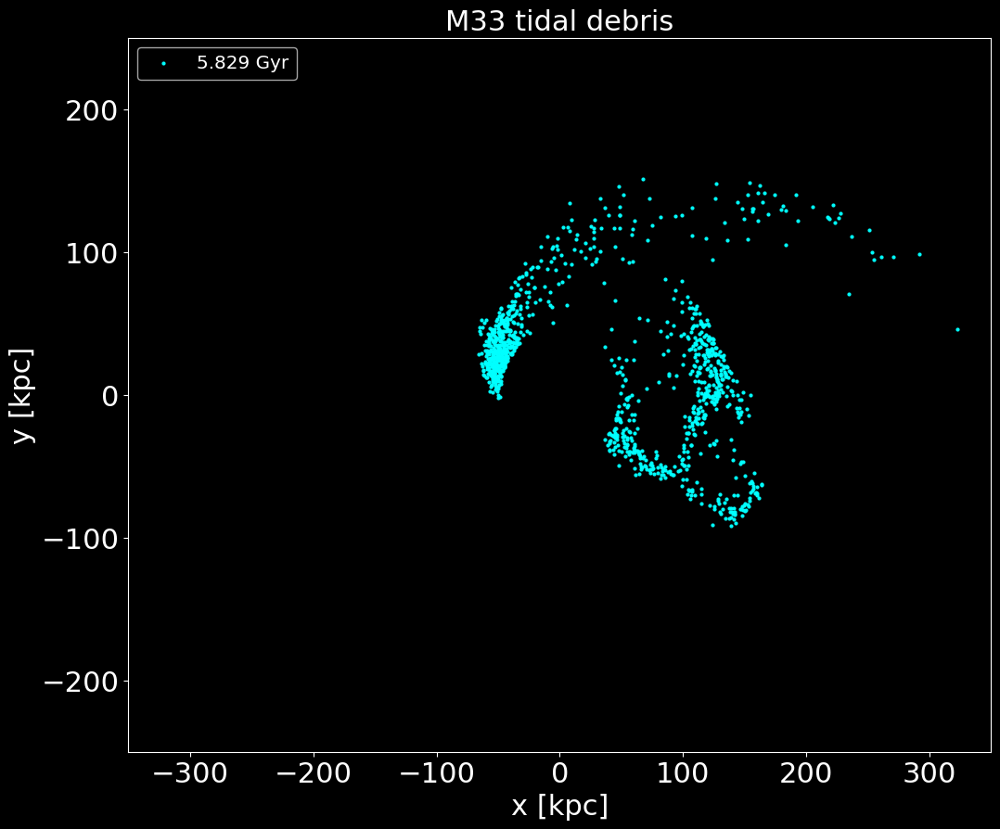

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


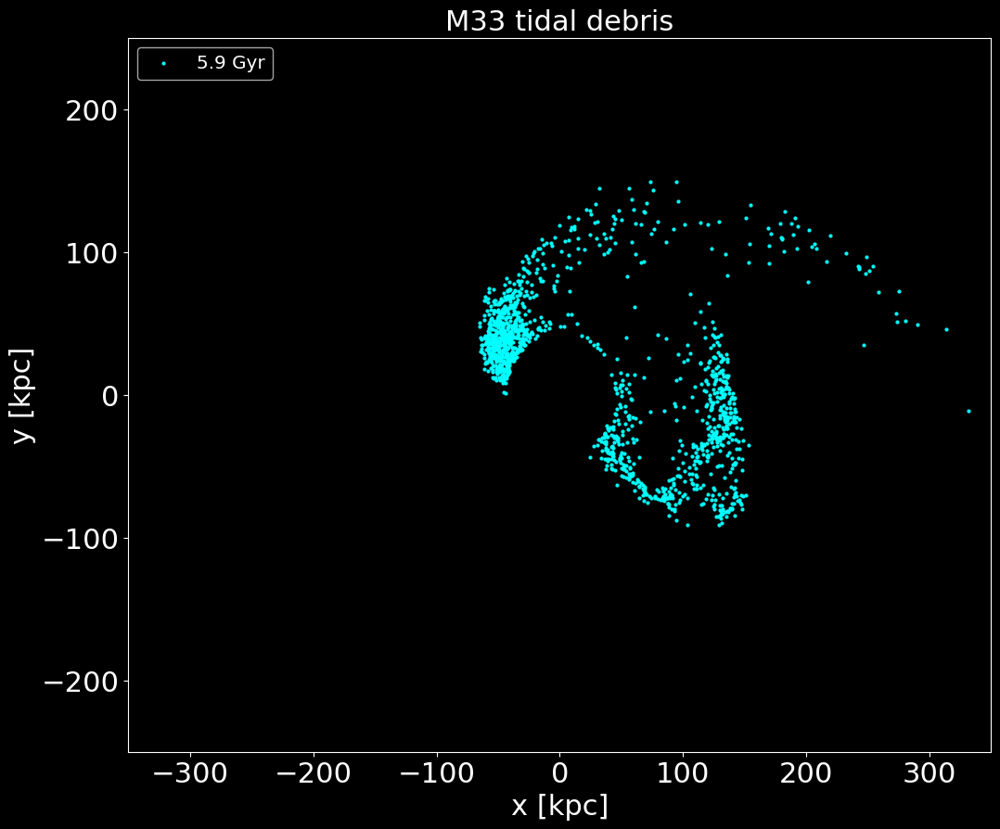

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


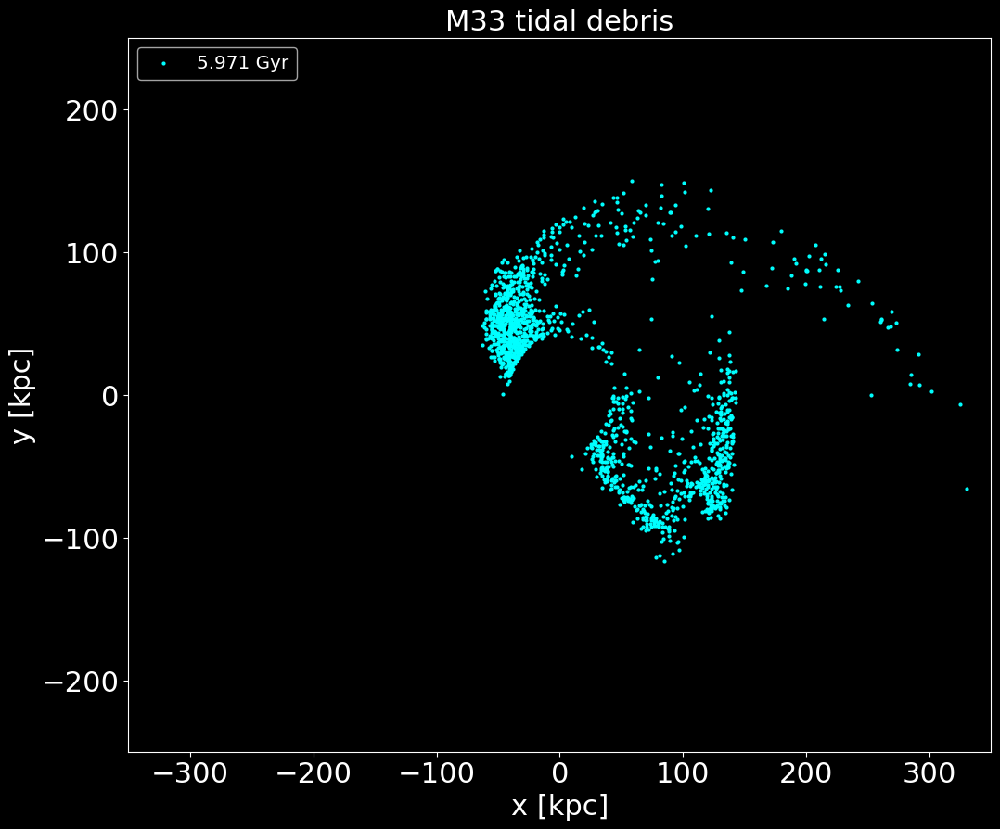

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


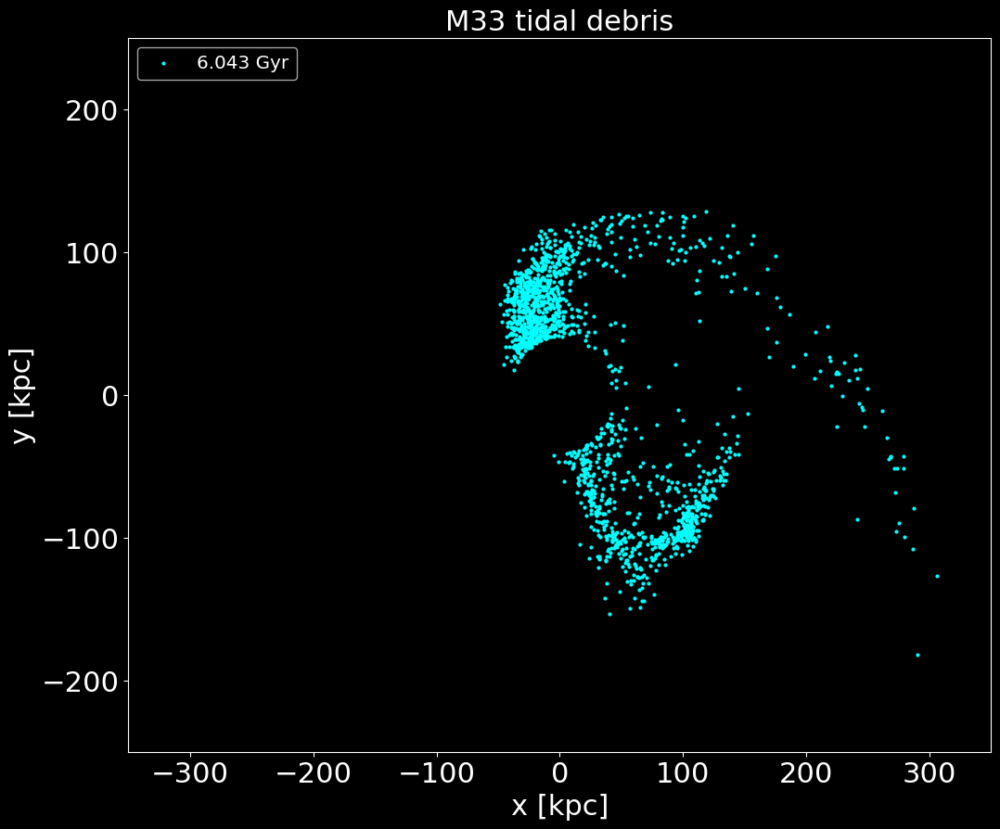

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


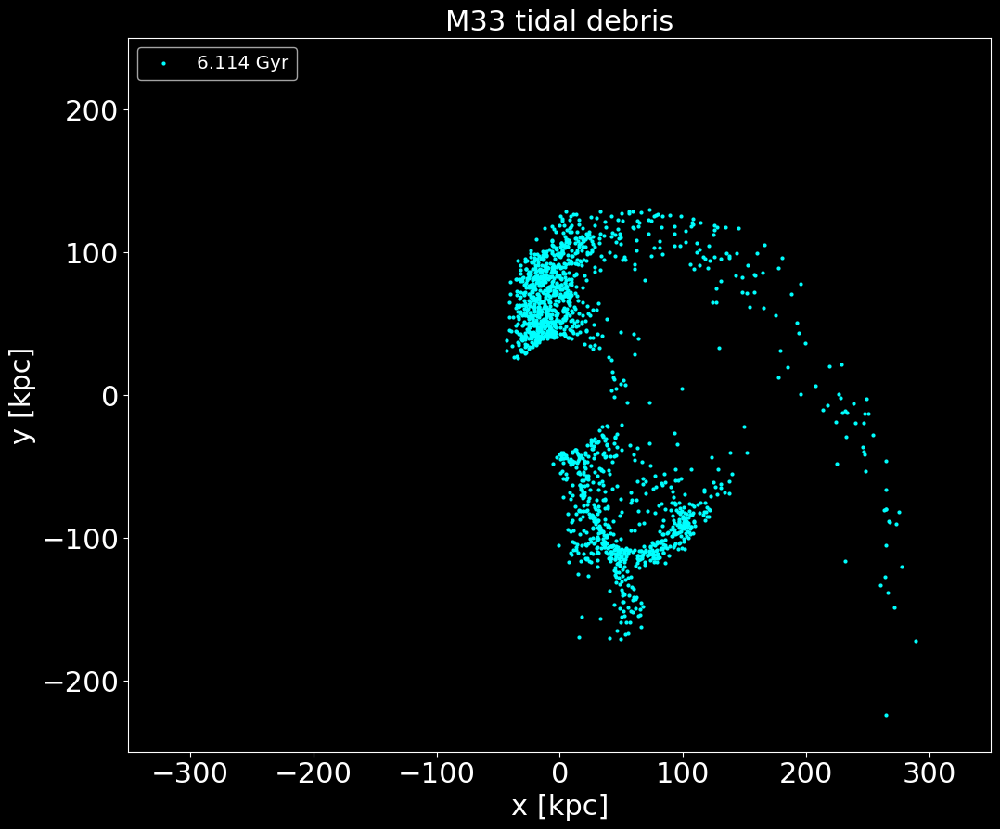

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


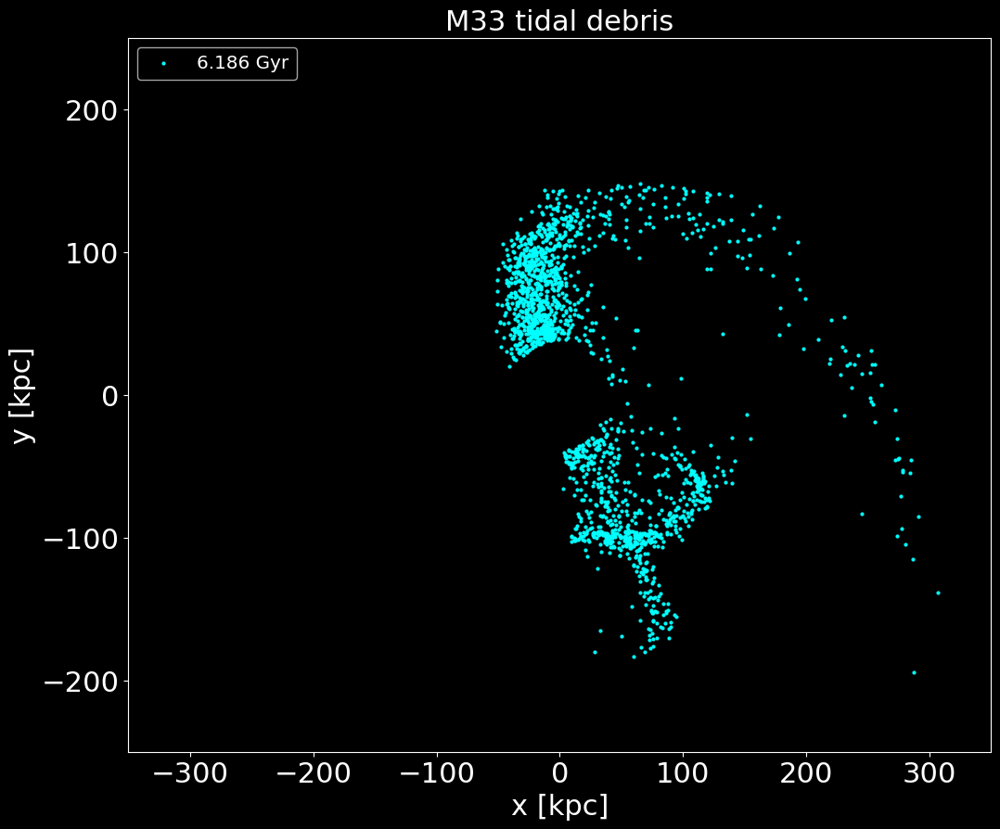

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


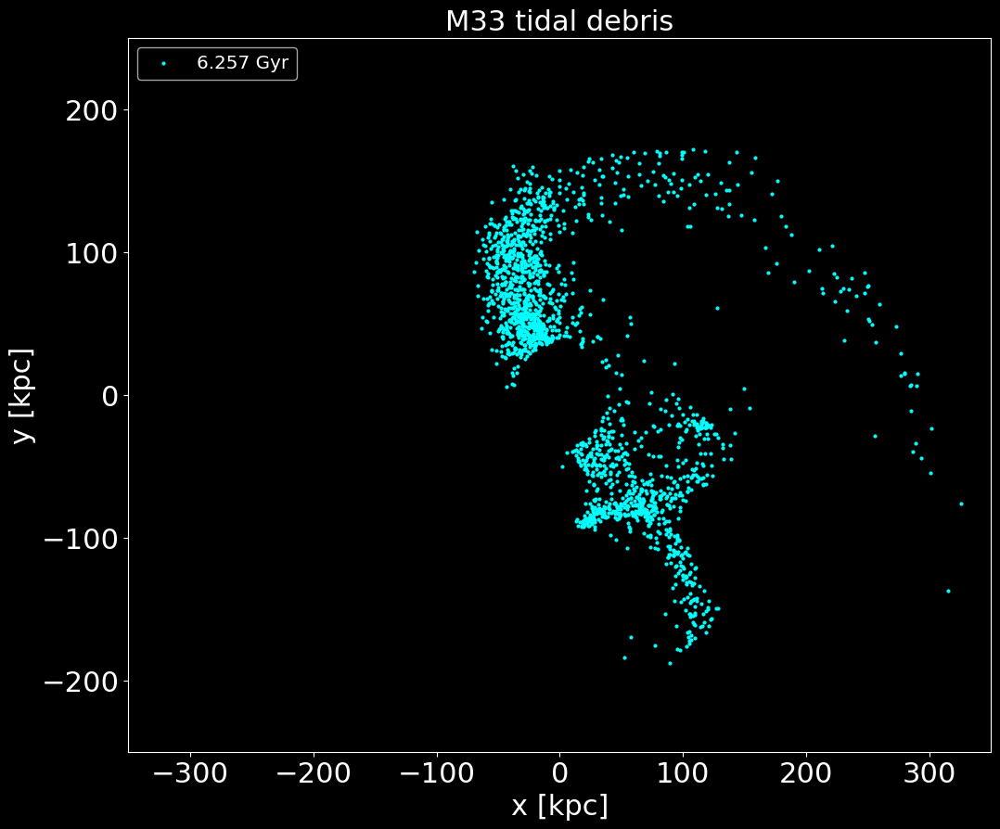

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


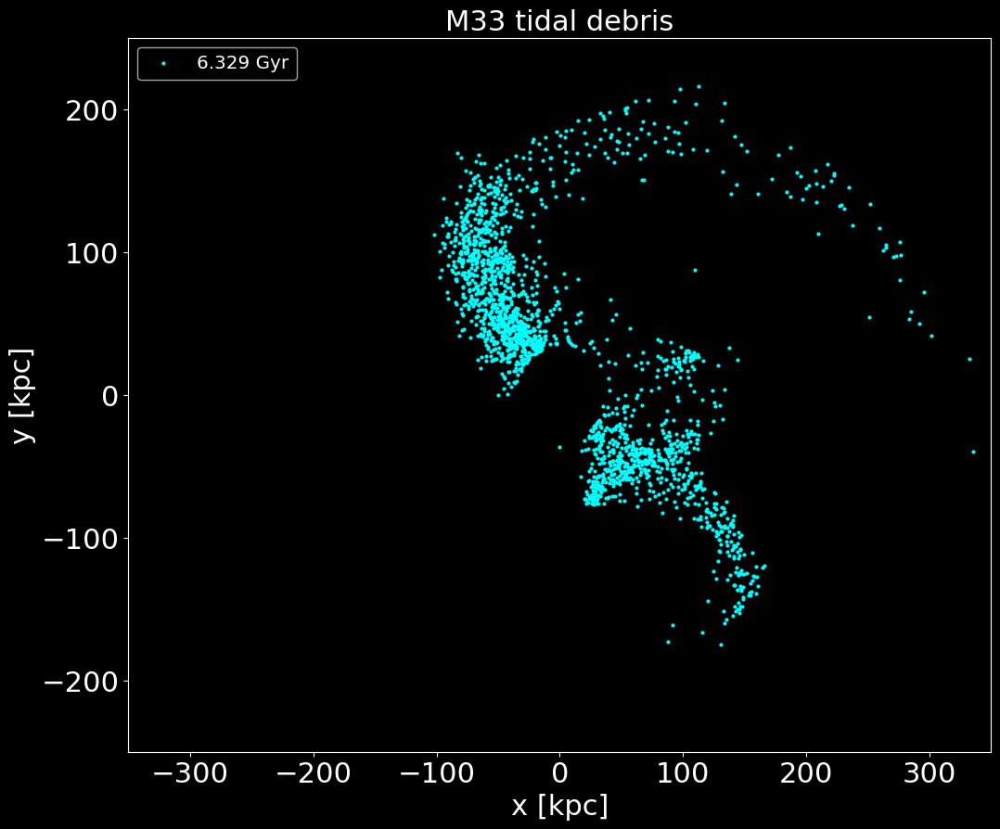

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


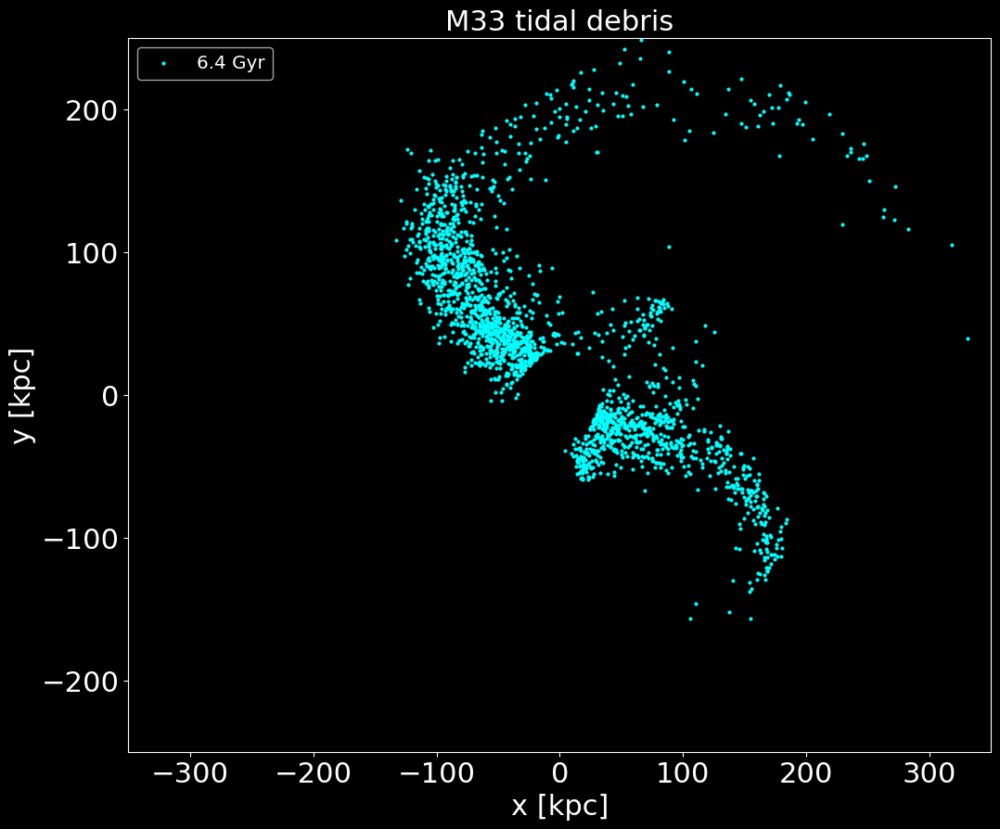

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


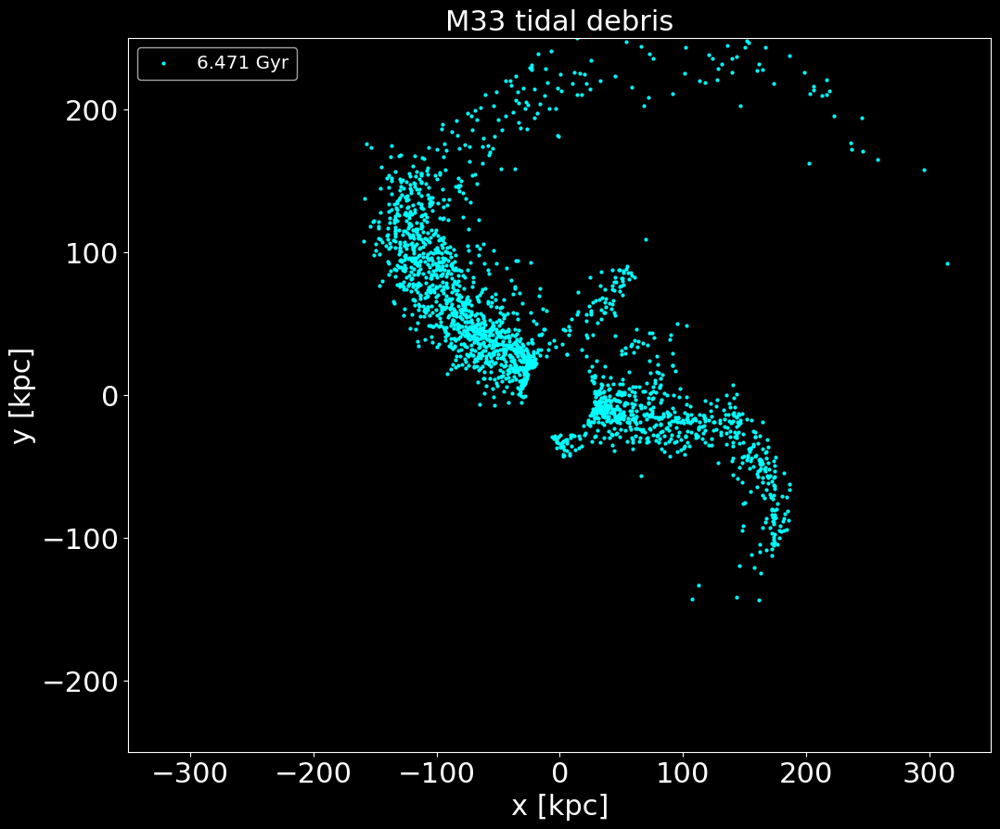

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


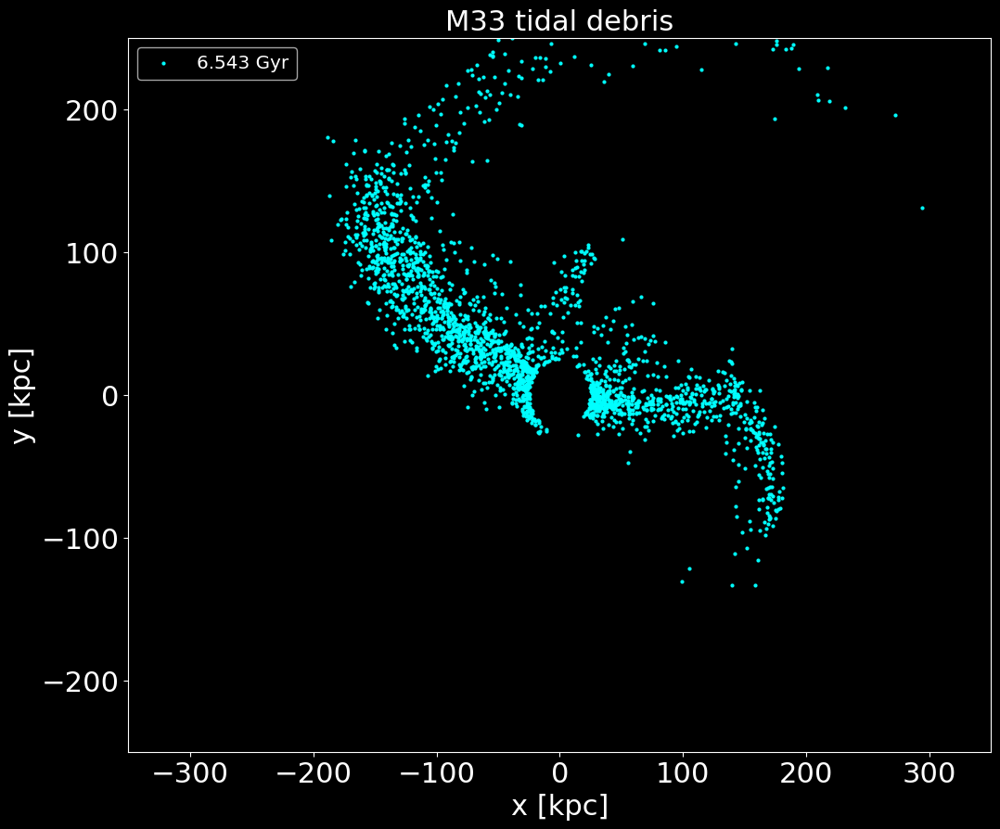

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


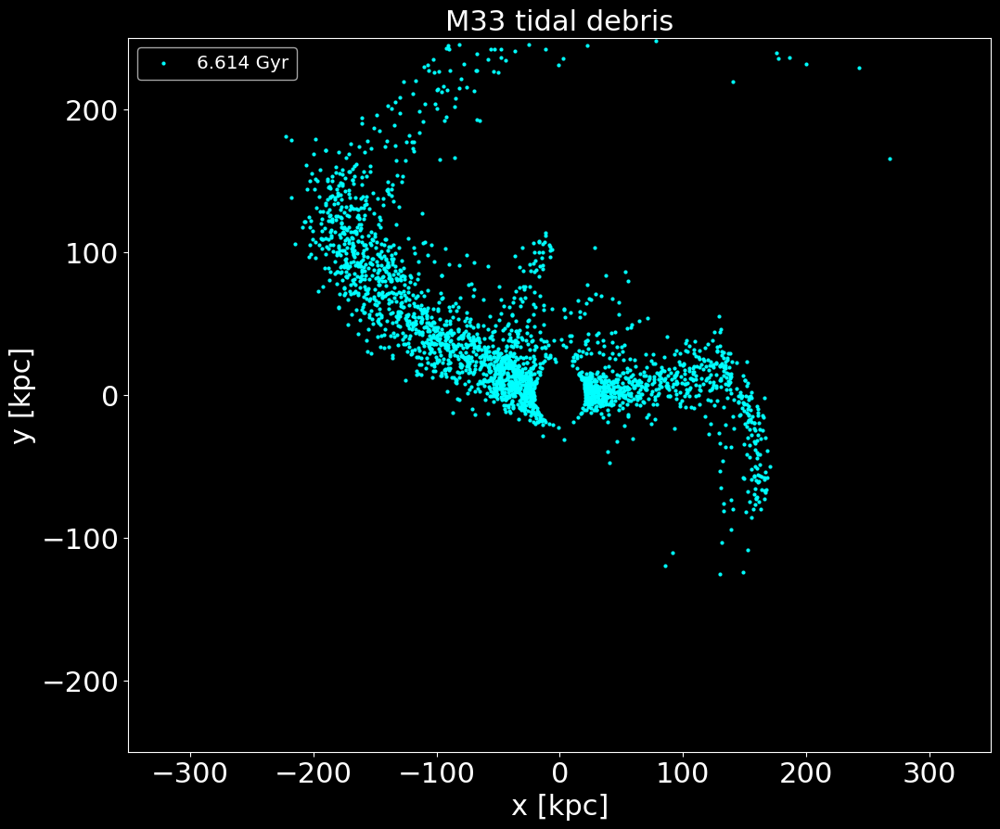

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


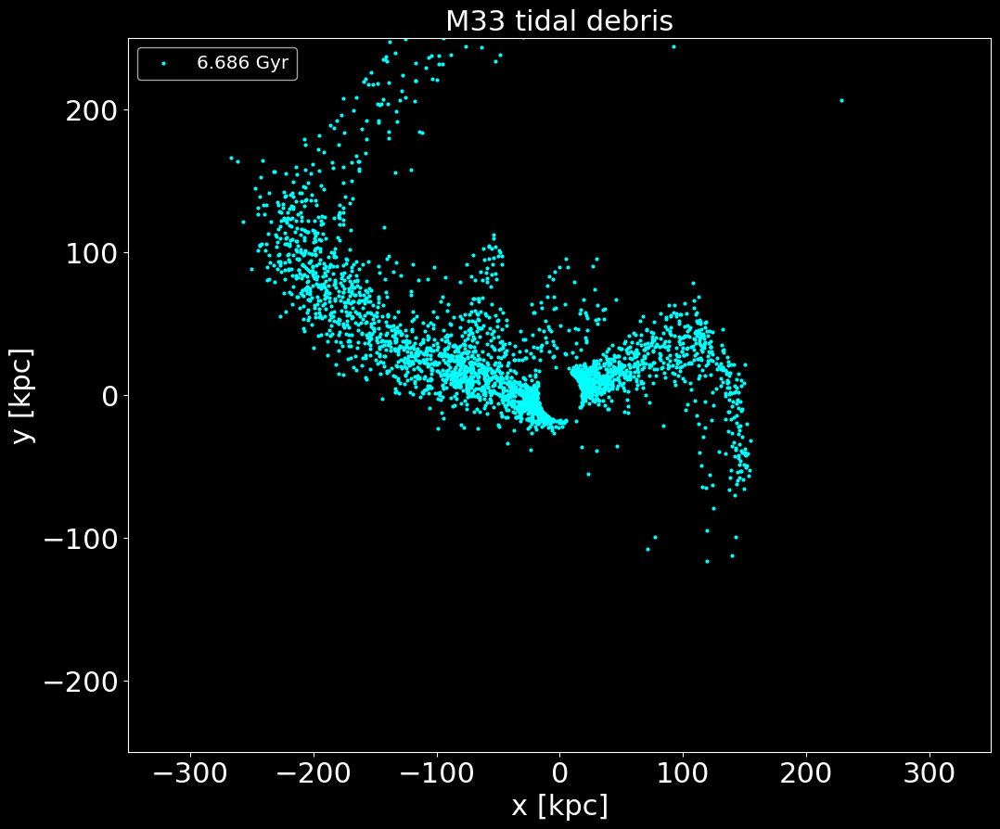

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


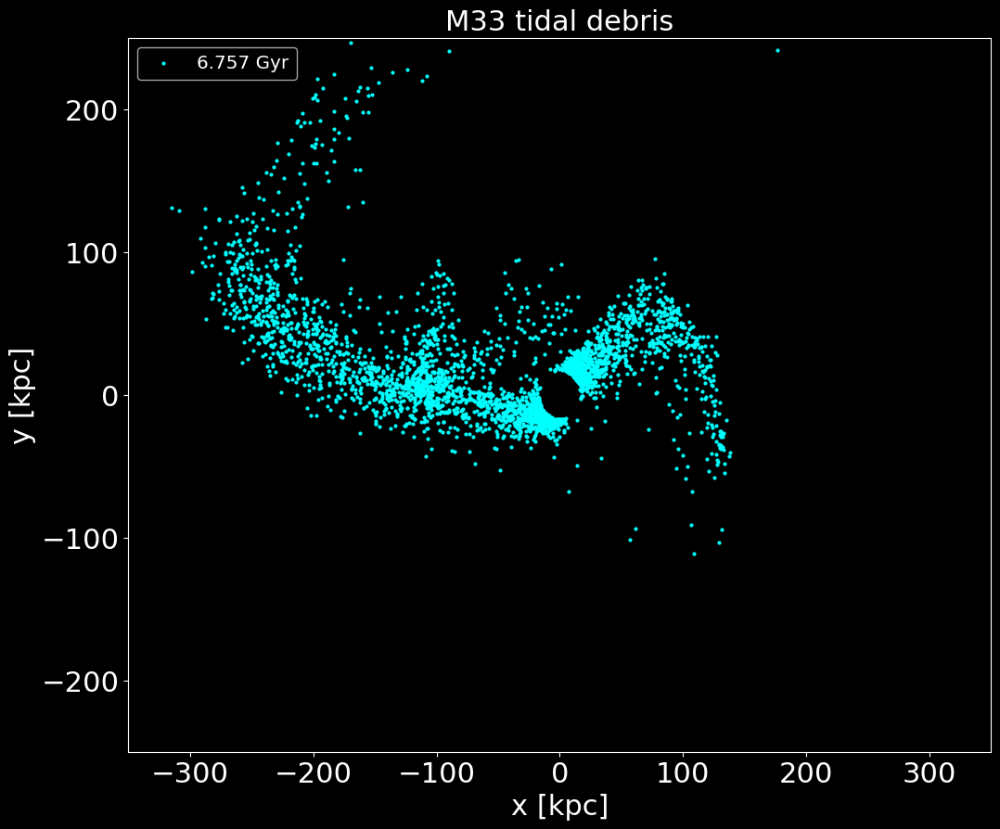

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


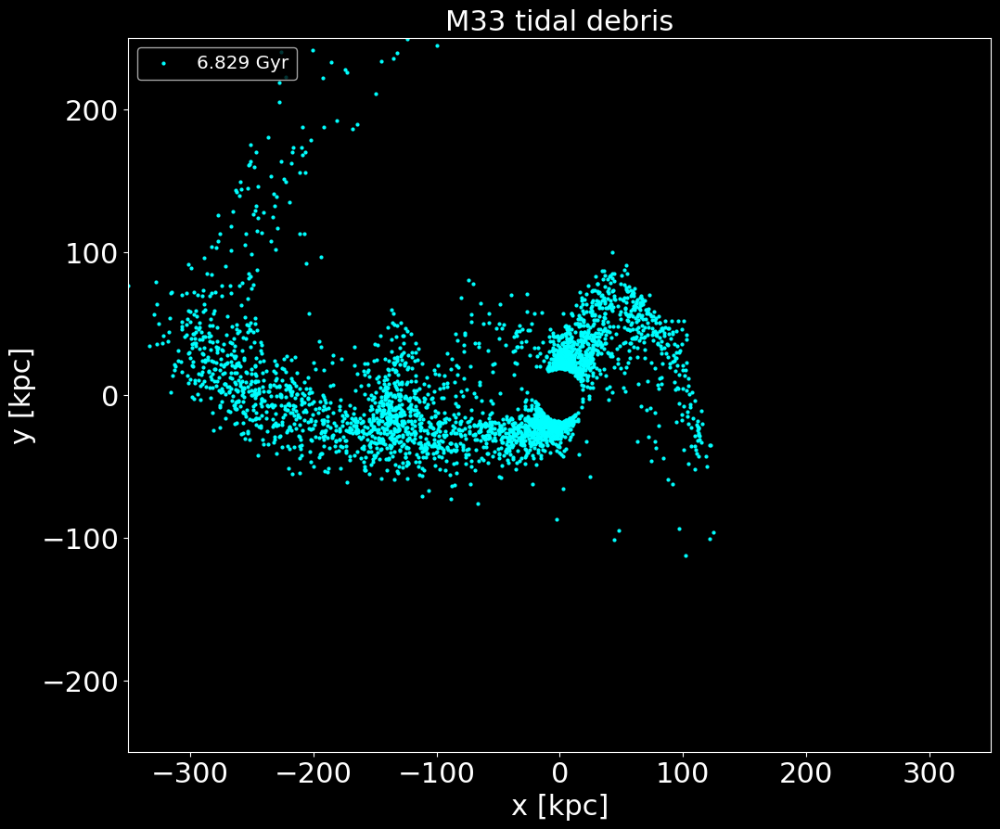

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


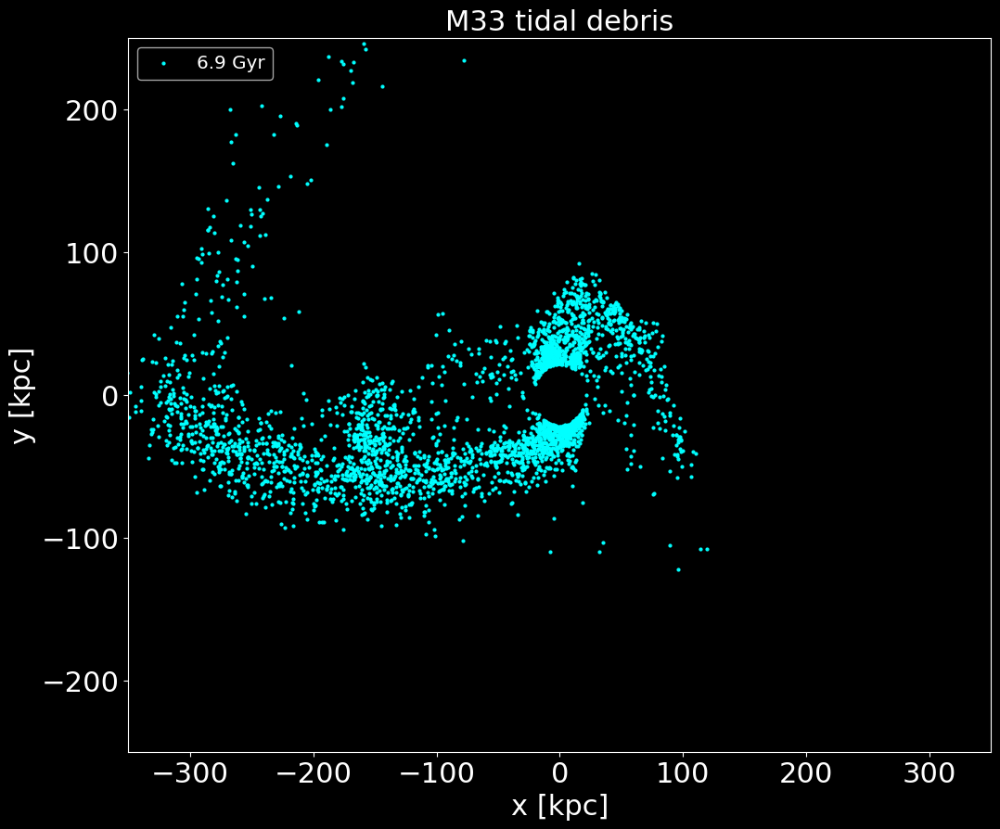

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


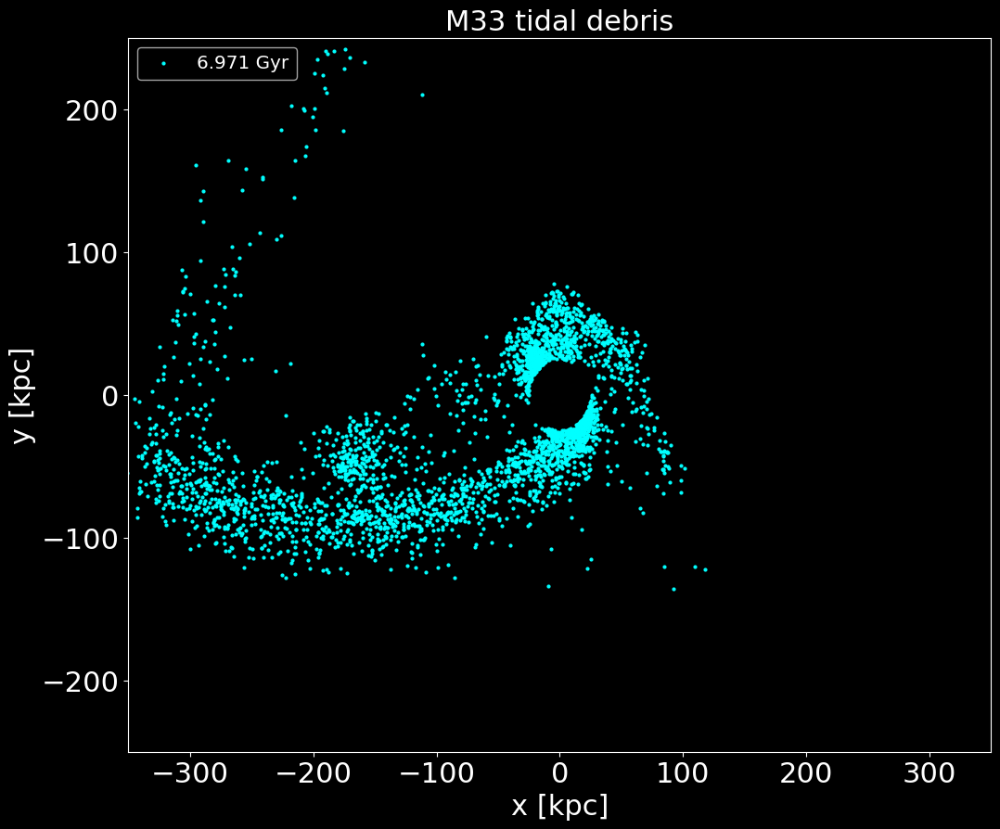

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


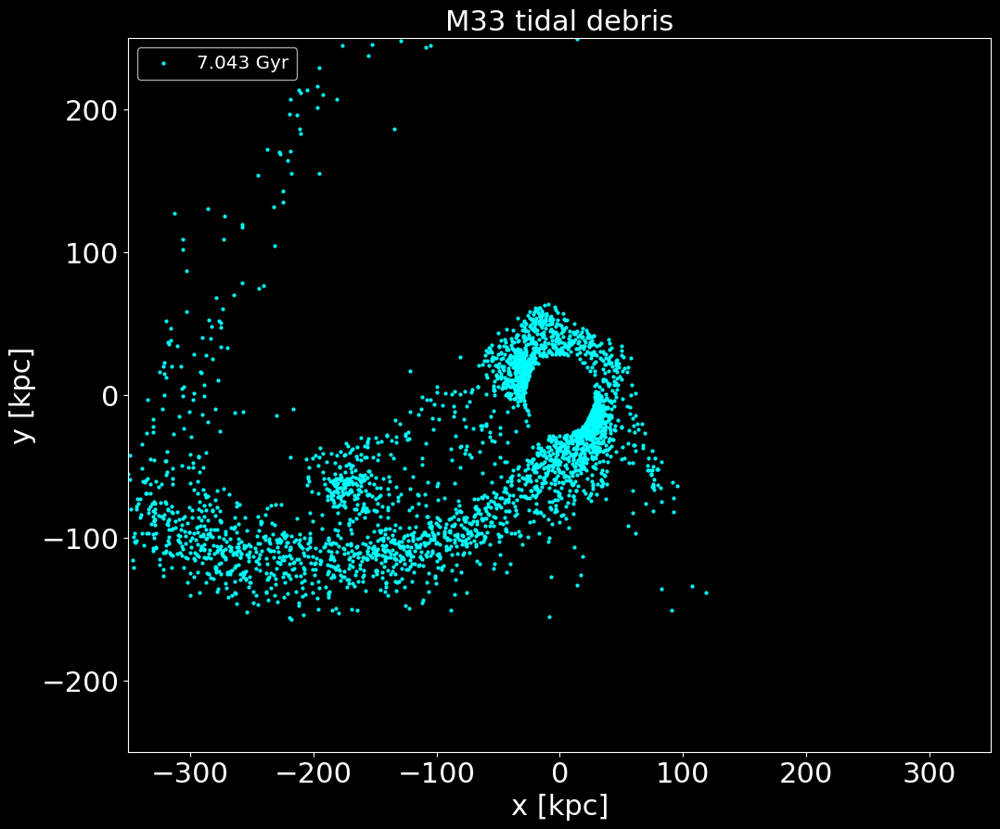

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


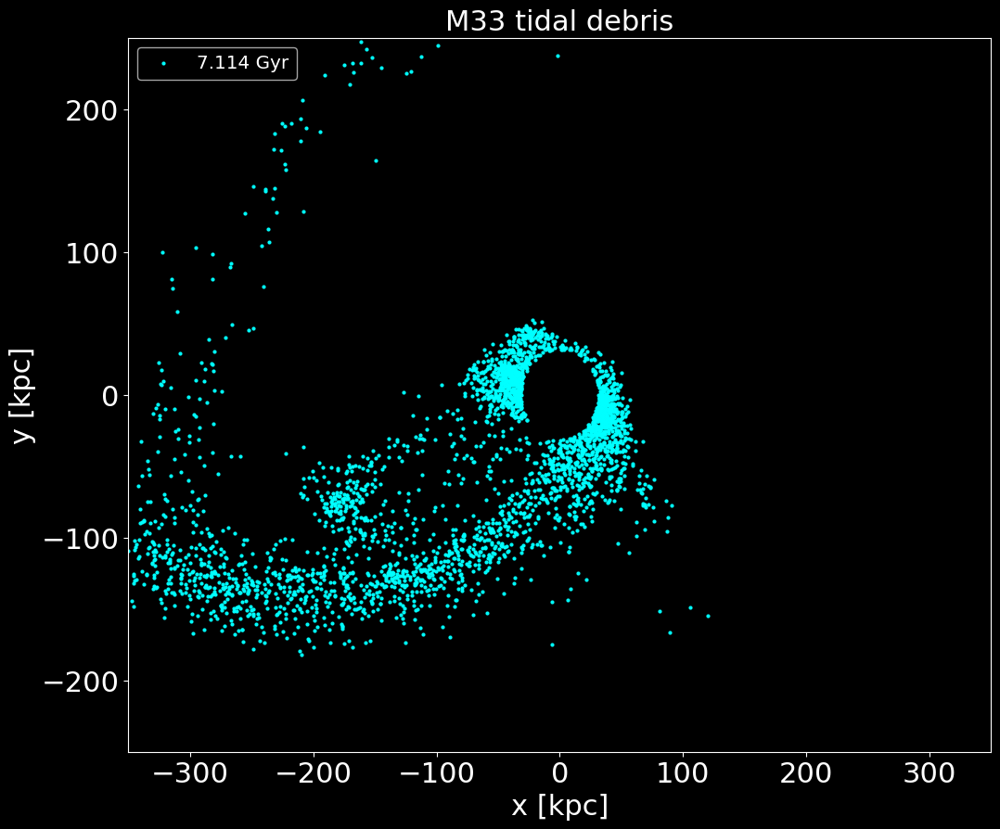

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


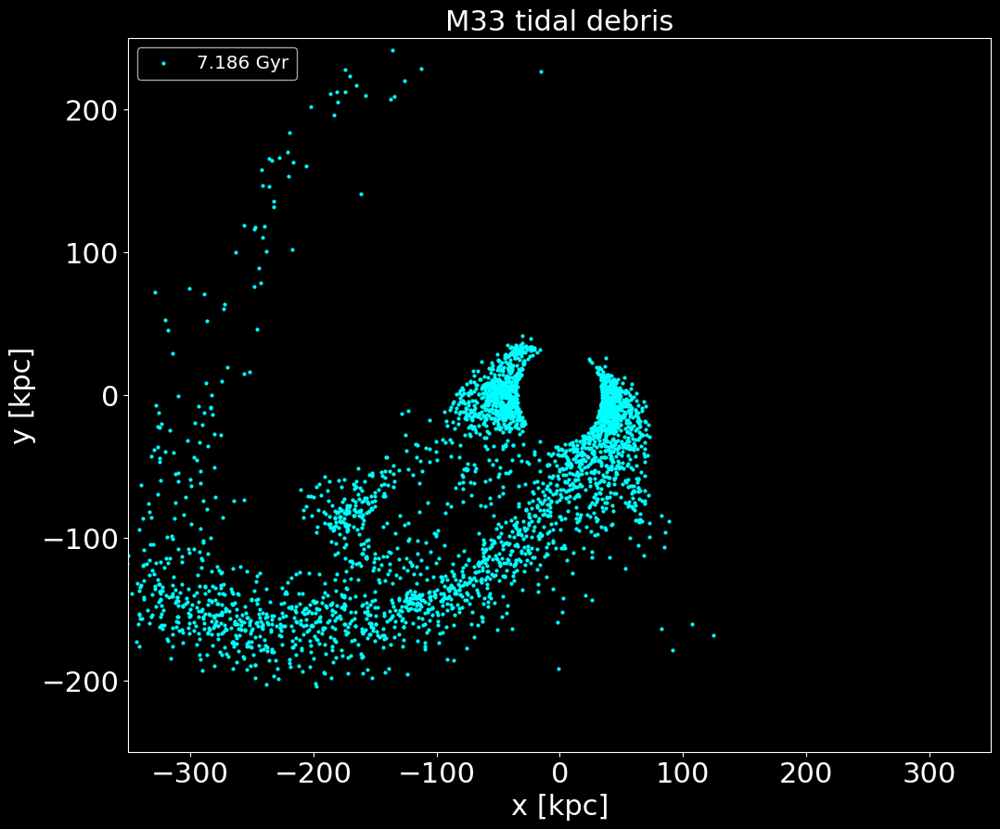

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


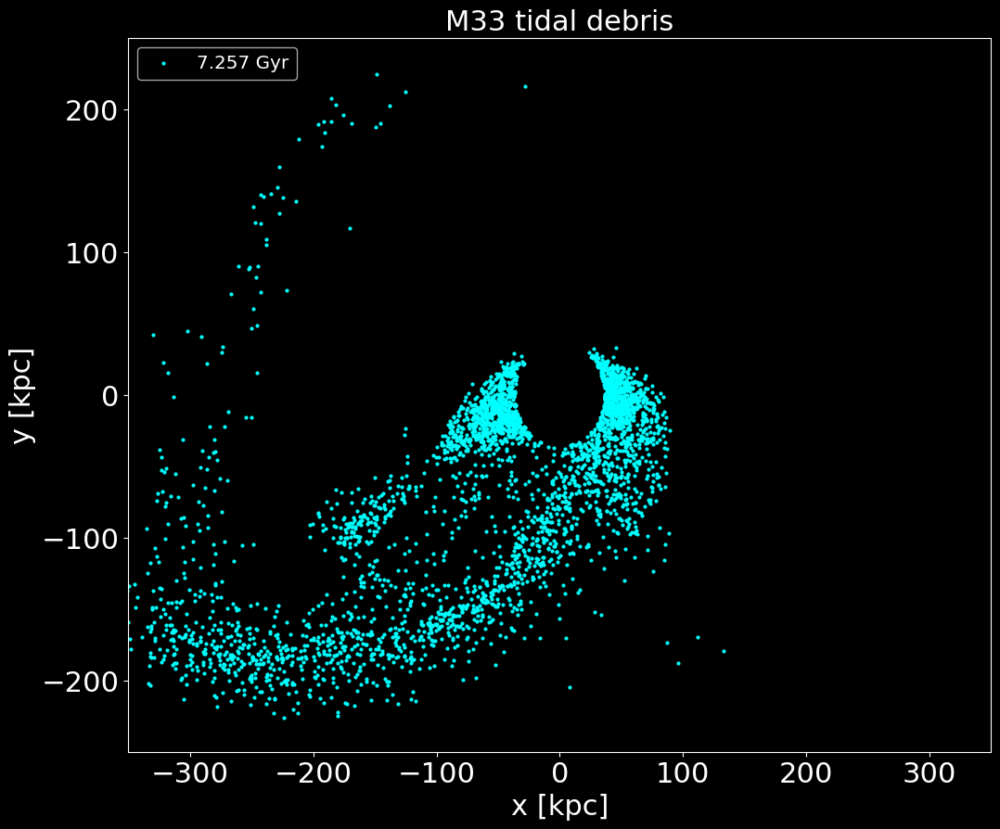

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


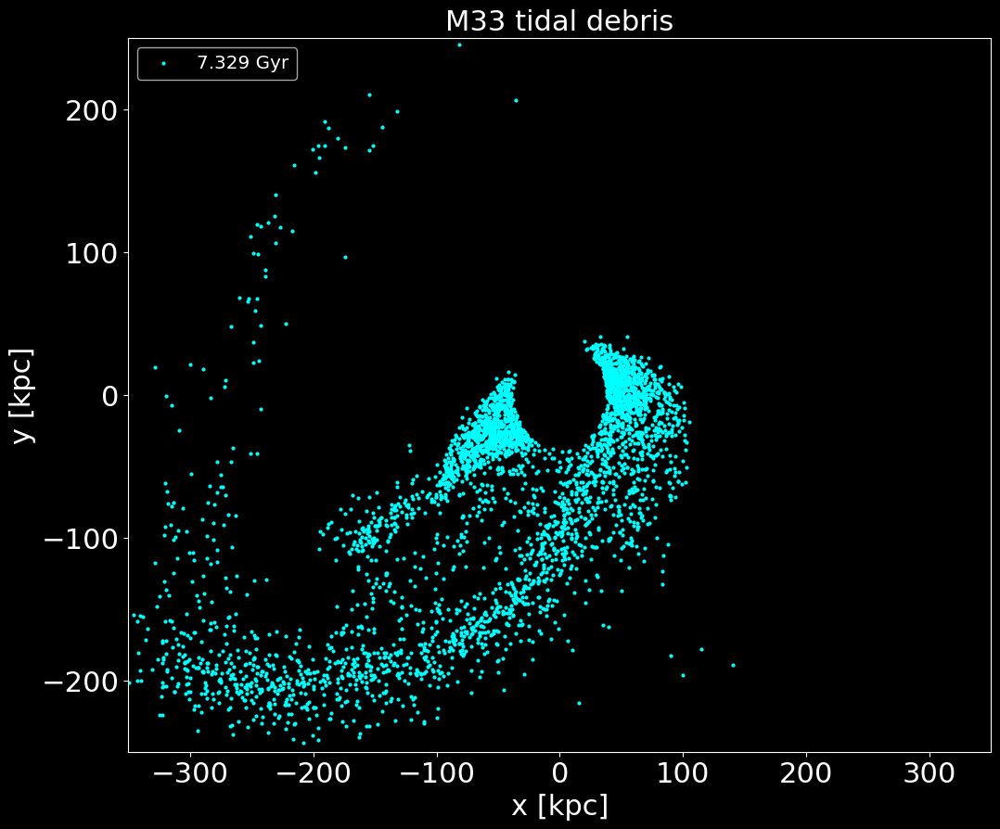

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


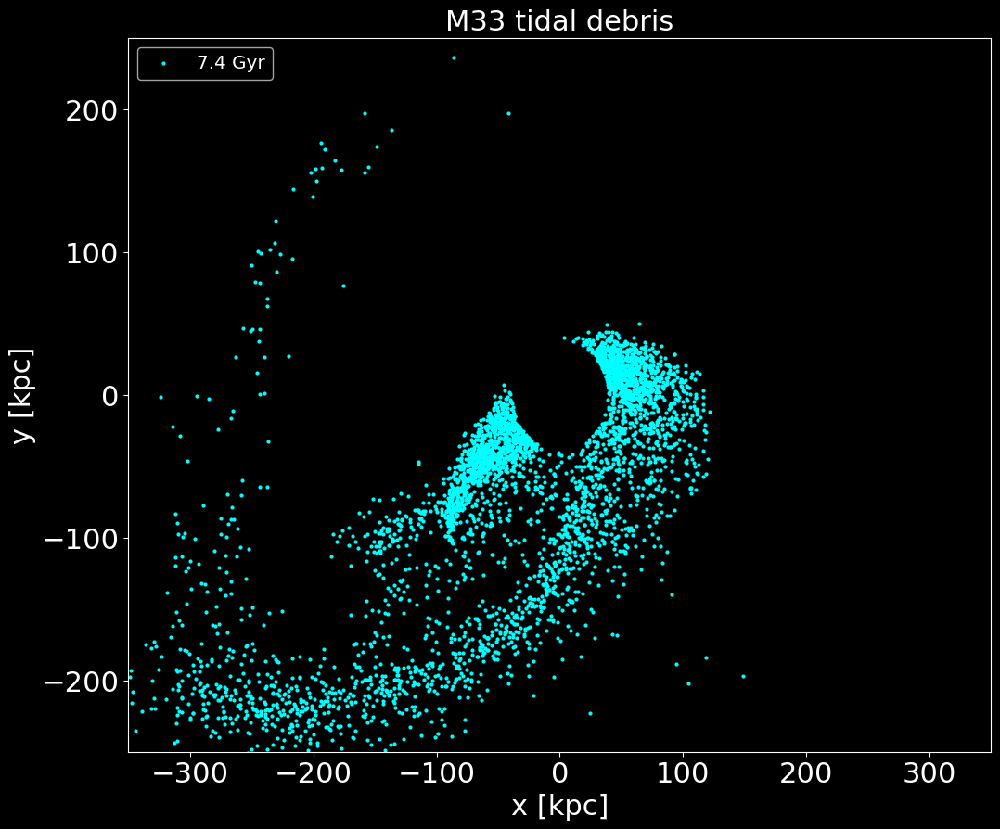

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


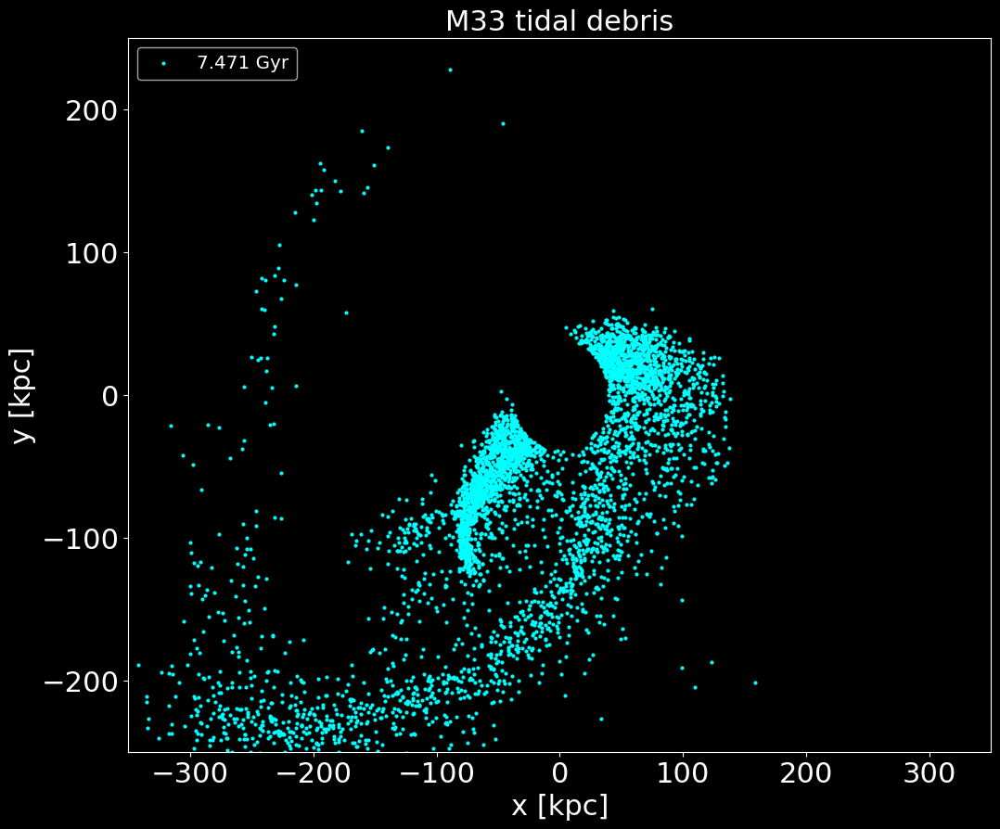

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


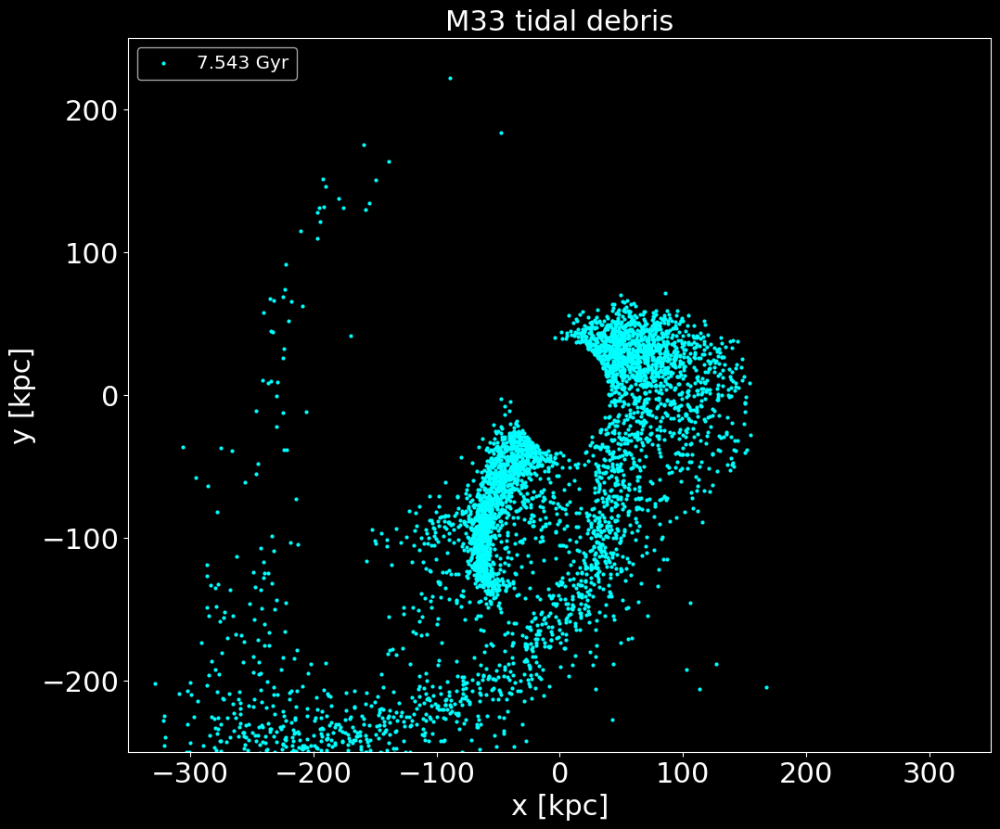

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


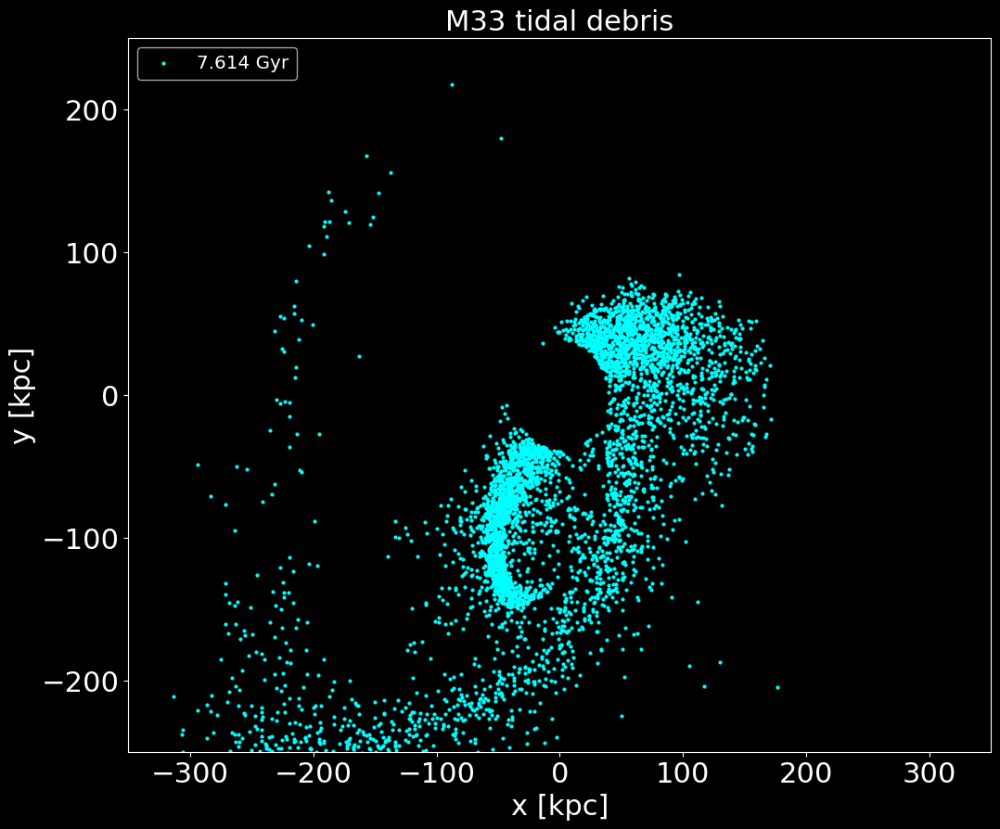

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


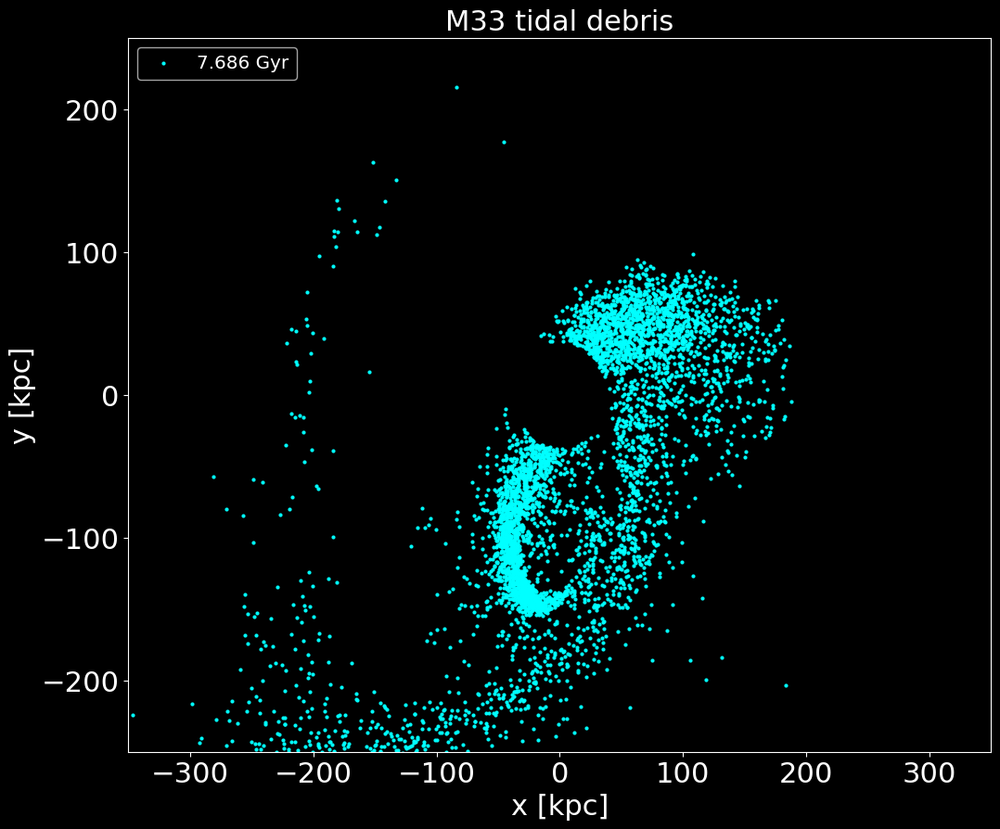

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


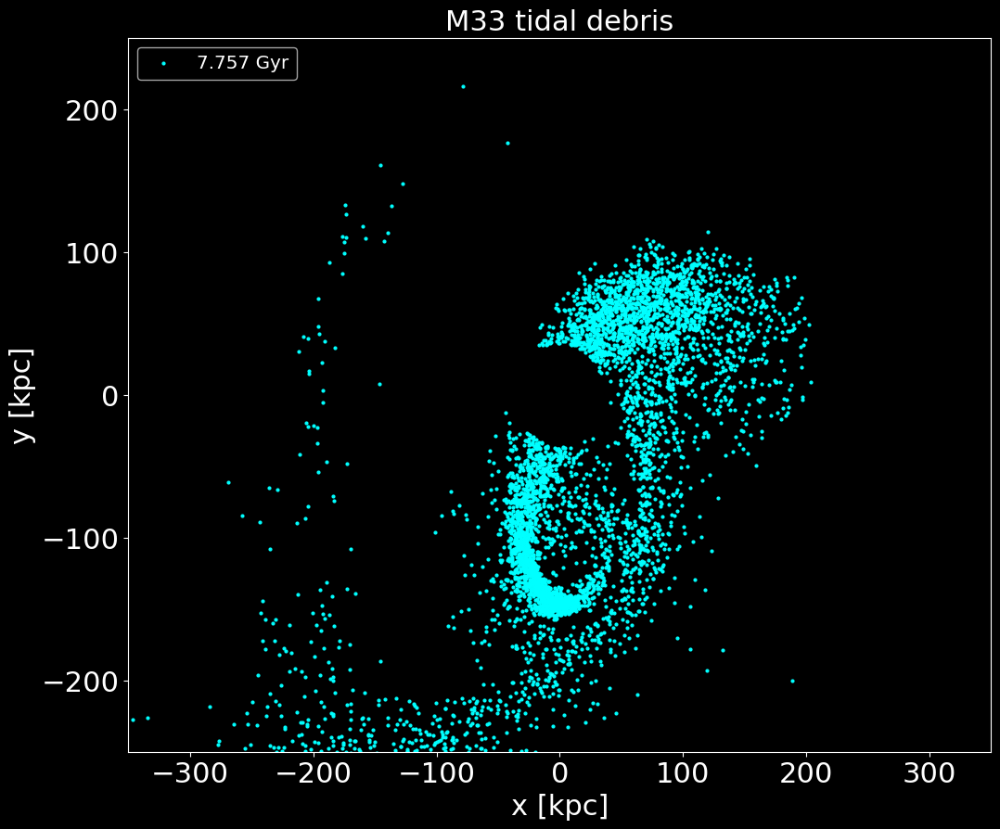

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


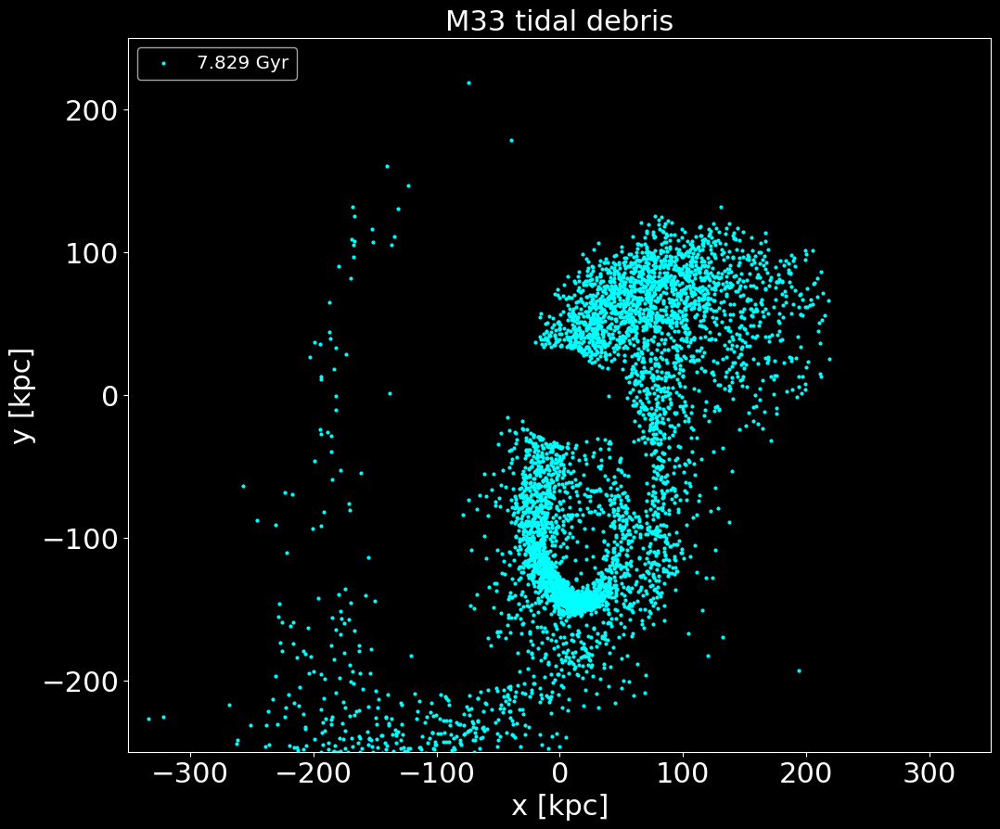

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


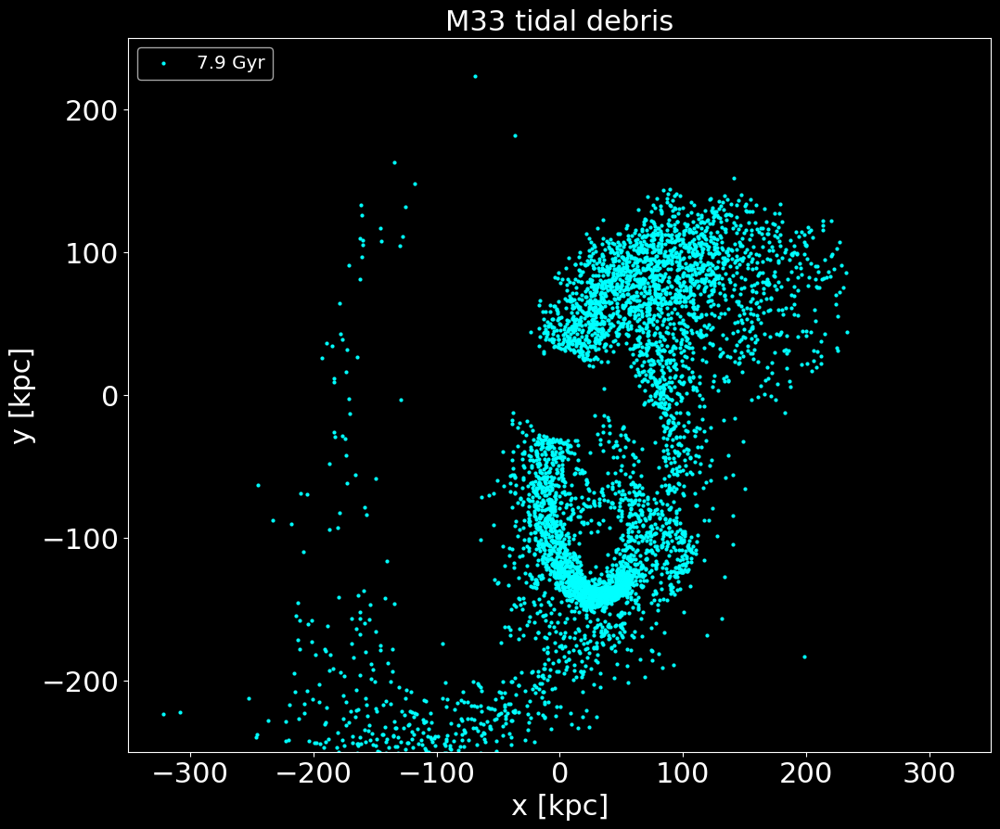

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


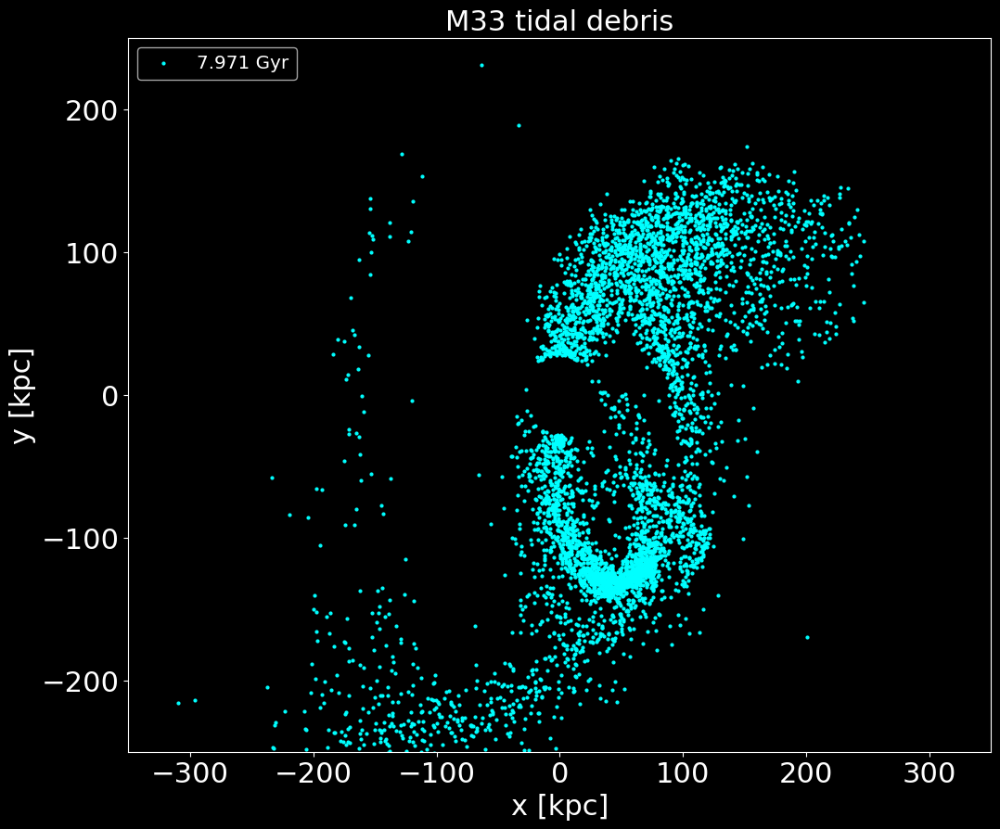

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


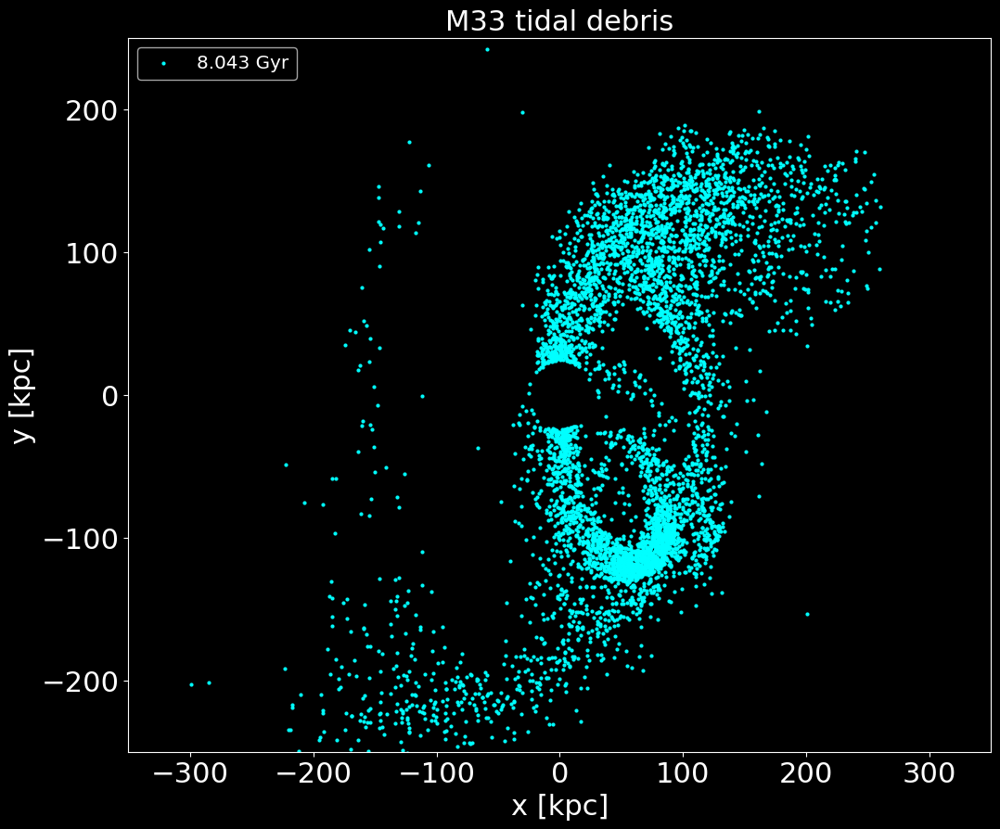

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


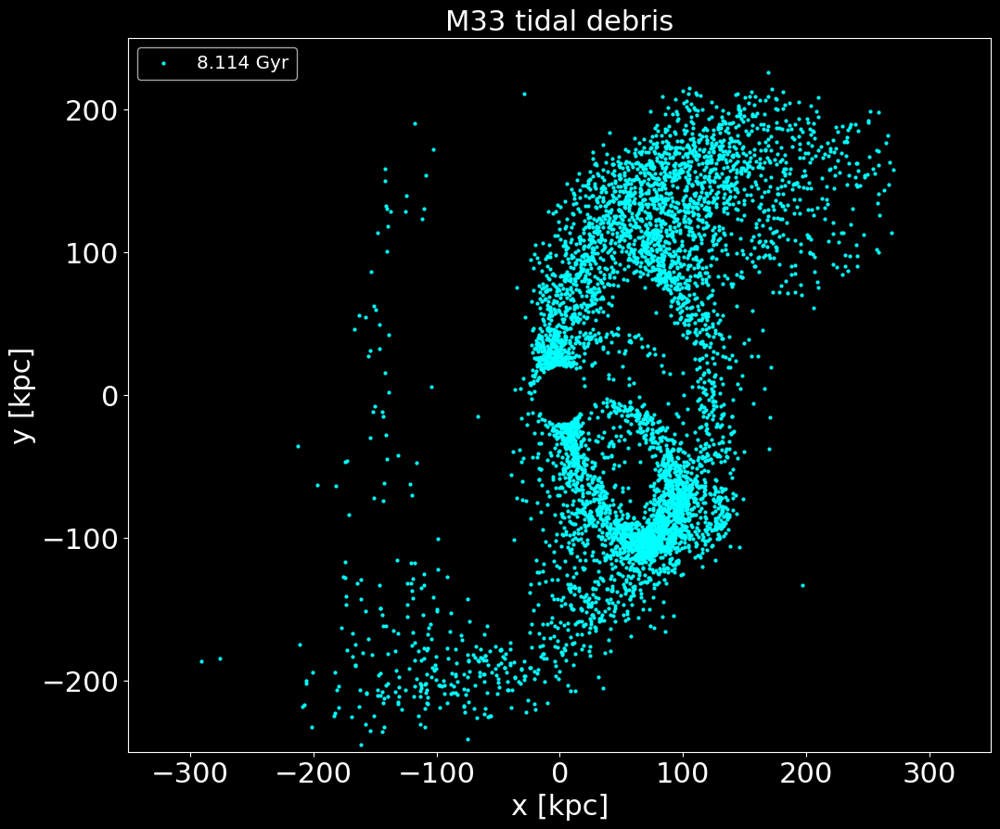

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


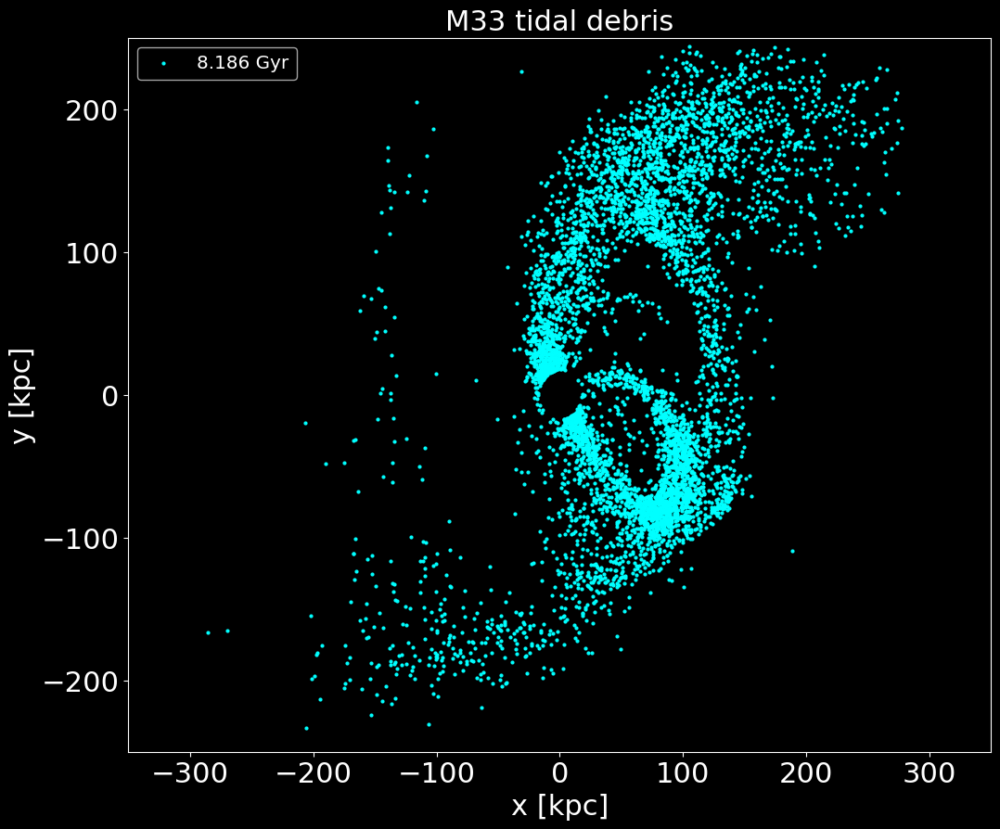

M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


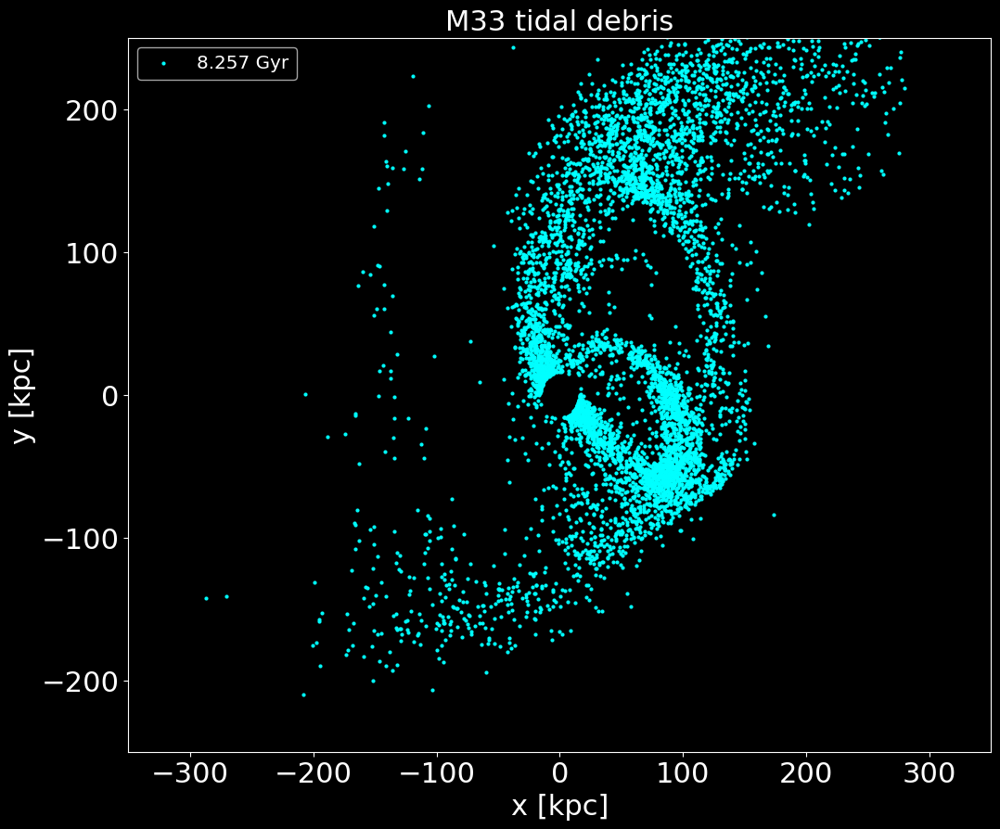

/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:66: RuntimeWarning: invalid value encountered in scalar divide
  a_com = np.sum(a*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:68: RuntimeWarning: invalid value encountered in scalar divide
  b_com = np.sum(b*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:70: RuntimeWarning: invalid value encountered in scalar divide
  c_com = np.sum(c*m)/np.sum(m)


M31 bulge mass: 0.019 x 10^12 solmasses
M31 disk mass: 0.12 x 10^12 solmasses
M31 dark matter halo mass: 1.921 x 10^12 solmasses
M33 bulge mass: 0.0 x 10^12 solmasses
M33 disk mass: 0.009 x 10^12 solmasses
M33 dark matter halo mass: 0.187 x 10^12 solmasses


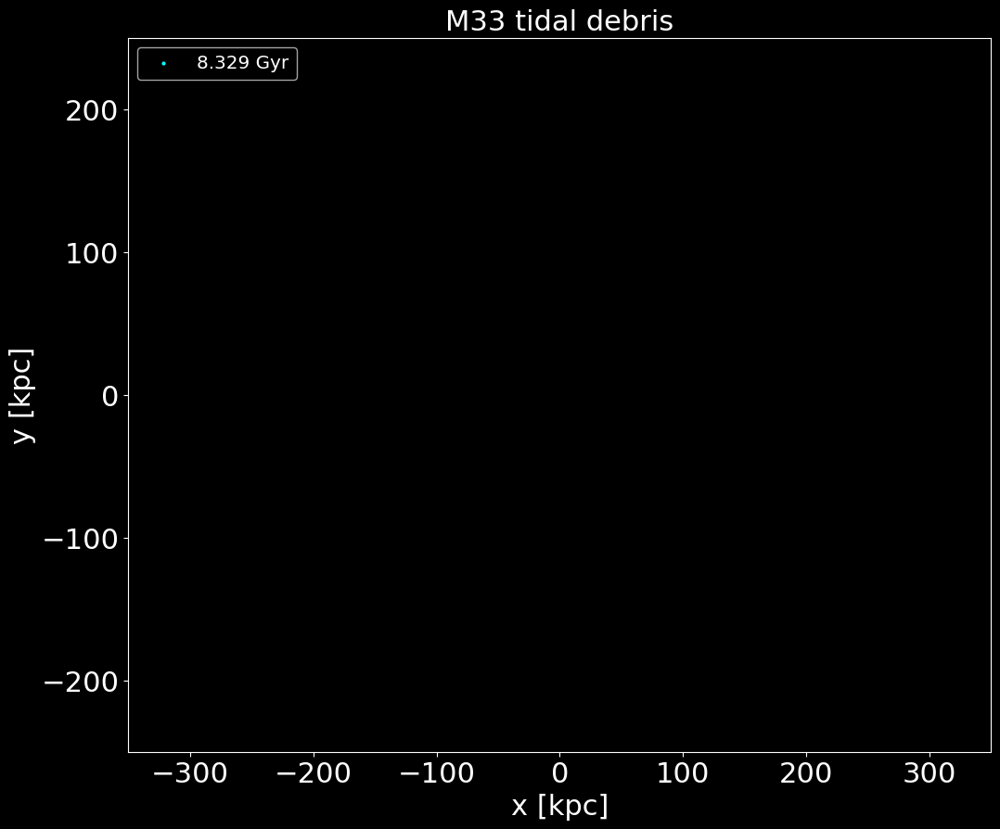

In [286]:
# need help with creating mp4 movie with ffmpeg
# need help with plotting jacobi radius
# array of timeteps 
tsteps = np.arange(288,588,5)

Vavg_streams = []
time = []
Rjacobi = []
mass31 = []
mass33 = []

for i, step in enumerate(tsteps):# loop over numers in timestep array
    # create filename based on corresponding timestep
    if step < 10:
        ilbl = 'M33'+'_00'+str(step)+'.txt'
        ilbl31 = 'M31'+'_00'+str(step)+'.txt'
    elif step >= 10 and step < 100:
        ilbl = 'M33'+'_0'+str(step)+'.txt'
        ilbl31 = 'M31'+'_0'+str(step)+'.txt'
    else:
        ilbl = 'M33'+'_'+str(step)+'.txt'
        ilbl31 = 'M31'+'_'+str(step)+'.txt'

    filename = 'M33'+'/'+ilbl
    M31file = 'M31'+'/'+ilbl31

    # call Positions2D function for positions, velocities, and time
    rn, vn, dist, vel, t, mp = Positions2D(filename)

    '''
    Jacobi radius code:
    '''
    # # distance between M31com and M33com
    COMM33 = CenterOfMass(filename,2)
    COMP_33 = COMM33.COM_P(0.1,4).value
    COMM31 = CenterOfMass(M31file,2)
    COMP_31 = COMM31.COM_P(0.1,2).value
    
    R = COMP_33-COMP_31
    R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2)
    
    # function to compute M31(<r) ***** 
    m31 = Totmass(M31file)
    m33 = Totmass(filename)
    
    # m33's mass also changes with time but dont worry about that 

    rj = JacobiR(m31, m33, R_mag)

    cyl_r = np.sqrt(rn[:,0]**2 + rn[:,1]**2) # radial

    index = np.where(cyl_r >= rj)

    fig, ax= plt.subplots(figsize=(12, 10))
    plt.scatter(rn[index[0], 0], rn[index[0], 1], color='cyan', s=4, label=f"{np.round(t,3)} Gyr")
    
    #Add axis labels
    plt.xlabel('x [kpc]', fontsize=22)
    plt.ylabel('y [kpc]', fontsize=22)

    # #set axis limits
    plt.ylim(-250,250)
    plt.xlim(-350,350)

    plt.legend(loc='upper left',fontsize='x-large')
    plt.title('M33 tidal debris',fontsize=22)

    #adjust tick label font size
    label_size = 22
    matplotlib.rcParams['xtick.labelsize'] = label_size 
    matplotlib.rcParams['ytick.labelsize'] = label_size

    # # Save file
    # if i < 10:
    #     plt.savefig('00'+str(i)+'Debris.png')
    # elif 10 <= i < 100:
    #     plt.savefig('0'+str(i)+'Debris.png')
    # else:
    #     plt.savefig(str(i)+'Debris.png')
        
    plt.show()

    stream_v = np.sqrt(vn[index[0], 0]**2+vn[index[0], 1]**2)
    Vavg_streams.append(np.mean(stream_v))
    time.append(t)
    Rjacobi.append(rj)
    mass31.append(m31)
    mass33.append(m33)


# lower mass stellite galaxies like M33 hang around and stay orbiting for longer because dynamical friction scales with mass, as opposed to M31 and MW which are more massive galaxies that merge within just one orbit

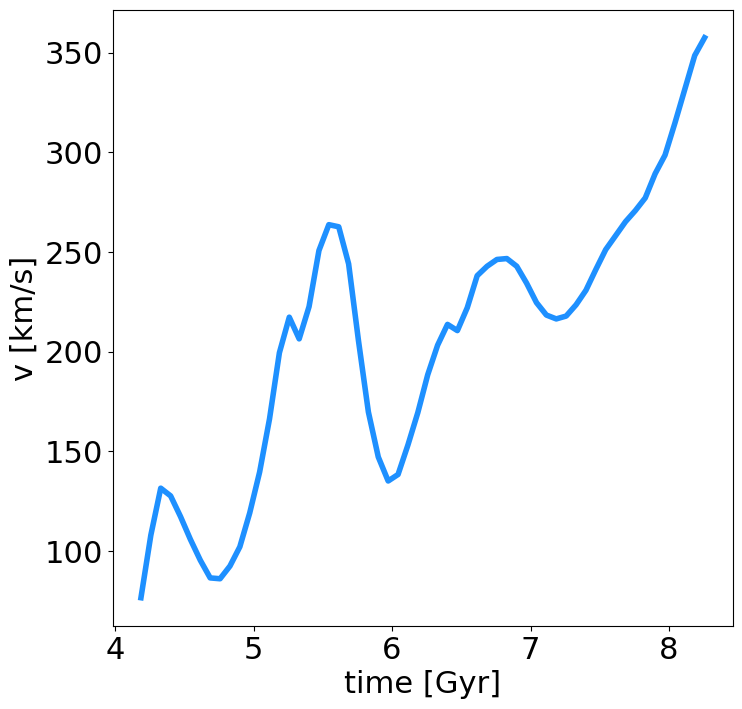

In [302]:

fig, ax= plt.subplots(figsize=(8, 8))
plt.style.use('default')

plt.plot(time,Vavg_streams,linewidth=4, color='dodgerblue')

#Add axis labels
plt.xlabel('time [Gyr]', fontsize=22)
plt.ylabel('v [km/s]', fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('VvsT.png')

plt.show()

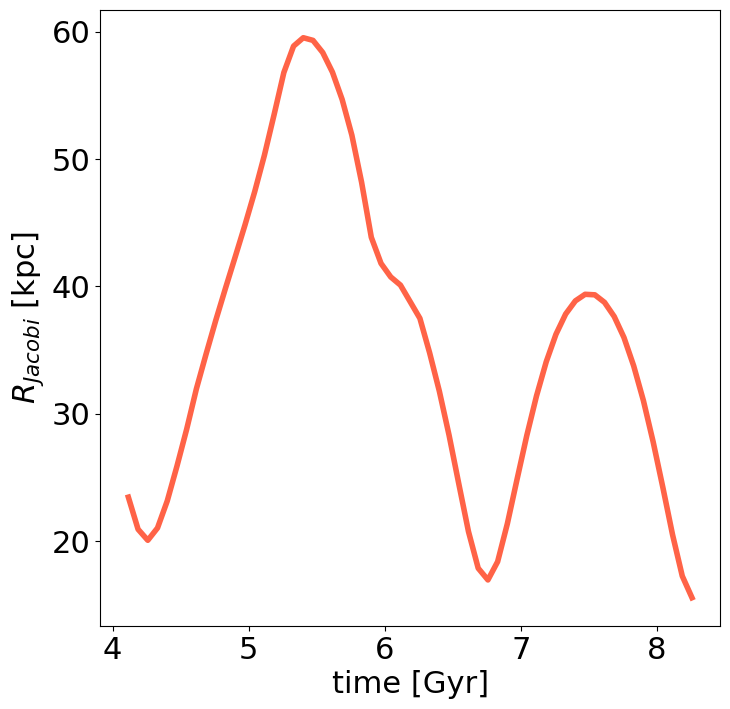

In [292]:
fig, ax= plt.subplots(figsize=(8, 8))
plt.style.use('default')

plt.plot(time,Rjacobi,linewidth=4, color='tomato')

#Add axis labels
plt.xlabel('time [Gyr]', fontsize=22)
plt.ylabel(r'$R_{Jacobi}$ [kpc]', fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('RjvsT.png')

plt.show()